![Logo 01](https://staff.utia.cas.cz/novozada/dizo/DIZO005.png)



**Course website:** [http://zoi.utia.cas.cz/ROZ1](http://zoi.utia.cas.cz/ROZ1)
    

# Part 0: Imports Packages & Data & Helper Functions

In [1]:
import requests
import zipfile
import os
import errno
import cv2 as cv
# For showing the images in Colab use wrap function cv2_imshow
from google.colab.patches import cv2_imshow
import numpy as np
from scipy import ndimage
import matplotlib.pyplot as plt
import time
import glob
import itertools
import os
from IPython import display
import math
import scipy
import warnings
warnings.filterwarnings("ignore")

filename = 'DIZO005_data.zip'
url = f'http://staff.utia.cas.cz/novozada/dizo/{filename}'
try:
    os.mkdir(f'{filename[:-4]}')
    r = requests.get(url, allow_redirects=True)
    open(filename, 'wb').write(r.content)
    with zipfile.ZipFile(filename, 'r') as zip_ref:
        zip_ref.extractall("")
except OSError as e:
    if e.errno != errno.EEXIST:
        raise
    else:
        print(f'{filename[:-4]} folder already exists!')

def resize(img, height=200, interpolation=cv.INTER_CUBIC):
  scale = height / img.shape[0]
  width = int(img.shape[1] * scale)
  new_size = (width, height)
  return cv.resize(img, new_size, interpolation = interpolation)

def show(img, height=200, interpolation=cv.INTER_CUBIC):
  img_new = resize(img, height, interpolation = interpolation)
  cv2_imshow(img_new)

def show_list(height, *imgs):
    show_more(height, *[cv.normalize(img, None, 0, 255, cv.NORM_MINMAX) for img in imgs])

def show_more(height, *args):
    img_new = cv.hconcat([resize(img, height).astype(float) for img in args])
    cv2_imshow(img_new)

def getFilenames(exts):
    fnames = [glob.glob(ext) for ext in exts]
    fnames = list(itertools.chain.from_iterable(fnames))
    fnames.sort()
    return fnames

# Part 1: Segmentation by Thresholding

Let's write a function `otsu(img)` that automatically binarizes the image for us, by finding the ideal threshold that divides the image into foreground and background.

We will be drawing from this paper -> [Otsu 1979](https://staff.utia.cas.cz/novozada/dizo/Otsu-paper.pdf)

We need a set of several functions first.

Write a function `discnorm(img, L)` that linearly transforms intensity values of the image to integer values from `1` to `L`.

*   default value `L = 256`
*   try it on **rice.png**

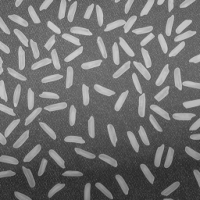

In [2]:
img_orig = cv.imread('rice.png', 0)
show(img_orig, 200)

Max values of original image = 204
Min values of original image = 40
Max values of transformed image = 256.0
Min values of transformed image = 1.0


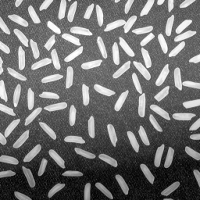

In [3]:
def discnorm(img, L=256):
  fmax = np.max(img)
  fmin = np.min(img)
  if fmax - fmin > 0:
    g = (img - fmin) / (fmax - fmin)
  else:
    g = np.zeros_like(img)
  g = 1 + np.round((L - 1) * g)
  return g

print(f'Max values of original image = {np.max(img_orig)}')
print(f'Min values of original image = {np.min(img_orig)}')

rice = discnorm(img_orig)

print(f'Max values of transformed image = {np.max(rice)}')
print(f'Min values of transformed image = {np.min(rice)}')

show(rice)

Write a function `histogram(img, L)` that calculates a histogram $h$ (i.e. a vector of brightness level frequencies) for the image.

*   default value `L = 256`
*   try it on **rice.png**



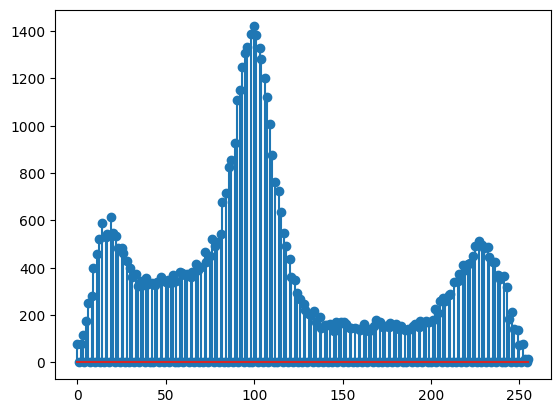

In [4]:
def histogram(img, L=256):
  hist, _ = np.histogram(img, bins=L)
  return hist

hist = histogram(rice)
plt.stem(hist)
plt.show()

Write a function `smoothhist(hist, r)` that smooths the histogram $h$ by convolving it with a rectangle of width $2*R+1$.

*   default value `L = 256`
*   try it on **temple.png**

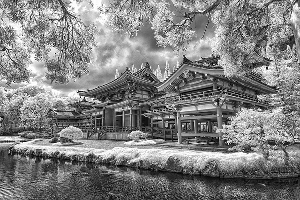

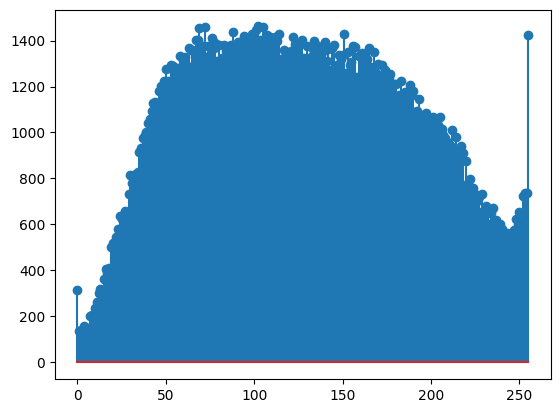

In [5]:
img_orig = cv.imread('temple.png', 0)
show(img_orig, 200)

hist = histogram(img_orig)
plt.stem(hist)
plt.show()

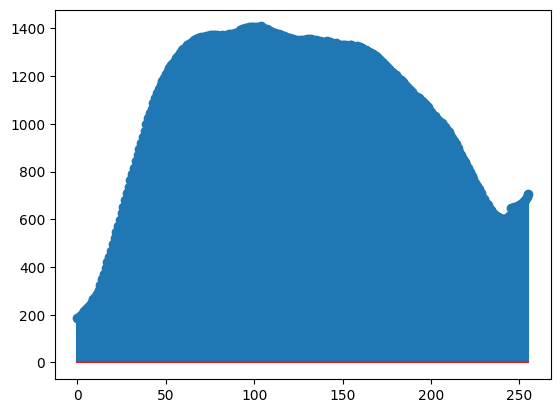

In [6]:
def smoothhist(hist, r):
  l = len(hist)
  m = np.ones(2 * r + 1)
  g = np.convolve(hist, m, mode='same')
  g /= np.convolve(np.ones(l), m, mode='same')
  return g

hist_smooth = smoothhist(hist, 10)
plt.stem(hist_smooth)
plt.show()

Now we can start programming the Otsu method.

Open the PDF and follow the steps.

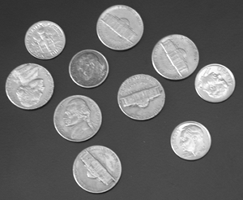

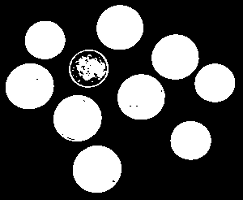

In [7]:
def otsu(img, L=256):
  # linear luminance transformation
  img = discnorm(img, L)
  # number of pixels
  N = img.shape[0] * img.shape[1]
  # brightness levels (histogram)
  n = histogram(img, L)
  # brightness probability density
  p = n / N
  # brightness distribution function (probability of class w0)
  w = np.cumsum(p)
  # 1st order cumulative moment
  m = np.cumsum(np.arange(1, L+1) * p)
  # mean brightness value
  mT = m[-1]
  # inter-class variance
  sB = np.power((mT * w - m), 2) / (w * (1 - w))
  # zero division treatment
  sB[(w * (1 - w)) == 0] = 0
  # threshold maximising sB
  tt = np.argmax(sB) + 1
  # final image
  g = (img >= tt)
  return g.astype(np.uint8()), tt

img_orig = cv.imread('coins.png', 0)
show(img_orig, 200)

coins_otsu,_ = otsu(img_orig)
show(coins_otsu*255, 200)

Try the Otsu algorithm on **morse.png**:

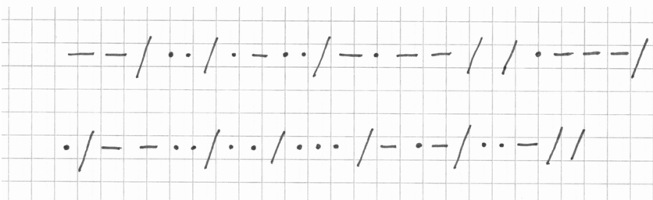

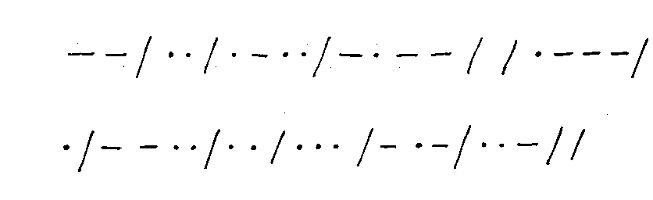

In [8]:
img_orig = cv.imread('morse.png', 0)
show(img_orig, 200)

morse_otsu, _ = otsu(img_orig)
show(morse_otsu*255, 200)

Try the Otsu algorithm on **rice.png**:

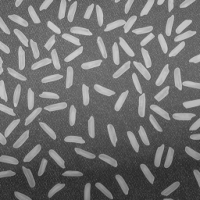

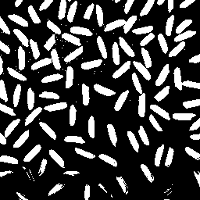

In [9]:
img_orig = cv.imread('rice.png', 0)
show(img_orig, 200)

rice_otsu, _ = otsu(img_orig)
show(rice_otsu*255, 200)

You don't like the result either? So what do you suggest?
*   Split the image into tiles and calculate local thresholding in each tile.

Write a function `otsu_local(img, n1, n2, L)` which evenly divides the image into $n_1 \times n_2$ rectangles. Then binarize these parts locally using the Otsu method.

*   default value `L = 256`
*   try it on **rice.png**

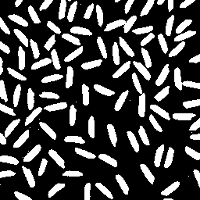

In [10]:
def otsu_local(img, n1, n2, L = 256):
  d1 = np.floor(np.arange(n1+1) * img.shape[0] / n1)
  d2 = np.floor(np.arange(n2+1) * img.shape[1] / n2)
  d1 = d1.astype(int)
  d2 = d2.astype(int)
  g = np.zeros_like(img)
  for i in np.arange(len(d1)-1):
    for j in np.arange(len(d2)-1):
      temp, _ = otsu(img[d1[i]:d1[i+1], d2[j]:d2[j+1]])
      g[d1[i]:d1[i+1], d2[j]:d2[j+1]] = temp
  return g

img_orig = cv.imread('rice.png', 0)
rice_otsu_local = otsu_local(img_orig, 8, 8)
show(rice_otsu_local*255)

Sometimes you want to segment an object whose intensities are between two thresholds >>

Write a function `bandthreshold(img, t1, t2)` that binarizes the image by selecting pixels with intensity values in the interval $<t_1, t_2>$ as the object and the rest as background.

*   default value `t2 = 256`
*   try it on **saturn.png**

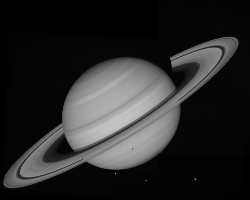

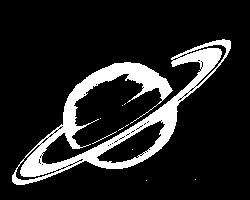

In [11]:
def bandthreshold(img, t1, t2=255):
  g = (img >= t1) * (img <= t2)
  return g.astype(np.uint8())

img_orig = cv.imread('saturn.png', 0)
show(img_orig, 200)

saturn = bandthreshold(img_orig, 100, 150)
show(saturn*255, 200)

In some cases, you know that the foreground takes up a certain percentage of the overall picture.

Write a function `ptile(img, p)` that binarizes the image using a threshold $t$ so that its histogram area is divided in a ratio of `p` to `1-p`:

*   $p\in <0, 1>$
*   this method is very effective for printed text
*   try it on **paragraph.png**

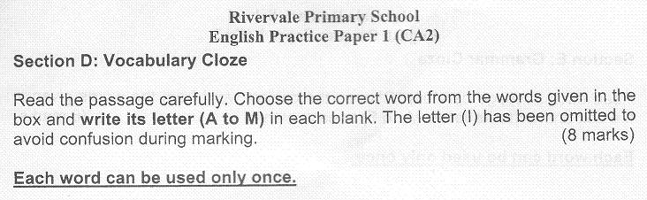

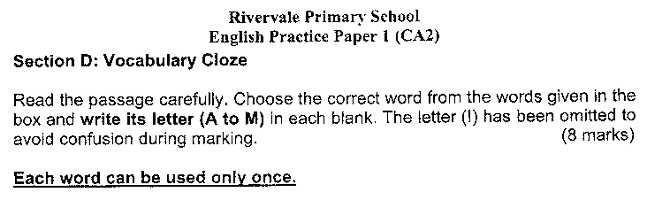

In [12]:
def ptile(img, p):
  h = histogram(img)
  c = np.cumsum(h)
  n = c[-1]
  t = np.where(c >= n * p)[0][0]
  g = img >= t
  return g.astype(np.uint8())

img_orig = cv.imread('paragraph.png', 0)
show(img_orig, 200)

paragraph_ptile = ptile(img_orig, 0.08)
show(paragraph_ptile*255, 200)

Try `ptile` on **morse.png**:

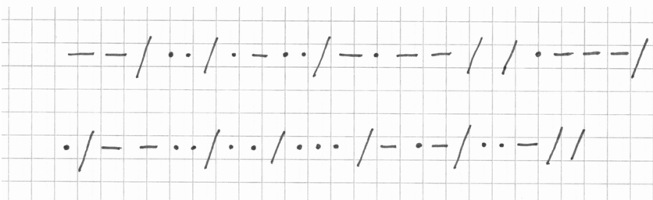

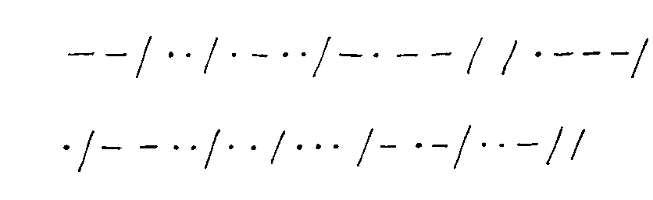

In [13]:
img_orig = cv.imread('morse.png', 0)
show(img_orig, 200)

morse_ptile = ptile(img_orig, 0.018)
show(morse_ptile*255, 200)

Write a function `semithreshold(img, t)` that selects pixels with intensity values below the threshold `t` as background, while leaving the values of other pixels unchanged:

*   try it on **moon.png**

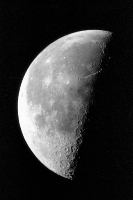

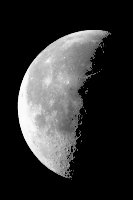

In [14]:
def semithreshold(img, t=128):
  m = img >= t;
  g = img * m;
  return g.astype(np.uint8())

img_orig = cv.imread('moon.png', 0)
show(img_orig, 200)

moon_semi = semithreshold(img_orig, 80)
show(moon_semi, 200)

In the color image **columns.png**, change the sky pixels to **black**.

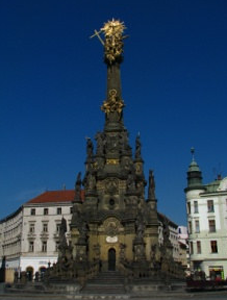

In [15]:
img_orig = cv.imread('sloup.png', 1)
show(img_orig, 300)

Split the channels:

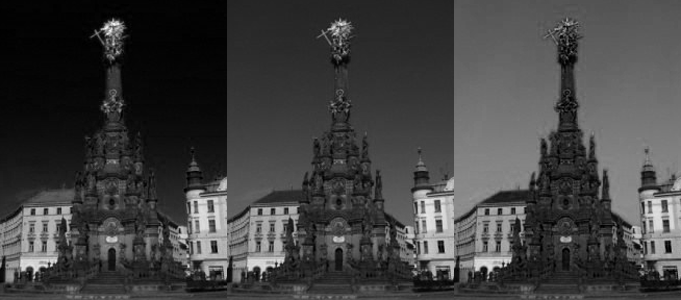

In [16]:
b,g,r = cv.split(img_orig)
show_more(300, r, g, b)

Use the Otsu method as mask to differentiate between the red and blue channels:

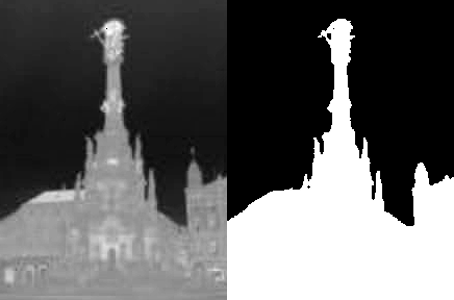

In [17]:
rb = r.astype(np.float16()) - b.astype(np.float16())
rb = discnorm(rb).astype(np.uint8())
[m, t] = otsu(rb)
show_more(300, rb, m*255)

Use the mask for all three channels and merge them back into a color image:

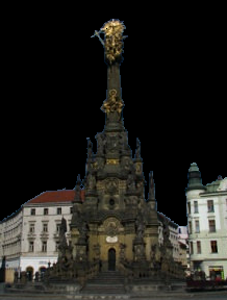

In [18]:
r = r * m
g = g * m
b = b * m
img_final = cv.merge([b,g,r])
show(img_final, 300)

Extract the texture area in the semicircle at the bottom, from the **texture.png** image. Try using local variance as a feature.

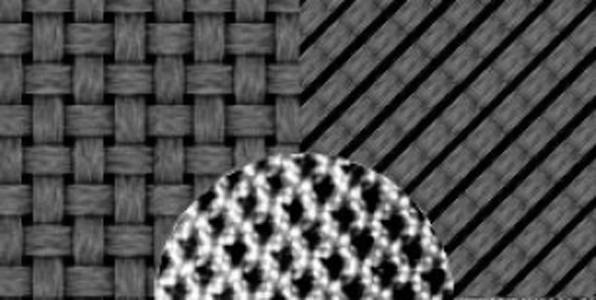

In [19]:
img_orig = cv.imread('texture.png', 0)
show(img_orig, 300)

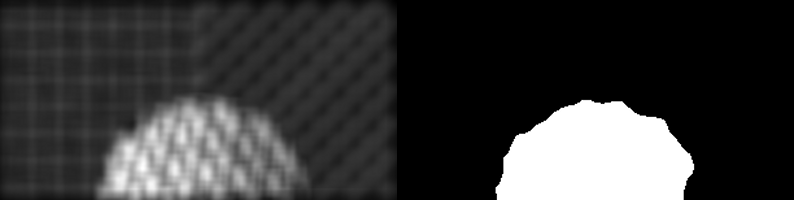

In [20]:
temp = discnorm(img_orig)
r = 8
m = np.ones((2*r+1, 2*r+1)) / ((2*r+1)^2)
EX = cv.filter2D(temp, ddepth=cv.CV_32F, kernel=m, borderType=cv.BORDER_CONSTANT)
EX2 = cv.filter2D(np.power(temp,2), ddepth=cv.CV_32F, kernel=m, borderType=cv.BORDER_CONSTANT)
varX = EX2 - np.power(EX,2)
varX = discnorm(EX2)
texture_otsu, _ = otsu(varX)

kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE, (30,30))
texture_otsu = cv.morphologyEx(texture_otsu.astype(np.uint8), cv.MORPH_CLOSE, kernel)

show_more(200, varX, texture_otsu*255)

# Part 2: Object Recognition

**Motivation:**
- recognition is the act of deciding whether an object belongs to a given class
- the object is described by a set of attributes (n-D vector in metric space)


**What types of classification/recognition do we know?**
- supervised recognition (with learning) - we have a typical set of representatives (training set) for all classes
- unsupervised recognition (without learning) - we neither have a training set nor know how many classes there are

<img src="https://staff.utia.cas.cz/novozada/dizo/recognition001.jpg">

**Training set:**
- representative-typical samples of the class, all major types, there should be no other samples
- large enough - to capture internal variability
- should be compiled by an expert in the field

**Formal definitions of classifiers:**
- each class is characterized by a discriminant function $𝑔(𝑥)$
- classification = maximization of $𝑔(𝑥)$

**More about classifiers:**
follow-up course: [http://zoi.utia.cas.cz/SU1](http://zoi.utia.cas.cz/SU1)
    

## Fourier descriptors

- belongs to the group of transformation coefficients

- based on **Fourier shift theorem** (FST):
$$
\begin{aligned}
𝓕[f(x-x_0)](k) = e^{-2\pi i kx_0}𝓕(k)
\end{aligned}
$$

 - The fourier transform of the shifted function is just a multiple of the fourier transform of the original one.
 - The FT amplitude does not change during the shift, the phase shifts in a defined way.

**How will the FST be used ?**

1.   First we construct a radial function:
<img src="https://staff.utia.cas.cz/novozada/dizo/recognition002.jpg">

2.   The radial function is invariant to:
  - ***shift*** - we relate it to the centre of gravity, we don't have to consider displacement
  - ***rotation*** - the radial function will only shift - so it does not depend on the starting point

3. We calculate FT of the radial function and take its amplitude - we declare the first few coefficients of the FT as our searched *FOURIER DESCRIPTORS*

To ensure invariance to scaling, this set is divided by the first coefficient, which is the coefficient of the constant function - or the mean.

$$
\begin{aligned}
𝓕(k) = \int f(x)e^{-2\pi i kx}dx
\end{aligned}
$$
$$
\begin{aligned}
𝓕(0) = \int f(x)dx
\end{aligned}
$$

### Application in practice (discrete case):

1.   Take the boundary and rewrite it as a complex function:
$$
\begin{aligned}
f(t) = x(t) + iy(t)
\end{aligned}
$$
2.   Calculate its FT and take the absolute values
3.   The zero coefficient now has a different meaning - it tells us the distance from the origin, so we discard it and use the other ones

*Note: There isn't a lot of information in FD - much of the information in FT is contained in the phase which we don't consider at all.*


### EXAMPLE:
Use the **ocr.png** image to demonstrate the Fourier descriptors.

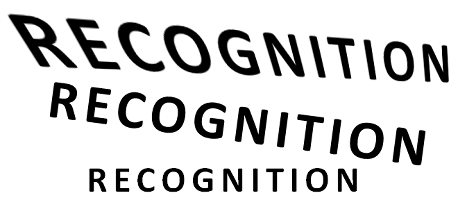

In [21]:
img_orig = cv.imread('ocr.png')
show(img_orig, 200)

####  Image preprocessing


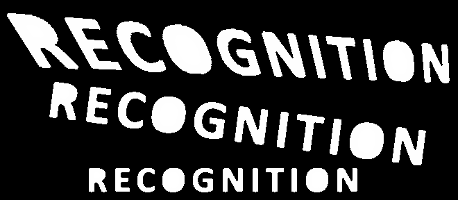

In [50]:
# Read the image
img_orig = cv.imread('ocr.png')
# create the working copy
img = img_orig.copy()
# convert to the grayscale
img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
img = img.astype(np.uint8)
# do the threshold
img = img < 255

# now use the morphology operations to clear the image
kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE, (3,3))
# closing
img = cv.morphologyEx(img.astype(np.uint8), cv.MORPH_CLOSE, kernel)

# Fourier descriptors can handle only stars objects
h, w = img.shape[:2]
# create the mask with zeros
mask = np.zeros((h+2, w+2), np.uint8)
# Floodfill all holes in the binary image
cv.floodFill(img, mask, (0,0), 255);
#  invert the image
img = cv.bitwise_not(img)
# show the final output
show(img, 200)

####  Detect contours

Use the [`findContours()`](https://docs.opencv.org/4.x/d4/d73/tutorial_py_contours_begin.html) function from the OpenCV library.

In [23]:
contours, _ = cv.findContours(img.astype(np.uint8), mode=cv.RETR_LIST, method=cv.CHAIN_APPROX_NONE)
print(f'There are {len(contours)} letters')

There are 33 letters


Write a function that can display specific letters for testing purposes.

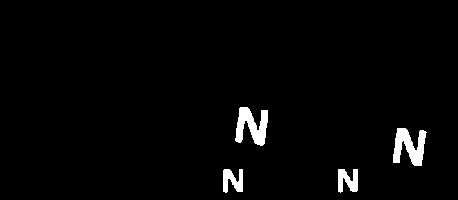

In [24]:
def show_instance(img, contours, nums):
  # create a black image of the same size as the image with letters
  out = np.zeros_like(img)
  # paint the selected polygons
  for num in nums:
    cv.fillPoly(out, [contours[num]], 255)
  # show the output
  show(out, interpolation=cv.INTER_NEAREST)

show_instance(img, contours, [0, 5, 11, 16])

Show the last letter:

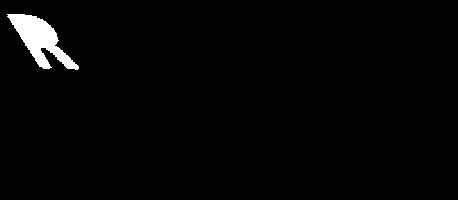

In [25]:
show_instance(img, contours, [len(contours)-1])

How to make the border our desired complex function?

In [26]:
temp = contours[32]
print(f'The shape of contour: {temp.shape}')
contour_array = temp[:, 0, :]
temp = temp[:,0,0] + temp[:,0,1]*1j
print(f'The first compex number = {temp[0]}')

The shape of contour: (309, 1, 2)
The first compex number = (11+19j)


Finally, we can write our function for calculating FD:

In [27]:
def  fourier_descriptors(contours, num):
  # create the zeros matrix - num(rows)...num of contours x num(cols)...num of FD
  fd = np.zeros((len(contours), num))
  # go through all the contours
  for idx, contour in enumerate(contours):
    # create the complex function from the border
    contour_complex = contour[:,0,0] + contour[:,0,1]*1j
    # apply the FT and count the amplitude
    ft_contour = np.abs(np.fft.fft(contour_complex))
    # take Fourier coefficients from the second one and normalize them with the length of the border
    fd[idx, :] = ft_contour[1:num+1] / (len(ft_contour)**2)
  return fd

FD = fourier_descriptors(contours, 10)

####  Playing with FD

What FDs look like:

[0.03970618 0.02015829 0.01996365 0.00536544 0.00313159 0.003661
 0.00243421 0.00216483 0.0007529  0.00060523]


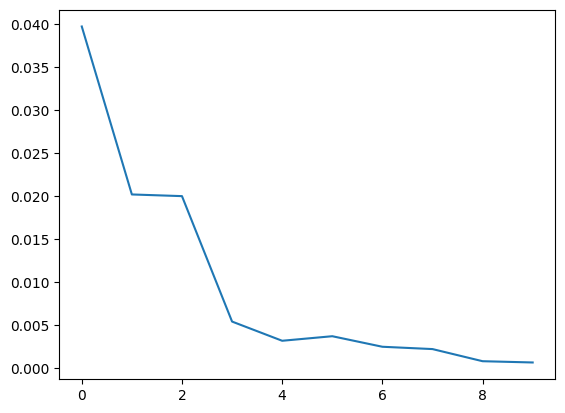

In [28]:
print(FD[32,:])
plt.plot(FD[32,:])

What would it be for a square?

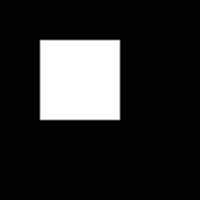

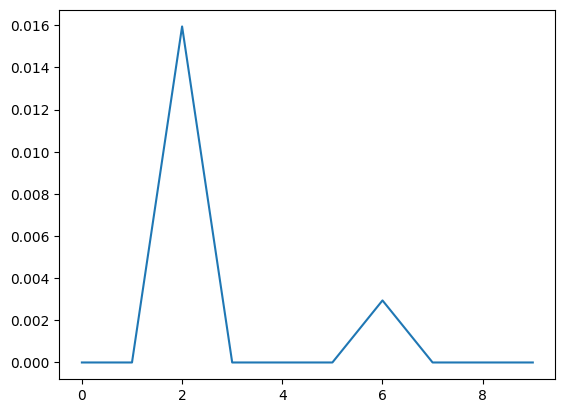

In [29]:
sq1 = np.zeros((100,100))
sq1[20:60, 20:60] = 255
show(sq1)
contours_square1, _ = cv.findContours(sq1.astype(np.uint8), mode=cv.RETR_LIST, method=cv.CHAIN_APPROX_NONE)
FD_square1 = fourier_descriptors(contours_square1, 10)
plt.plot(FD_square1[0,:]);

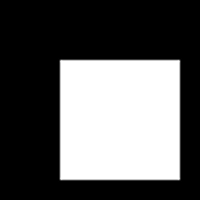

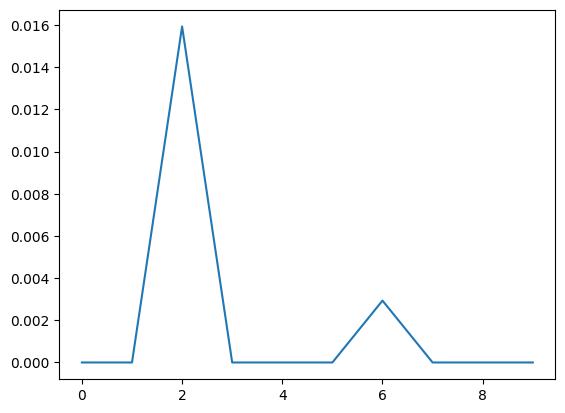

In [30]:
sq2 = np.zeros((100,100))
sq2[30:90, 30:90] = 255
show(sq2)
contours_square2, _ = cv.findContours(sq2.astype(np.uint8), mode=cv.RETR_LIST, method=cv.CHAIN_APPROX_NONE)
FD_square2 = fourier_descriptors(contours_square2, 10)
plt.plot(FD_square2[0,:]);

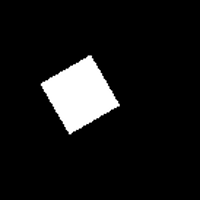

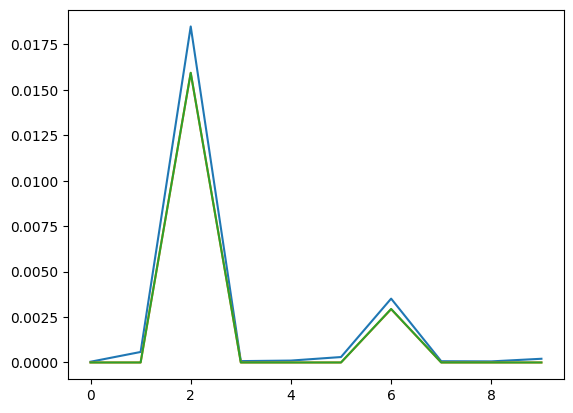

In [31]:
sq3 = ndimage.rotate(sq1, 30, cval=0)
_, sq3 = cv.threshold(sq3,127,255,cv.THRESH_BINARY)
contours_square3, _ = cv.findContours(sq3.astype(np.uint8), mode=cv.RETR_LIST, method=cv.CHAIN_APPROX_NONE)
FD_square3 = fourier_descriptors(contours_square3, 10)
show(sq3)

# show all graphs together
plt.plot(FD_square3[0,:]);
plt.plot(FD_square2[0,:]);
plt.plot(FD_square1[0,:]);

What about a rectangle?

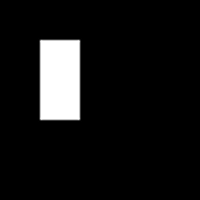

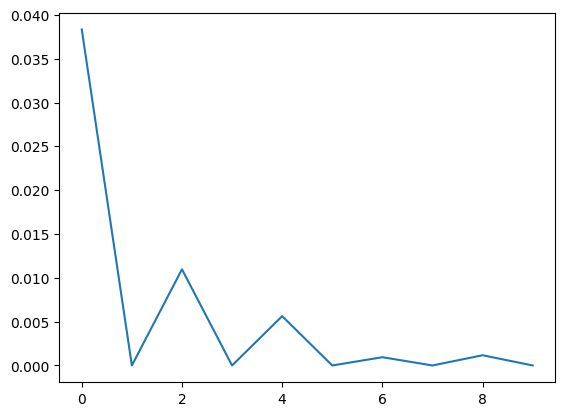

In [32]:
rec1 = np.zeros((100,100))
rec1[20:60, 20:40] = 255
show(rec1)
contours_rec1, _ = cv.findContours(rec1.astype(np.uint8), mode=cv.RETR_LIST, method=cv.CHAIN_APPROX_NONE)
FD_rec1 = fourier_descriptors(contours_rec1, 10)
plt.plot(FD_rec1[0,:]);

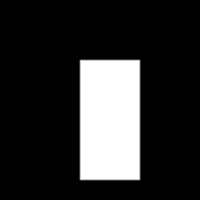

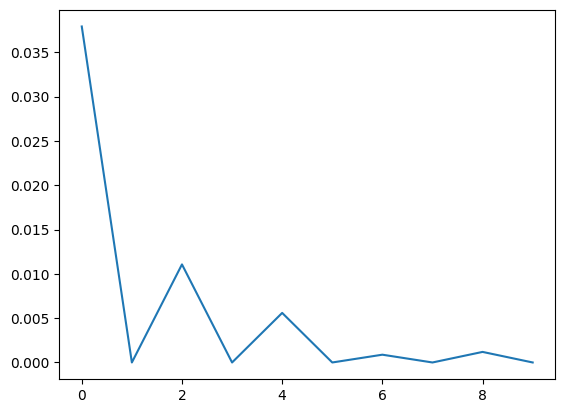

In [33]:
rec2 = np.zeros((100,100))
rec2[30:90, 40:70] = 255
show(rec2)
contours_rec2, _ = cv.findContours(rec2.astype(np.uint8), mode=cv.RETR_LIST, method=cv.CHAIN_APPROX_NONE)
FD_rec2 = fourier_descriptors(contours_rec2, 10)
plt.plot(FD_rec2[0,:]);

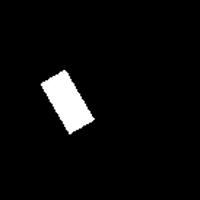

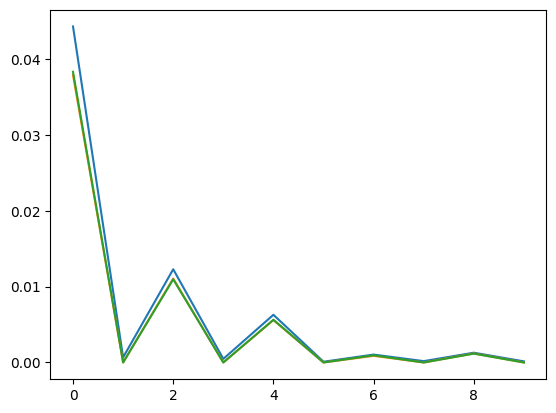

In [34]:
rec3 = ndimage.rotate(rec1, 30, cval=0)
_, rec3 = cv.threshold(rec3,127,255,cv.THRESH_BINARY)
contours_rec3, _ = cv.findContours(rec3.astype(np.uint8), mode=cv.RETR_LIST, method=cv.CHAIN_APPROX_NONE)
FD_rec3 = fourier_descriptors(contours_rec3, 10)
show(rec3)

# show all graphs together for rectangles
plt.plot(FD_rec3[0,:]);
plt.plot(FD_rec2[0,:]);
plt.plot(FD_rec1[0,:]);

#### Let's go back to our letters

Show the feature space for the first few combinations:

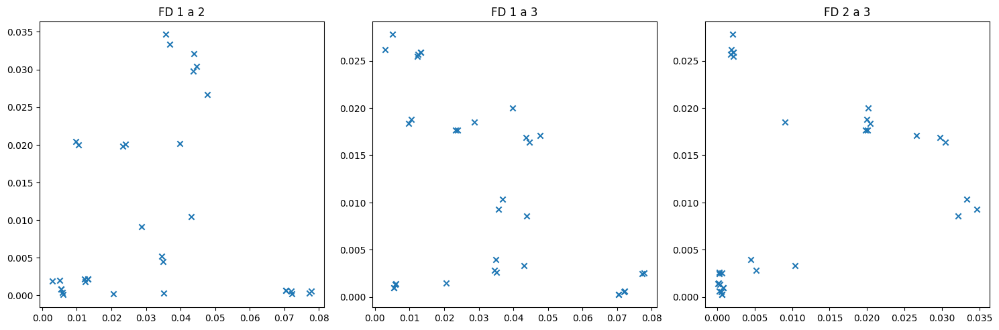

In [35]:
fig, axis = plt.subplots(1, 3)
fig.set_size_inches((15,5))
axis[0].scatter(FD[:,0], FD[:,1], marker='x')
axis[0].set_title("FD 1 a 2")

axis[1].scatter(FD[:,0], FD[:,2], marker='x')
axis[1].set_title("FD 1 a 3")

axis[2].scatter(FD[:,1], FD[:,2], marker='x')
axis[2].set_title("FD 2 a 3")
fig.tight_layout(pad=1.0)
plt.show()

Use the L2-norm for counting all distances >> create the distance matrix.

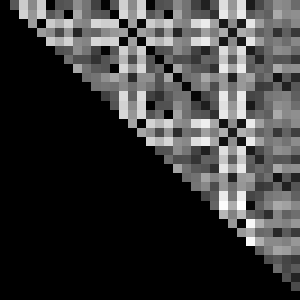

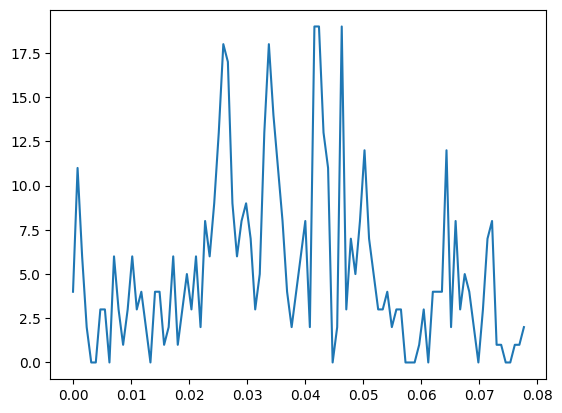

In [36]:
def distance_matrix(vectors):
  n = vectors.shape[0]
  dm = np.zeros((n, n))
  for i in range(n):
    for j in range(i+1,n):
      dm[i, j] = np.linalg.norm(vectors[i,:] - vectors[j,:])
  return dm

dm = distance_matrix(FD)
show(dm*(255/np.max(dm)),300, interpolation=cv.INTER_NEAREST)

# the histogram of the distance matrix
histogram_var, bins = np.histogram(dm[dm > 0], bins=100)
plt.plot(bins[0:-1], histogram_var)
plt.show()

Now we can threshold the distances:

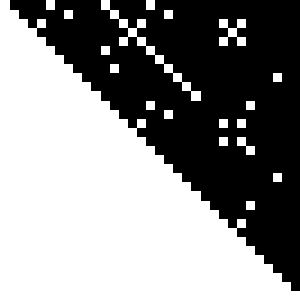

In [37]:
show((dm<0.008)*255,300, interpolation=cv.INTER_NEAREST)

Show the palette:


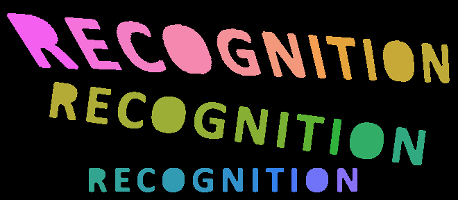

Coloring similar letters:


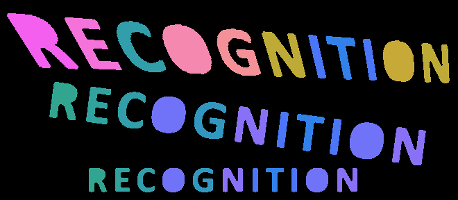

In [38]:
import seaborn as sns

def show_classes(img, contours, dm):
  n = dm.shape[0]
  out = np.zeros_like(img)
  out = cv.merge((out, out, out))
  palette = sns.color_palette("husl", n+5)
  for i in range(n):
    cv.fillPoly(out, [contours[i]], [x * 255 for x in palette[i]])
  print('Show the palette:')
  show(out)
  for i in range(n):
    for j in range(i+1, n):
      if dm[i,j]:
        cv.fillPoly(out, [contours[j]],  [x * 255 for x in palette[i]])
        dm[j,:] = 0
  print('Coloring similar letters:')
  show(out)

show_classes(img, contours, dm<0.008)

As we can see rotation and scaling have no effect on FD >> compare the 2th and 3rd line.

However, geometric transformations have a fatal effect on most letters >> 1st line.

## Moment invariants

Moments are the projection of the image function onto a polynomial basis.

**General moment of a picture:**
$$
\begin{aligned}
M_{pq}(f) = \iint_D p_{pq}(x,y)f(x,y) \,dx\,dy
\end{aligned}
$$


*   $p,q \in 𝜨^+ $
*   $r=p+q$ is the degree of a moment
*   $p_{00}(x,y), p_{10}(x,y), ...,p_{kj}(x,y)$ is the polynomial basis of the functions defined on $D$



### Central Geometric Moment

$$
\begin{aligned}
\mu_{pq} = \iint_{-∞}^∞ (x-x_t)^p(y-y_t)^qf(x,y) \,dx\,dy
\end{aligned}
$$


*   where $x_t=\frac{m_{10}}{m_{00}}$ and $y_t=\frac{m_{01}}{m_{00}}$

#### Invariant to rotation
**M.K.Hu,1962** - 7 invariants of the third order:

<img src="https://staff.utia.cas.cz/novozada/dizo/hu.png">


They are hard to find, but easy to prove. If we plug in the transformation relations for rotation:

$$
\begin{aligned}
x' = x\,cos\,θ - y\,sin\,θ \\
y' = x\,sin\,θ - y\,cos\,θ
\end{aligned}
$$

**They are not ideal:**

*   Dependence: $𝛷_3=\frac{𝛷_5^2+𝛷_7^2}{𝛷_4^3}$
*   Incompleteness



### EXAMPLE:
Use the **ocr.png** image to demonstrate the Hu's moments - use the [`HuMoments()`](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html#ga6d6ac1b519cba25190119afe3a52c1cc) function from the OpenCV library.

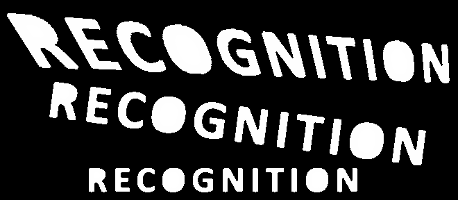

In [39]:
show(img, 200)

In [40]:
def hu_moments(img, contours):
  # create the zeros matrix - num(rows)...num of contours x num(cols)...num of FD
  hm = np.zeros((len(contours), 7))
  # go through all the contours
  for idx, contour in enumerate(contours):
    temp = np.zeros_like(img)
    # paint the selected polygons
    cv.fillPoly(temp, [contour], 255)
    # Calculate Moments
    moments = cv.moments(temp)
    # Calculate Hu Moments
    hm[idx, :] = np.squeeze(cv.HuMoments(moments))
  return hm

HM = hu_moments(img, contours)

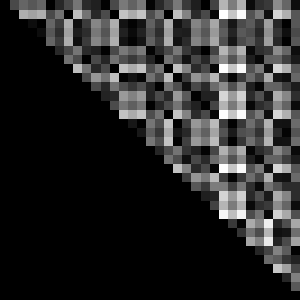

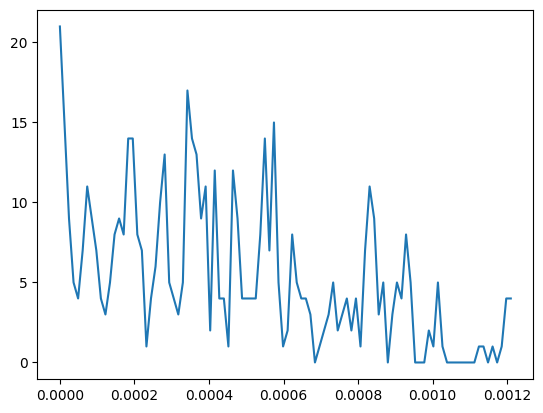

In [41]:
dm_hm = distance_matrix(HM)
show(dm_hm*(255/np.max(dm_hm)),300, interpolation=cv.INTER_NEAREST)
# the histogram of the distance matrix
histogram_var, bins = np.histogram(dm_hm[dm_hm > 0], bins=100)
plt.plot(bins[0:-1], histogram_var)
plt.show()

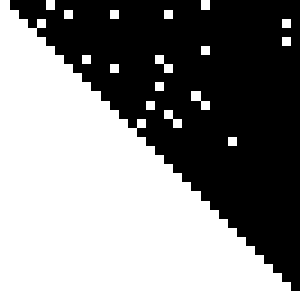

In [42]:
show((dm_hm<0.00001)*255,300, interpolation=cv.INTER_NEAREST)

Show the palette:


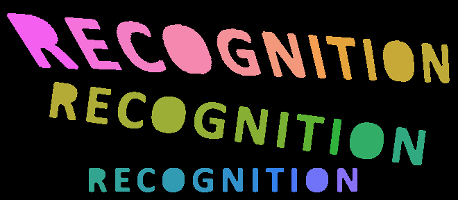

Coloring similar letters:


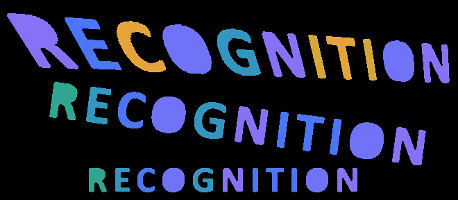

In [43]:
show_classes(img, contours, (dm_hm<0.0001))

# Part 3: Homework

## ✍🏼 Homework 005.1

Write a program that automatically counts the number of nails, screws and wooden blocks. As you can see from the picture, you can rely on the pieces not overlapping and being far enough apart.

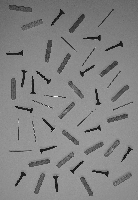

In [68]:
img = cv.imread('recognition.jpg')
img = cv.cvtColor(img, cv.COLOR_RGB2GRAY)
show(img)

In [ ]:
img_ = otsu_local(img, 3, 3)

show(img_*255)

for y in range(img_.shape[1]):
  for x in range(img_.shape[0]):
    if img_[x,y] == 0:
      img_[x,y] = 1
    else:
      img_[x,y] = 0

show(img_*255)

In [ ]:
# ---------------------------


contours, _ = cv.findContours(img_.astype(np.uint8), mode=cv.RETR_LIST, method=cv.CHAIN_APPROX_NONE)

HM = hu_moments(img_, contours)

dm_hm = distance_matrix(HM)

In [88]:
def show_classes_needles(img, contours, dm):
  n = dm.shape[0]
  out = np.zeros_like(img)
  out = cv.merge((out, out, out))
  palette = sns.color_palette("husl", n+5)
  for i in range(n):
    cv.fillPoly(out, [contours[i]], [x * 255 for x in palette[i]])
  print('Show the palette:')
  show(out)

  types_idxs = []
  types = []
  for i in range(n):
    for j in range(i+1, n):
      if dm[i,j]:
        cv.fillPoly(out, [contours[j]],  [x * 255 for x in palette[i]])
        dm[j,:] = 0
        if i in types_idxs:
          types[types_idxs.index(i)].append(j)
        else:
          types_idxs.append(i)
          types.append([i,j])

  for i in types:
    print("Type ", i, " has ", len(types[i]), " instances")
    # for j in i:
    #   temp = out.copy()
    #   cv.fillPoly(temp, [contours[j]], 0)
    #   print("Without contours number: ", j)
    #   show(temp)



  print('Coloring similar letters:')
  show(out)

Show the palette:


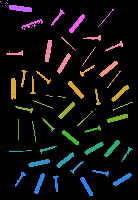

Without contours number:  0


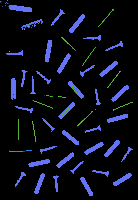

Without contours number:  1


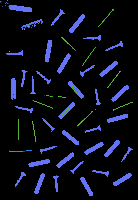

Without contours number:  2


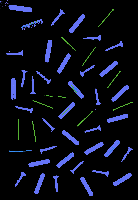

Without contours number:  3


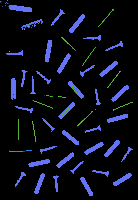

Without contours number:  4


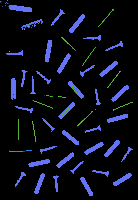

Without contours number:  5


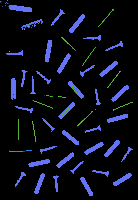

Without contours number:  6


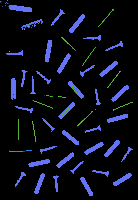

Without contours number:  7


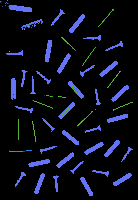

Without contours number:  8


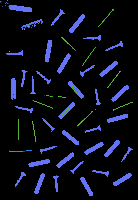

Without contours number:  9


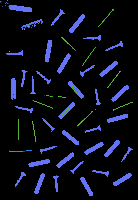

Without contours number:  10


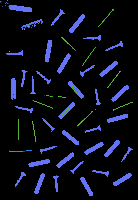

Without contours number:  11


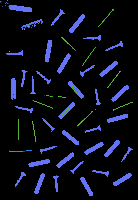

Without contours number:  12


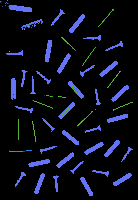

Without contours number:  13


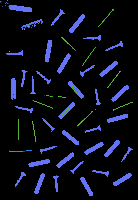

Without contours number:  14


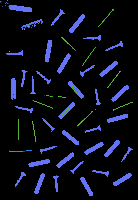

Without contours number:  15


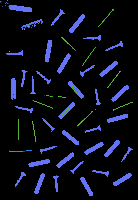

Without contours number:  16


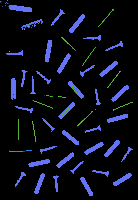

Without contours number:  17


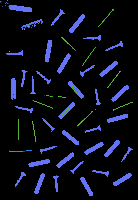

Without contours number:  18


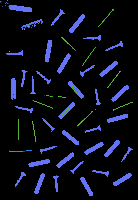

Without contours number:  19


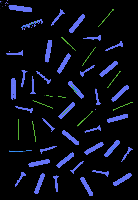

Without contours number:  20


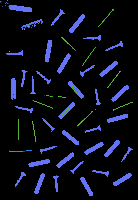

Without contours number:  21


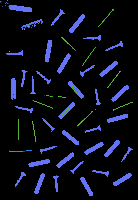

Without contours number:  22


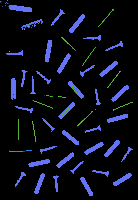

Without contours number:  23


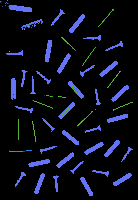

Without contours number:  24


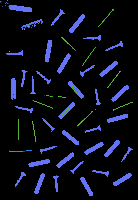

Without contours number:  25


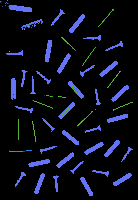

Without contours number:  26


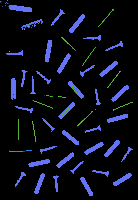

Without contours number:  27


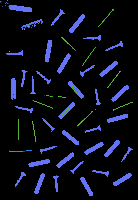

Without contours number:  28


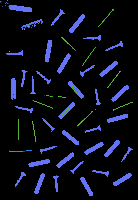

Without contours number:  29


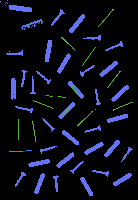

Without contours number:  30


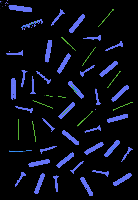

Without contours number:  31


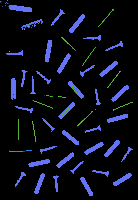

Without contours number:  32


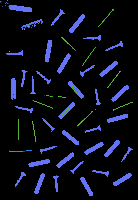

Without contours number:  33


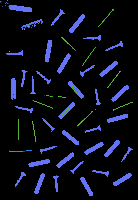

Without contours number:  34


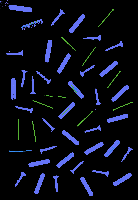

Without contours number:  35


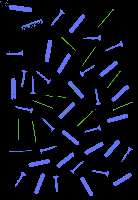

Without contours number:  36


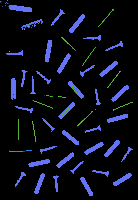

Without contours number:  37


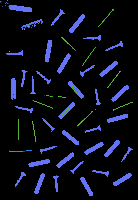

Without contours number:  38


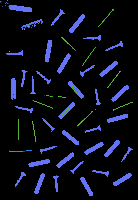

Without contours number:  39


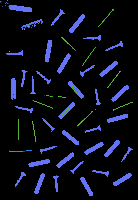

Without contours number:  40


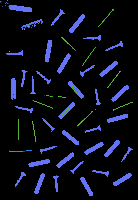

Without contours number:  41


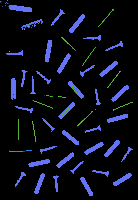

Without contours number:  42


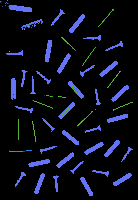

Without contours number:  43


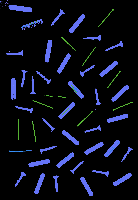

Without contours number:  44


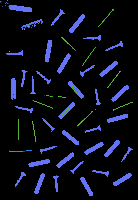

Without contours number:  45


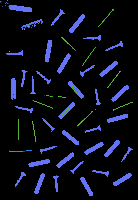

Without contours number:  46


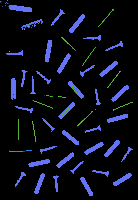

Without contours number:  47


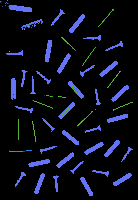

Without contours number:  48


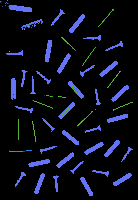

Without contours number:  49


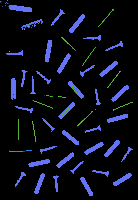

Without contours number:  50


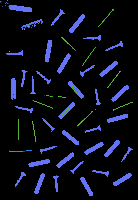

Without contours number:  51


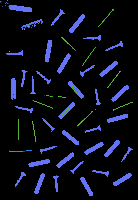

Without contours number:  52


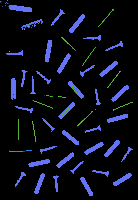

Without contours number:  53


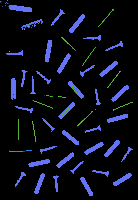

Without contours number:  54


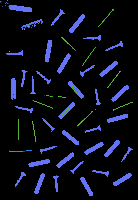

Without contours number:  55


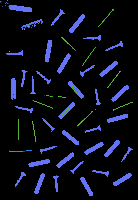

Without contours number:  56


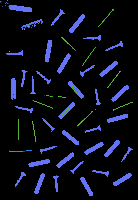

Without contours number:  57


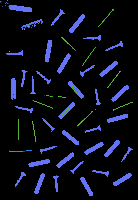

Without contours number:  58


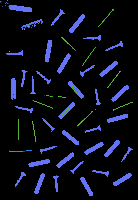

Without contours number:  59


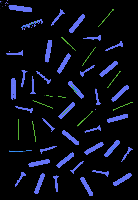

Without contours number:  60


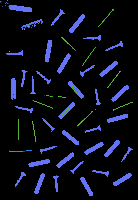

Without contours number:  61


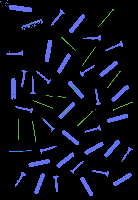

Without contours number:  62


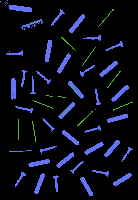

Without contours number:  63


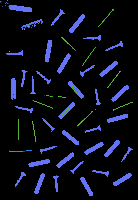

Without contours number:  64


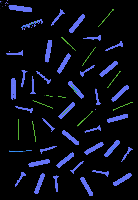

Without contours number:  65


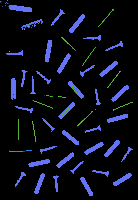

Without contours number:  66


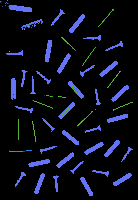

Without contours number:  67


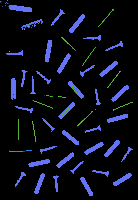

Without contours number:  68


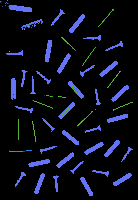

Without contours number:  69


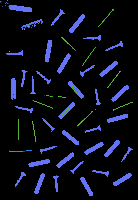

Without contours number:  70


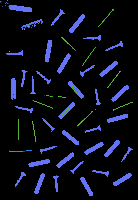

Without contours number:  71


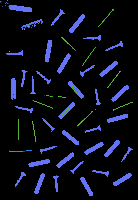

Without contours number:  72


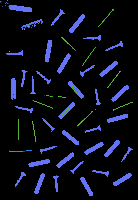

Without contours number:  73


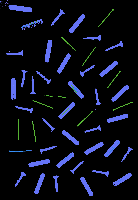

Without contours number:  74


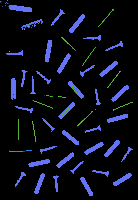

Without contours number:  75


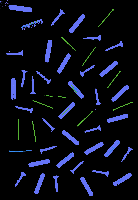

Without contours number:  76


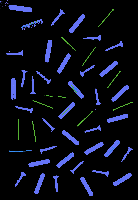

Without contours number:  77


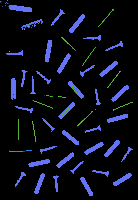

Without contours number:  78


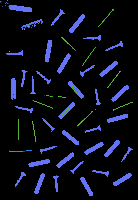

Without contours number:  79


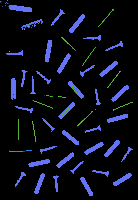

Without contours number:  80


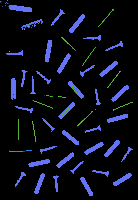

Without contours number:  81


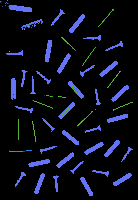

Without contours number:  82


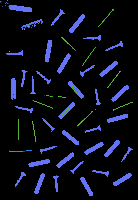

Without contours number:  83


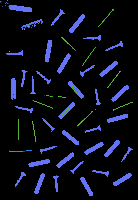

Without contours number:  84


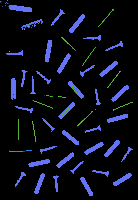

Without contours number:  85


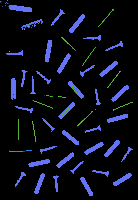

Without contours number:  86


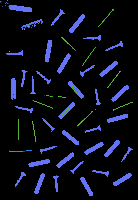

Without contours number:  87


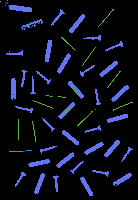

Without contours number:  88


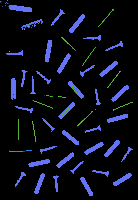

Without contours number:  89


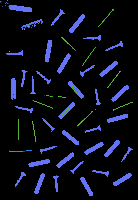

Without contours number:  90


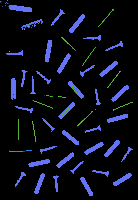

Without contours number:  91


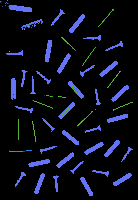

Without contours number:  92


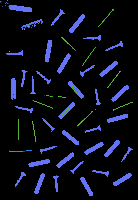

Without contours number:  93


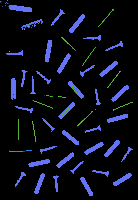

Without contours number:  94


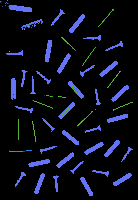

Without contours number:  95


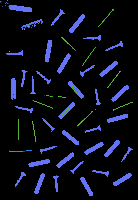

Without contours number:  96


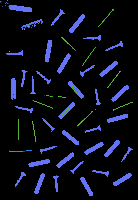

Without contours number:  97


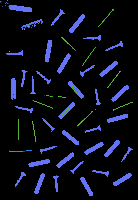

Without contours number:  98


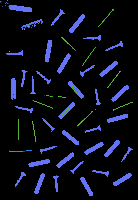

Without contours number:  99


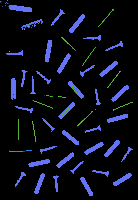

Without contours number:  100


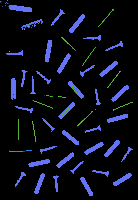

Without contours number:  101


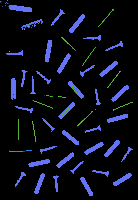

Without contours number:  102


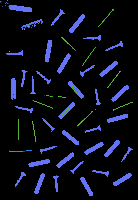

Without contours number:  103


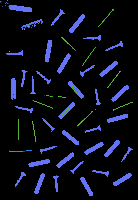

Without contours number:  104


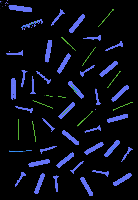

Without contours number:  105


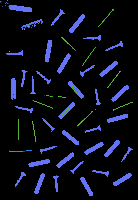

Without contours number:  106


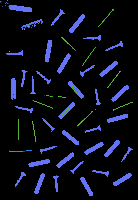

Without contours number:  107


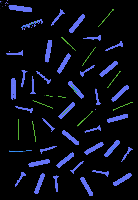

Without contours number:  108


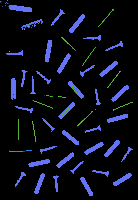

Without contours number:  109


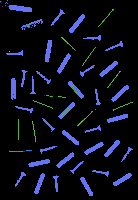

Without contours number:  110


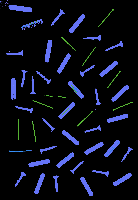

Without contours number:  111


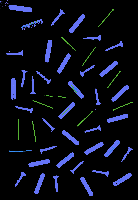

Without contours number:  112


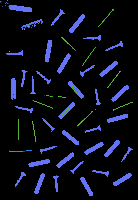

Without contours number:  113


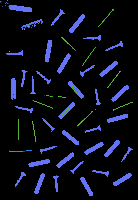

Without contours number:  114


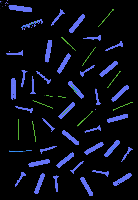

Without contours number:  115


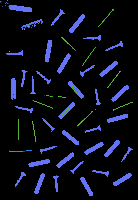

Without contours number:  116


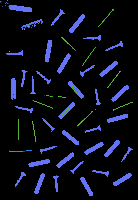

Without contours number:  117


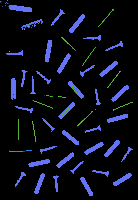

Without contours number:  118


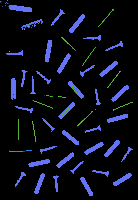

Without contours number:  119


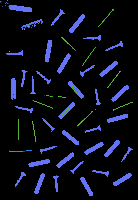

Without contours number:  120


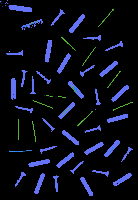

Without contours number:  121


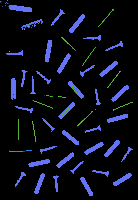

Without contours number:  122


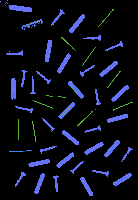

Without contours number:  123


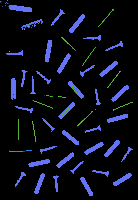

Without contours number:  124


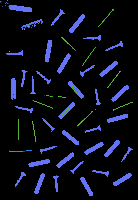

Without contours number:  125


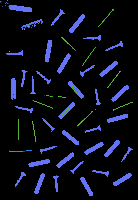

Without contours number:  126


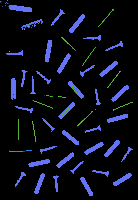

Without contours number:  127


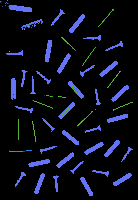

Without contours number:  128


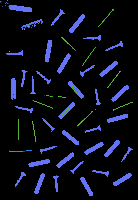

Without contours number:  129


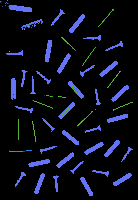

Without contours number:  130


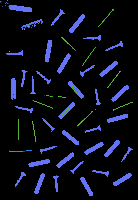

Without contours number:  131


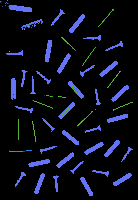

Without contours number:  132


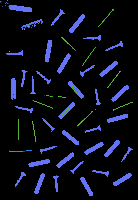

Without contours number:  133


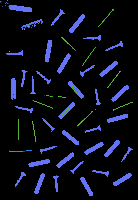

Without contours number:  134


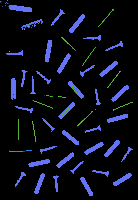

Without contours number:  135


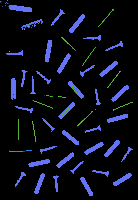

Without contours number:  136


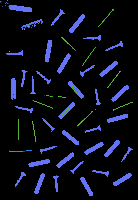

Without contours number:  137


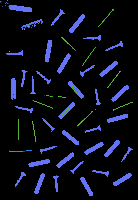

Without contours number:  138


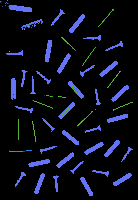

Without contours number:  139


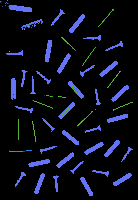

Without contours number:  140


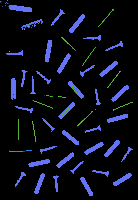

Without contours number:  141


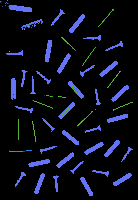

Without contours number:  142


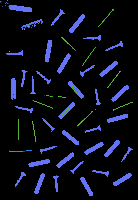

Without contours number:  143


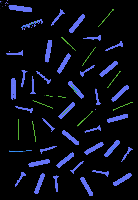

Without contours number:  144


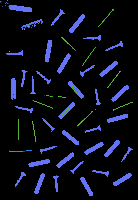

Without contours number:  145


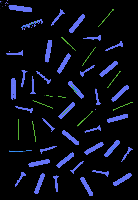

Without contours number:  146


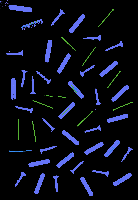

Without contours number:  147


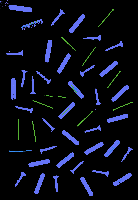

Without contours number:  148


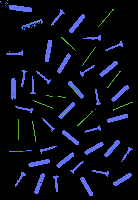

Without contours number:  149


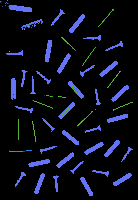

Without contours number:  150


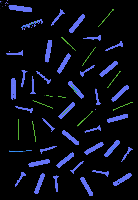

Without contours number:  151


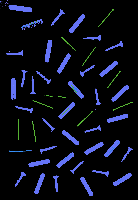

Without contours number:  152


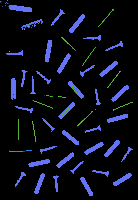

Without contours number:  153


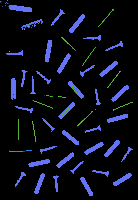

Without contours number:  154


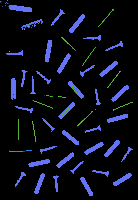

Without contours number:  155


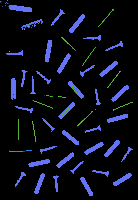

Without contours number:  156


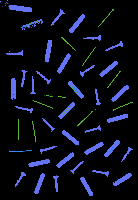

Without contours number:  157


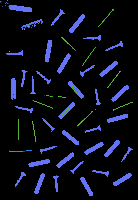

Without contours number:  158


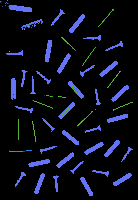

Without contours number:  160


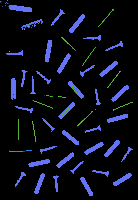

Without contours number:  161


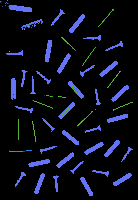

Without contours number:  162


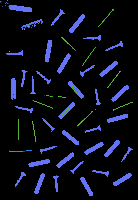

Without contours number:  163


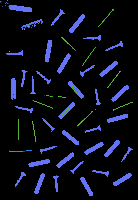

Without contours number:  164


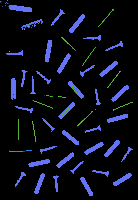

Without contours number:  165


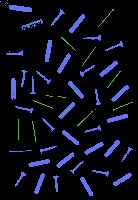

Without contours number:  166


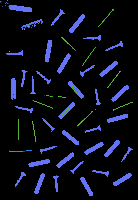

Without contours number:  167


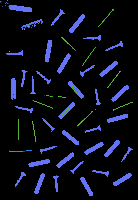

Without contours number:  168


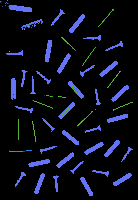

Without contours number:  169


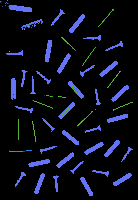

Without contours number:  170


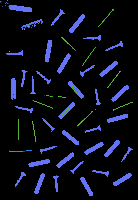

Without contours number:  171


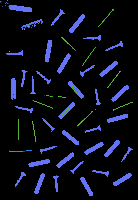

Without contours number:  172


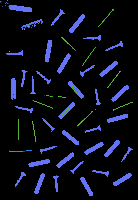

Without contours number:  173


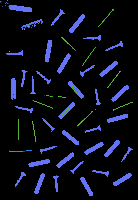

Without contours number:  174


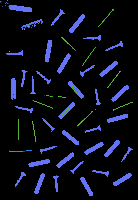

Without contours number:  175


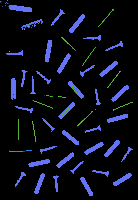

Without contours number:  176


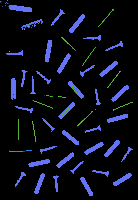

Without contours number:  177


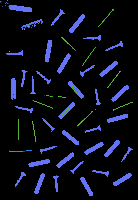

Without contours number:  178


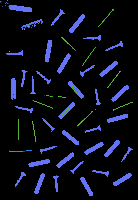

Without contours number:  179


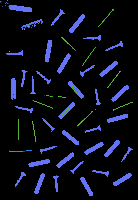

Without contours number:  180


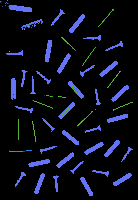

Without contours number:  181


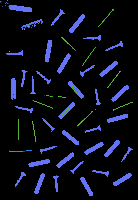

Without contours number:  182


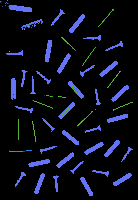

Without contours number:  183


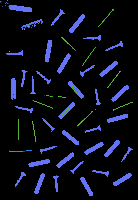

Without contours number:  184


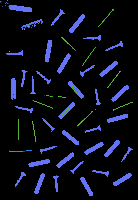

Without contours number:  185


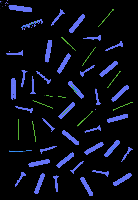

Without contours number:  186


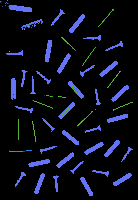

Without contours number:  187


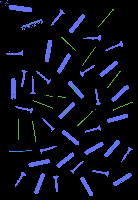

Without contours number:  188


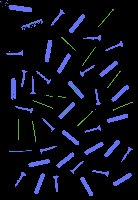

Without contours number:  189


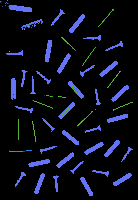

Without contours number:  190


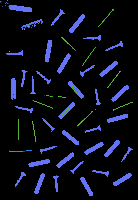

Without contours number:  191


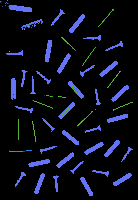

Without contours number:  192


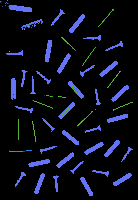

Without contours number:  193


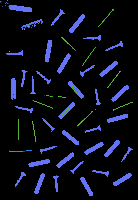

Without contours number:  194


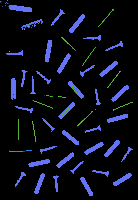

Without contours number:  195


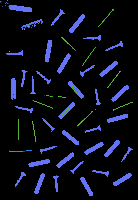

Without contours number:  196


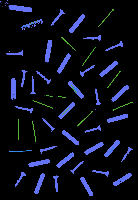

Without contours number:  197


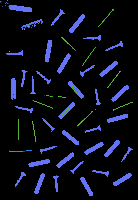

Without contours number:  198


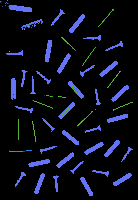

Without contours number:  199


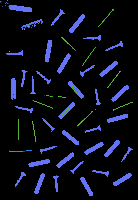

Without contours number:  200


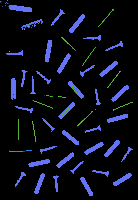

Without contours number:  201


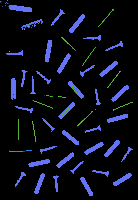

Without contours number:  202


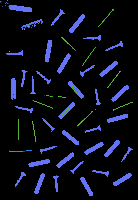

Without contours number:  203


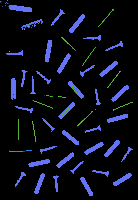

Without contours number:  204


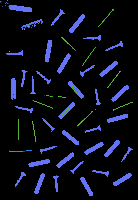

Without contours number:  205


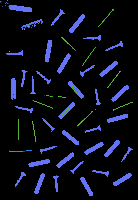

Without contours number:  206


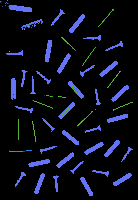

Without contours number:  207


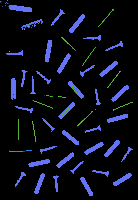

Without contours number:  208


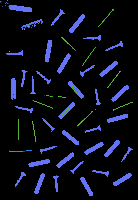

Without contours number:  209


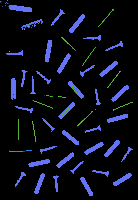

Without contours number:  210


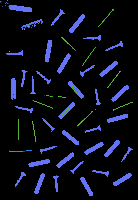

Without contours number:  211


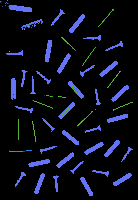

Without contours number:  212


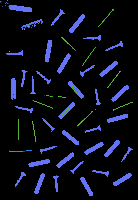

Without contours number:  213


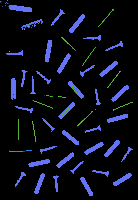

Without contours number:  214


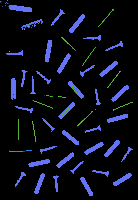

Without contours number:  215


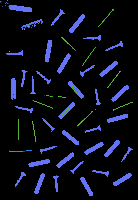

Without contours number:  216


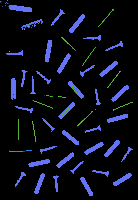

Without contours number:  217


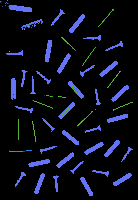

Without contours number:  218


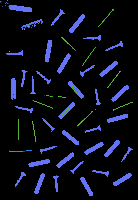

Without contours number:  219


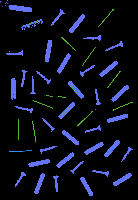

Without contours number:  220


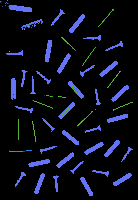

Without contours number:  221


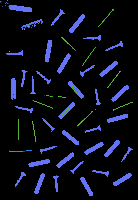

Without contours number:  222


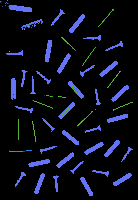

Without contours number:  223


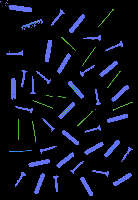

Without contours number:  224


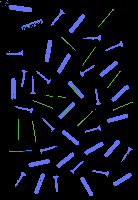

Without contours number:  225


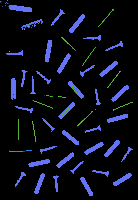

Without contours number:  226


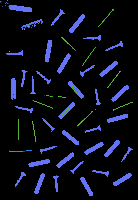

Without contours number:  227


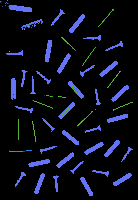

Without contours number:  228


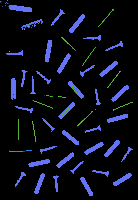

Without contours number:  229


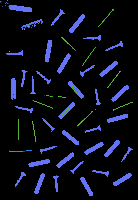

Without contours number:  230


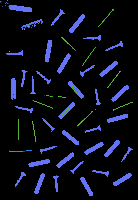

Without contours number:  231


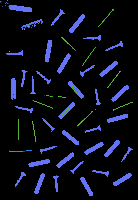

Without contours number:  232


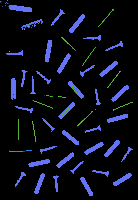

Without contours number:  233


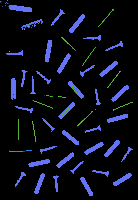

Without contours number:  234


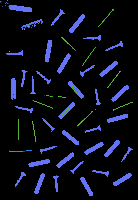

Without contours number:  235


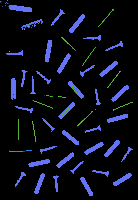

Without contours number:  236


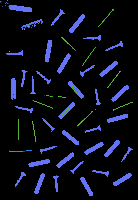

Without contours number:  237


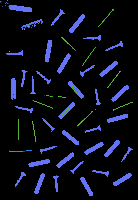

Without contours number:  238


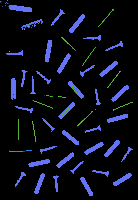

Without contours number:  239


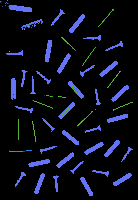

Without contours number:  240


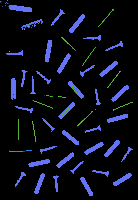

Without contours number:  241


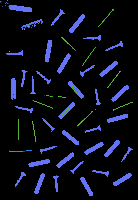

Without contours number:  242


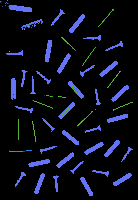

Without contours number:  243


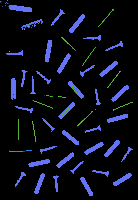

Without contours number:  244


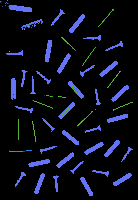

Without contours number:  245


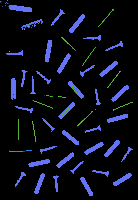

Without contours number:  246


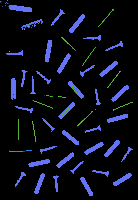

Without contours number:  247


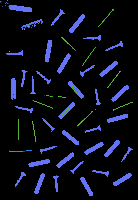

Without contours number:  248


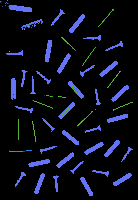

Without contours number:  249


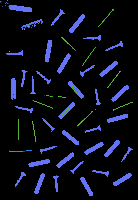

Without contours number:  250


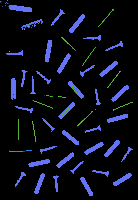

Without contours number:  251


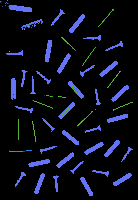

Without contours number:  252


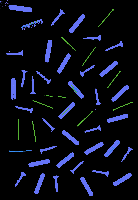

Without contours number:  253


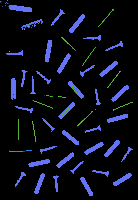

Without contours number:  254


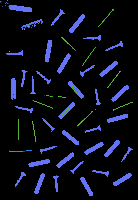

Without contours number:  255


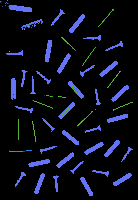

Without contours number:  256


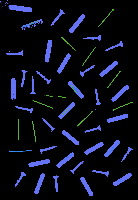

Without contours number:  257


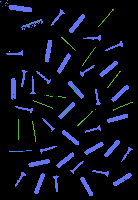

Without contours number:  258


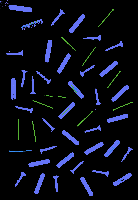

Without contours number:  259


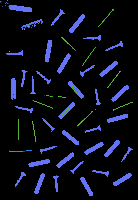

Without contours number:  260


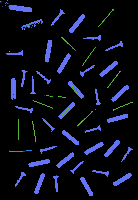

Without contours number:  261


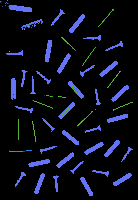

Without contours number:  262


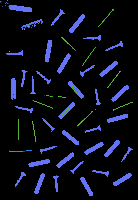

Without contours number:  263


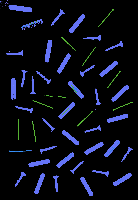

Without contours number:  264


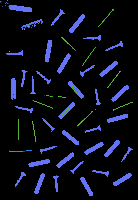

Without contours number:  265


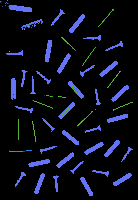

Without contours number:  266


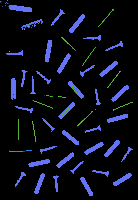

Without contours number:  267


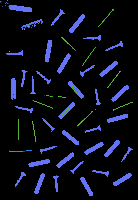

Without contours number:  268


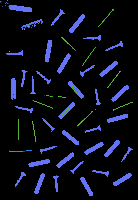

Without contours number:  269


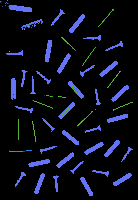

Without contours number:  270


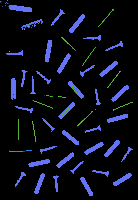

Without contours number:  271


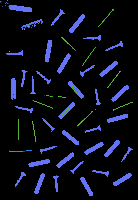

Without contours number:  272


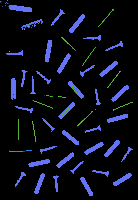

Without contours number:  273


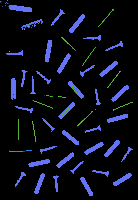

Without contours number:  274


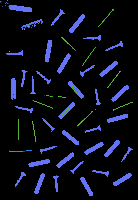

Without contours number:  275


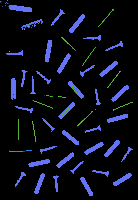

Without contours number:  276


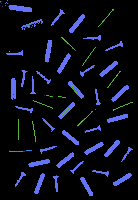

Without contours number:  277


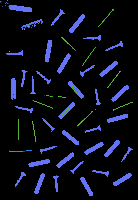

Without contours number:  278


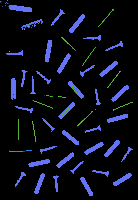

Without contours number:  279


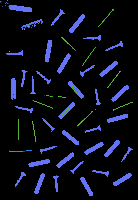

Without contours number:  280


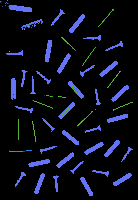

Without contours number:  281


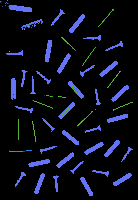

Without contours number:  282


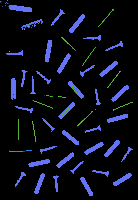

Without contours number:  283


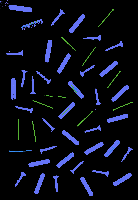

Without contours number:  284


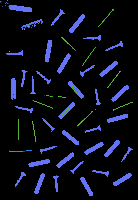

Without contours number:  285


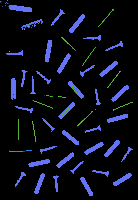

Without contours number:  286


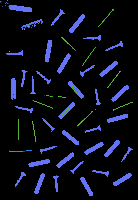

Without contours number:  287


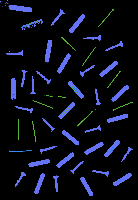

Without contours number:  288


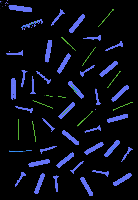

Without contours number:  289


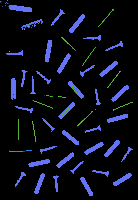

Without contours number:  290


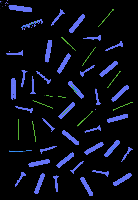

Without contours number:  291


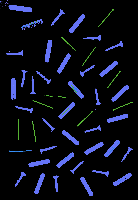

Without contours number:  292


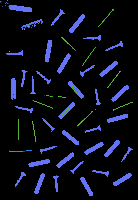

Without contours number:  293


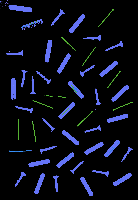

Without contours number:  294


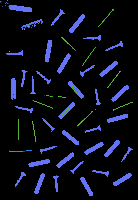

Without contours number:  296


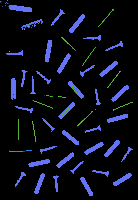

Without contours number:  297


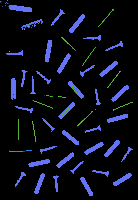

Without contours number:  298


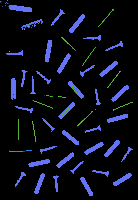

Without contours number:  299


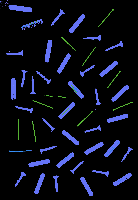

Without contours number:  300


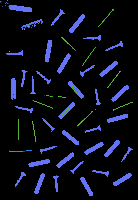

Without contours number:  301


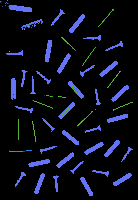

Without contours number:  303


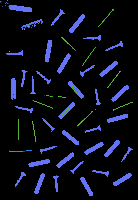

Without contours number:  304


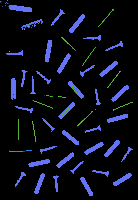

Without contours number:  305


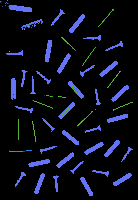

Without contours number:  306


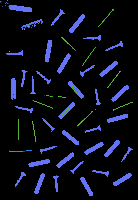

Without contours number:  307


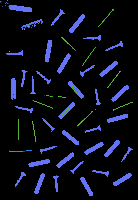

Without contours number:  308


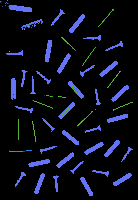

Without contours number:  309


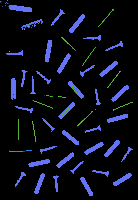

Without contours number:  310


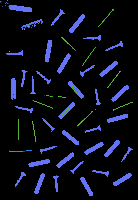

Without contours number:  311


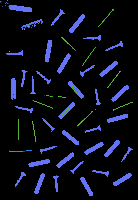

Without contours number:  312


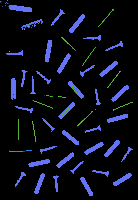

Without contours number:  313


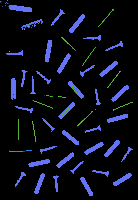

Without contours number:  314


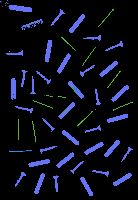

Without contours number:  315


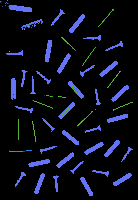

Without contours number:  316


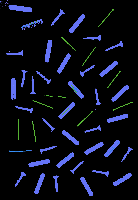

Without contours number:  317


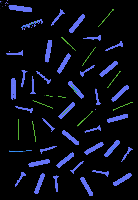

Without contours number:  318


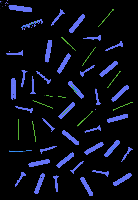

Without contours number:  319


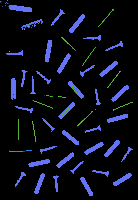

Without contours number:  320


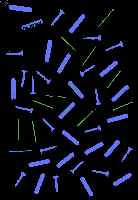

Without contours number:  321


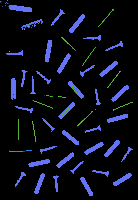

Without contours number:  322


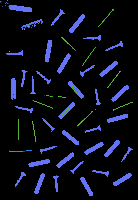

Without contours number:  323


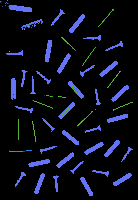

Without contours number:  324


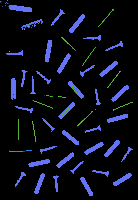

Without contours number:  325


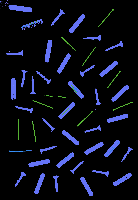

Without contours number:  326


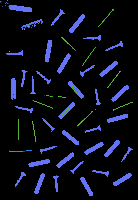

Without contours number:  327


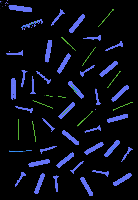

Without contours number:  328


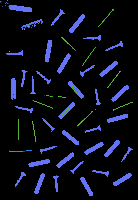

Without contours number:  329


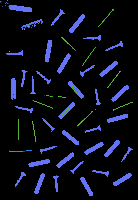

Without contours number:  330


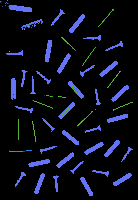

Without contours number:  331


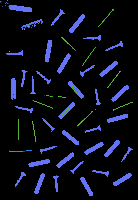

Without contours number:  332


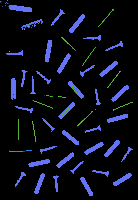

Without contours number:  333


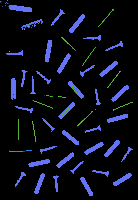

Without contours number:  334


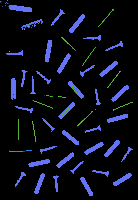

Without contours number:  335


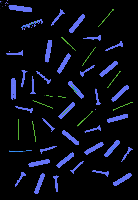

Without contours number:  336


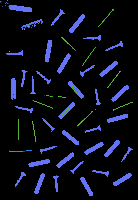

Without contours number:  337


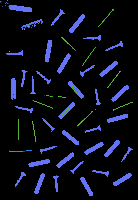

Without contours number:  338


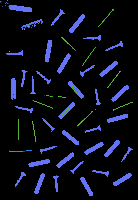

Without contours number:  339


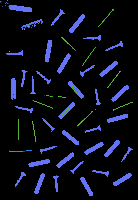

Without contours number:  340


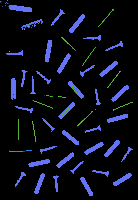

Without contours number:  341


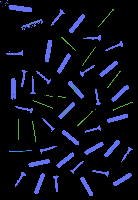

Without contours number:  342


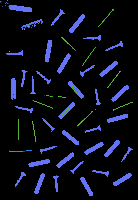

Without contours number:  343


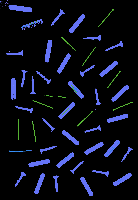

Without contours number:  344


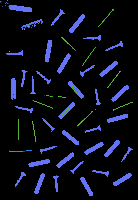

Without contours number:  345


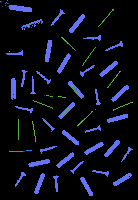

Without contours number:  346


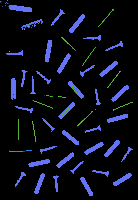

Without contours number:  347


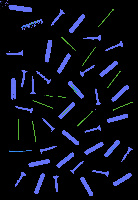

Without contours number:  348


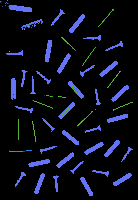

Without contours number:  349


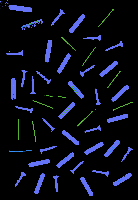

Without contours number:  350


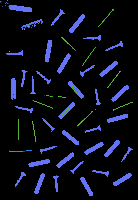

Without contours number:  351


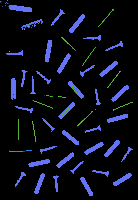

Without contours number:  352


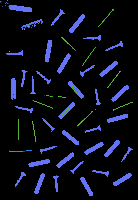

Without contours number:  353


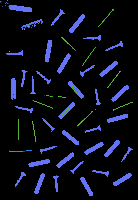

Without contours number:  354


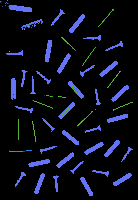

Without contours number:  355


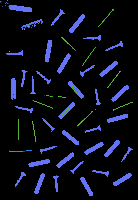

Without contours number:  356


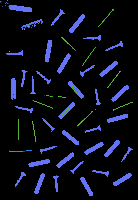

Without contours number:  357


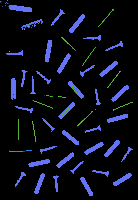

Without contours number:  358


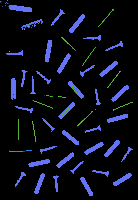

Without contours number:  359


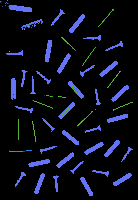

Without contours number:  360


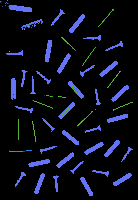

Without contours number:  361


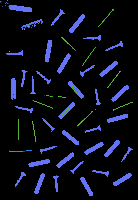

Without contours number:  362


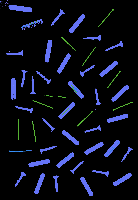

Without contours number:  363


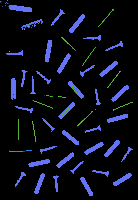

Without contours number:  364


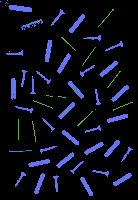

Without contours number:  365


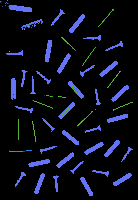

Without contours number:  367


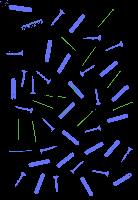

Without contours number:  368


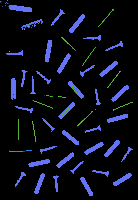

Without contours number:  369


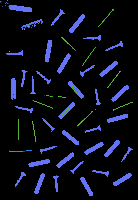

Without contours number:  370


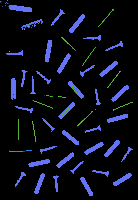

Without contours number:  371


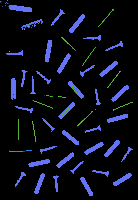

Without contours number:  372


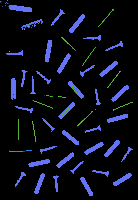

Without contours number:  373


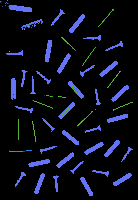

Without contours number:  374


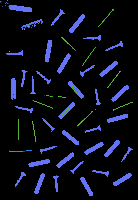

Without contours number:  375


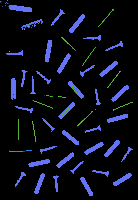

Without contours number:  376


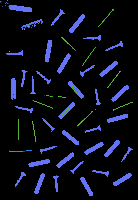

Without contours number:  377


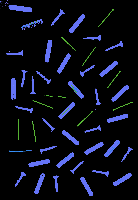

Without contours number:  378


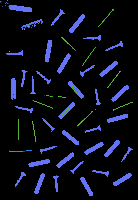

Without contours number:  379


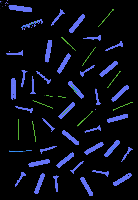

Without contours number:  380


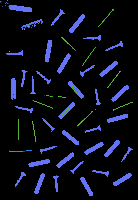

Without contours number:  381


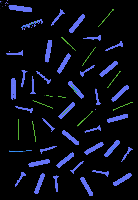

Without contours number:  382


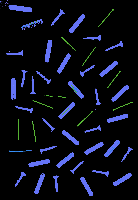

Without contours number:  384


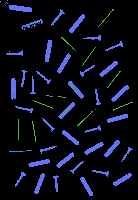

Without contours number:  385


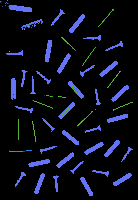

Without contours number:  386


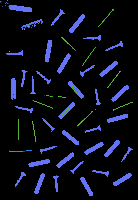

Without contours number:  387


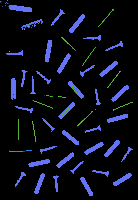

Without contours number:  388


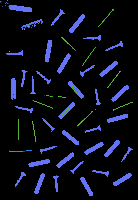

Without contours number:  389


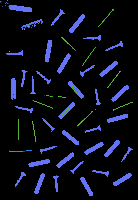

Without contours number:  390


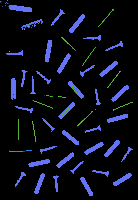

Without contours number:  391


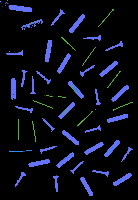

Without contours number:  392


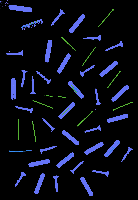

Without contours number:  393


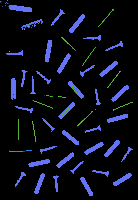

Without contours number:  395


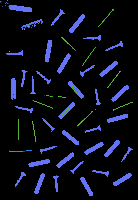

Without contours number:  396


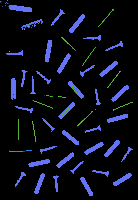

Without contours number:  397


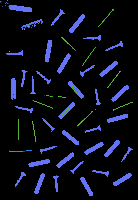

Without contours number:  399


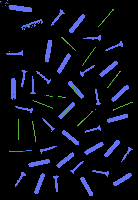

Without contours number:  400


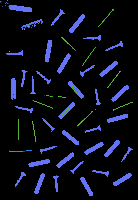

Without contours number:  401


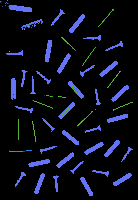

Without contours number:  402


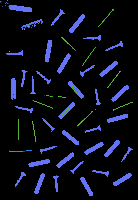

Without contours number:  403


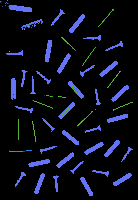

Without contours number:  404


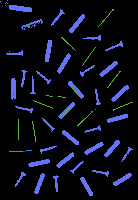

Without contours number:  405


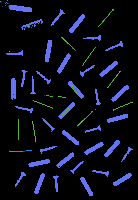

Without contours number:  406


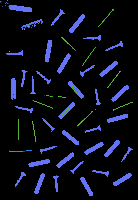

Without contours number:  407


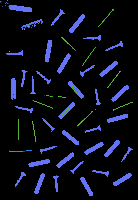

Without contours number:  408


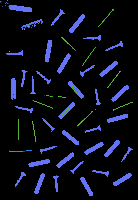

Without contours number:  409


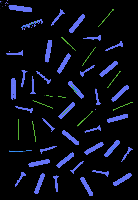

Without contours number:  410


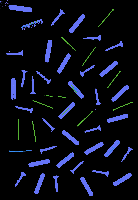

Without contours number:  411


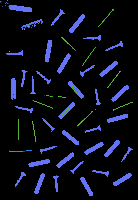

Without contours number:  412


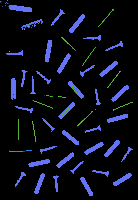

Without contours number:  413


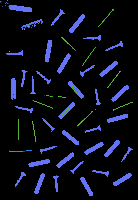

Without contours number:  414


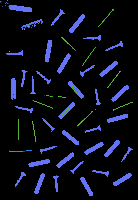

Without contours number:  415


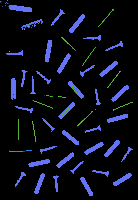

Without contours number:  416


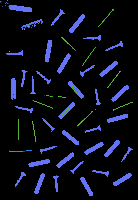

Without contours number:  417


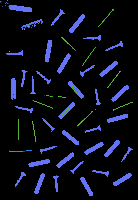

Without contours number:  418


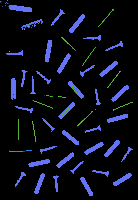

Without contours number:  419


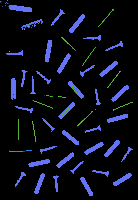

Without contours number:  420


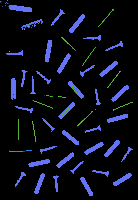

Without contours number:  421


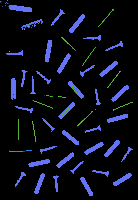

Without contours number:  422


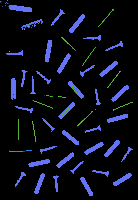

Without contours number:  423


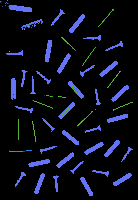

Without contours number:  424


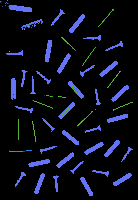

Without contours number:  425


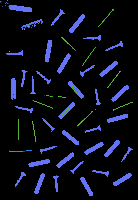

Without contours number:  426


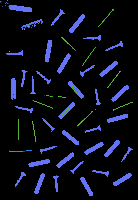

Without contours number:  427


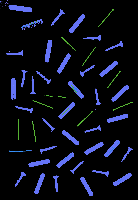

Without contours number:  428


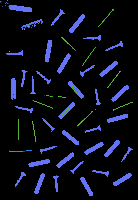

Without contours number:  429


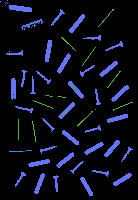

Without contours number:  430


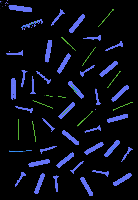

Without contours number:  431


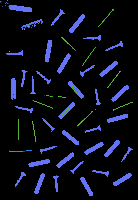

Without contours number:  432


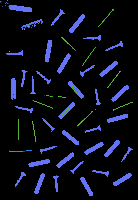

Without contours number:  433


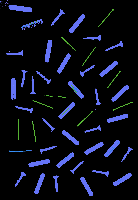

Without contours number:  434


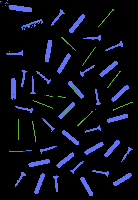

Without contours number:  435


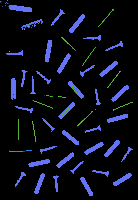

Without contours number:  436


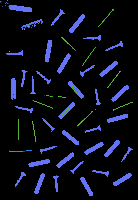

Without contours number:  437


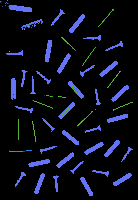

Without contours number:  438


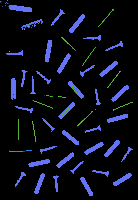

Without contours number:  439


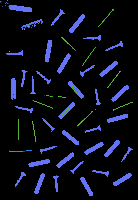

Without contours number:  440


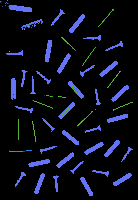

Without contours number:  441


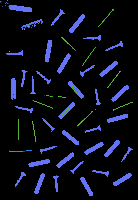

Without contours number:  442


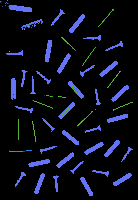

Without contours number:  443


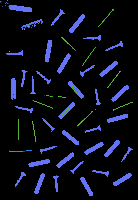

Without contours number:  444


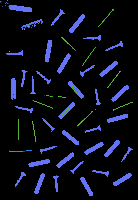

Without contours number:  445


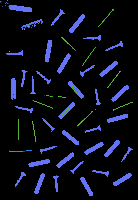

Without contours number:  446


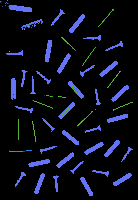

Without contours number:  447


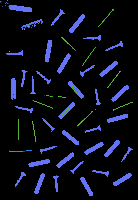

Without contours number:  448


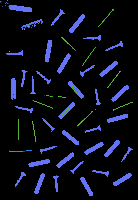

Without contours number:  449


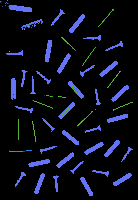

Without contours number:  450


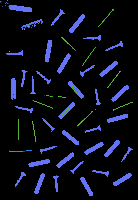

Without contours number:  451


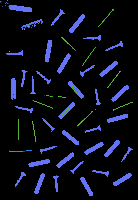

Without contours number:  452


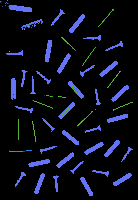

Without contours number:  453


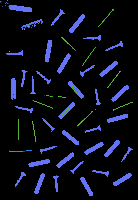

Without contours number:  454


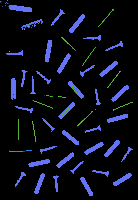

Without contours number:  455


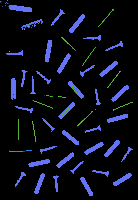

Without contours number:  456


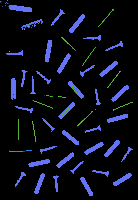

Without contours number:  457


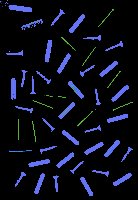

Without contours number:  458


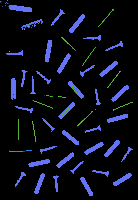

Without contours number:  459


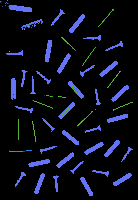

Without contours number:  460


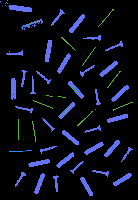

Without contours number:  461


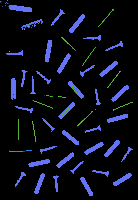

Without contours number:  462


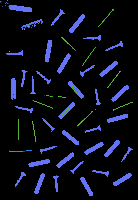

Without contours number:  463


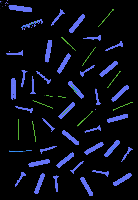

Without contours number:  464


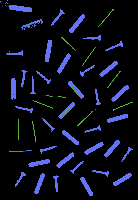

Without contours number:  465


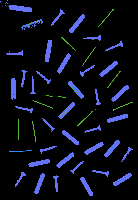

Without contours number:  466


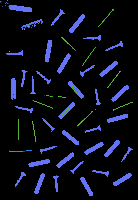

Without contours number:  467


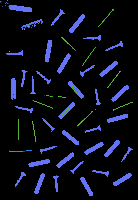

Without contours number:  468


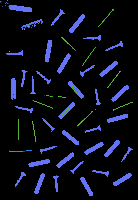

Without contours number:  469


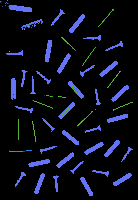

Without contours number:  470


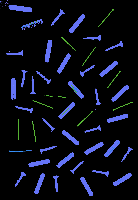

Without contours number:  471


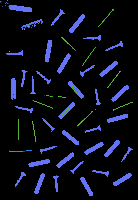

Without contours number:  472


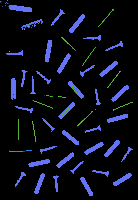

Without contours number:  473


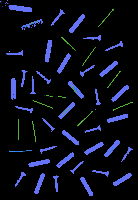

Without contours number:  474


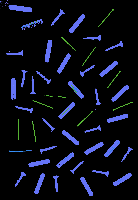

Without contours number:  475


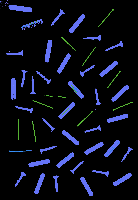

Without contours number:  476


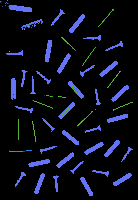

Without contours number:  477


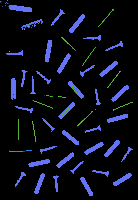

Without contours number:  478


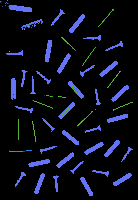

Without contours number:  479


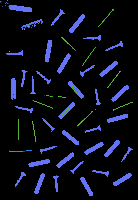

Without contours number:  480


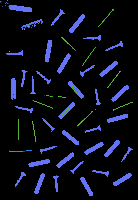

Without contours number:  481


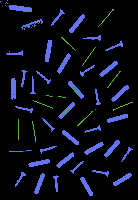

Without contours number:  482


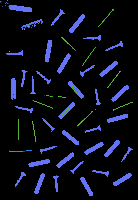

Without contours number:  483


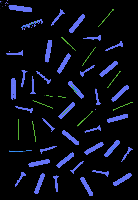

Without contours number:  484


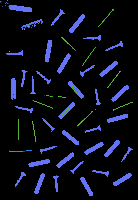

Without contours number:  485


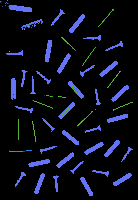

Without contours number:  486


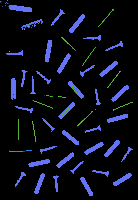

Without contours number:  487


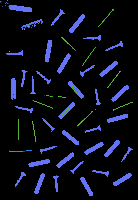

Without contours number:  488


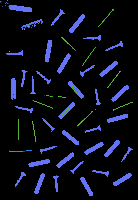

Without contours number:  489


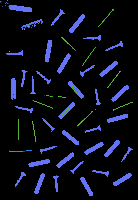

Without contours number:  490


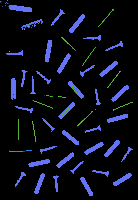

Without contours number:  491


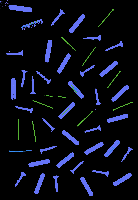

Without contours number:  492


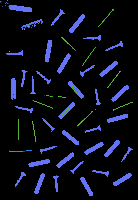

Without contours number:  493


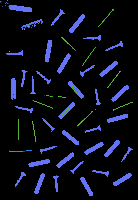

Without contours number:  494


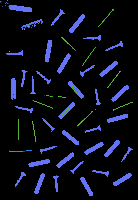

Without contours number:  495


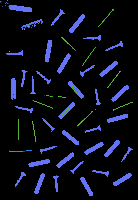

Without contours number:  496


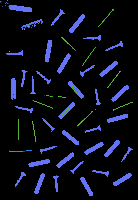

Without contours number:  497


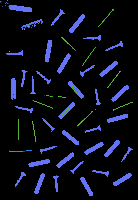

Without contours number:  498


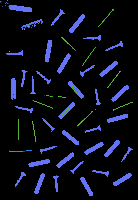

Without contours number:  499


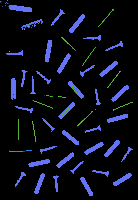

Without contours number:  500


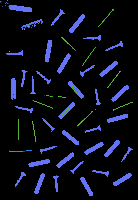

Without contours number:  501


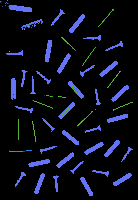

Without contours number:  502


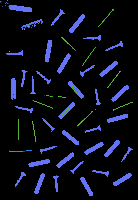

Without contours number:  503


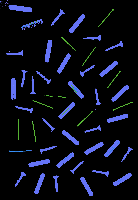

Without contours number:  504


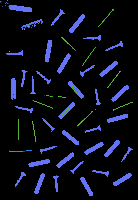

Without contours number:  505


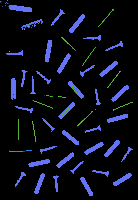

Without contours number:  506


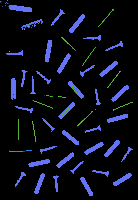

Without contours number:  507


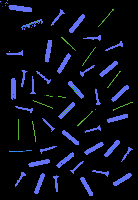

Without contours number:  508


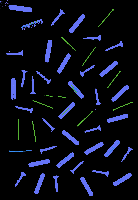

Without contours number:  509


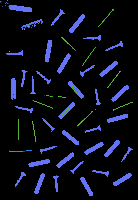

Without contours number:  510


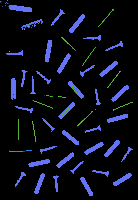

Without contours number:  511


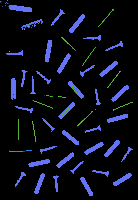

Without contours number:  512


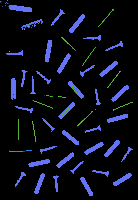

Without contours number:  513


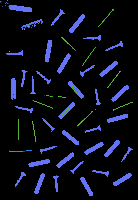

Without contours number:  514


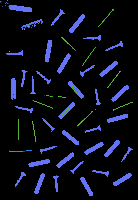

Without contours number:  515


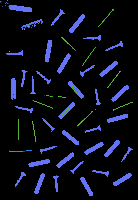

Without contours number:  516


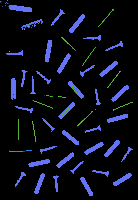

Without contours number:  517


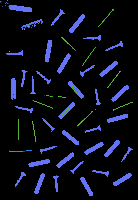

Without contours number:  518


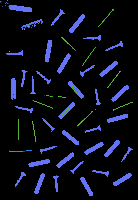

Without contours number:  519


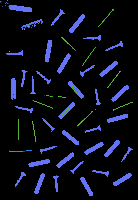

Without contours number:  520


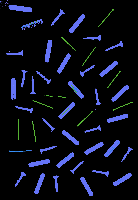

Without contours number:  521


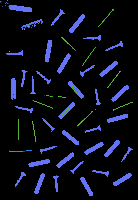

Without contours number:  522


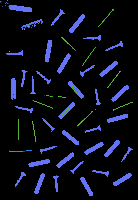

Without contours number:  523


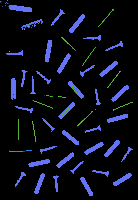

Without contours number:  524


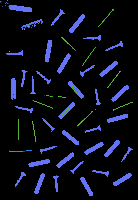

Without contours number:  525


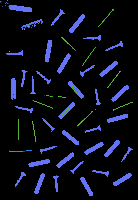

Without contours number:  526


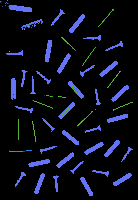

Without contours number:  527


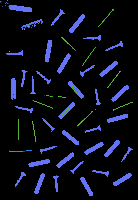

Without contours number:  528


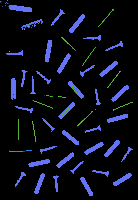

Without contours number:  529


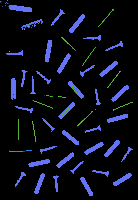

Without contours number:  530


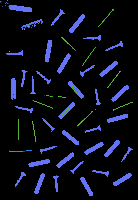

Without contours number:  531


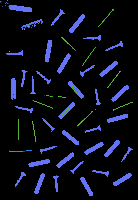

Without contours number:  532


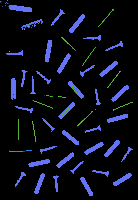

Without contours number:  533


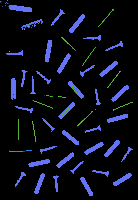

Without contours number:  534


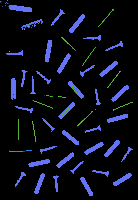

Without contours number:  535


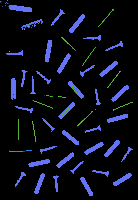

Without contours number:  536


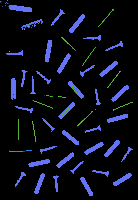

Without contours number:  537


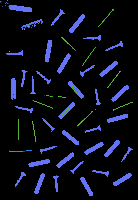

Without contours number:  538


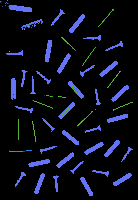

Without contours number:  539


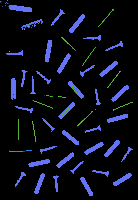

Without contours number:  540


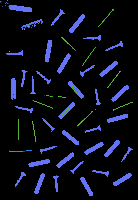

Without contours number:  541


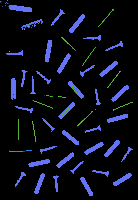

Without contours number:  542


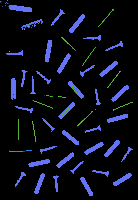

Without contours number:  543


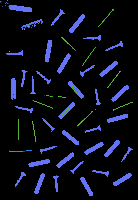

Without contours number:  544


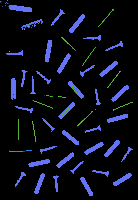

Without contours number:  545


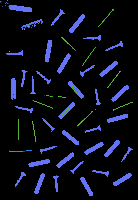

Without contours number:  546


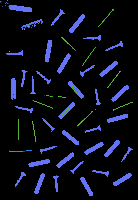

Without contours number:  547


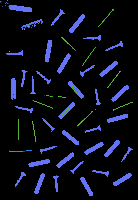

Without contours number:  548


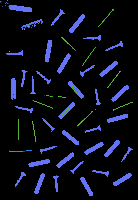

Without contours number:  549


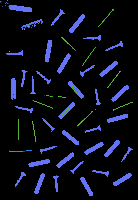

Without contours number:  550


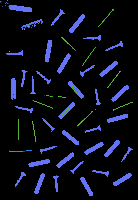

Without contours number:  551


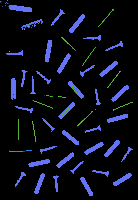

Without contours number:  552


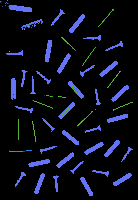

Without contours number:  553


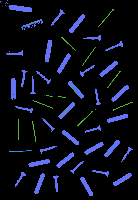

Without contours number:  554


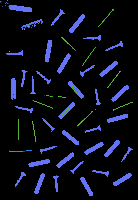

Without contours number:  555


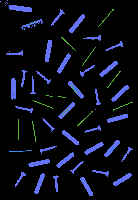

Without contours number:  556


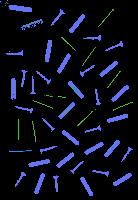

Without contours number:  557


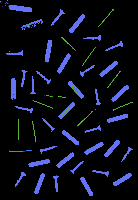

Without contours number:  558


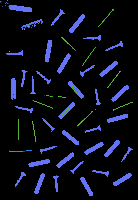

Without contours number:  559


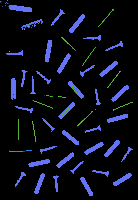

Without contours number:  560


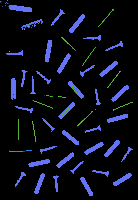

Without contours number:  561


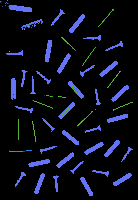

Without contours number:  562


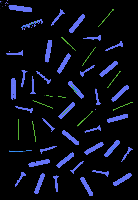

Without contours number:  563


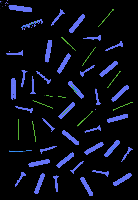

Without contours number:  564


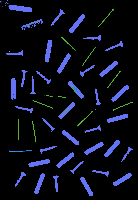

Without contours number:  565


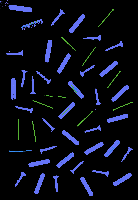

Without contours number:  566


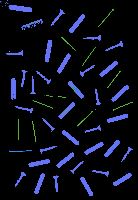

Without contours number:  567


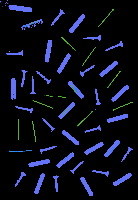

Without contours number:  568


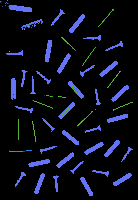

Without contours number:  569


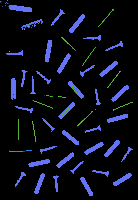

Without contours number:  570


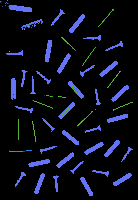

Without contours number:  571


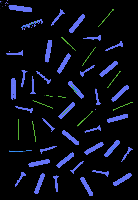

Without contours number:  572


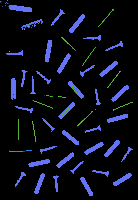

Without contours number:  573


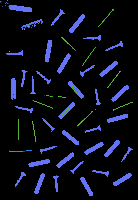

Without contours number:  574


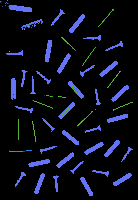

Without contours number:  576


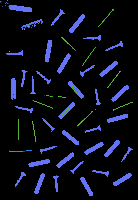

Without contours number:  577


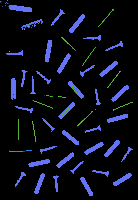

Without contours number:  578


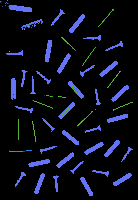

Without contours number:  579


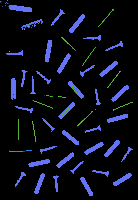

Without contours number:  580


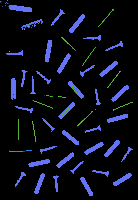

Without contours number:  581


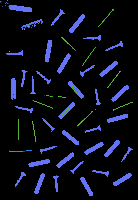

Without contours number:  582


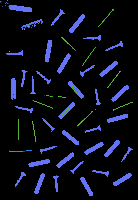

Without contours number:  583


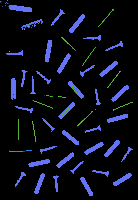

Without contours number:  584


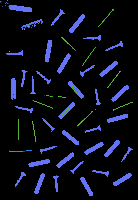

Without contours number:  585


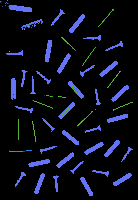

Without contours number:  586


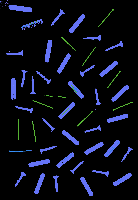

Without contours number:  587


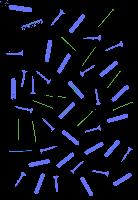

Without contours number:  588


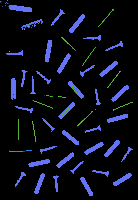

Without contours number:  589


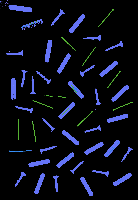

Without contours number:  590


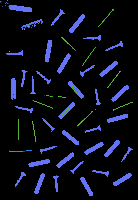

Without contours number:  591


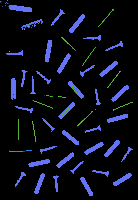

Without contours number:  592


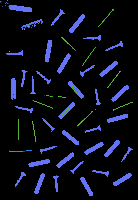

Without contours number:  593


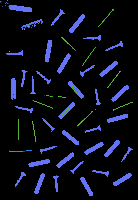

Without contours number:  594


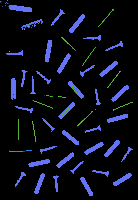

Without contours number:  595


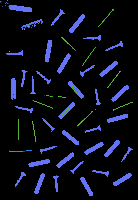

Without contours number:  596


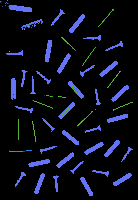

Without contours number:  597


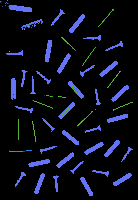

Without contours number:  598


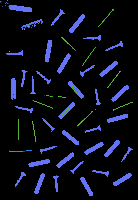

Without contours number:  599


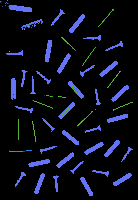

Without contours number:  600


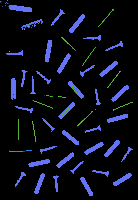

Without contours number:  601


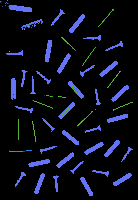

Without contours number:  602


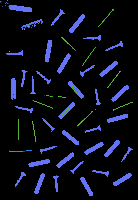

Without contours number:  603


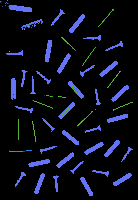

Without contours number:  604


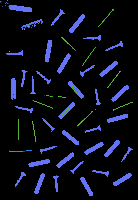

Without contours number:  605


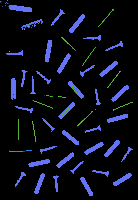

Without contours number:  606


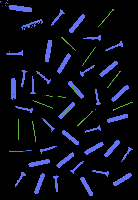

Without contours number:  607


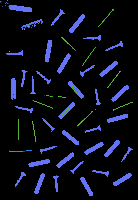

Without contours number:  608


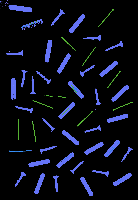

Without contours number:  609


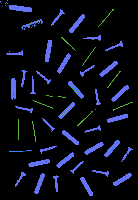

Without contours number:  610


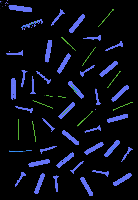

Without contours number:  611


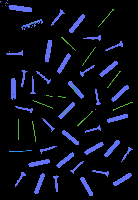

Without contours number:  612


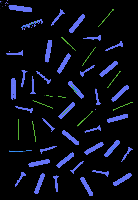

Without contours number:  613


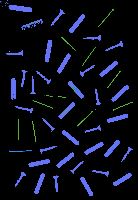

Without contours number:  614


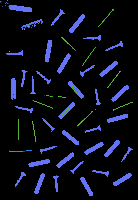

Without contours number:  615


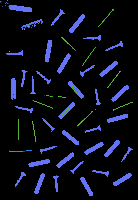

Without contours number:  616


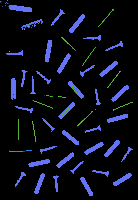

Without contours number:  617


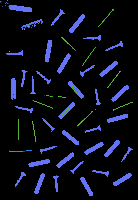

Without contours number:  618


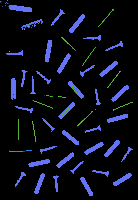

Without contours number:  619


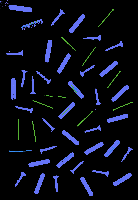

Without contours number:  620


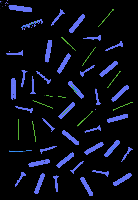

Without contours number:  621


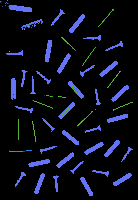

Without contours number:  622


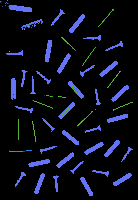

Without contours number:  623


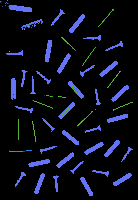

Without contours number:  624


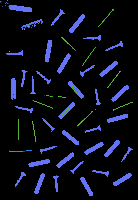

Without contours number:  625


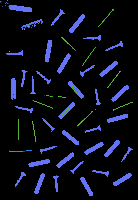

Without contours number:  626


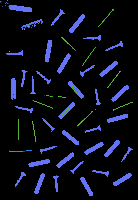

Without contours number:  627


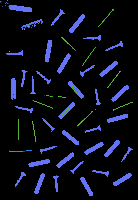

Without contours number:  628


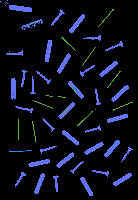

Without contours number:  629


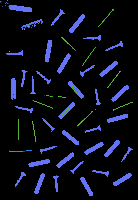

Without contours number:  630


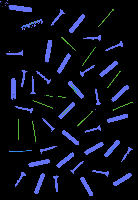

Without contours number:  632


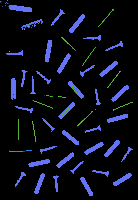

Without contours number:  634


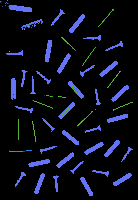

Without contours number:  635


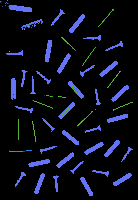

Without contours number:  636


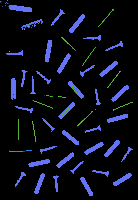

Without contours number:  637


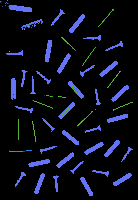

Without contours number:  638


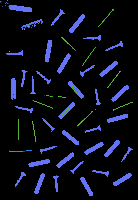

Without contours number:  640


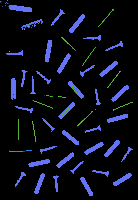

Without contours number:  641


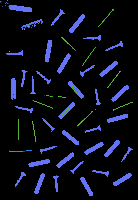

Without contours number:  642


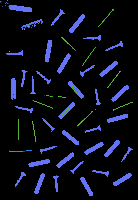

Without contours number:  643


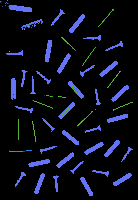

Without contours number:  644


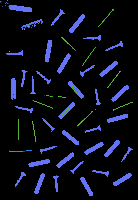

Without contours number:  645


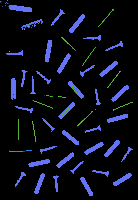

Without contours number:  646


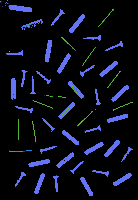

Without contours number:  647


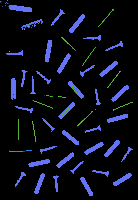

Without contours number:  648


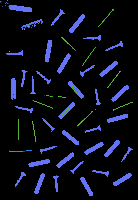

Without contours number:  649


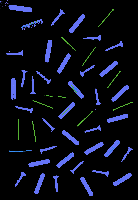

Without contours number:  650


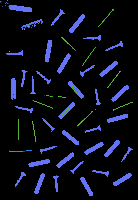

Without contours number:  651


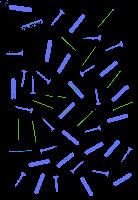

Without contours number:  652


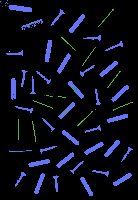

Without contours number:  653


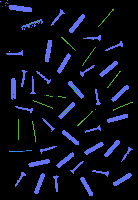

Without contours number:  654


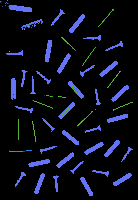

Without contours number:  655


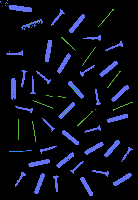

Without contours number:  656


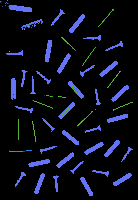

Without contours number:  657


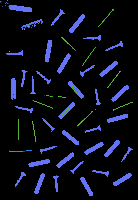

Without contours number:  658


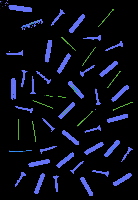

Without contours number:  659


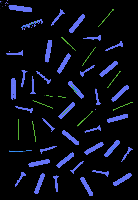

Without contours number:  660


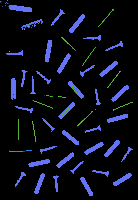

Without contours number:  661


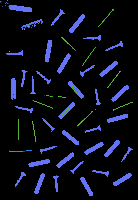

Without contours number:  662


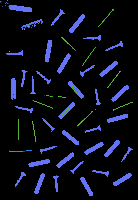

Without contours number:  663


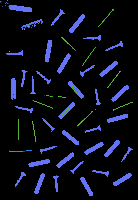

Without contours number:  664


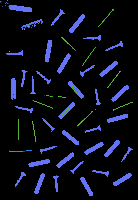

Without contours number:  666


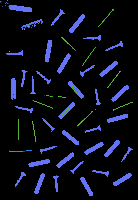

Without contours number:  667


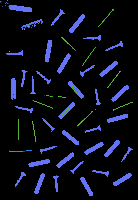

Without contours number:  668


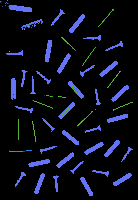

Without contours number:  669


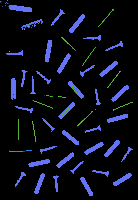

Without contours number:  670


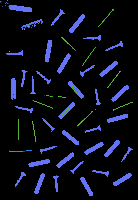

Without contours number:  671


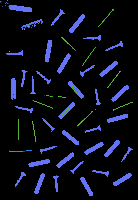

Without contours number:  672


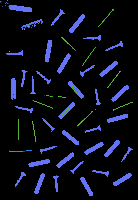

Without contours number:  673


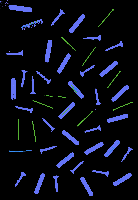

Without contours number:  674


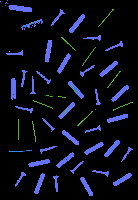

Without contours number:  675


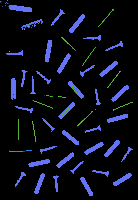

Without contours number:  676


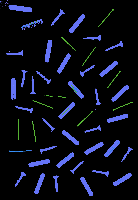

Without contours number:  677


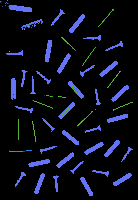

Without contours number:  678


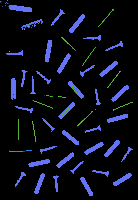

Without contours number:  679


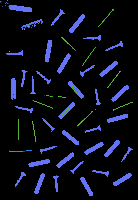

Without contours number:  680


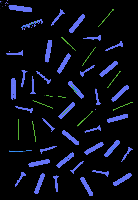

Without contours number:  681


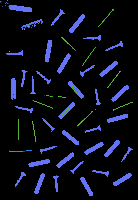

Without contours number:  682


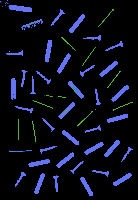

Without contours number:  683


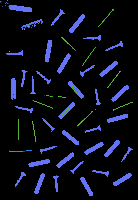

Without contours number:  684


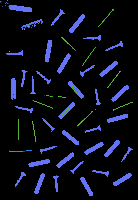

Without contours number:  685


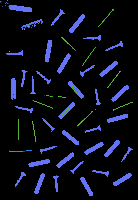

Without contours number:  686


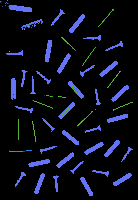

Without contours number:  687


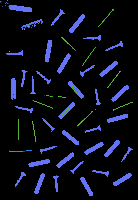

Without contours number:  688


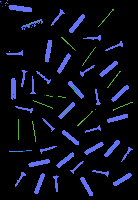

Without contours number:  689


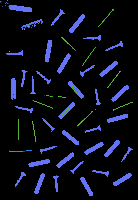

Without contours number:  690


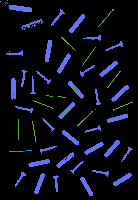

Without contours number:  691


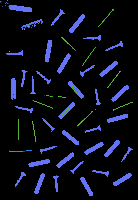

Without contours number:  692


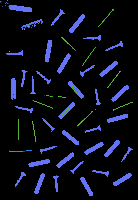

Without contours number:  693


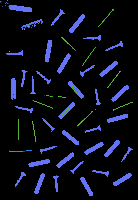

Without contours number:  694


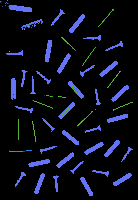

Without contours number:  695


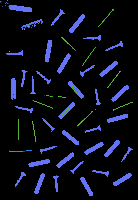

Without contours number:  696


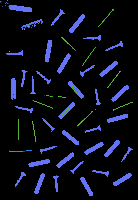

Without contours number:  697


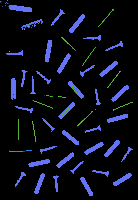

Without contours number:  698


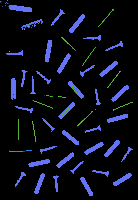

Without contours number:  699


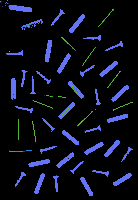

Without contours number:  700


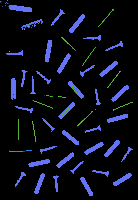

Without contours number:  701


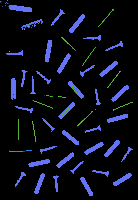

Without contours number:  702


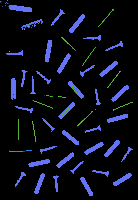

Without contours number:  703


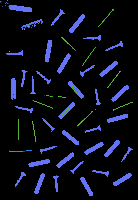

Without contours number:  704


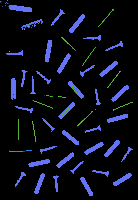

Without contours number:  705


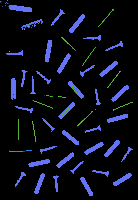

Without contours number:  706


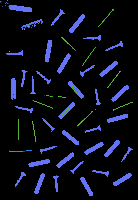

Without contours number:  707


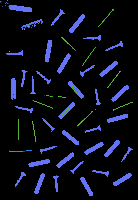

Without contours number:  709


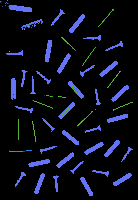

Without contours number:  710


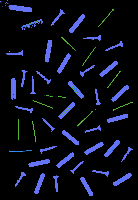

Without contours number:  711


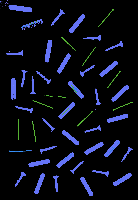

Without contours number:  712


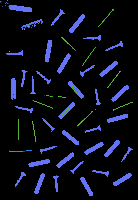

Without contours number:  713


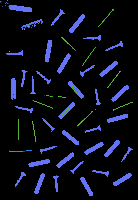

Without contours number:  714


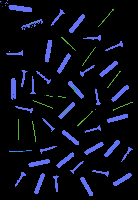

Without contours number:  715


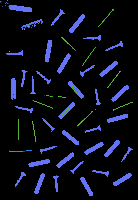

Without contours number:  716


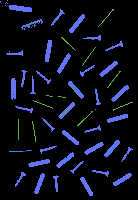

Without contours number:  717


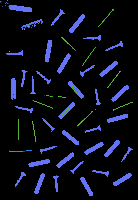

Without contours number:  718


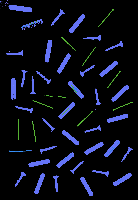

Without contours number:  719


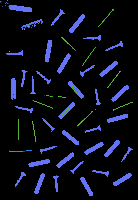

Without contours number:  720


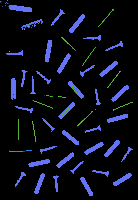

Without contours number:  721


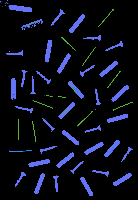

Without contours number:  722


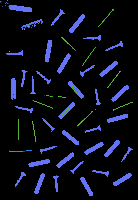

Without contours number:  723


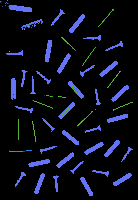

Without contours number:  724


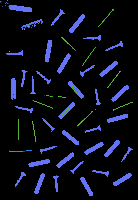

Without contours number:  725


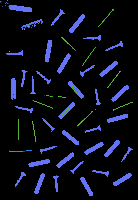

Without contours number:  726


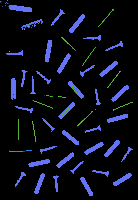

Without contours number:  727


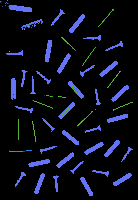

Without contours number:  728


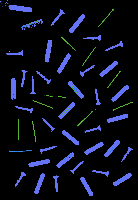

Without contours number:  729


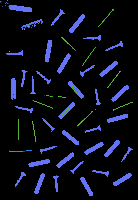

Without contours number:  730


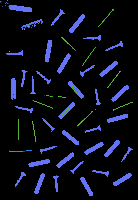

Without contours number:  731


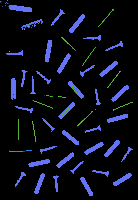

Without contours number:  732


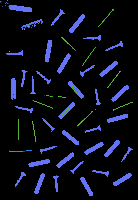

Without contours number:  733


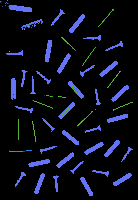

Without contours number:  734


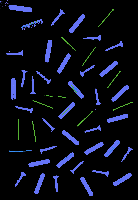

Without contours number:  735


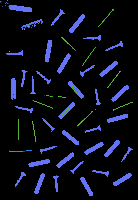

Without contours number:  736


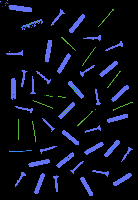

Without contours number:  737


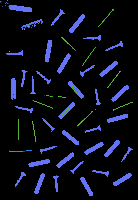

Without contours number:  738


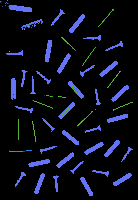

Without contours number:  739


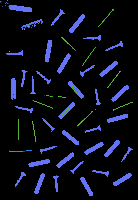

Without contours number:  740


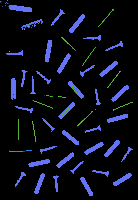

Without contours number:  741


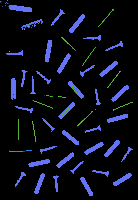

Without contours number:  742


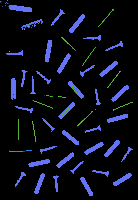

Without contours number:  743


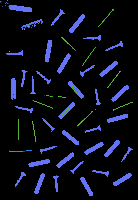

Without contours number:  744


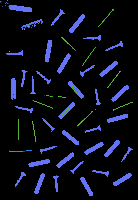

Without contours number:  745


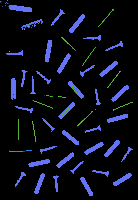

Without contours number:  746


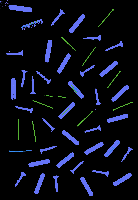

Without contours number:  747


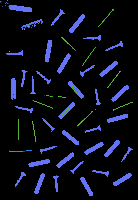

Without contours number:  748


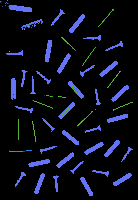

Without contours number:  749


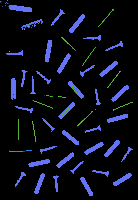

Without contours number:  750


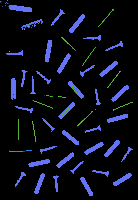

Without contours number:  751


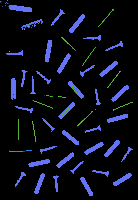

Without contours number:  752


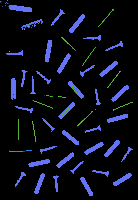

Without contours number:  753


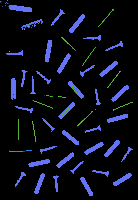

Without contours number:  754


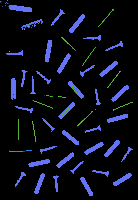

Without contours number:  755


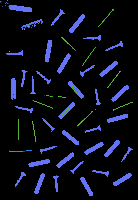

Without contours number:  756


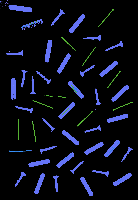

Without contours number:  757


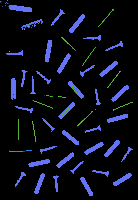

Without contours number:  758


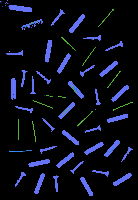

Without contours number:  759


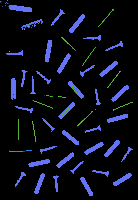

Without contours number:  760


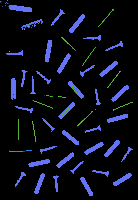

Without contours number:  761


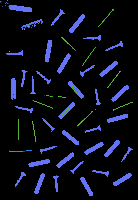

Without contours number:  762


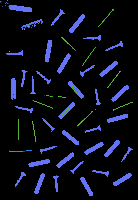

Without contours number:  763


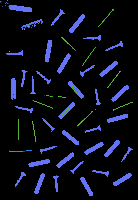

Without contours number:  764


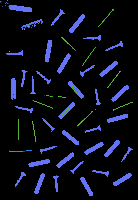

Without contours number:  765


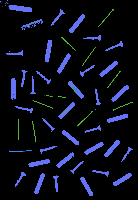

Without contours number:  766


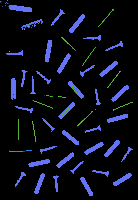

Without contours number:  767


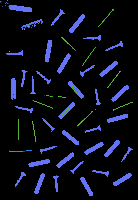

Without contours number:  768


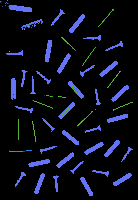

Without contours number:  769


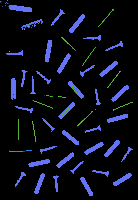

Without contours number:  770


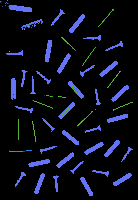

Without contours number:  771


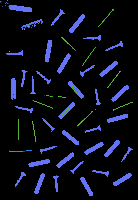

Without contours number:  772


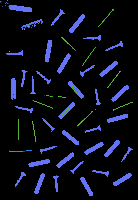

Without contours number:  773


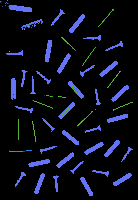

Without contours number:  774


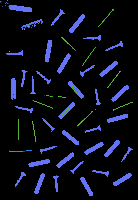

Without contours number:  775


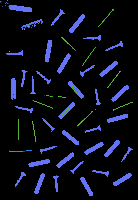

Without contours number:  776


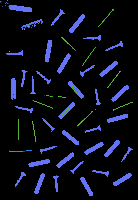

Without contours number:  777


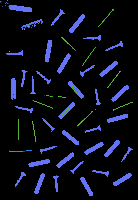

Without contours number:  778


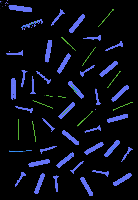

Without contours number:  779


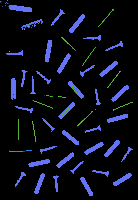

Without contours number:  780


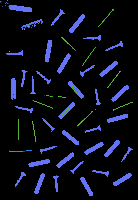

Without contours number:  781


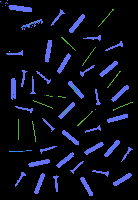

Without contours number:  782


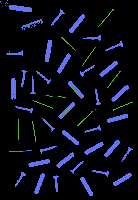

Without contours number:  783


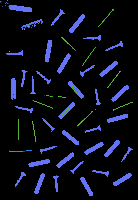

Without contours number:  784


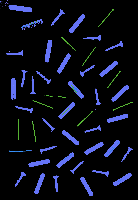

Without contours number:  785


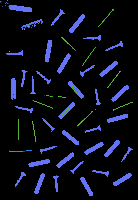

Without contours number:  786


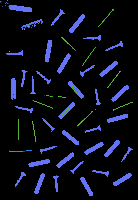

Without contours number:  787


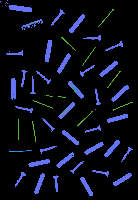

Without contours number:  788


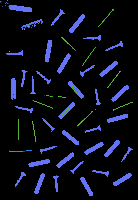

Without contours number:  789


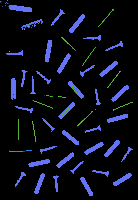

Without contours number:  790


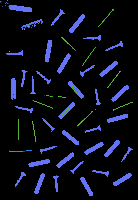

Without contours number:  791


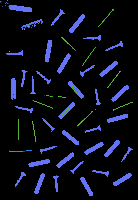

Without contours number:  792


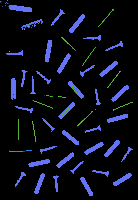

Without contours number:  794


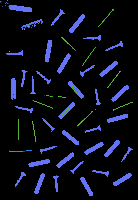

Without contours number:  795


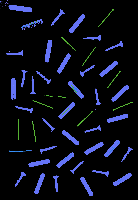

Without contours number:  796


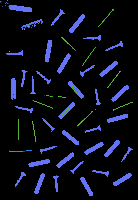

Without contours number:  797


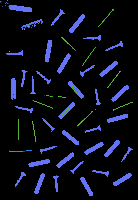

Without contours number:  798


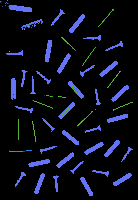

Without contours number:  799


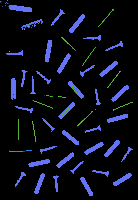

Without contours number:  800


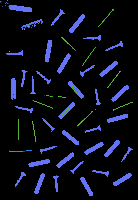

Without contours number:  801


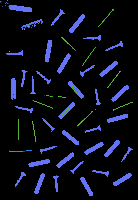

Without contours number:  802


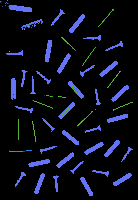

Without contours number:  803


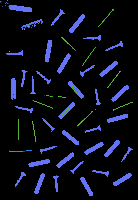

Without contours number:  805


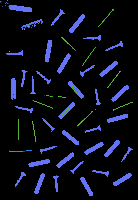

Without contours number:  806


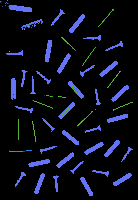

Without contours number:  807


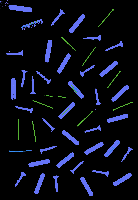

Without contours number:  808


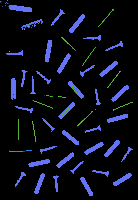

Without contours number:  809


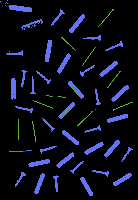

Without contours number:  810


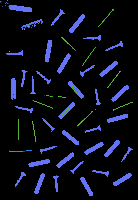

Without contours number:  811


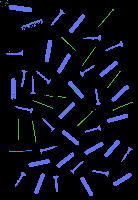

Without contours number:  812


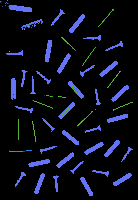

Without contours number:  813


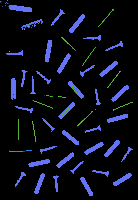

Without contours number:  814


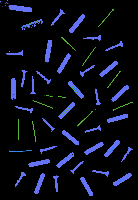

Without contours number:  816


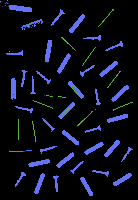

Without contours number:  817


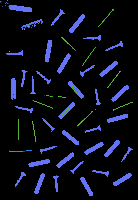

Without contours number:  818


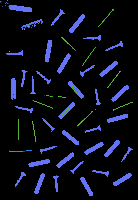

Without contours number:  819


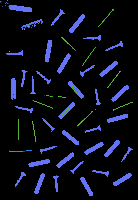

Without contours number:  820


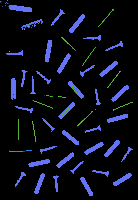

Without contours number:  821


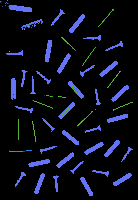

Without contours number:  822


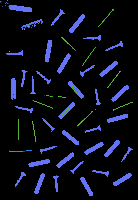

Without contours number:  823


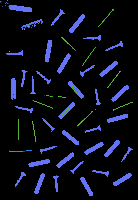

Without contours number:  824


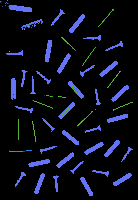

Without contours number:  825


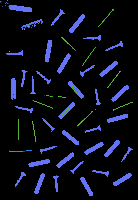

Without contours number:  826


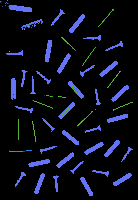

Without contours number:  827


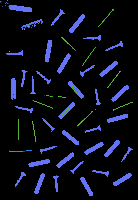

Without contours number:  828


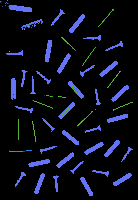

Without contours number:  829


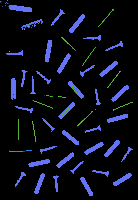

Without contours number:  830


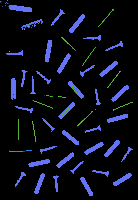

Without contours number:  831


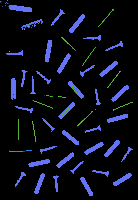

Without contours number:  832


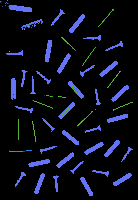

Without contours number:  833


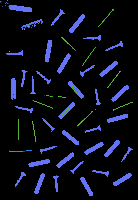

Without contours number:  834


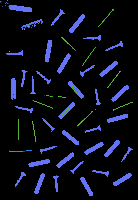

Without contours number:  835


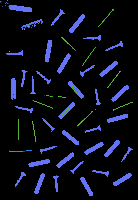

Without contours number:  836


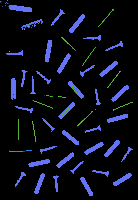

Without contours number:  837


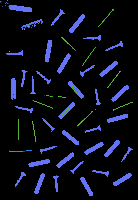

Without contours number:  838


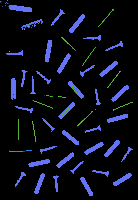

Without contours number:  839


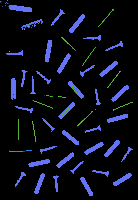

Without contours number:  840


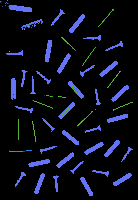

Without contours number:  841


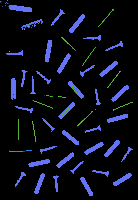

Without contours number:  842


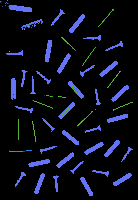

Without contours number:  843


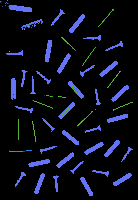

Without contours number:  844


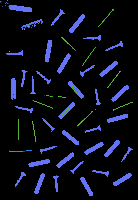

Without contours number:  845


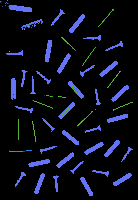

Without contours number:  846


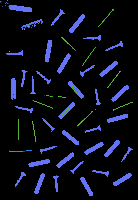

Without contours number:  847


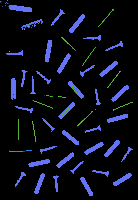

Without contours number:  849


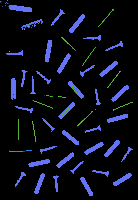

Without contours number:  850


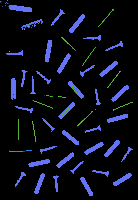

Without contours number:  851


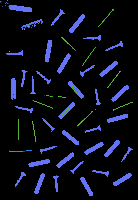

Without contours number:  852


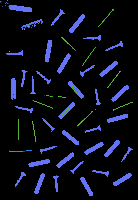

Without contours number:  853


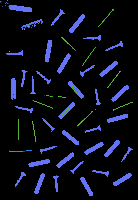

Without contours number:  854


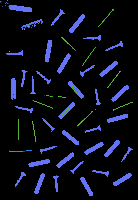

Without contours number:  855


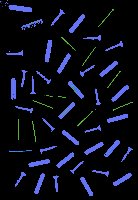

Without contours number:  856


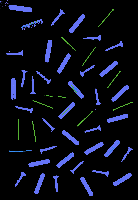

Without contours number:  857


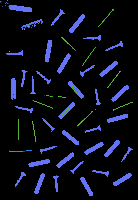

Without contours number:  858


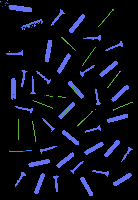

Without contours number:  859


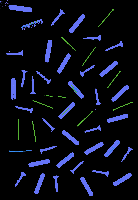

Without contours number:  860


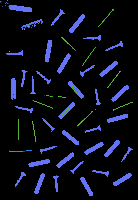

Without contours number:  861


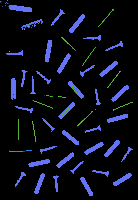

Without contours number:  862


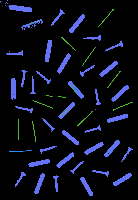

Without contours number:  863


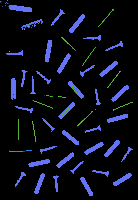

Without contours number:  864


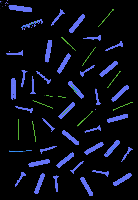

Without contours number:  865


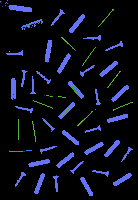

Without contours number:  866


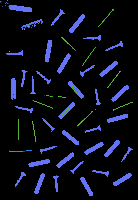

Without contours number:  867


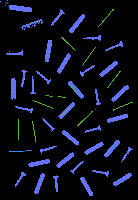

Without contours number:  868


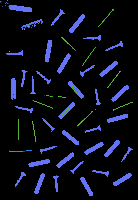

Without contours number:  869


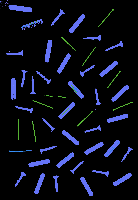

Without contours number:  870


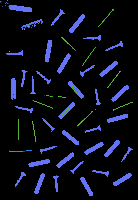

Without contours number:  871


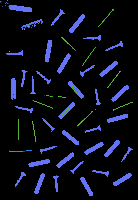

Without contours number:  872


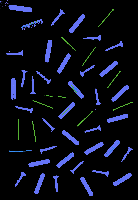

Without contours number:  873


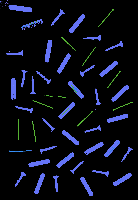

Without contours number:  874


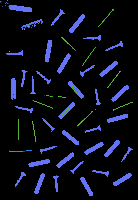

Without contours number:  875


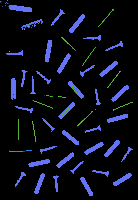

Without contours number:  876


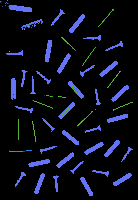

Without contours number:  878


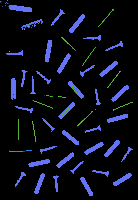

Without contours number:  879


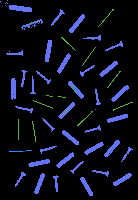

Without contours number:  880


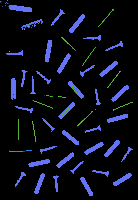

Without contours number:  881


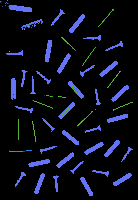

Without contours number:  882


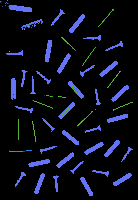

Without contours number:  883


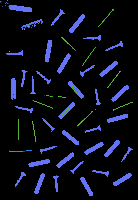

Without contours number:  884


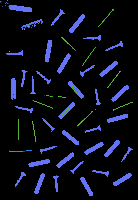

Without contours number:  885


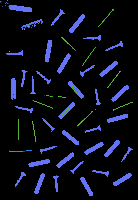

Without contours number:  886


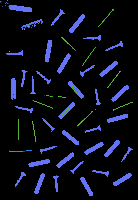

Without contours number:  887


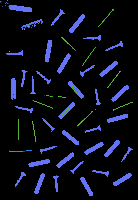

Without contours number:  888


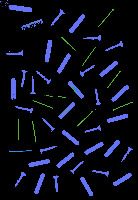

Without contours number:  889


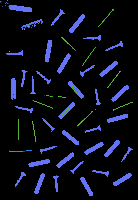

Without contours number:  890


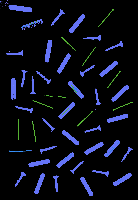

Without contours number:  891


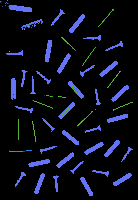

Without contours number:  892


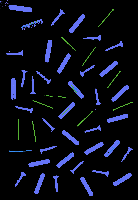

Without contours number:  893


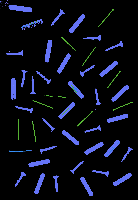

Without contours number:  894


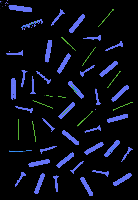

Without contours number:  895


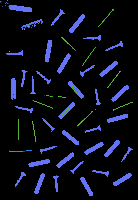

Without contours number:  896


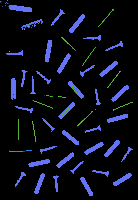

Without contours number:  897


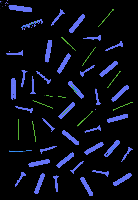

Without contours number:  898


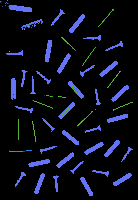

Without contours number:  899


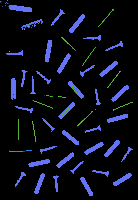

Without contours number:  900


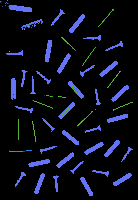

Without contours number:  901


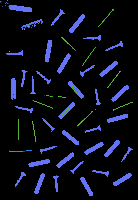

Without contours number:  902


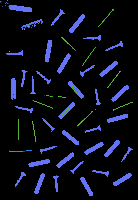

Without contours number:  903


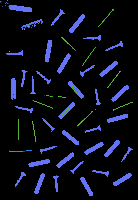

Without contours number:  904


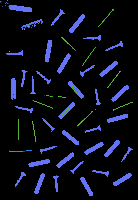

Without contours number:  905


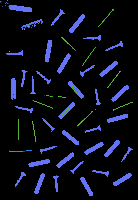

Without contours number:  906


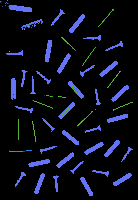

Without contours number:  907


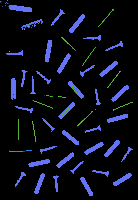

Without contours number:  908


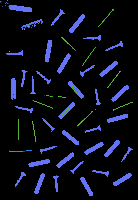

Without contours number:  909


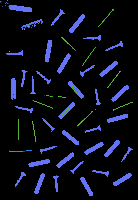

Without contours number:  910


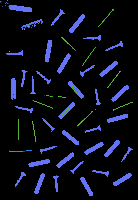

Without contours number:  911


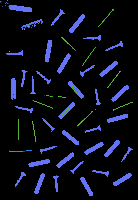

Without contours number:  912


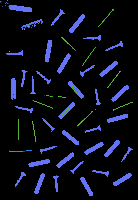

Without contours number:  913


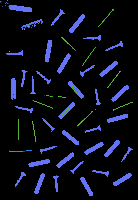

Without contours number:  915


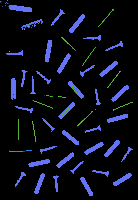

Without contours number:  916


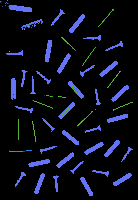

Without contours number:  917


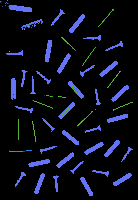

Without contours number:  918


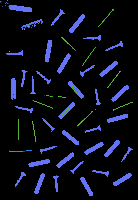

Without contours number:  919


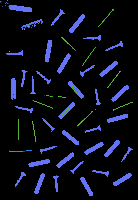

Without contours number:  920


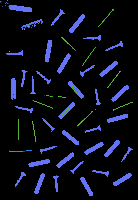

Without contours number:  921


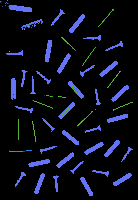

Without contours number:  922


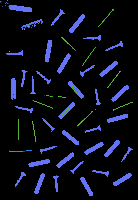

Without contours number:  923


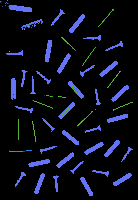

Without contours number:  924


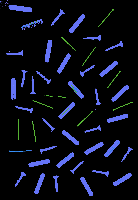

Without contours number:  925


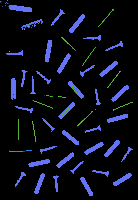

Without contours number:  926


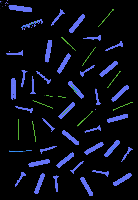

Without contours number:  927


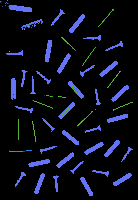

Without contours number:  928


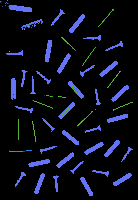

Without contours number:  929


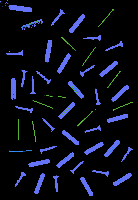

Without contours number:  930


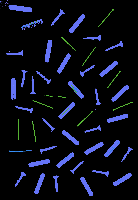

Without contours number:  931


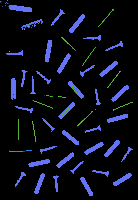

Without contours number:  932


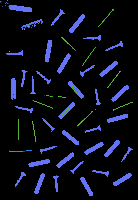

Without contours number:  933


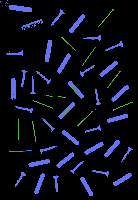

Without contours number:  934


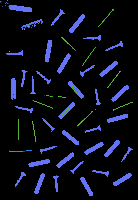

Without contours number:  935


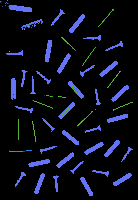

Without contours number:  936


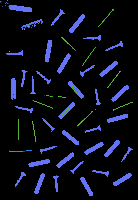

Without contours number:  937


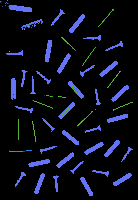

Without contours number:  938


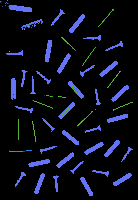

Without contours number:  939


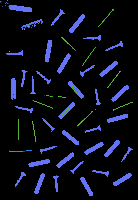

Without contours number:  940


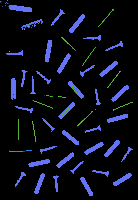

Without contours number:  941


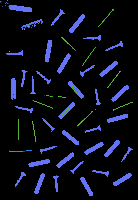

Without contours number:  942


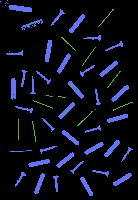

Without contours number:  943


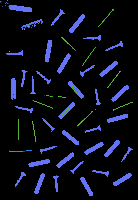

Without contours number:  944


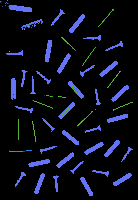

Without contours number:  945


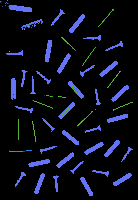

Without contours number:  946


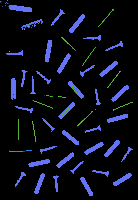

Without contours number:  947


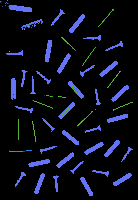

Without contours number:  948


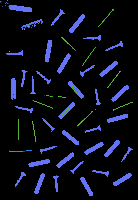

Without contours number:  949


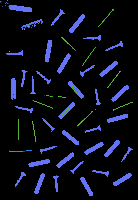

Without contours number:  950


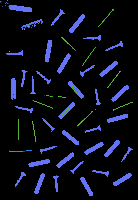

Without contours number:  951


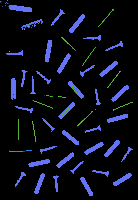

Without contours number:  952


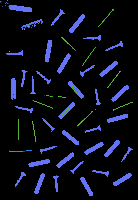

Without contours number:  953


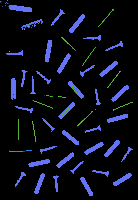

Without contours number:  954


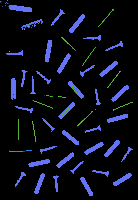

Without contours number:  955


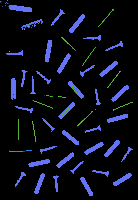

Without contours number:  956


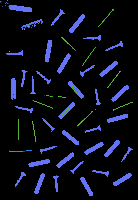

Without contours number:  957


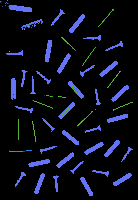

Without contours number:  958


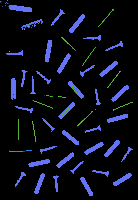

Without contours number:  959


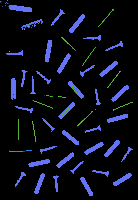

Without contours number:  960


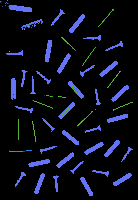

Without contours number:  961


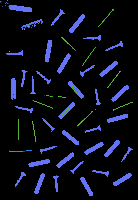

Without contours number:  962


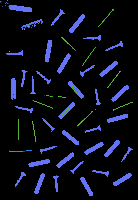

Without contours number:  963


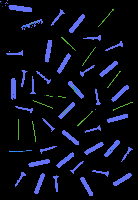

Without contours number:  964


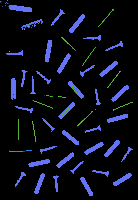

Without contours number:  965


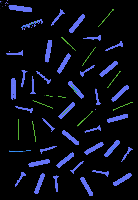

Without contours number:  966


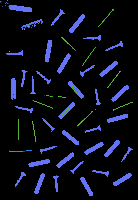

Without contours number:  967


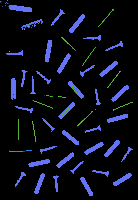

Without contours number:  968


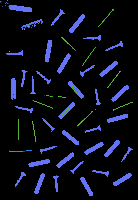

Without contours number:  970


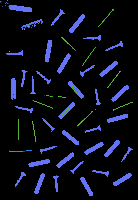

Without contours number:  971


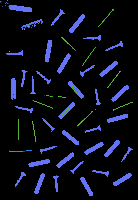

Without contours number:  972


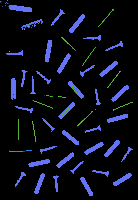

Without contours number:  973


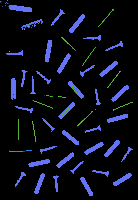

Without contours number:  974


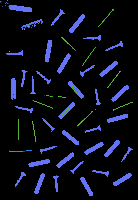

Without contours number:  975


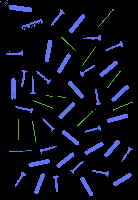

Without contours number:  976


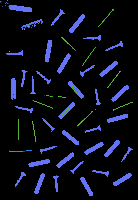

Without contours number:  977


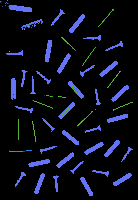

Without contours number:  978


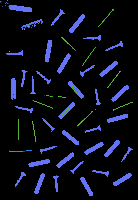

Without contours number:  979


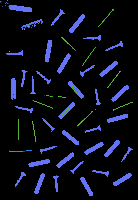

Without contours number:  980


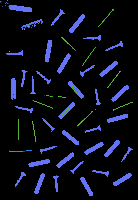

Without contours number:  981


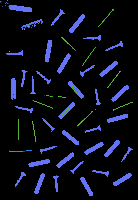

Without contours number:  982


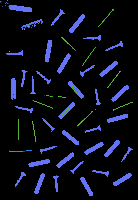

Without contours number:  983


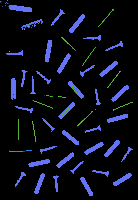

Without contours number:  984


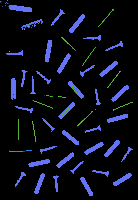

Without contours number:  985


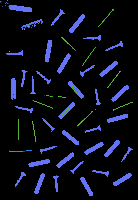

Without contours number:  986


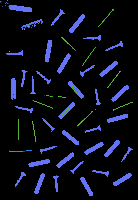

Without contours number:  987


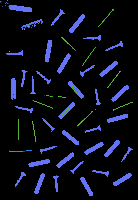

Without contours number:  988


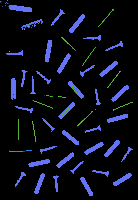

Without contours number:  989


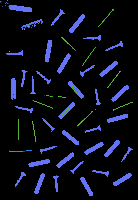

Without contours number:  990


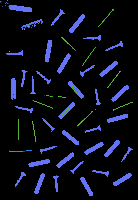

Without contours number:  991


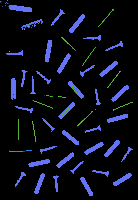

Without contours number:  992


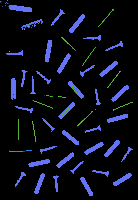

Without contours number:  993


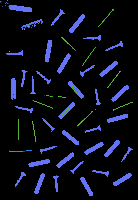

Without contours number:  994


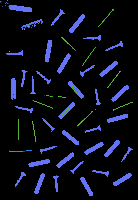

Without contours number:  995


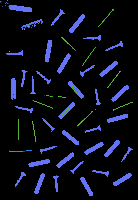

Without contours number:  996


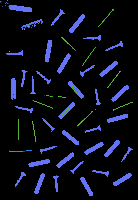

Without contours number:  997


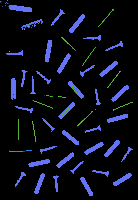

Without contours number:  998


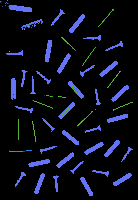

Without contours number:  999


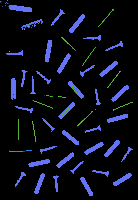

Without contours number:  1000


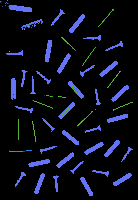

Without contours number:  1001


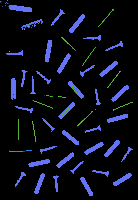

Without contours number:  1002


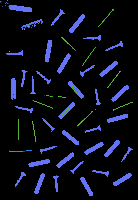

Without contours number:  1003


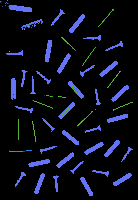

Without contours number:  1004


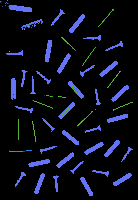

Without contours number:  1005


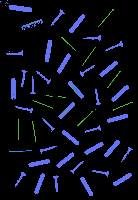

Without contours number:  1006


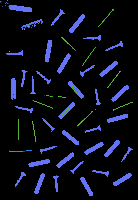

Without contours number:  1007


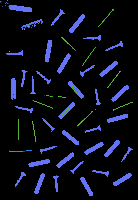

Without contours number:  1008


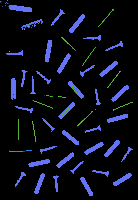

Without contours number:  1009


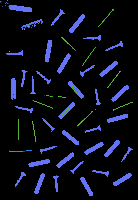

Without contours number:  1010


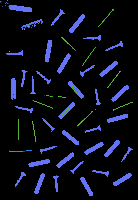

Without contours number:  1011


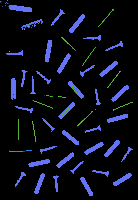

Without contours number:  1012


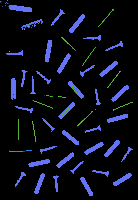

Without contours number:  1013


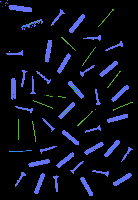

Without contours number:  1014


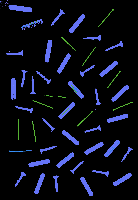

Without contours number:  1015


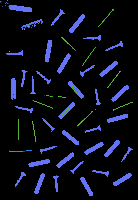

Without contours number:  1016


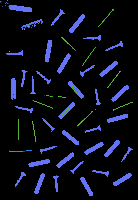

Without contours number:  1017


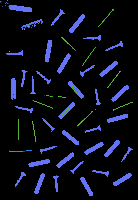

Without contours number:  1018


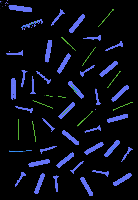

Without contours number:  1019


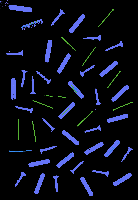

Without contours number:  1020


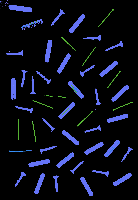

Without contours number:  1021


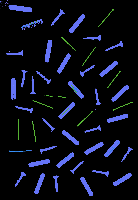

Without contours number:  1022


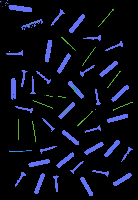

Without contours number:  1023


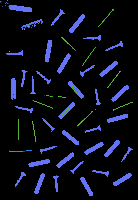

Without contours number:  1024


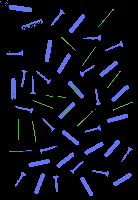

Without contours number:  1025


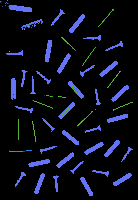

Without contours number:  1026


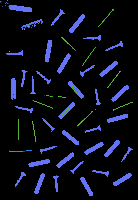

Without contours number:  1027


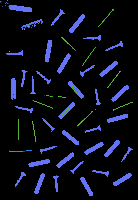

Without contours number:  1028


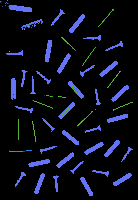

Without contours number:  1029


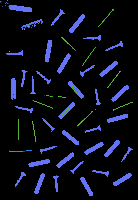

Without contours number:  1030


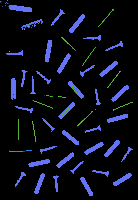

Without contours number:  1031


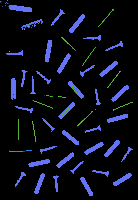

Without contours number:  1032


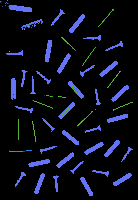

Without contours number:  1033


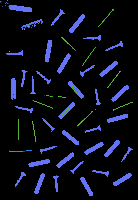

Without contours number:  1034


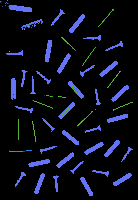

Without contours number:  1035


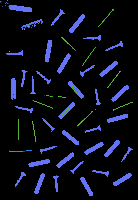

Without contours number:  1036


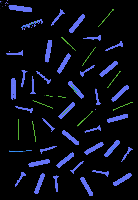

Without contours number:  1037


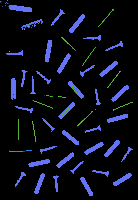

Without contours number:  1038


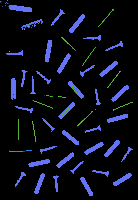

Without contours number:  1039


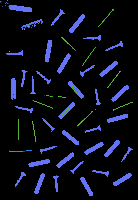

Without contours number:  1040


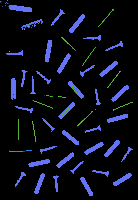

Without contours number:  1041


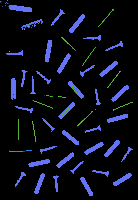

Without contours number:  1042


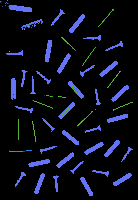

Without contours number:  1043


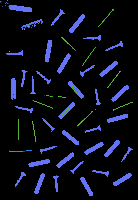

Without contours number:  1044


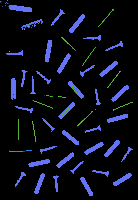

Without contours number:  1045


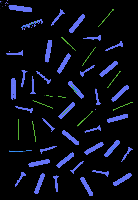

Without contours number:  1046


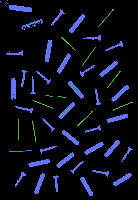

Without contours number:  1047


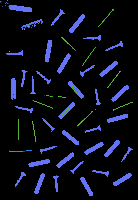

Without contours number:  1048


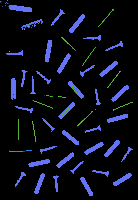

Without contours number:  1049


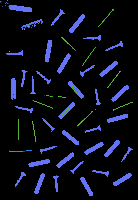

Without contours number:  1050


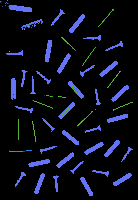

Without contours number:  1051


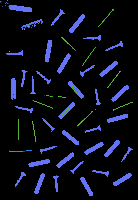

Without contours number:  1052


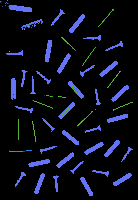

Without contours number:  1053


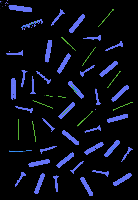

Without contours number:  1054


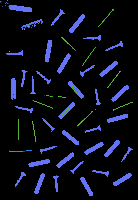

Without contours number:  1055


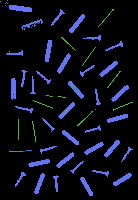

Without contours number:  1056


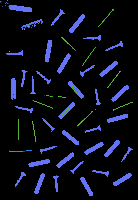

Without contours number:  1057


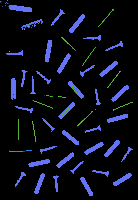

Without contours number:  1058


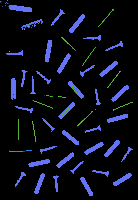

Without contours number:  1059


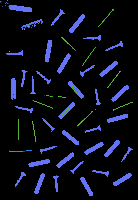

Without contours number:  1060


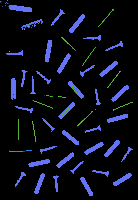

Without contours number:  1061


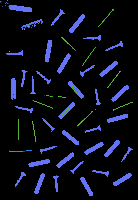

Without contours number:  1062


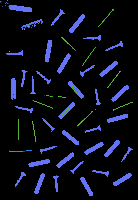

Without contours number:  1063


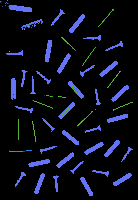

Without contours number:  1064


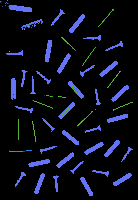

Without contours number:  1065


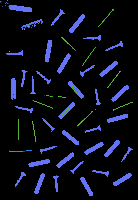

Without contours number:  1066


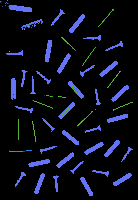

Without contours number:  1067


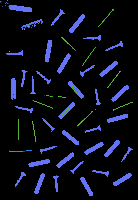

Without contours number:  1068


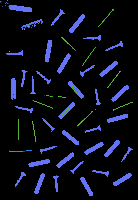

Without contours number:  1069


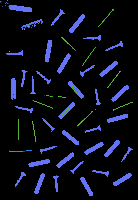

Without contours number:  1070


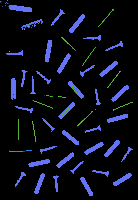

Without contours number:  1071


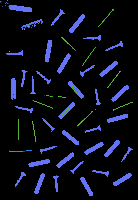

Without contours number:  1072


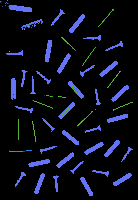

Without contours number:  1073


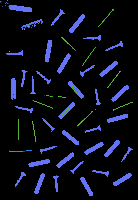

Without contours number:  1074


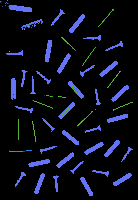

Without contours number:  1075


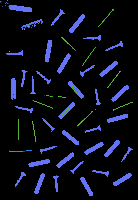

Without contours number:  1076


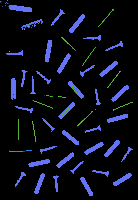

Without contours number:  1077


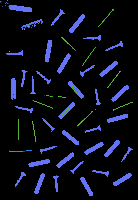

Without contours number:  1078


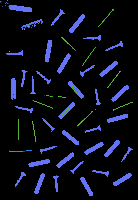

Without contours number:  1079


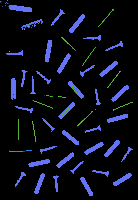

Without contours number:  1080


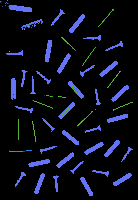

Without contours number:  1081


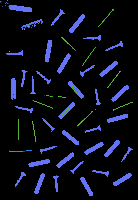

Without contours number:  1082


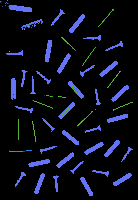

Without contours number:  1083


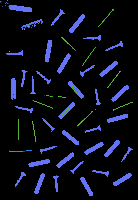

Without contours number:  1084


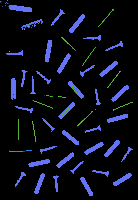

Without contours number:  1085


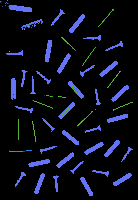

Without contours number:  1086


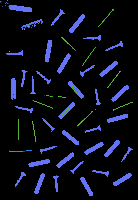

Without contours number:  1087


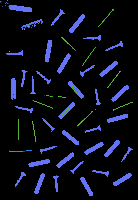

Without contours number:  1088


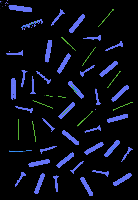

Without contours number:  1089


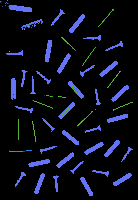

Without contours number:  1090


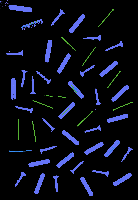

Without contours number:  1091


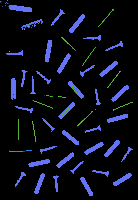

Without contours number:  1092


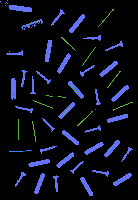

Without contours number:  1093


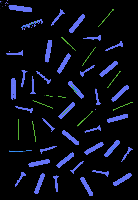

Without contours number:  1094


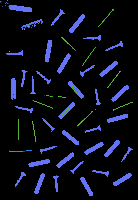

Without contours number:  1095


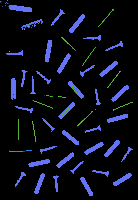

Without contours number:  1096


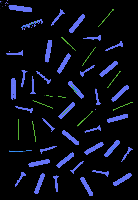

Without contours number:  1097


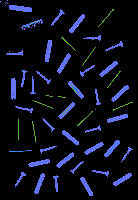

Without contours number:  1098


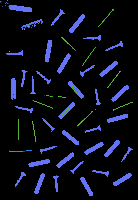

Without contours number:  1099


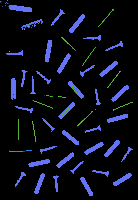

Without contours number:  1100


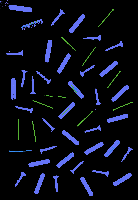

Without contours number:  1101


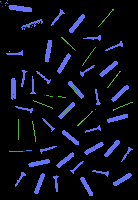

Without contours number:  1102


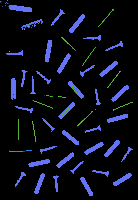

Without contours number:  1103


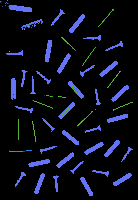

Without contours number:  1104


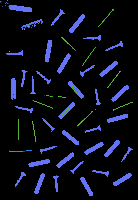

Without contours number:  1105


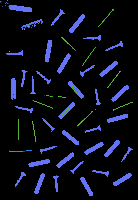

Without contours number:  1106


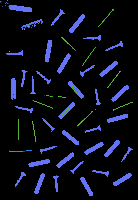

Without contours number:  1107


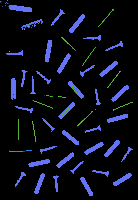

Without contours number:  1108


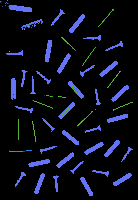

Without contours number:  1109


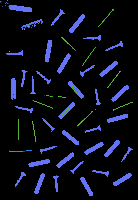

Without contours number:  1110


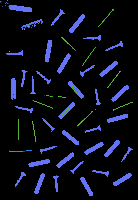

Without contours number:  1111


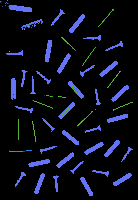

Without contours number:  1112


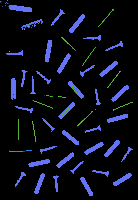

Without contours number:  1113


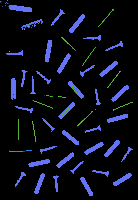

Without contours number:  1114


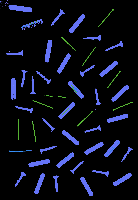

Without contours number:  1116


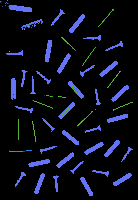

Without contours number:  1117


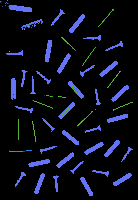

Without contours number:  1118


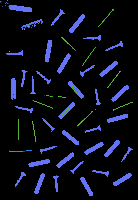

Without contours number:  1119


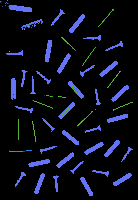

Without contours number:  1120


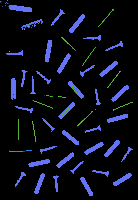

Without contours number:  1121


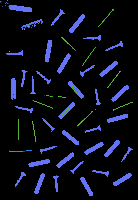

Without contours number:  1122


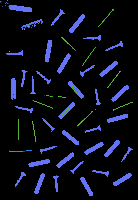

Without contours number:  1123


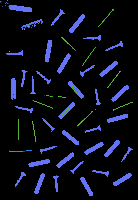

Without contours number:  1124


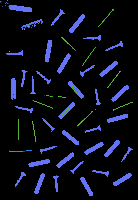

Without contours number:  1125


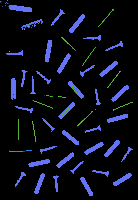

Without contours number:  1126


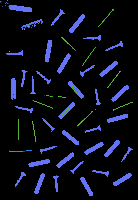

Without contours number:  1127


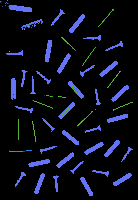

Without contours number:  1128


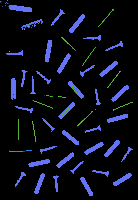

Without contours number:  1129


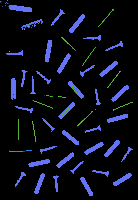

Without contours number:  1130


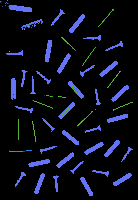

Without contours number:  1131


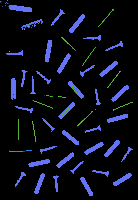

Without contours number:  1132


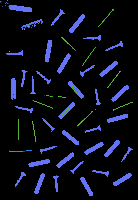

Without contours number:  1133


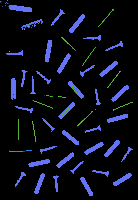

Without contours number:  1134


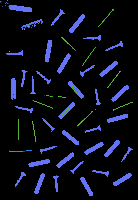

Without contours number:  1135


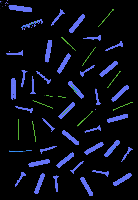

Without contours number:  1137


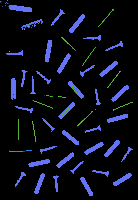

Without contours number:  1138


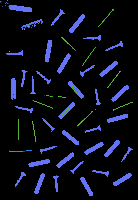

Without contours number:  1139


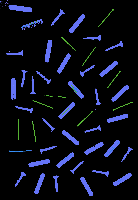

Without contours number:  1140


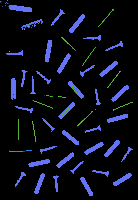

Without contours number:  1141


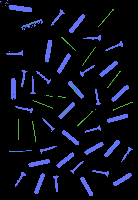

Without contours number:  1142


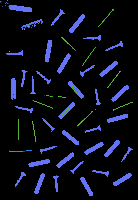

Without contours number:  1143


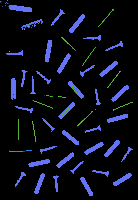

Without contours number:  1144


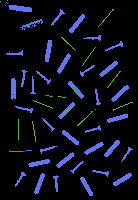

Without contours number:  1145


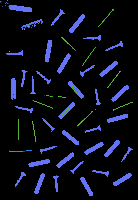

Without contours number:  1146


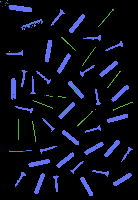

Without contours number:  1147


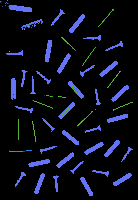

Without contours number:  1148


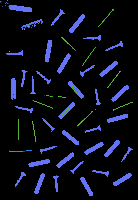

Without contours number:  1149


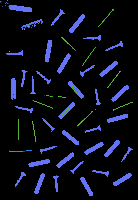

Without contours number:  1150


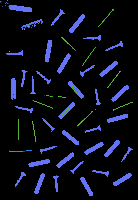

Without contours number:  1151


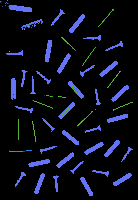

Without contours number:  1152


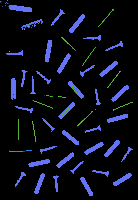

Without contours number:  1153


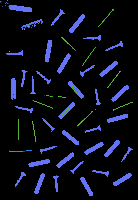

Without contours number:  1155


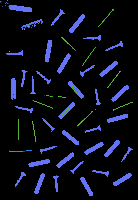

Without contours number:  1156


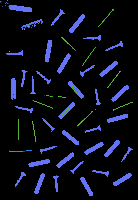

Without contours number:  1157


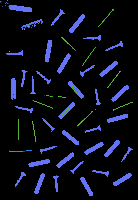

Without contours number:  1158


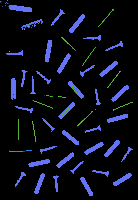

Without contours number:  1159


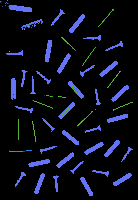

Without contours number:  1160


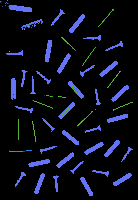

Without contours number:  1161


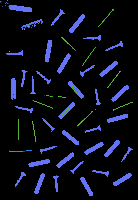

Without contours number:  1162


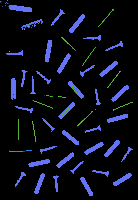

Without contours number:  1163


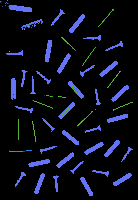

Without contours number:  1164


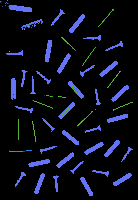

Without contours number:  1165


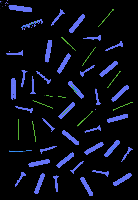

Without contours number:  1166


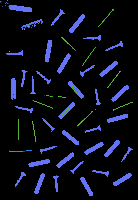

Without contours number:  1167


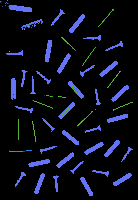

Without contours number:  1168


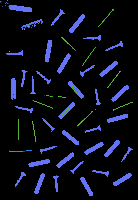

Without contours number:  1169


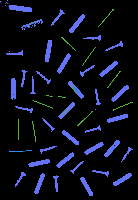

Without contours number:  1170


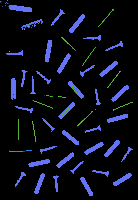

Without contours number:  1171


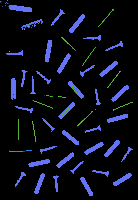

Without contours number:  1172


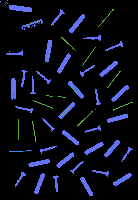

Without contours number:  1173


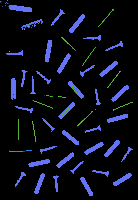

Without contours number:  1174


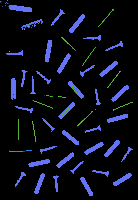

Without contours number:  1175


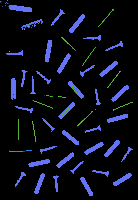

Without contours number:  1176


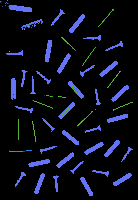

Without contours number:  1177


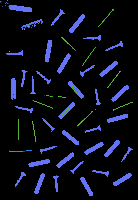

Without contours number:  1178


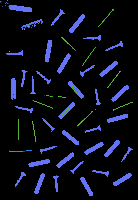

Without contours number:  1179


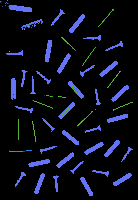

Without contours number:  1180


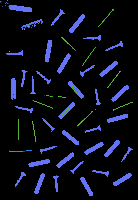

Without contours number:  1181


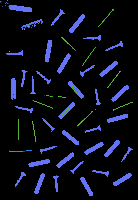

Without contours number:  1182


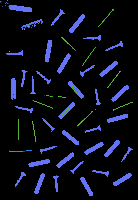

Without contours number:  1183


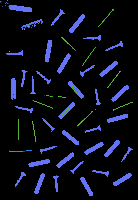

Without contours number:  1184


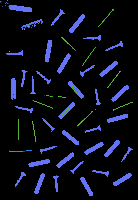

Without contours number:  1185


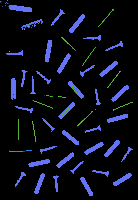

Without contours number:  1186


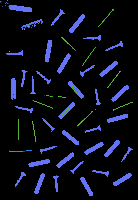

Without contours number:  1187


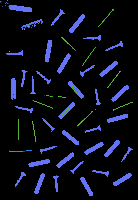

Without contours number:  1188


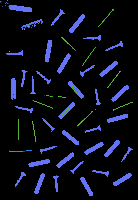

Without contours number:  1189


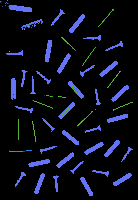

Without contours number:  1190


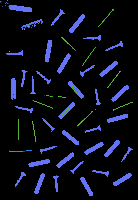

Without contours number:  1191


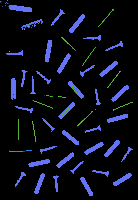

Without contours number:  1192


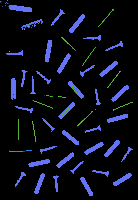

Without contours number:  1193


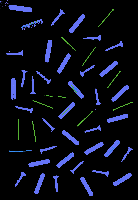

Without contours number:  1194


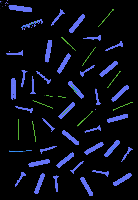

Without contours number:  1195


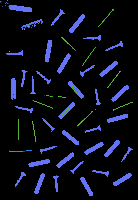

Without contours number:  1196


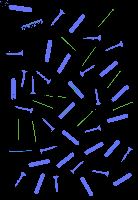

Without contours number:  1197


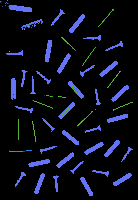

Without contours number:  1198


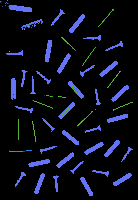

Without contours number:  1199


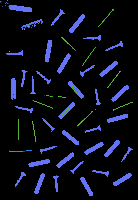

Without contours number:  1200


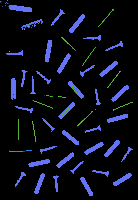

Without contours number:  1203


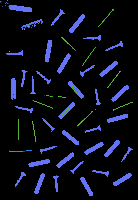

Without contours number:  1204


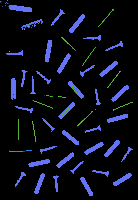

Without contours number:  1205


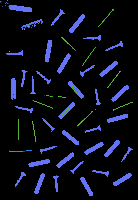

Without contours number:  1206


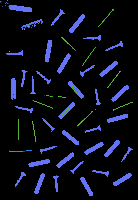

Without contours number:  1207


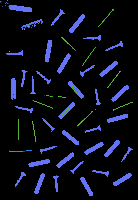

Without contours number:  1208


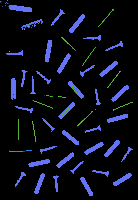

Without contours number:  1209


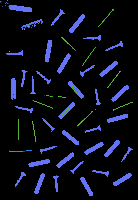

Without contours number:  1210


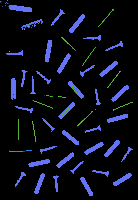

Without contours number:  1211


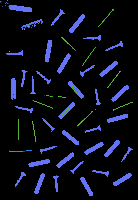

Without contours number:  1212


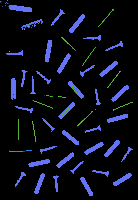

Without contours number:  1213


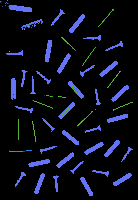

Without contours number:  1214


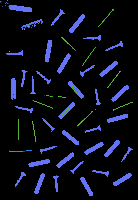

Without contours number:  1215


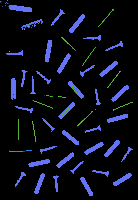

Without contours number:  1216


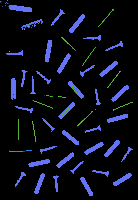

Without contours number:  1217


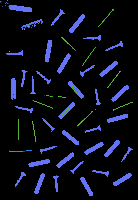

Without contours number:  1218


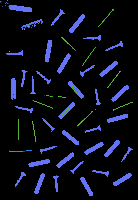

Without contours number:  1219


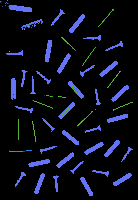

Without contours number:  1220


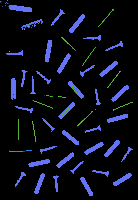

Without contours number:  1221


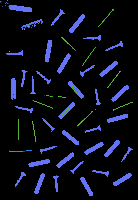

Without contours number:  1222


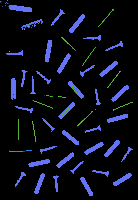

Without contours number:  1223


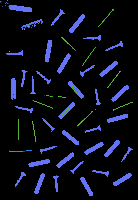

Without contours number:  1224


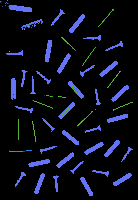

Without contours number:  1225


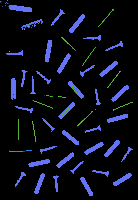

Without contours number:  1226


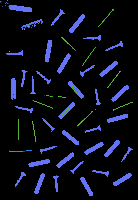

Without contours number:  1227


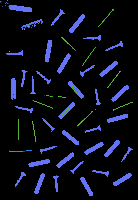

Without contours number:  1228


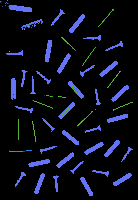

Without contours number:  1229


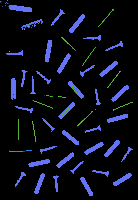

Without contours number:  1230


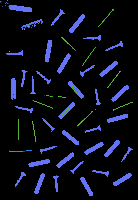

Without contours number:  1231


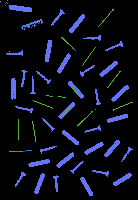

Without contours number:  1232


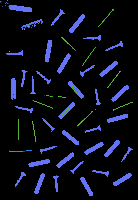

Without contours number:  1233


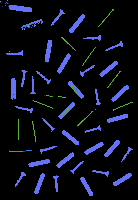

Without contours number:  1234


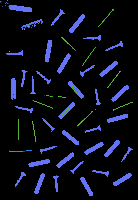

Without contours number:  1235


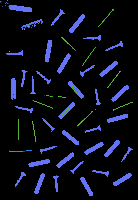

Without contours number:  1236


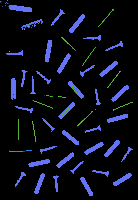

Without contours number:  1237


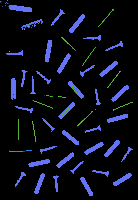

Without contours number:  1238


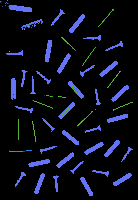

Without contours number:  1239


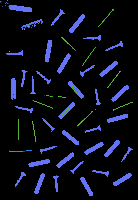

Without contours number:  1240


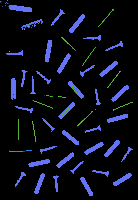

Without contours number:  1241


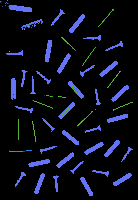

Without contours number:  1242


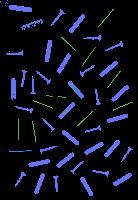

Without contours number:  1243


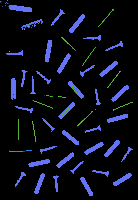

Without contours number:  1244


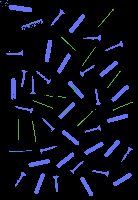

Without contours number:  1245


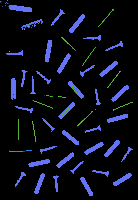

Without contours number:  1246


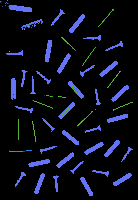

Without contours number:  1247


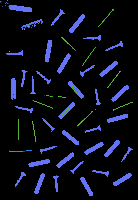

Without contours number:  1248


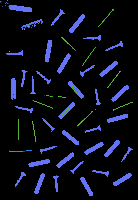

Without contours number:  1249


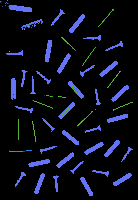

Without contours number:  1250


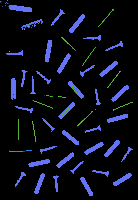

Without contours number:  1251


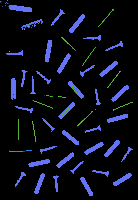

Without contours number:  1252


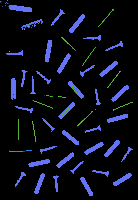

Without contours number:  1253


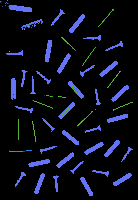

Without contours number:  1254


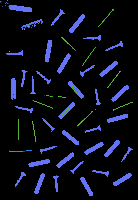

Without contours number:  1255


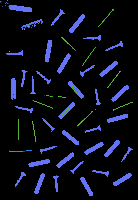

Without contours number:  1256


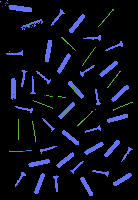

Without contours number:  1257


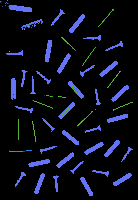

Without contours number:  1258


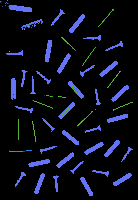

Without contours number:  1259


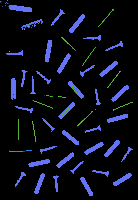

Without contours number:  1260


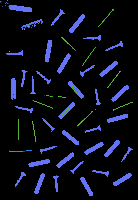

Without contours number:  1261


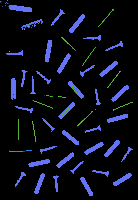

Without contours number:  1262


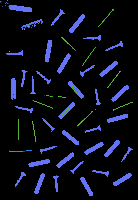

Without contours number:  1263


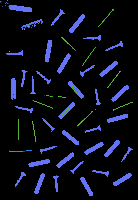

Without contours number:  1264


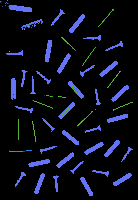

Without contours number:  1265


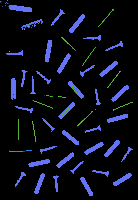

Without contours number:  1266


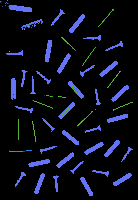

Without contours number:  1267


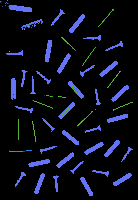

Without contours number:  1268


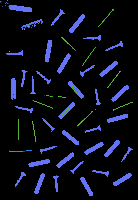

Without contours number:  1269


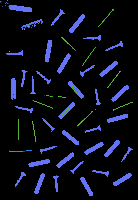

Without contours number:  1270


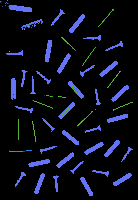

Without contours number:  1271


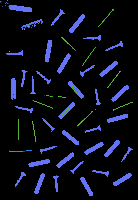

Without contours number:  1272


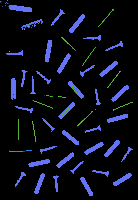

Without contours number:  1273


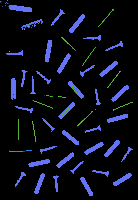

Without contours number:  1274


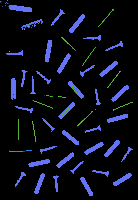

Without contours number:  1275


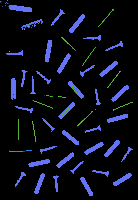

Without contours number:  1276


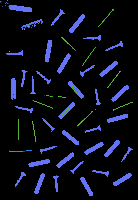

Without contours number:  1277


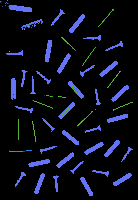

Without contours number:  1278


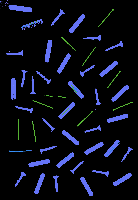

Without contours number:  1279


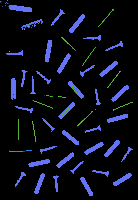

Without contours number:  1280


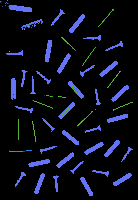

Without contours number:  1281


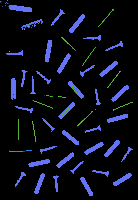

Without contours number:  1282


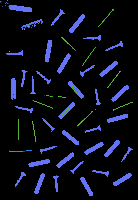

Without contours number:  1283


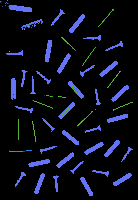

Without contours number:  1284


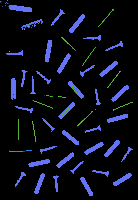

Without contours number:  1285


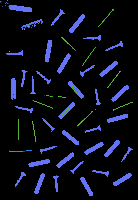

Without contours number:  1286


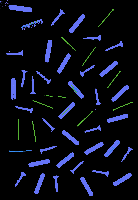

Without contours number:  1287


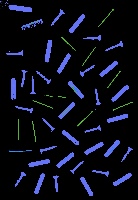

Without contours number:  1288


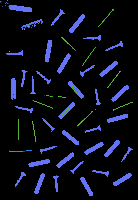

Without contours number:  1289


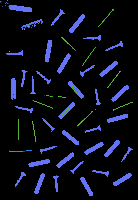

Without contours number:  1290


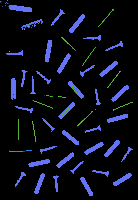

Without contours number:  1291


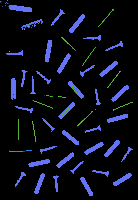

Without contours number:  1292


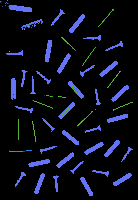

Without contours number:  1293


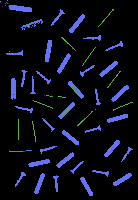

Without contours number:  1294


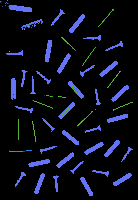

Without contours number:  1295


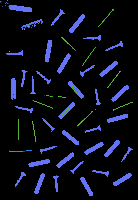

Without contours number:  1297


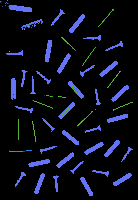

Without contours number:  1298


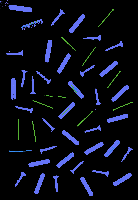

Without contours number:  1299


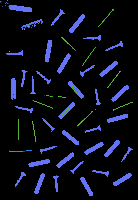

Without contours number:  1300


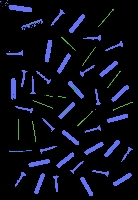

Without contours number:  1301


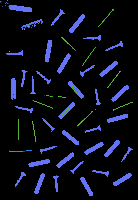

Without contours number:  1302


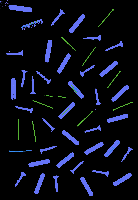

Without contours number:  1304


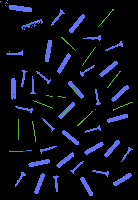

Without contours number:  1305


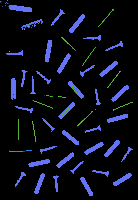

Without contours number:  1306


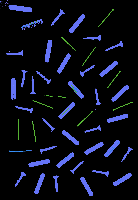

Without contours number:  1307


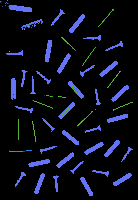

Without contours number:  1308


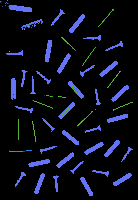

Without contours number:  1309


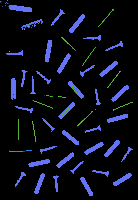

Without contours number:  1310


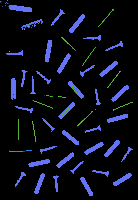

Without contours number:  1311


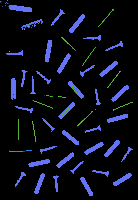

Without contours number:  1313


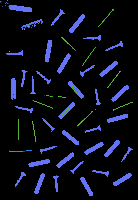

Without contours number:  1314


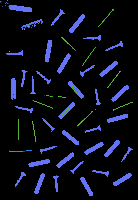

Without contours number:  1315


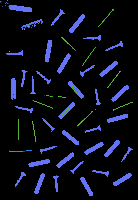

Without contours number:  1316


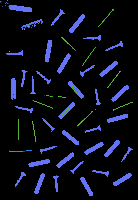

Without contours number:  1317


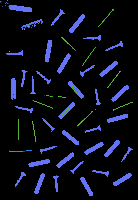

Without contours number:  1318


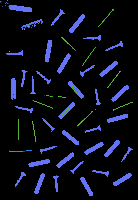

Without contours number:  1319


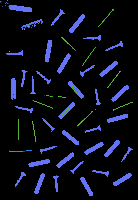

Without contours number:  1320


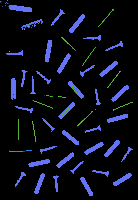

Without contours number:  1321


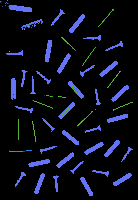

Without contours number:  1322


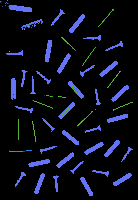

Without contours number:  1323


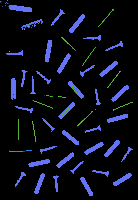

Without contours number:  1324


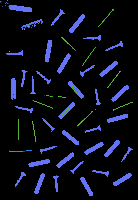

Without contours number:  1325


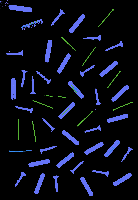

Without contours number:  1326


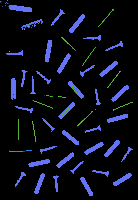

Without contours number:  1327


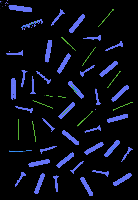

Without contours number:  1328


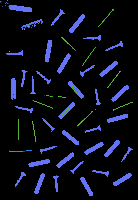

Without contours number:  1329


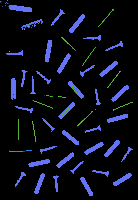

Without contours number:  1330


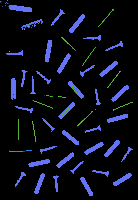

Without contours number:  1331


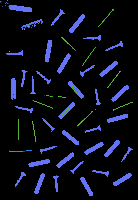

Without contours number:  1332


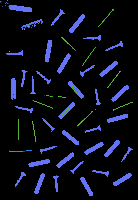

Without contours number:  1333


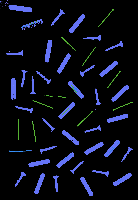

Without contours number:  1334


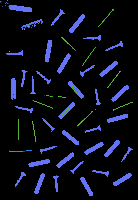

Without contours number:  1335


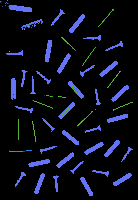

Without contours number:  1336


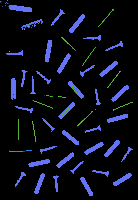

Without contours number:  1337


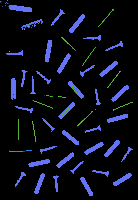

Without contours number:  1338


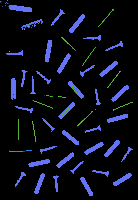

Without contours number:  1339


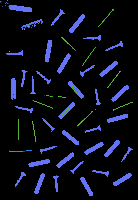

Without contours number:  1340


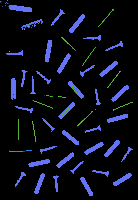

Without contours number:  1341


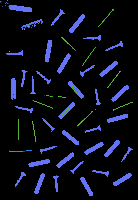

Without contours number:  1342


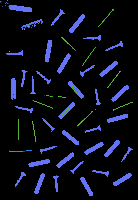

Without contours number:  1343


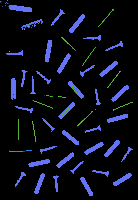

Without contours number:  1344


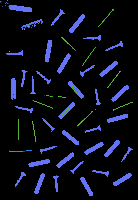

Without contours number:  1345


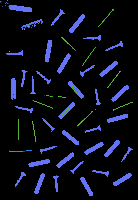

Without contours number:  1346


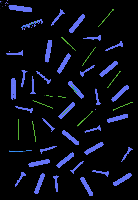

Without contours number:  1347


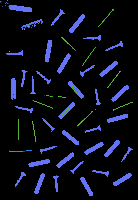

Without contours number:  1348


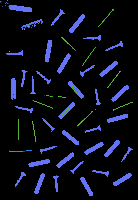

Without contours number:  1349


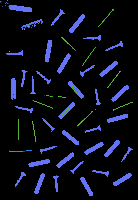

Without contours number:  1350


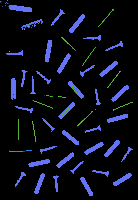

Without contours number:  1351


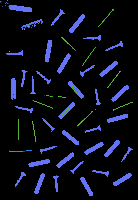

Without contours number:  1352


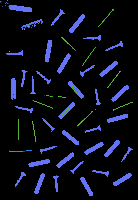

Without contours number:  1353


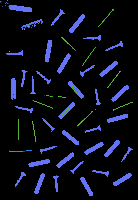

Without contours number:  1354


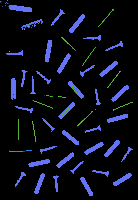

Without contours number:  1355


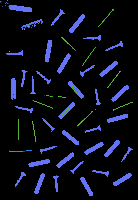

Without contours number:  1356


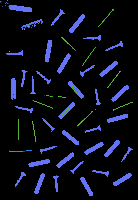

Without contours number:  1357


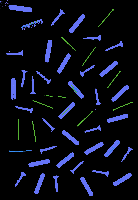

Without contours number:  1358


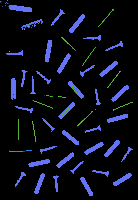

Without contours number:  1359


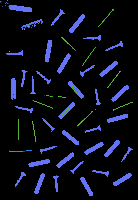

Without contours number:  1360


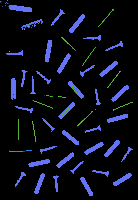

Without contours number:  1361


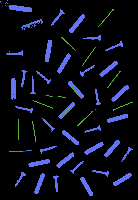

Without contours number:  1362


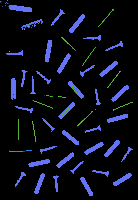

Without contours number:  1363


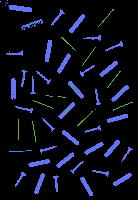

Without contours number:  1364


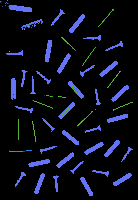

Without contours number:  1365


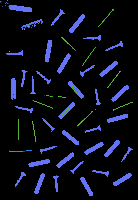

Without contours number:  1366


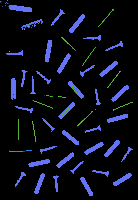

Without contours number:  1367


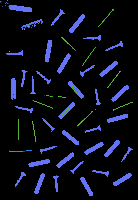

Without contours number:  1368


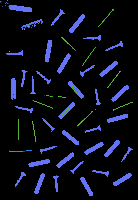

Without contours number:  1369


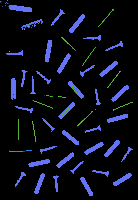

Without contours number:  1370


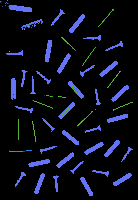

Without contours number:  1371


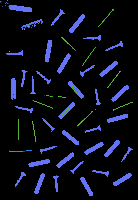

Without contours number:  1372


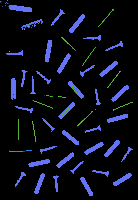

Without contours number:  1373


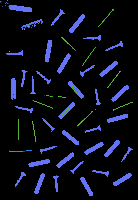

Without contours number:  1374


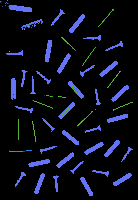

Without contours number:  1375


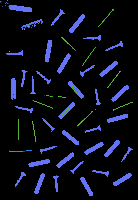

Without contours number:  1376


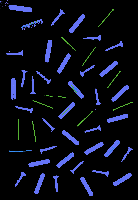

Without contours number:  1377


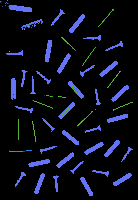

Without contours number:  1378


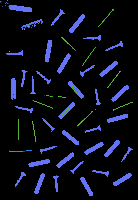

Without contours number:  1379


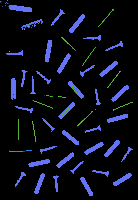

Without contours number:  1380


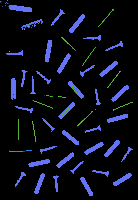

Without contours number:  1381


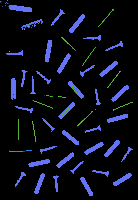

Without contours number:  1382


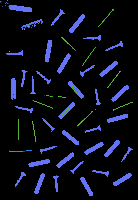

Without contours number:  1383


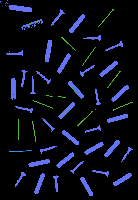

Without contours number:  1384


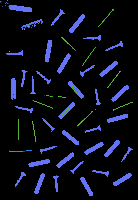

Without contours number:  1385


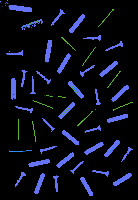

Without contours number:  1386


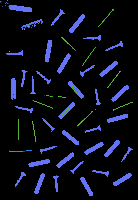

Without contours number:  1387


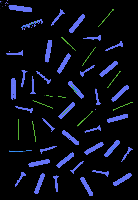

Without contours number:  1388


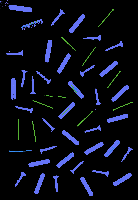

Without contours number:  1389


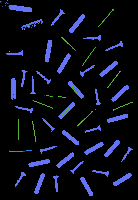

Without contours number:  1390


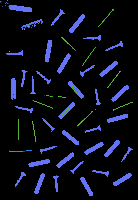

Without contours number:  1391


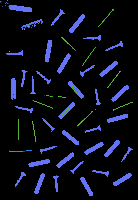

Without contours number:  1392


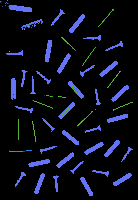

Without contours number:  1393


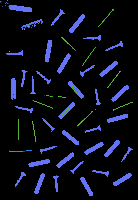

Without contours number:  1394


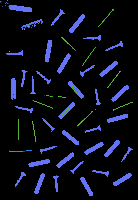

Without contours number:  1395


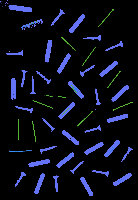

Without contours number:  1396


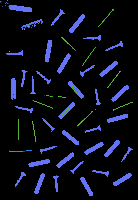

Without contours number:  1397


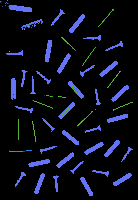

Without contours number:  1398


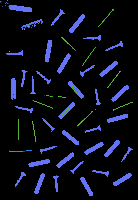

Without contours number:  1399


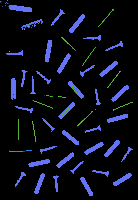

Without contours number:  1400


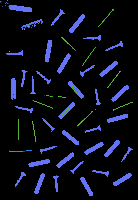

Without contours number:  1401


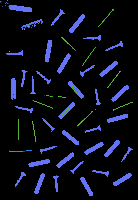

Without contours number:  1402


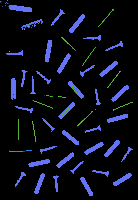

Without contours number:  1403


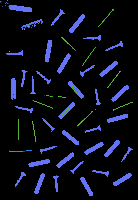

Without contours number:  1404


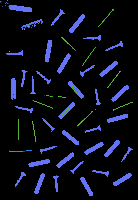

Without contours number:  1405


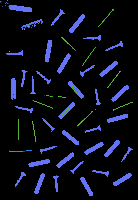

Without contours number:  1406


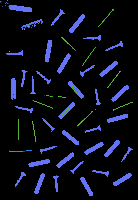

Without contours number:  1407


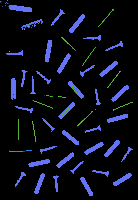

Without contours number:  1408


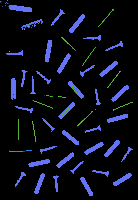

Without contours number:  1409


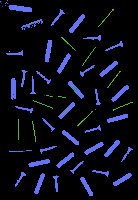

Without contours number:  1410


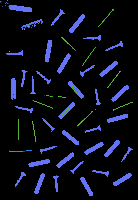

Without contours number:  1411


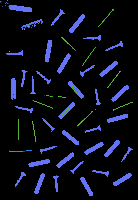

Without contours number:  1412


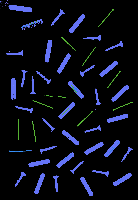

Without contours number:  1413


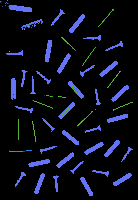

Without contours number:  1414


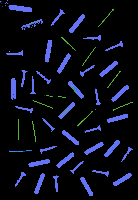

Without contours number:  1415


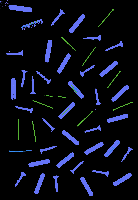

Without contours number:  1416


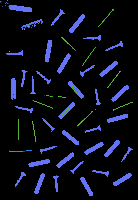

Without contours number:  1417


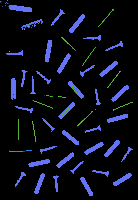

Without contours number:  1418


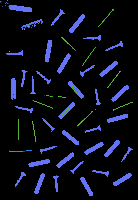

Without contours number:  1419


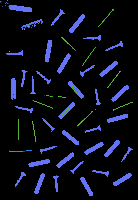

Without contours number:  1420


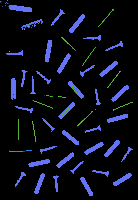

Without contours number:  1421


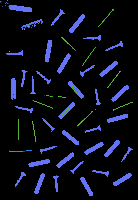

Without contours number:  1422


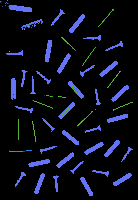

Without contours number:  1423


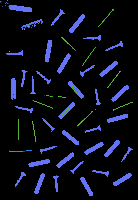

Without contours number:  1424


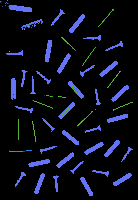

Without contours number:  1426


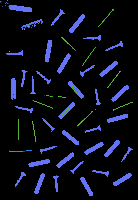

Without contours number:  1427


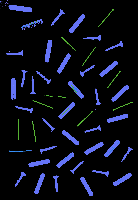

Without contours number:  1428


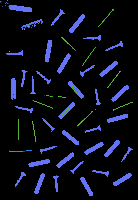

Without contours number:  1429


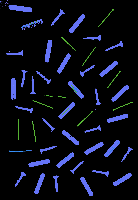

Without contours number:  1430


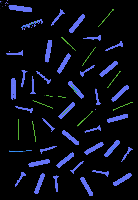

Without contours number:  1431


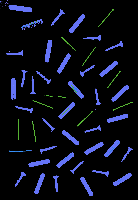

Without contours number:  1432


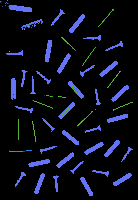

Without contours number:  1433


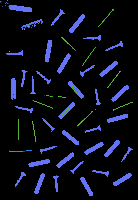

Without contours number:  1434


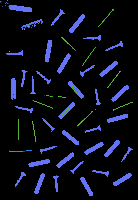

Without contours number:  1435


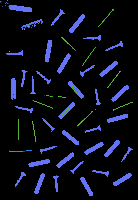

Without contours number:  1436


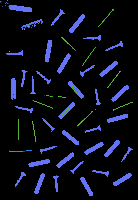

Without contours number:  1437


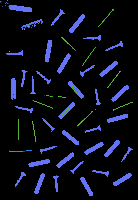

Without contours number:  1438


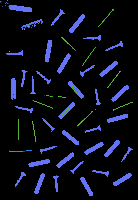

Without contours number:  1439


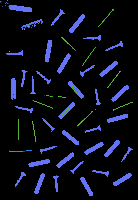

Without contours number:  1440


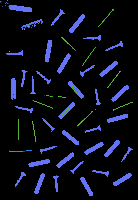

Without contours number:  1441


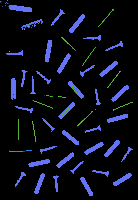

Without contours number:  1442


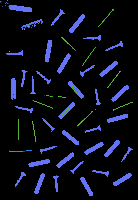

Without contours number:  1443


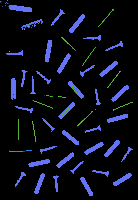

Without contours number:  1444


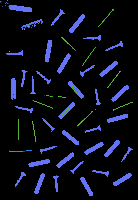

Without contours number:  1445


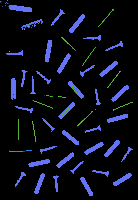

Without contours number:  1446


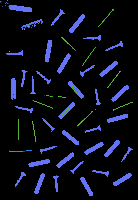

Without contours number:  1447


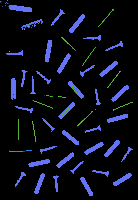

Without contours number:  1448


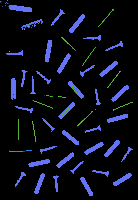

Without contours number:  1449


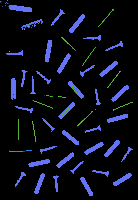

Without contours number:  1450


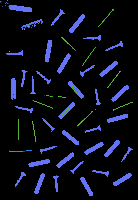

Without contours number:  1451


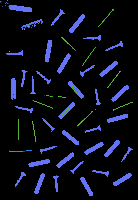

Without contours number:  1452


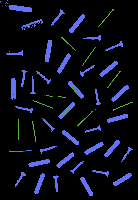

Without contours number:  1453


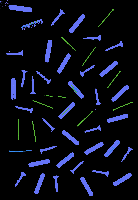

Without contours number:  1454


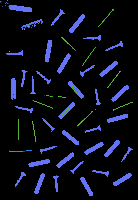

Without contours number:  1455


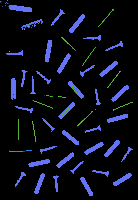

Without contours number:  1456


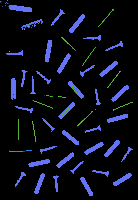

Without contours number:  1457


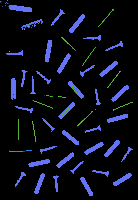

Without contours number:  1458


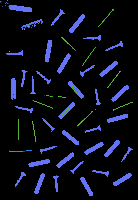

Without contours number:  1459


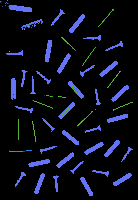

Without contours number:  1460


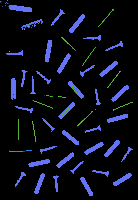

Without contours number:  1461


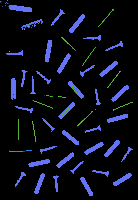

Without contours number:  1462


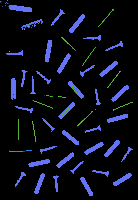

Without contours number:  1463


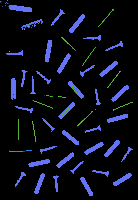

Without contours number:  1464


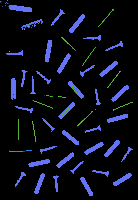

Without contours number:  1465


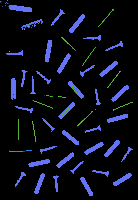

Without contours number:  1466


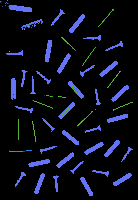

Without contours number:  1467


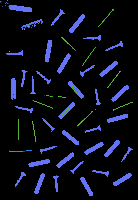

Without contours number:  1468


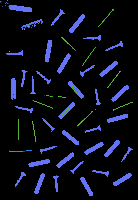

Without contours number:  1469


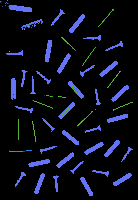

Without contours number:  1470


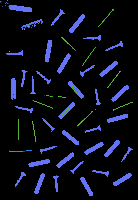

Without contours number:  1471


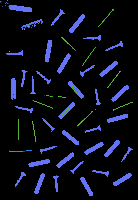

Without contours number:  1472


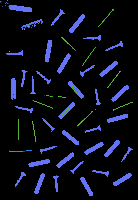

Without contours number:  1473


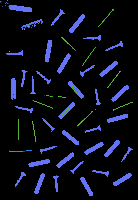

Without contours number:  1474


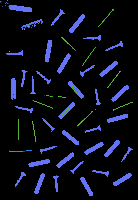

Without contours number:  1475


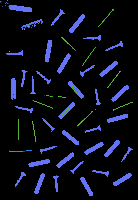

Without contours number:  1476


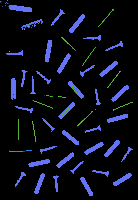

Without contours number:  1477


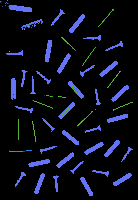

Without contours number:  1478


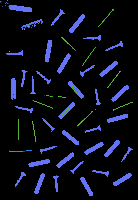

Without contours number:  1479


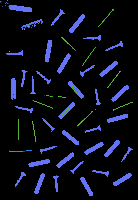

Without contours number:  1480


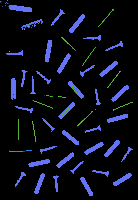

Without contours number:  1481


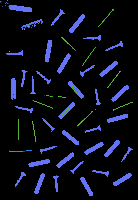

Without contours number:  1482


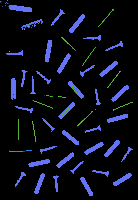

Without contours number:  1483


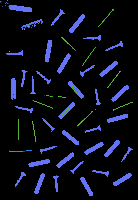

Without contours number:  1484


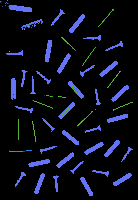

Without contours number:  1485


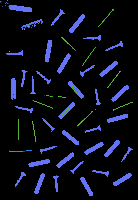

Without contours number:  1486


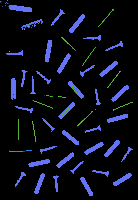

Without contours number:  1487


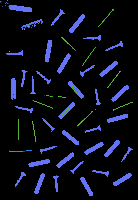

Without contours number:  1488


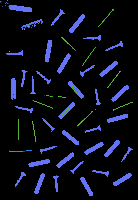

Without contours number:  1489


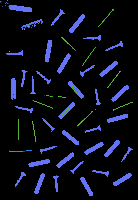

Without contours number:  1490


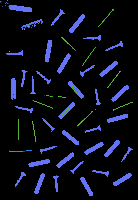

Without contours number:  1491


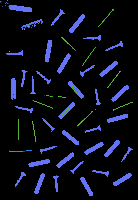

Without contours number:  1492


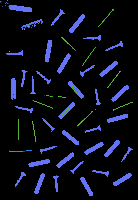

Without contours number:  1493


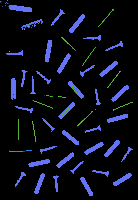

Without contours number:  1494


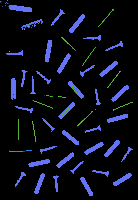

Without contours number:  1495


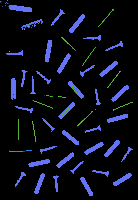

Without contours number:  1496


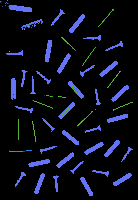

Without contours number:  1497


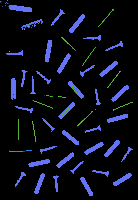

Without contours number:  1498


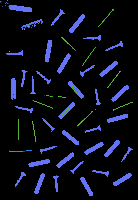

Without contours number:  1499


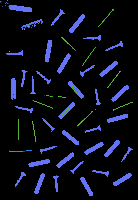

Without contours number:  1500


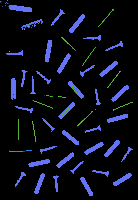

Without contours number:  1501


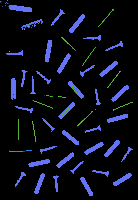

Without contours number:  1502


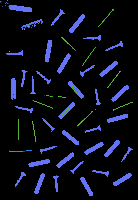

Without contours number:  1503


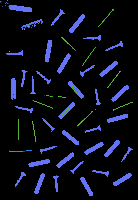

Without contours number:  1504


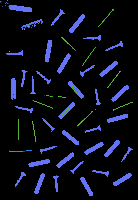

Without contours number:  1505


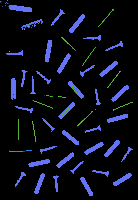

Without contours number:  1506


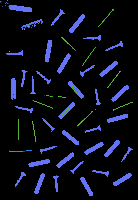

Without contours number:  1507


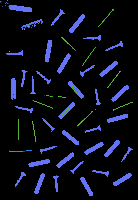

Without contours number:  1508


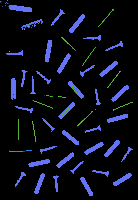

Without contours number:  1509


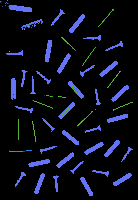

Without contours number:  1510


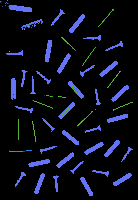

Without contours number:  1511


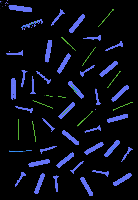

Without contours number:  1512


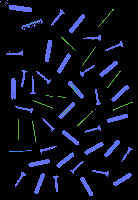

Without contours number:  1513


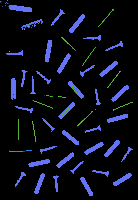

Without contours number:  1514


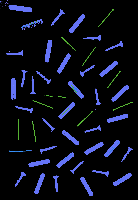

Without contours number:  1515


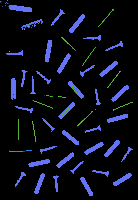

Without contours number:  1516


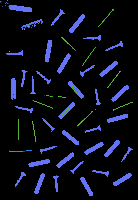

Without contours number:  1517


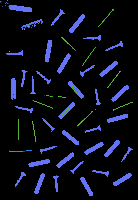

Without contours number:  1518


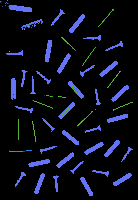

Without contours number:  1519


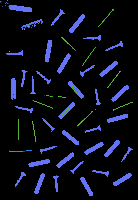

Without contours number:  1520


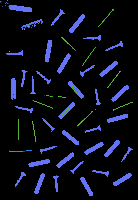

Without contours number:  1521


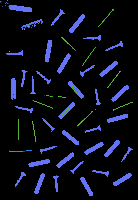

Without contours number:  1522


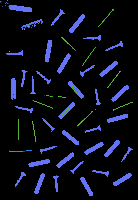

Without contours number:  1523


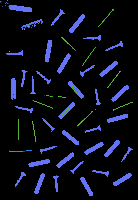

Without contours number:  1524


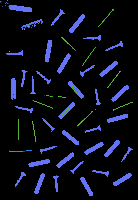

Without contours number:  1525


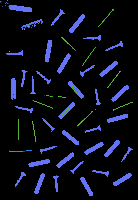

Without contours number:  1526


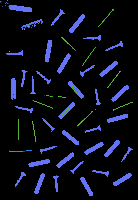

Without contours number:  1527


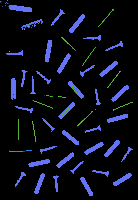

Without contours number:  1528


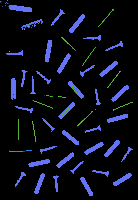

Without contours number:  1529


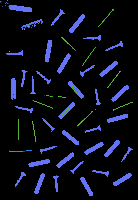

Without contours number:  1530


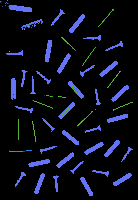

Without contours number:  1531


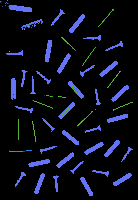

Without contours number:  1532


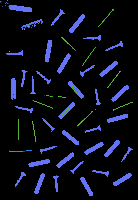

Without contours number:  1533


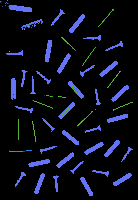

Without contours number:  1534


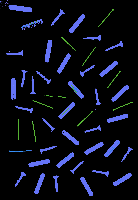

Without contours number:  1535


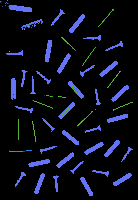

Without contours number:  1536


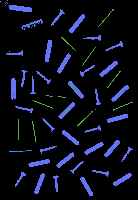

Without contours number:  1537


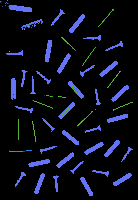

Without contours number:  1538


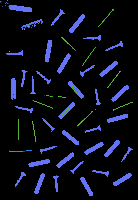

Without contours number:  1539


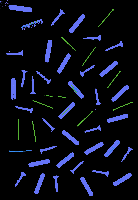

Without contours number:  1540


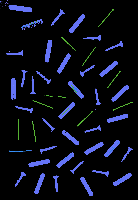

Without contours number:  1541


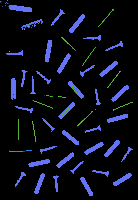

Without contours number:  1542


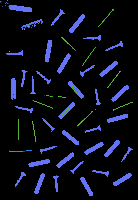

Without contours number:  1543


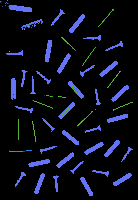

Without contours number:  1544


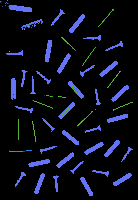

Without contours number:  1545


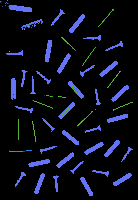

Without contours number:  1546


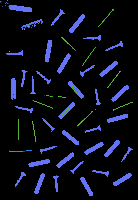

Without contours number:  1547


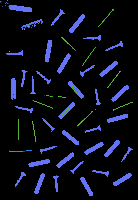

Without contours number:  1548


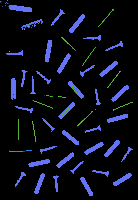

Without contours number:  1549


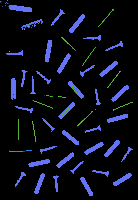

Without contours number:  1550


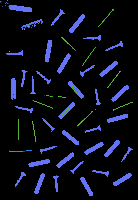

Without contours number:  1551


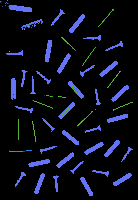

Without contours number:  1552


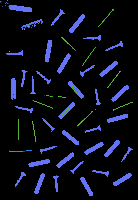

Without contours number:  1553


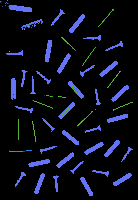

Without contours number:  1554


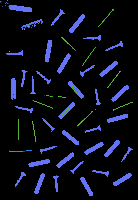

Without contours number:  1555


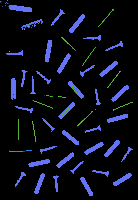

Without contours number:  1556


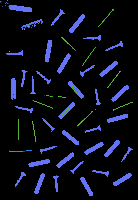

Without contours number:  1557


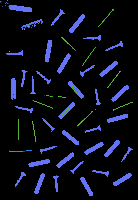

Without contours number:  1558


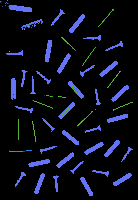

Without contours number:  1559


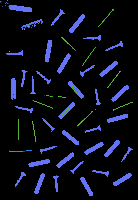

Without contours number:  1560


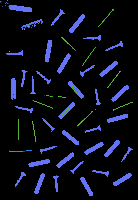

Without contours number:  1561


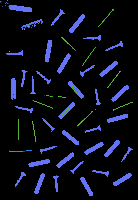

Without contours number:  1562


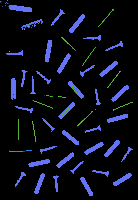

Without contours number:  1563


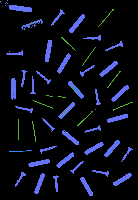

Without contours number:  1564


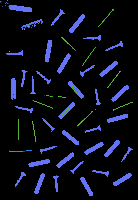

Without contours number:  1565


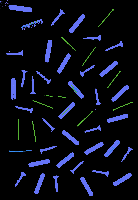

Without contours number:  1566


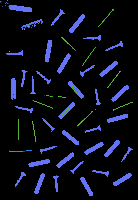

Without contours number:  1567


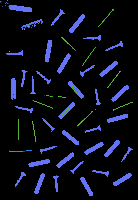

Without contours number:  1568


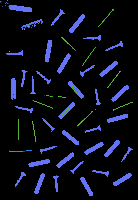

Without contours number:  1569


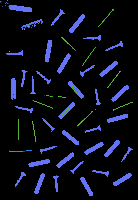

Without contours number:  1570


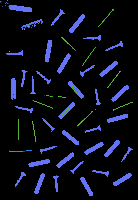

Without contours number:  1571


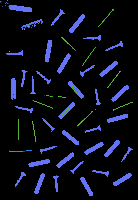

Without contours number:  1572


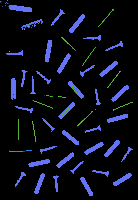

Without contours number:  1573


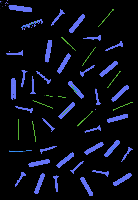

Without contours number:  1574


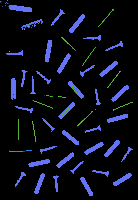

Without contours number:  1575


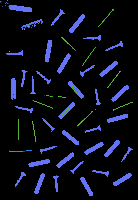

Without contours number:  1576


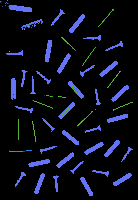

Without contours number:  1577


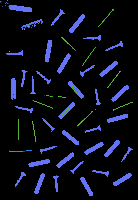

Without contours number:  1578


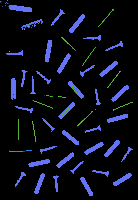

Without contours number:  1579


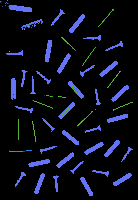

Without contours number:  1580


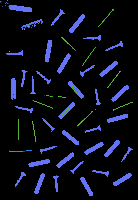

Without contours number:  1581


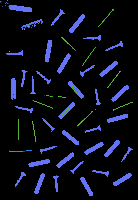

Without contours number:  1582


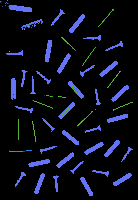

Without contours number:  1583


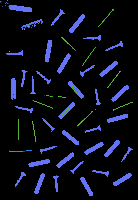

Without contours number:  1584


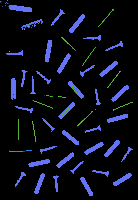

Without contours number:  1586


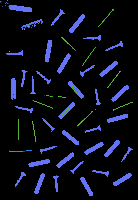

Without contours number:  1587


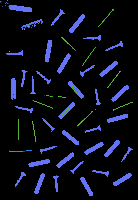

Without contours number:  1588


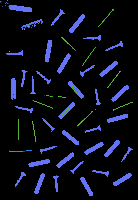

Without contours number:  1589


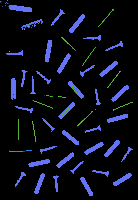

Without contours number:  1591


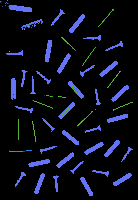

Without contours number:  1592


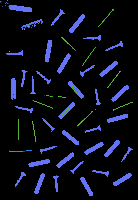

Without contours number:  1593


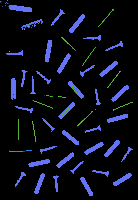

Without contours number:  1594


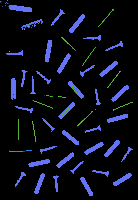

Without contours number:  1595


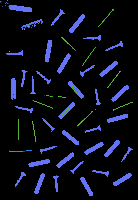

Without contours number:  1596


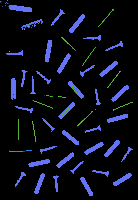

Without contours number:  1597


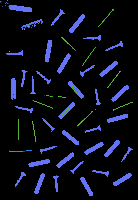

Without contours number:  1598


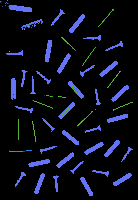

Without contours number:  1599


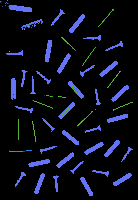

Without contours number:  1600


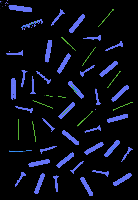

Without contours number:  1601


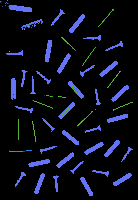

Without contours number:  1602


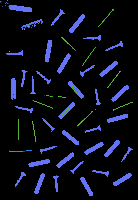

Without contours number:  1604


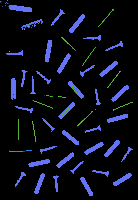

Without contours number:  1605


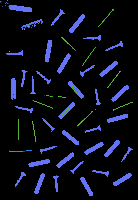

Without contours number:  1606


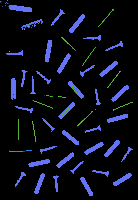

Without contours number:  1607


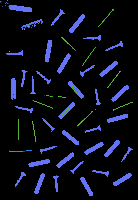

Without contours number:  1608


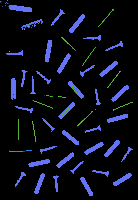

Without contours number:  1609


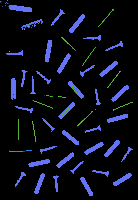

Without contours number:  1610


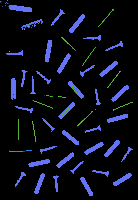

Without contours number:  1611


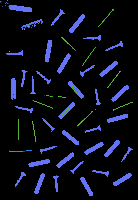

Without contours number:  1612


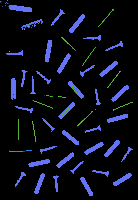

Without contours number:  1613


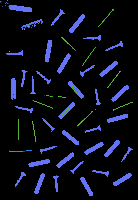

Without contours number:  1614


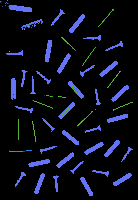

Without contours number:  1615


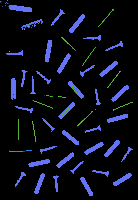

Without contours number:  1616


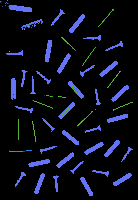

Without contours number:  1617


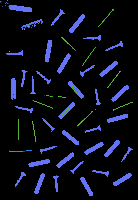

Without contours number:  1618


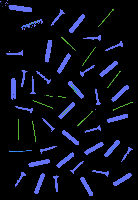

Without contours number:  1619


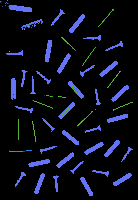

Without contours number:  1620


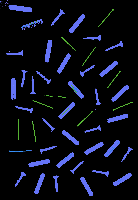

Without contours number:  1621


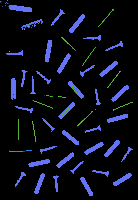

Without contours number:  1622


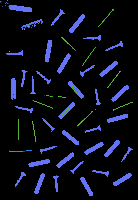

Without contours number:  1623


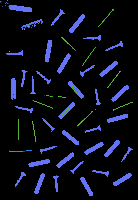

Without contours number:  1624


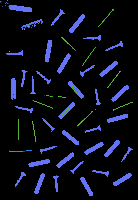

Without contours number:  1625


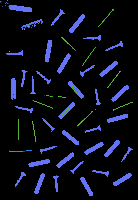

Without contours number:  1626


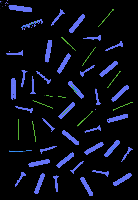

Without contours number:  1627


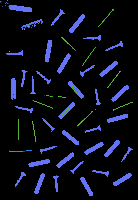

Without contours number:  1628


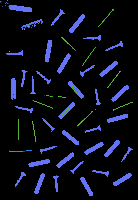

Without contours number:  1629


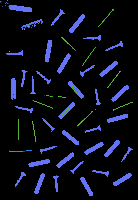

Without contours number:  1630


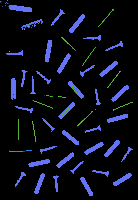

Without contours number:  1631


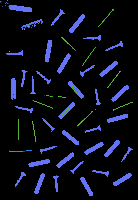

Without contours number:  1632


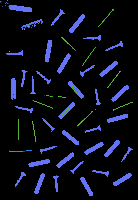

Without contours number:  1633


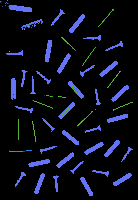

Without contours number:  1634


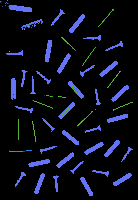

Without contours number:  1635


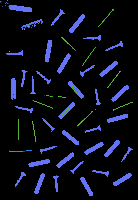

Without contours number:  1636


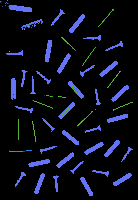

Without contours number:  1637


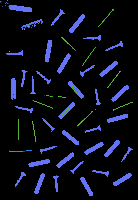

Without contours number:  1638


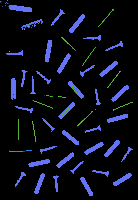

Without contours number:  1639


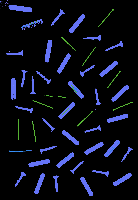

Without contours number:  1640


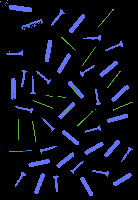

Without contours number:  1641


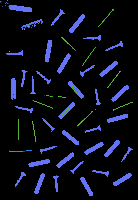

Without contours number:  1642


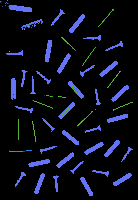

Without contours number:  1643


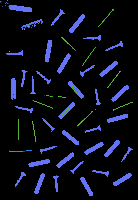

Without contours number:  1645


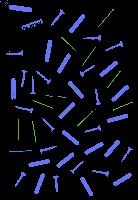

Without contours number:  1646


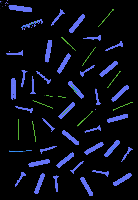

Without contours number:  1647


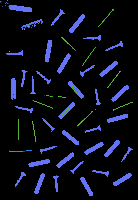

Without contours number:  1648


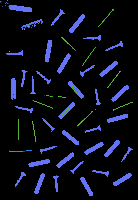

Without contours number:  1649


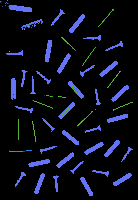

Without contours number:  1650


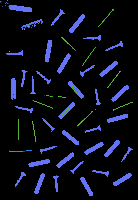

Without contours number:  1651


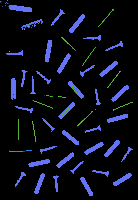

Without contours number:  1652


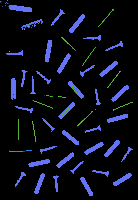

Without contours number:  1653


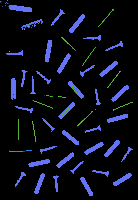

Without contours number:  1654


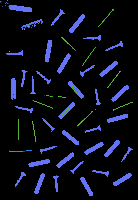

Without contours number:  1655


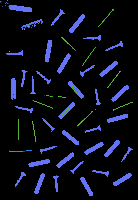

Without contours number:  1656


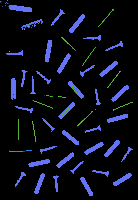

Without contours number:  1657


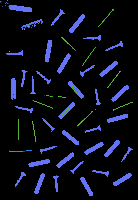

Without contours number:  1659


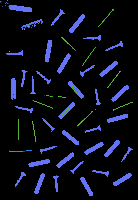

Without contours number:  1660


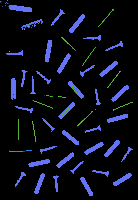

Without contours number:  1661


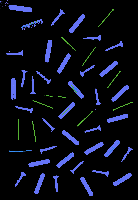

Without contours number:  1662


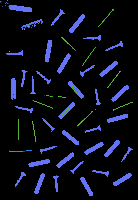

Without contours number:  1663


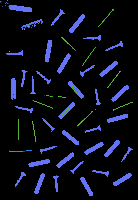

Without contours number:  1664


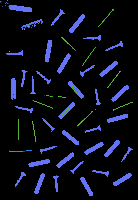

Without contours number:  1665


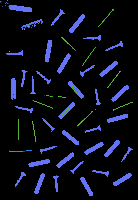

Without contours number:  1666


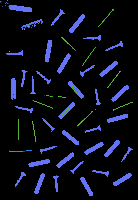

Without contours number:  1667


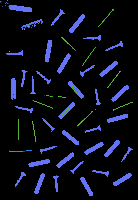

Without contours number:  1668


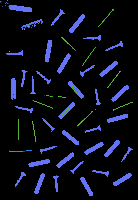

Without contours number:  1669


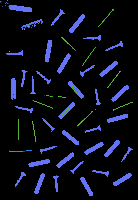

Without contours number:  1670


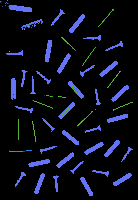

Without contours number:  1671


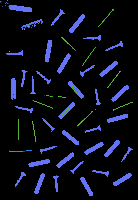

Without contours number:  1672


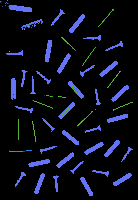

Without contours number:  1674


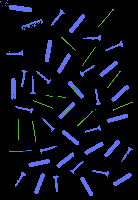

Without contours number:  1675


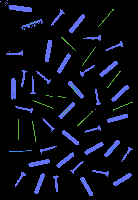

Without contours number:  1676


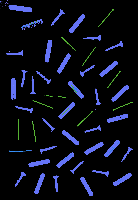

Without contours number:  1677


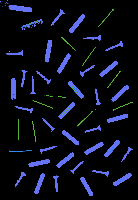

Without contours number:  1678


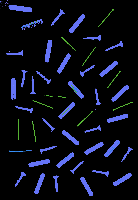

Without contours number:  1679


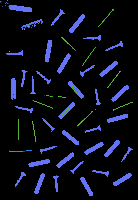

Without contours number:  1680


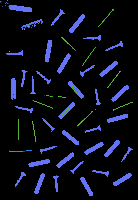

Without contours number:  1681


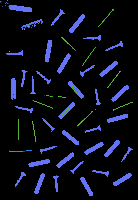

Without contours number:  1682


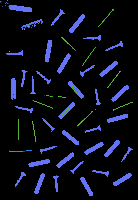

Without contours number:  1683


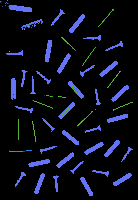

Without contours number:  1684


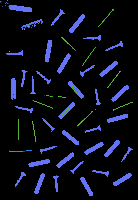

Without contours number:  1685


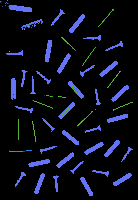

Without contours number:  1686


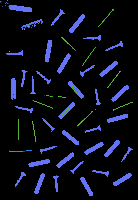

Without contours number:  1687


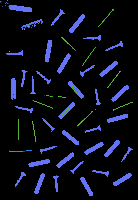

Without contours number:  1688


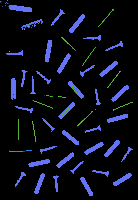

Without contours number:  1689


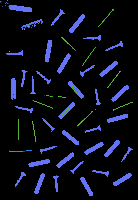

Without contours number:  1690


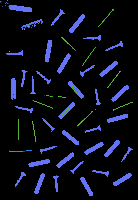

Without contours number:  1691


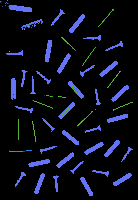

Without contours number:  1692


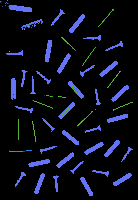

Without contours number:  1693


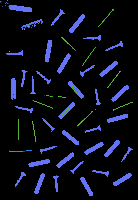

Without contours number:  1694


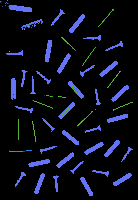

Without contours number:  1695


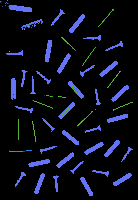

Without contours number:  1696


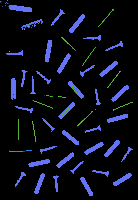

Without contours number:  1697


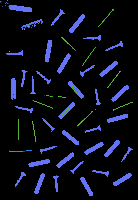

Without contours number:  1698


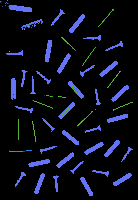

Without contours number:  1699


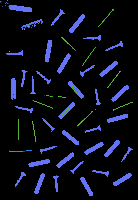

Without contours number:  1700


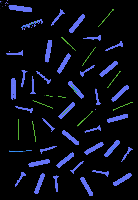

Without contours number:  1701


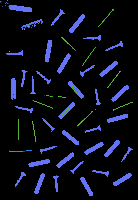

Without contours number:  1702


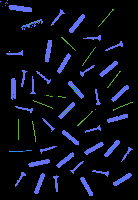

Without contours number:  1703


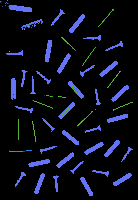

Without contours number:  1704


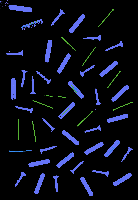

Without contours number:  1705


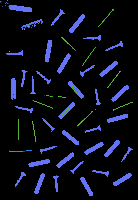

Without contours number:  1706


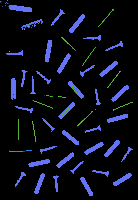

Without contours number:  1707


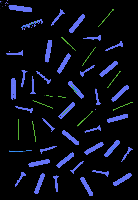

Without contours number:  1708


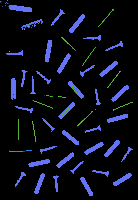

Without contours number:  1709


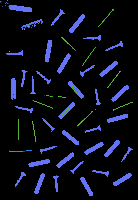

Without contours number:  1710


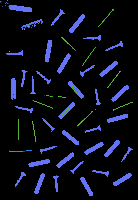

Without contours number:  1711


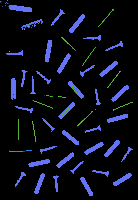

Without contours number:  1712


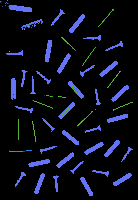

Without contours number:  1713


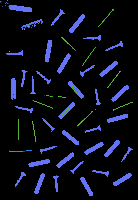

Without contours number:  1714


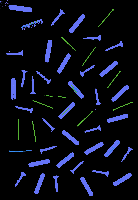

Without contours number:  1715


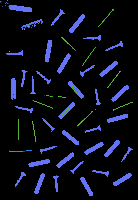

Without contours number:  1716


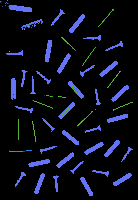

Without contours number:  1717


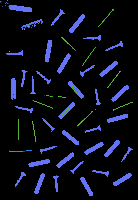

Without contours number:  1719


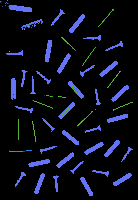

Without contours number:  1720


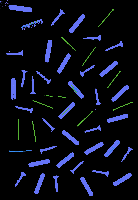

Without contours number:  1721


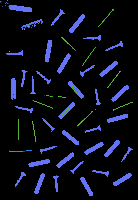

Without contours number:  1722


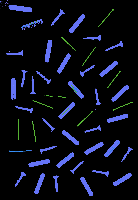

Without contours number:  1723


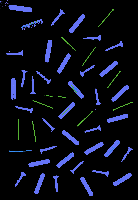

Without contours number:  1725


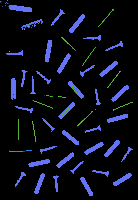

Without contours number:  1726


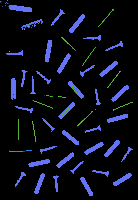

Without contours number:  1727


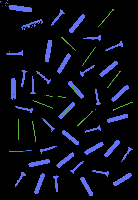

Without contours number:  1728


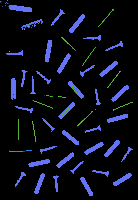

Without contours number:  1729


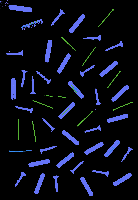

Without contours number:  1731


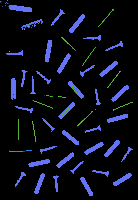

Without contours number:  1732


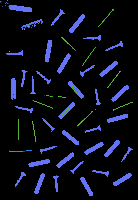

Without contours number:  1733


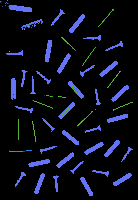

Without contours number:  1734


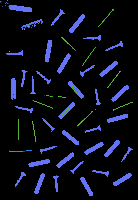

Without contours number:  1735


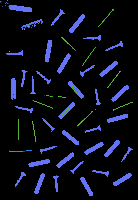

Without contours number:  1736


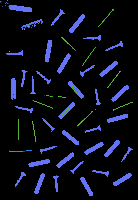

Without contours number:  1737


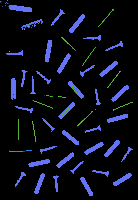

Without contours number:  1738


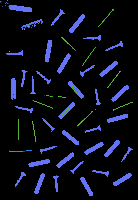

Without contours number:  1739


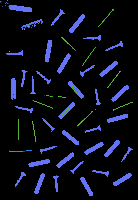

Without contours number:  1740


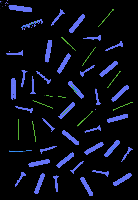

Without contours number:  1741


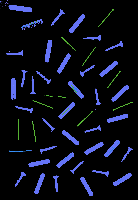

Without contours number:  1742


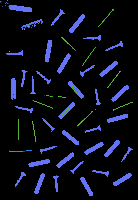

Without contours number:  1743


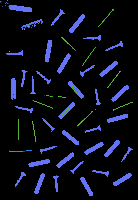

Without contours number:  1744


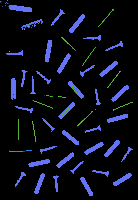

Without contours number:  1745


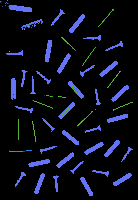

Without contours number:  1746


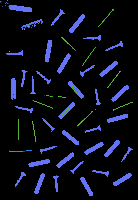

Without contours number:  1747


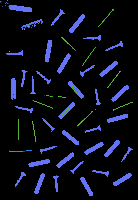

Without contours number:  1748


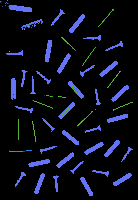

Without contours number:  1749


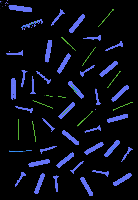

Without contours number:  1750


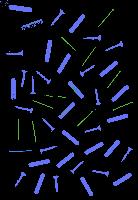

Without contours number:  1751


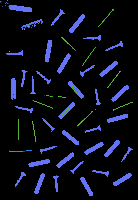

Without contours number:  1752


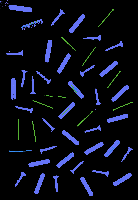

Without contours number:  1753


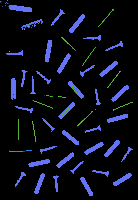

Without contours number:  1754


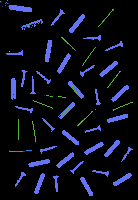

Without contours number:  1755


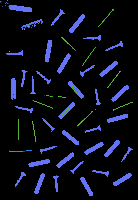

Without contours number:  1756


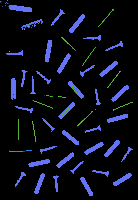

Without contours number:  1757


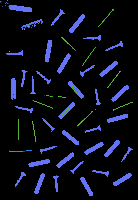

Without contours number:  1758


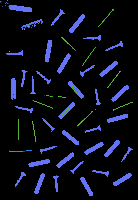

Without contours number:  1759


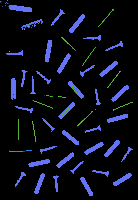

Without contours number:  1760


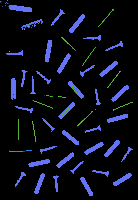

Without contours number:  1761


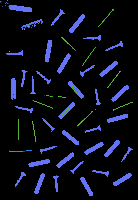

Without contours number:  1762


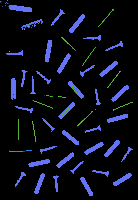

Without contours number:  1763


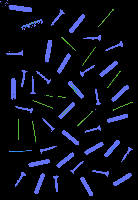

Without contours number:  1764


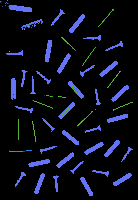

Without contours number:  1765


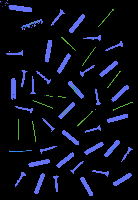

Without contours number:  1766


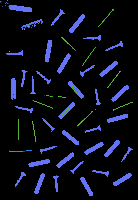

Without contours number:  1767


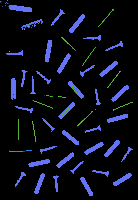

Without contours number:  1768


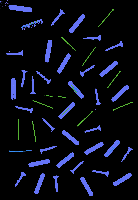

Without contours number:  1769


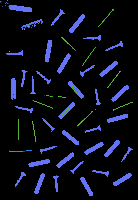

Without contours number:  1770


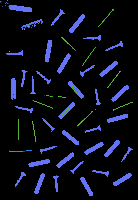

Without contours number:  1771


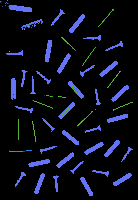

Without contours number:  1772


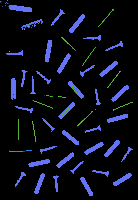

Without contours number:  1773


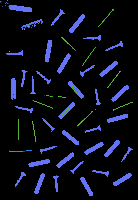

Without contours number:  1774


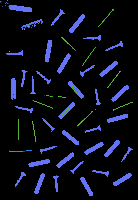

Without contours number:  1775


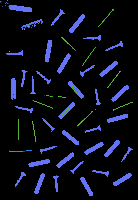

Without contours number:  1776


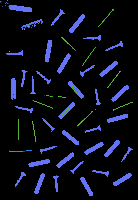

Without contours number:  1777


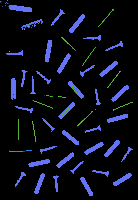

Without contours number:  1778


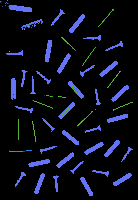

Without contours number:  1779


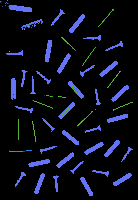

Without contours number:  1780


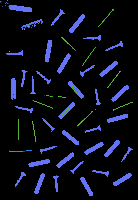

Without contours number:  1781


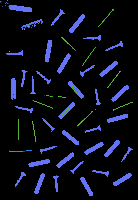

Without contours number:  1782


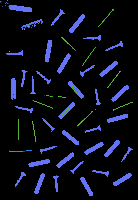

Without contours number:  1783


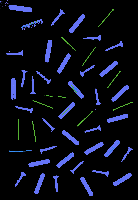

Without contours number:  1784


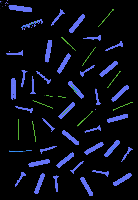

Without contours number:  1785


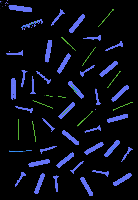

Without contours number:  1786


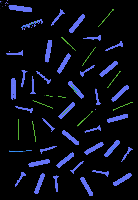

Without contours number:  1787


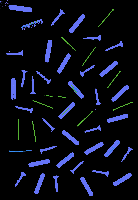

Without contours number:  1788


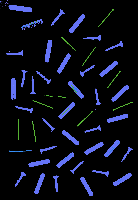

Without contours number:  1789


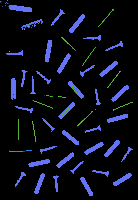

Without contours number:  1790


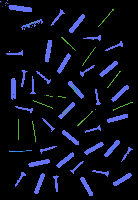

Without contours number:  1791


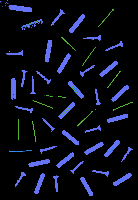

Without contours number:  1792


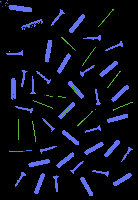

Without contours number:  1793


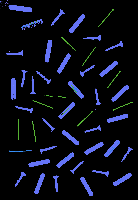

Without contours number:  1794


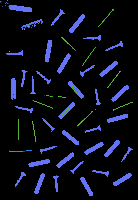

Without contours number:  1795


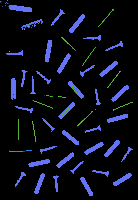

Without contours number:  1796


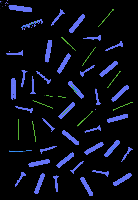

Without contours number:  1797


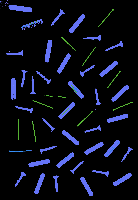

Without contours number:  1798


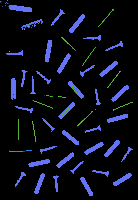

Without contours number:  1799


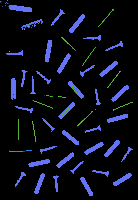

Without contours number:  1801


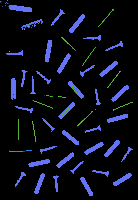

Without contours number:  1802


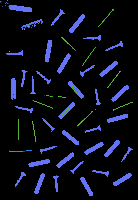

Without contours number:  1803


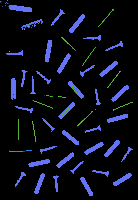

Without contours number:  1804


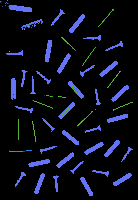

Without contours number:  1805


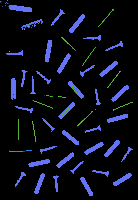

Without contours number:  1806


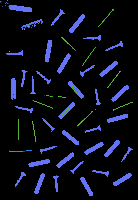

Without contours number:  1807


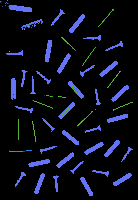

Without contours number:  1808


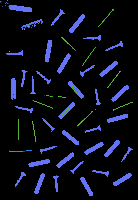

Without contours number:  1809


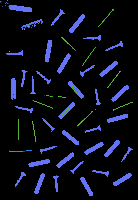

Without contours number:  1810


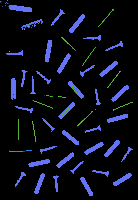

Without contours number:  1811


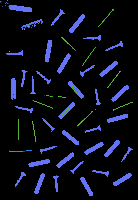

Without contours number:  1812


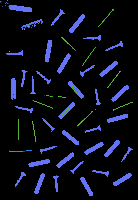

Without contours number:  1813


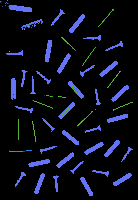

Without contours number:  1814


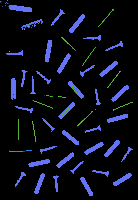

Without contours number:  1815


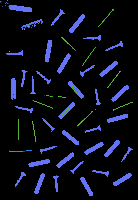

Without contours number:  1816


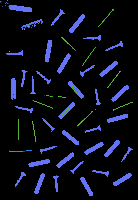

Without contours number:  1817


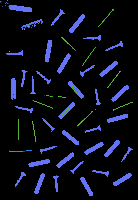

Without contours number:  1818


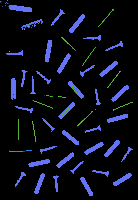

Without contours number:  1819


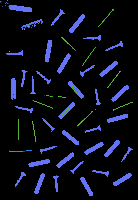

Without contours number:  1820


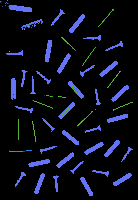

Without contours number:  1821


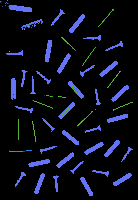

Without contours number:  1822


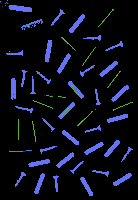

Without contours number:  1824


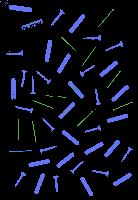

Without contours number:  1825


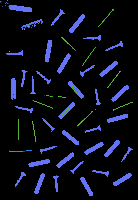

Without contours number:  1826


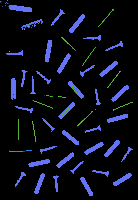

Without contours number:  1827


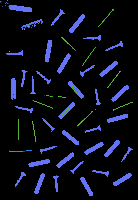

Without contours number:  1828


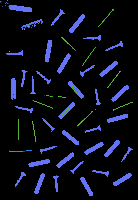

Without contours number:  1829


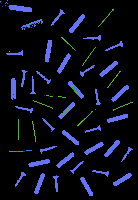

Without contours number:  1830


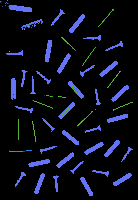

Without contours number:  1831


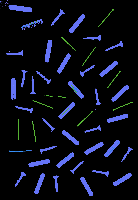

Without contours number:  1832


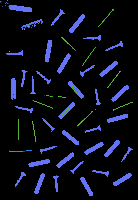

Without contours number:  1833


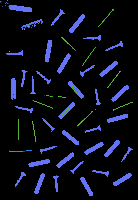

Without contours number:  1834


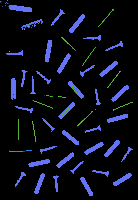

Without contours number:  1835


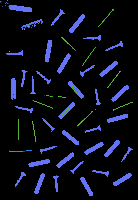

Without contours number:  1836


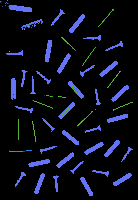

Without contours number:  1837


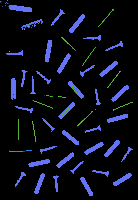

Without contours number:  1838


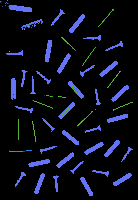

Without contours number:  1840


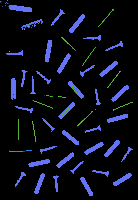

Without contours number:  1841


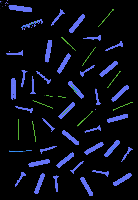

Without contours number:  1842


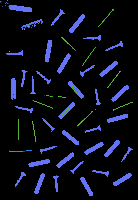

Without contours number:  1843


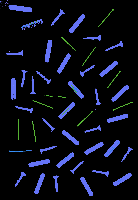

Without contours number:  1844


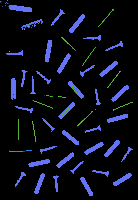

Without contours number:  1845


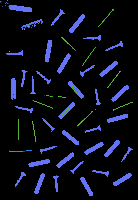

Without contours number:  1846


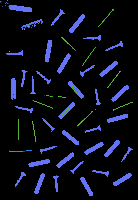

Without contours number:  1848


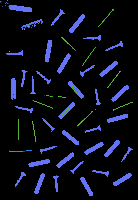

Without contours number:  1849


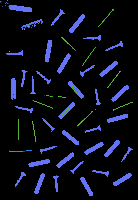

Without contours number:  1850


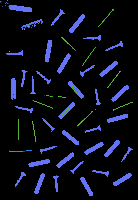

Without contours number:  1851


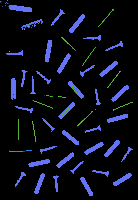

Without contours number:  1852


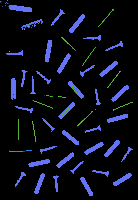

Without contours number:  1853


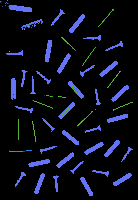

Without contours number:  1854


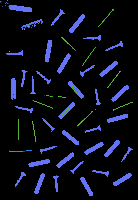

Without contours number:  1855


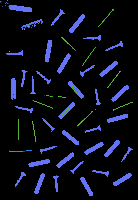

Without contours number:  1856


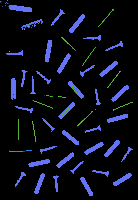

Without contours number:  1857


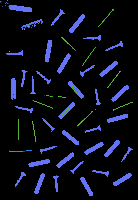

Without contours number:  1858


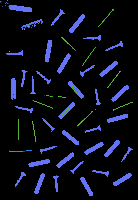

Without contours number:  1859


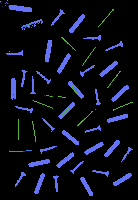

Without contours number:  1860


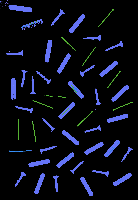

Without contours number:  1861


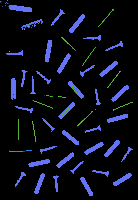

Without contours number:  1862


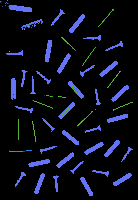

Without contours number:  1863


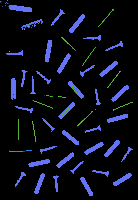

Without contours number:  1864


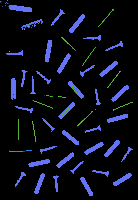

Without contours number:  1865


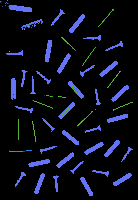

Without contours number:  1866


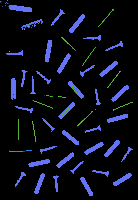

Without contours number:  1867


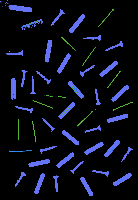

Without contours number:  1868


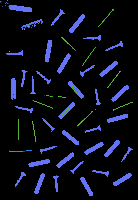

Without contours number:  1869


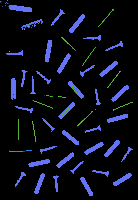

Without contours number:  1870


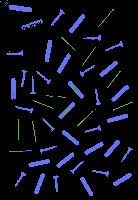

Without contours number:  1871


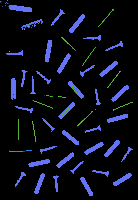

Without contours number:  1872


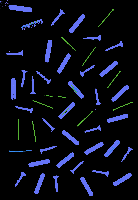

Without contours number:  1873


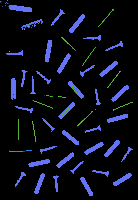

Without contours number:  1874


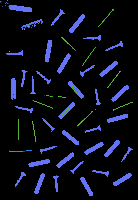

Without contours number:  1875


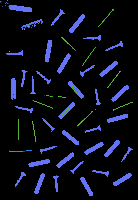

Without contours number:  1876


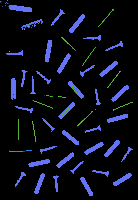

Without contours number:  1878


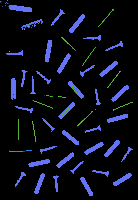

Without contours number:  1879


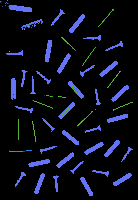

Without contours number:  1880


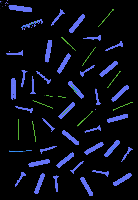

Without contours number:  1881


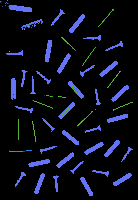

Without contours number:  1882


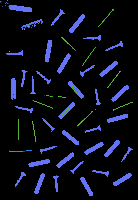

Without contours number:  1883


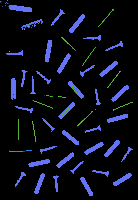

Without contours number:  1884


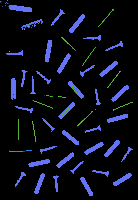

Without contours number:  1885


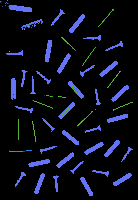

Without contours number:  1887


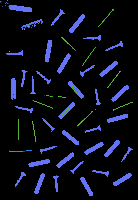

Without contours number:  1888


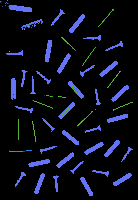

Without contours number:  1889


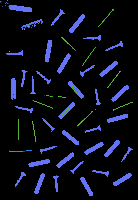

Without contours number:  1890


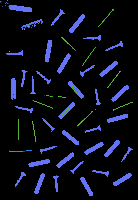

Without contours number:  1891


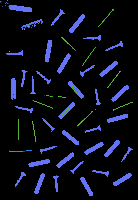

Without contours number:  1892


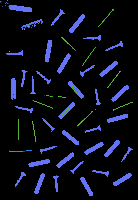

Without contours number:  1893


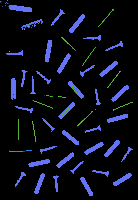

Without contours number:  1894


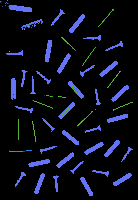

Without contours number:  1895


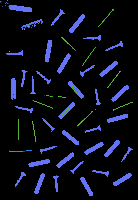

Without contours number:  1896


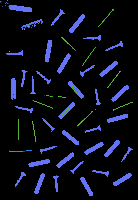

Without contours number:  1897


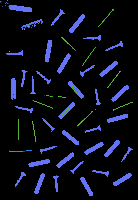

Without contours number:  1898


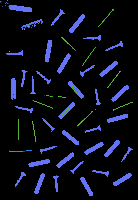

Without contours number:  1899


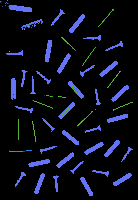

Without contours number:  1900


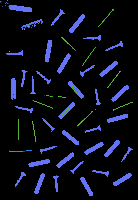

Without contours number:  1901


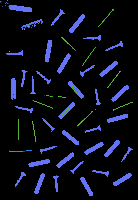

Without contours number:  1902


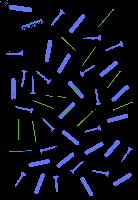

Without contours number:  1903


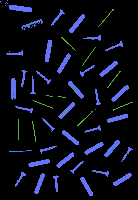

Without contours number:  1904


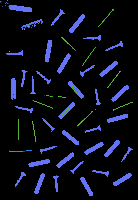

Without contours number:  1905


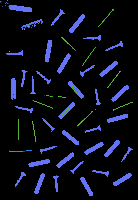

Without contours number:  1906


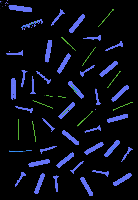

Without contours number:  1907


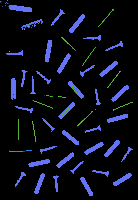

Without contours number:  1908


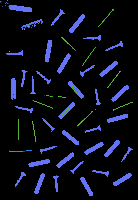

Without contours number:  1909


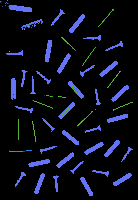

Without contours number:  1910


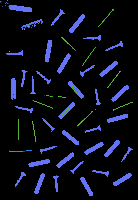

Without contours number:  1911


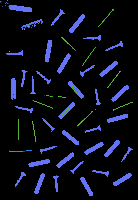

Without contours number:  1912


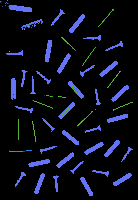

Without contours number:  1913


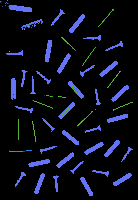

Without contours number:  1914


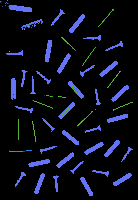

Without contours number:  1915


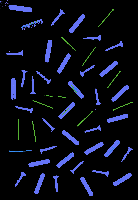

Without contours number:  1916


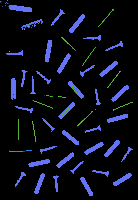

Without contours number:  1917


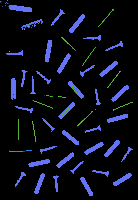

Without contours number:  1918


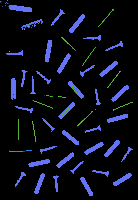

Without contours number:  1919


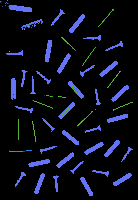

Without contours number:  1920


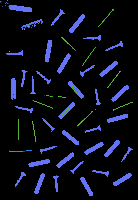

Without contours number:  1921


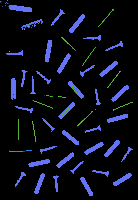

Without contours number:  1922


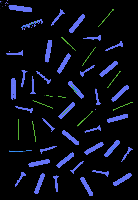

Without contours number:  1923


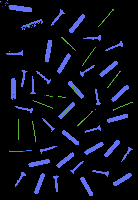

Without contours number:  1924


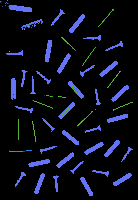

Without contours number:  1925


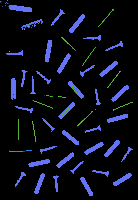

Without contours number:  1926


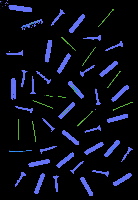

Without contours number:  1927


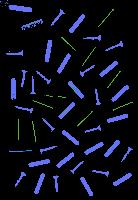

Without contours number:  1928


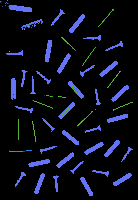

Without contours number:  1929


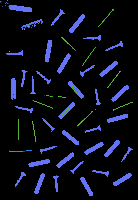

Without contours number:  1930


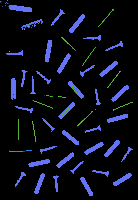

Without contours number:  1931


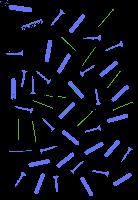

Without contours number:  1932


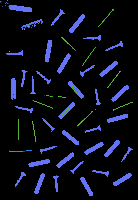

Without contours number:  1933


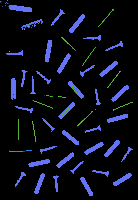

Without contours number:  1934


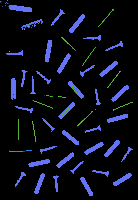

Without contours number:  1935


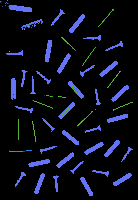

Without contours number:  1936


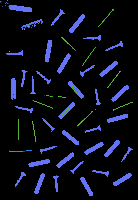

Without contours number:  1937


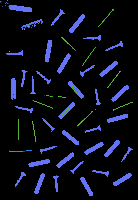

Without contours number:  1938


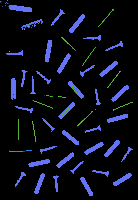

Without contours number:  1939


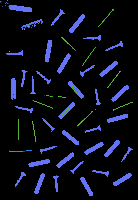

Without contours number:  1940


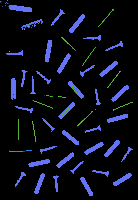

Without contours number:  1941


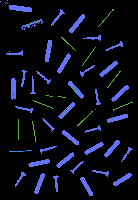

Without contours number:  1942


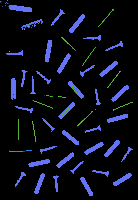

Without contours number:  1943


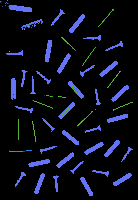

Without contours number:  1944


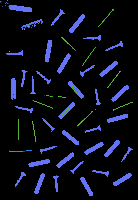

Without contours number:  1945


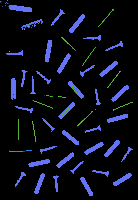

Without contours number:  1946


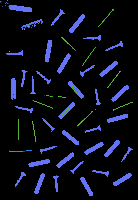

Without contours number:  1947


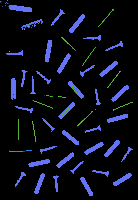

Without contours number:  1948


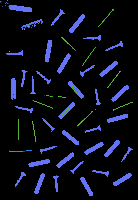

Without contours number:  1949


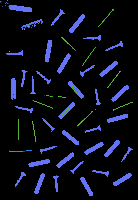

Without contours number:  1950


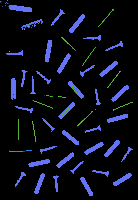

Without contours number:  1951


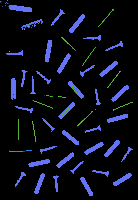

Without contours number:  1952


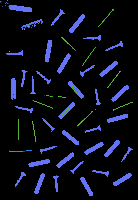

Without contours number:  1953


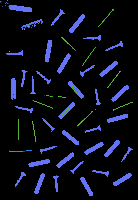

Without contours number:  1954


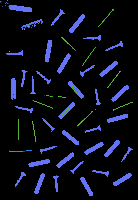

Without contours number:  1955


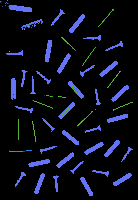

Without contours number:  1956


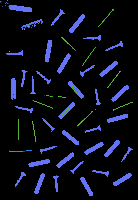

Without contours number:  1957


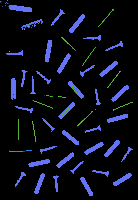

Without contours number:  1959


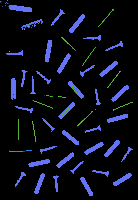

Without contours number:  1960


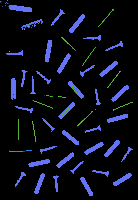

Without contours number:  1961


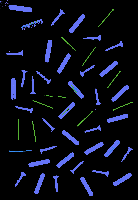

Without contours number:  1962


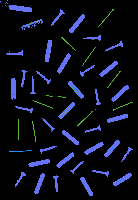

Without contours number:  1963


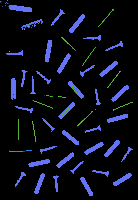

Without contours number:  1964


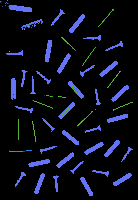

Without contours number:  1965


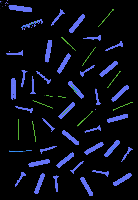

Without contours number:  1966


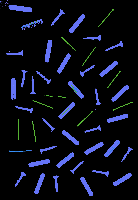

Without contours number:  1967


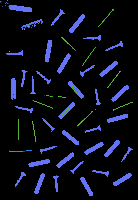

Without contours number:  1968


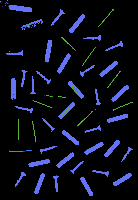

Without contours number:  1969


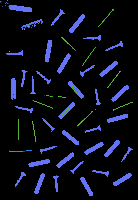

Without contours number:  1971


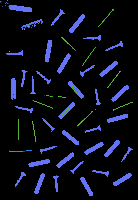

Without contours number:  1972


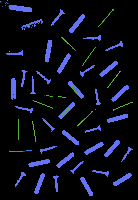

Without contours number:  1973


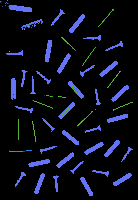

Without contours number:  1974


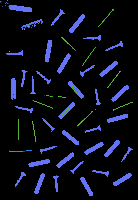

Without contours number:  1975


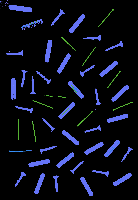

Without contours number:  1976


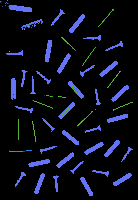

Without contours number:  1977


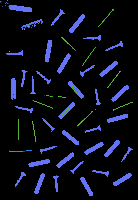

Without contours number:  1978


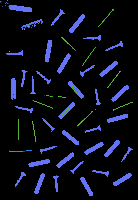

Without contours number:  1979


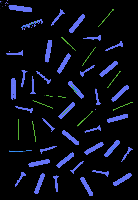

Without contours number:  1980


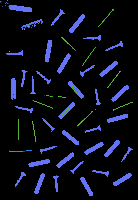

Without contours number:  1981


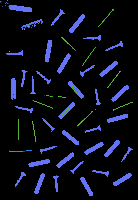

Without contours number:  1982


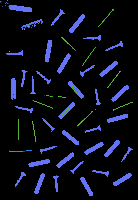

Without contours number:  1983


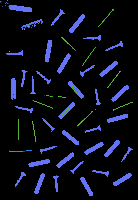

Without contours number:  1984


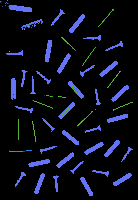

Without contours number:  1985


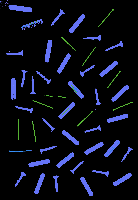

Without contours number:  1986


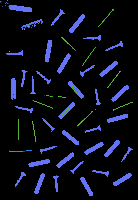

Without contours number:  1987


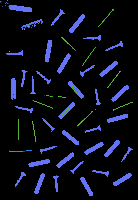

Without contours number:  1988


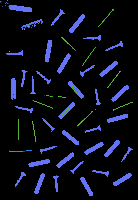

Without contours number:  1989


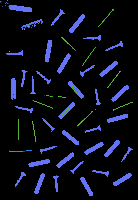

Without contours number:  1990


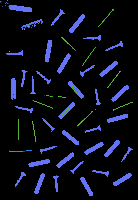

Without contours number:  1991


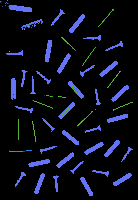

Without contours number:  1992


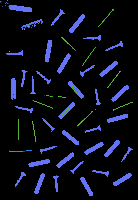

Without contours number:  1993


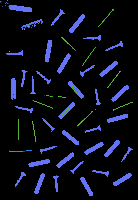

Without contours number:  1994


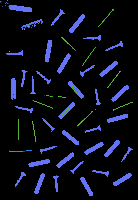

Without contours number:  1995


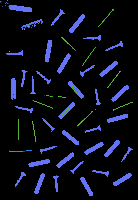

Without contours number:  1996


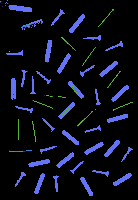

Without contours number:  1997


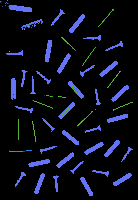

Without contours number:  1998


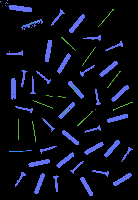

Without contours number:  1999


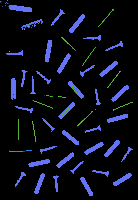

Without contours number:  2000


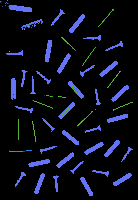

Without contours number:  2001


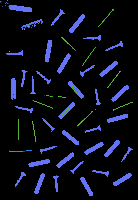

Without contours number:  2002


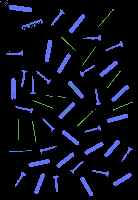

Without contours number:  2003


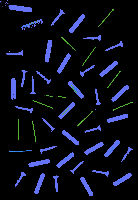

Without contours number:  2004


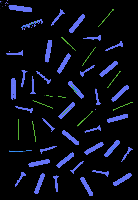

Without contours number:  2005


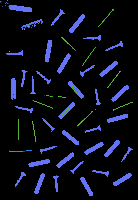

Without contours number:  2006


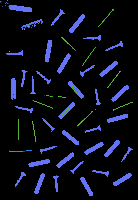

Without contours number:  2007


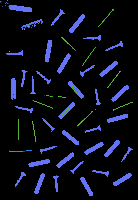

Without contours number:  2008


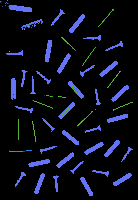

Without contours number:  2009


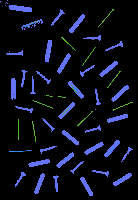

Without contours number:  2010


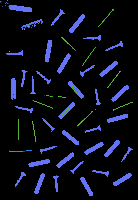

Without contours number:  2011


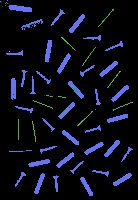

Without contours number:  2012


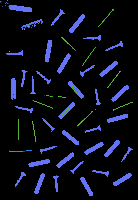

Without contours number:  2013


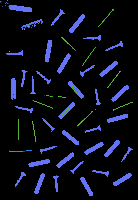

Without contours number:  2014


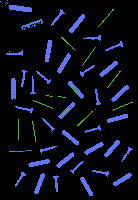

Without contours number:  2015


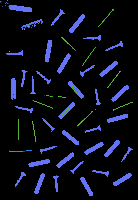

Without contours number:  2017


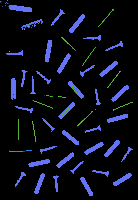

Without contours number:  2018


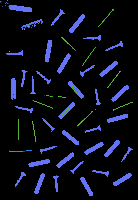

Without contours number:  2019


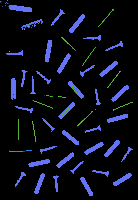

Without contours number:  2020


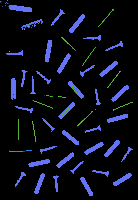

Without contours number:  2021


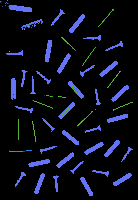

Without contours number:  2022


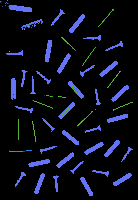

Without contours number:  2023


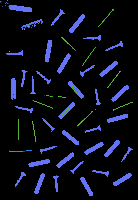

Without contours number:  2024


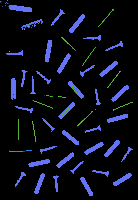

Without contours number:  2025


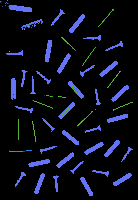

Without contours number:  2026


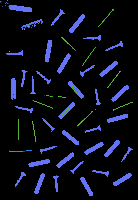

Without contours number:  2027


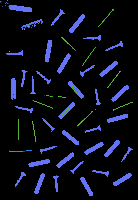

Without contours number:  2028


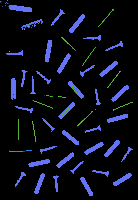

Without contours number:  2029


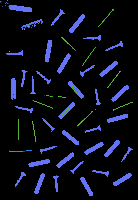

Without contours number:  2030


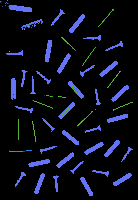

Without contours number:  2031


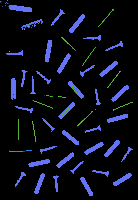

Without contours number:  2032


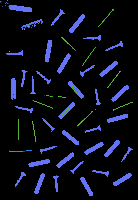

Without contours number:  2033


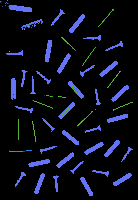

Without contours number:  2034


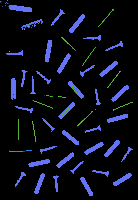

Without contours number:  2035


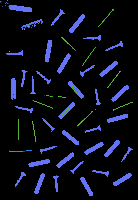

Without contours number:  2036


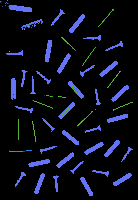

Without contours number:  2037


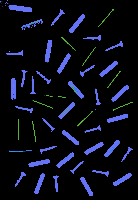

Without contours number:  2038


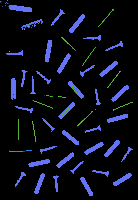

Without contours number:  2039


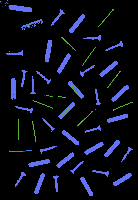

Without contours number:  2040


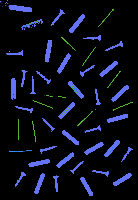

Without contours number:  2041


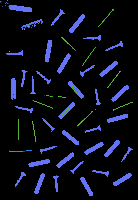

Without contours number:  2042


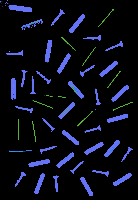

Without contours number:  2043


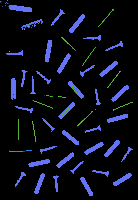

Without contours number:  2044


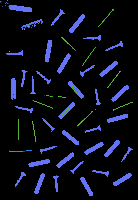

Without contours number:  2045


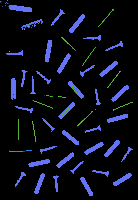

Without contours number:  2046


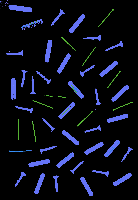

Without contours number:  2047


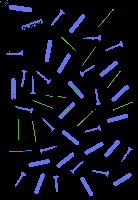

Without contours number:  2048


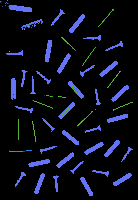

Without contours number:  2049


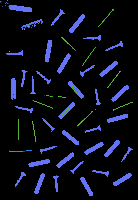

Without contours number:  2050


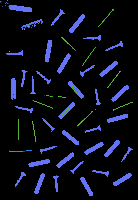

Without contours number:  2051


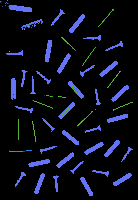

Without contours number:  2052


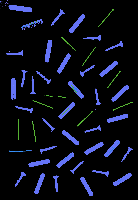

Without contours number:  2053


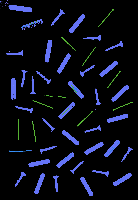

Without contours number:  2054


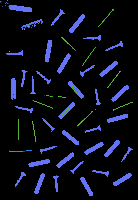

Without contours number:  2055


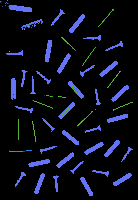

Without contours number:  2056


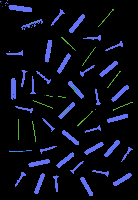

Without contours number:  2057


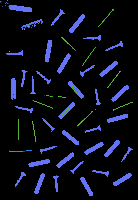

Without contours number:  2058


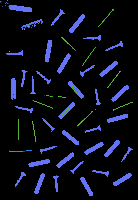

Without contours number:  2059


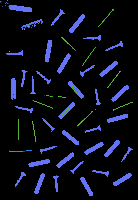

Without contours number:  2060


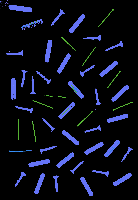

Without contours number:  2061


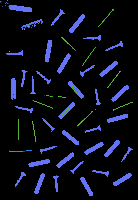

Without contours number:  2062


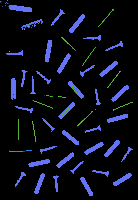

Without contours number:  2063


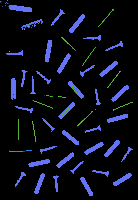

Without contours number:  2065


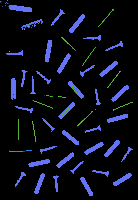

Without contours number:  2066


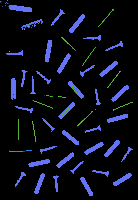

Without contours number:  2067


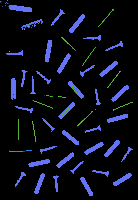

Without contours number:  2068


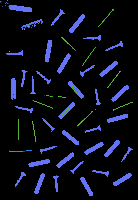

Without contours number:  2069


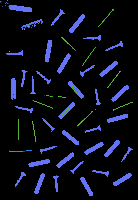

Without contours number:  2070


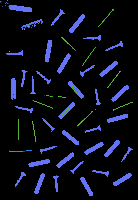

Without contours number:  2071


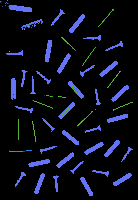

Without contours number:  2072


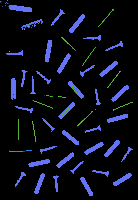

Without contours number:  2073


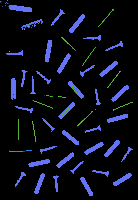

Without contours number:  2074


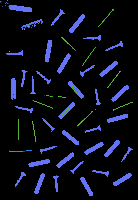

Without contours number:  2075


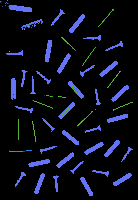

Without contours number:  2076


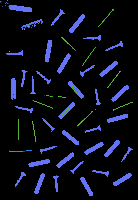

Without contours number:  2077


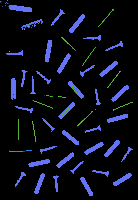

Without contours number:  2078


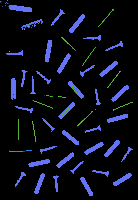

Without contours number:  2079


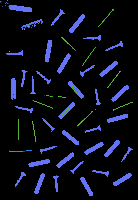

Without contours number:  2080


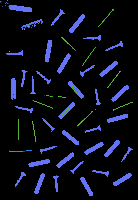

Without contours number:  2081


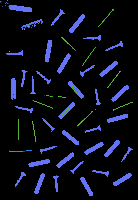

Without contours number:  2082


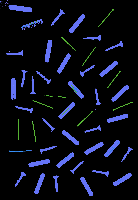

Without contours number:  2083


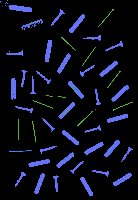

Without contours number:  2084


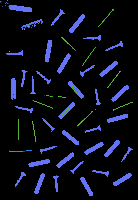

Without contours number:  2085


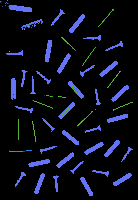

Without contours number:  2086


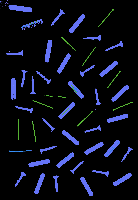

Without contours number:  2087


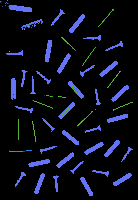

Without contours number:  2088


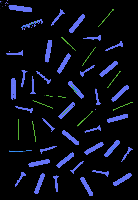

Without contours number:  2089


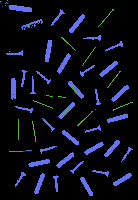

Without contours number:  2090


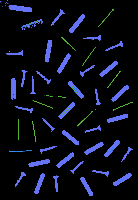

Without contours number:  2091


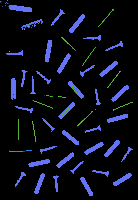

Without contours number:  2092


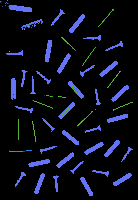

Without contours number:  2093


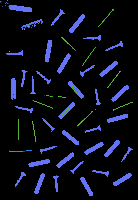

Without contours number:  2094


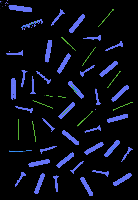

Without contours number:  2095


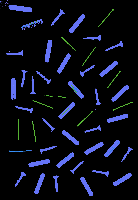

Without contours number:  2096


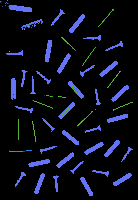

Without contours number:  2097


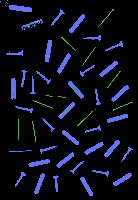

Without contours number:  2098


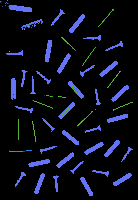

Without contours number:  2099


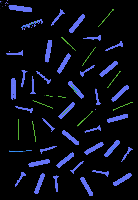

Without contours number:  2100


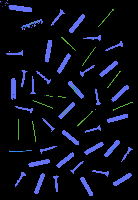

Without contours number:  2101


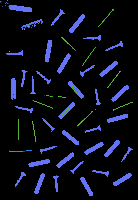

Without contours number:  2102


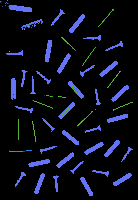

Without contours number:  2103


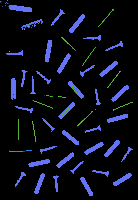

Without contours number:  2104


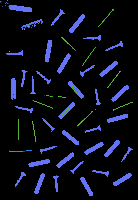

Without contours number:  2105


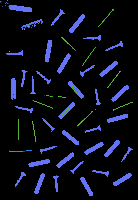

Without contours number:  2106


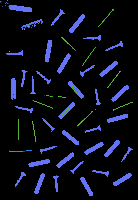

Without contours number:  2107


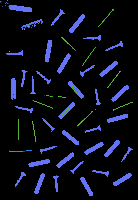

Without contours number:  2108


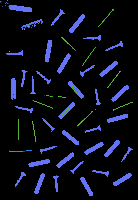

Without contours number:  2109


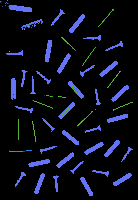

Without contours number:  2110


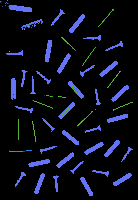

Without contours number:  2111


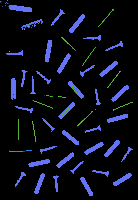

Without contours number:  2112


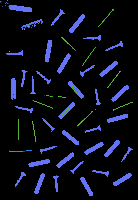

Without contours number:  2113


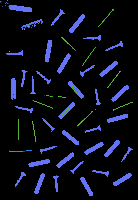

Without contours number:  2114


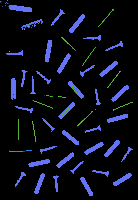

Without contours number:  2115


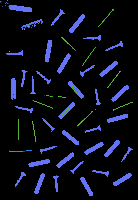

Without contours number:  2116


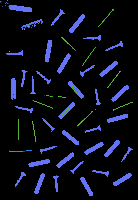

Without contours number:  2117


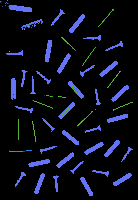

Without contours number:  2118


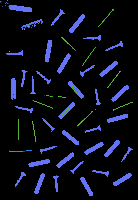

Without contours number:  2119


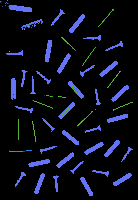

Without contours number:  2120


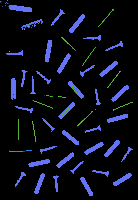

Without contours number:  2121


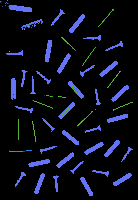

Without contours number:  2122


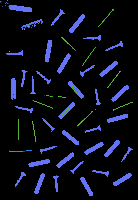

Without contours number:  2123


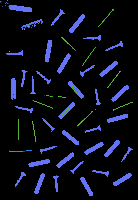

Without contours number:  2124


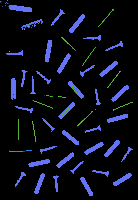

Without contours number:  2125


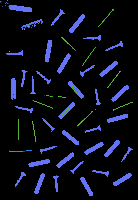

Without contours number:  2126


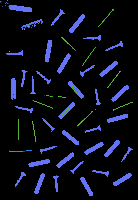

Without contours number:  2127


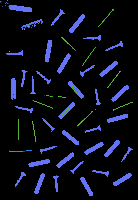

Without contours number:  2128


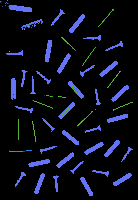

Without contours number:  2129


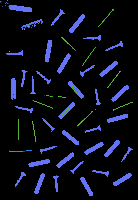

Without contours number:  2130


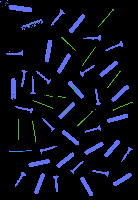

Without contours number:  2131


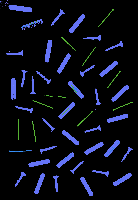

Without contours number:  2132


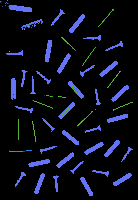

Without contours number:  2133


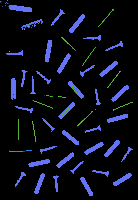

Without contours number:  2134


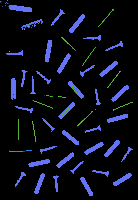

Without contours number:  2135


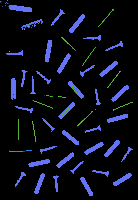

Without contours number:  2136


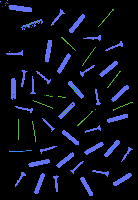

Without contours number:  2137


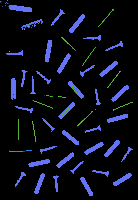

Without contours number:  2138


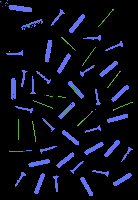

Without contours number:  2139


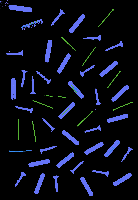

Without contours number:  2140


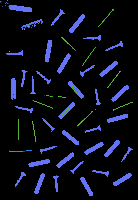

Without contours number:  2141


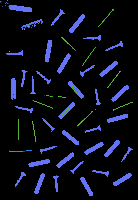

Without contours number:  2142


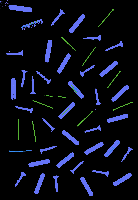

Without contours number:  2143


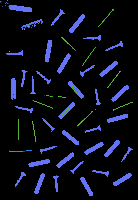

Without contours number:  2144


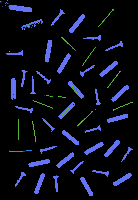

Without contours number:  2145


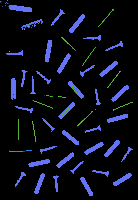

Without contours number:  2146


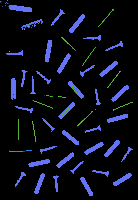

Without contours number:  2147


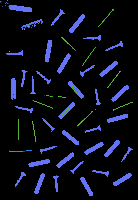

Without contours number:  2148


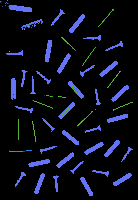

Without contours number:  2149


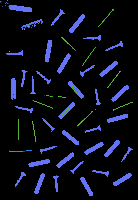

Without contours number:  2150


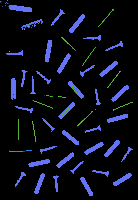

Without contours number:  2151


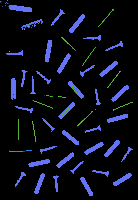

Without contours number:  2152


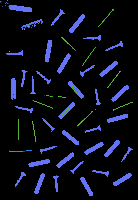

Without contours number:  2153


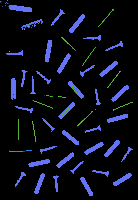

Without contours number:  2154


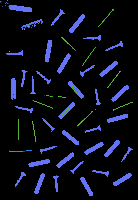

Without contours number:  2155


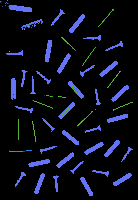

Without contours number:  2156


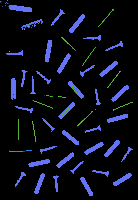

Without contours number:  2157


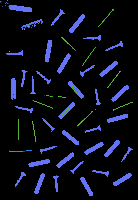

Without contours number:  2158


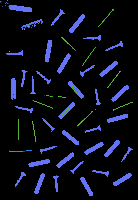

Without contours number:  2159


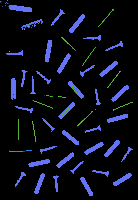

Without contours number:  2160


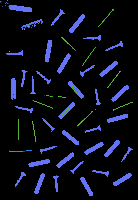

Without contours number:  2161


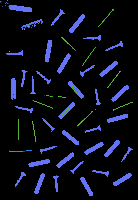

Without contours number:  2162


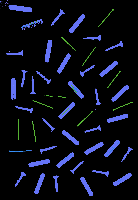

Without contours number:  2163


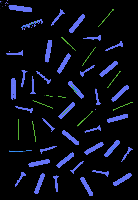

Without contours number:  2164


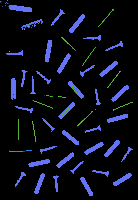

Without contours number:  2165


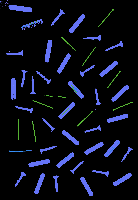

Without contours number:  2166


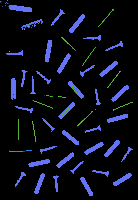

Without contours number:  2167


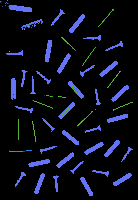

Without contours number:  2168


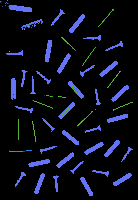

Without contours number:  2169


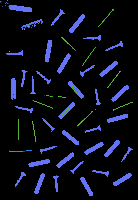

Without contours number:  2170


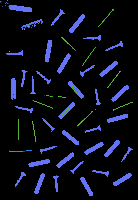

Without contours number:  2171


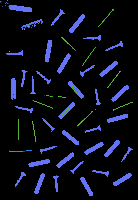

Without contours number:  2172


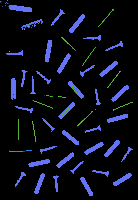

Without contours number:  2173


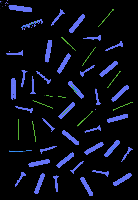

Without contours number:  2174


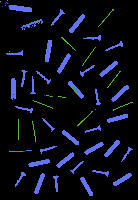

Without contours number:  2175


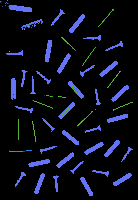

Without contours number:  2176


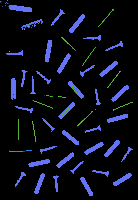

Without contours number:  2177


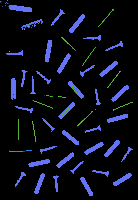

Without contours number:  2179


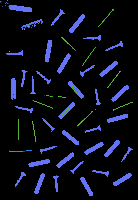

Without contours number:  2180


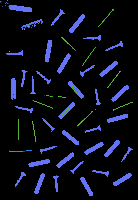

Without contours number:  2181


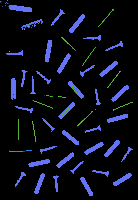

Without contours number:  2182


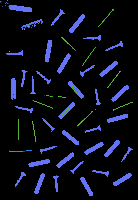

Without contours number:  2183


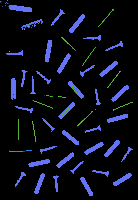

Without contours number:  2184


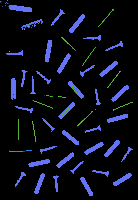

Without contours number:  2185


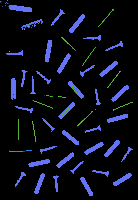

Without contours number:  2186


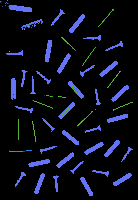

Without contours number:  2187


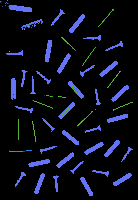

Without contours number:  2188


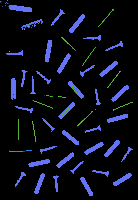

Without contours number:  2189


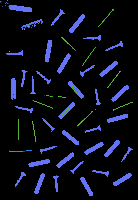

Without contours number:  2191


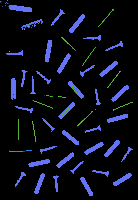

Without contours number:  2192


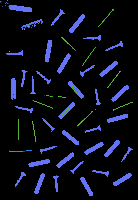

Without contours number:  2193


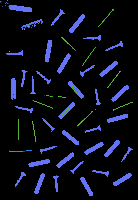

Without contours number:  2194


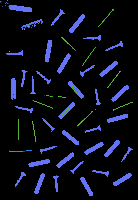

Without contours number:  2195


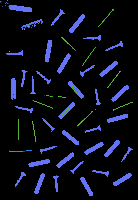

Without contours number:  2196


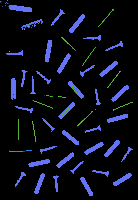

Without contours number:  2198


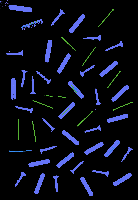

Without contours number:  2199


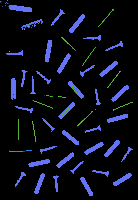

Without contours number:  2200


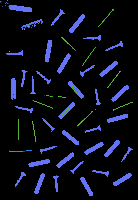

Without contours number:  2201


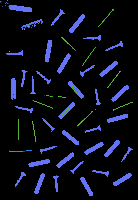

Without contours number:  2202


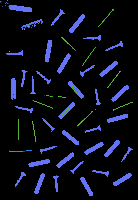

Without contours number:  2203


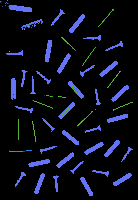

Without contours number:  2204


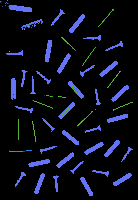

Without contours number:  2205


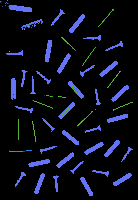

Without contours number:  2206


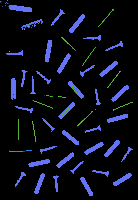

Without contours number:  2207


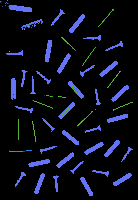

Without contours number:  2208


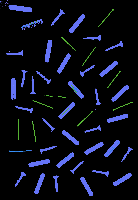

Without contours number:  2209


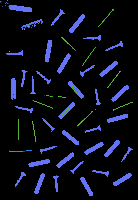

Without contours number:  2210


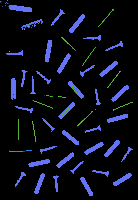

Without contours number:  2211


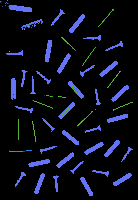

Without contours number:  2212


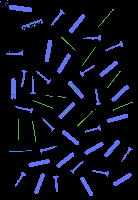

Without contours number:  2213


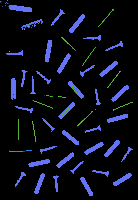

Without contours number:  2214


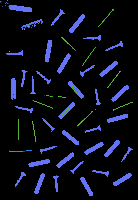

Without contours number:  2215


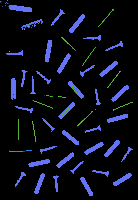

Without contours number:  2216


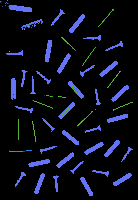

Without contours number:  2217


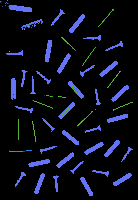

Without contours number:  2218


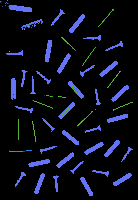

Without contours number:  2219


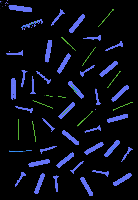

Without contours number:  2220


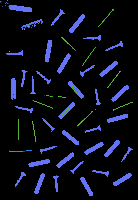

Without contours number:  2221


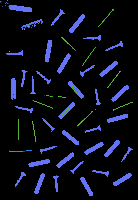

Without contours number:  2222


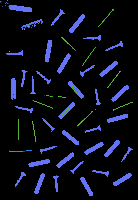

Without contours number:  2223


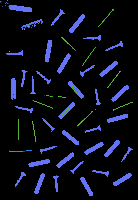

Without contours number:  2224


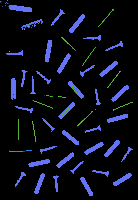

Without contours number:  2225


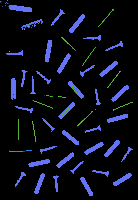

Without contours number:  2226


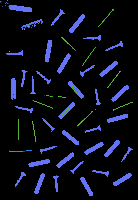

Without contours number:  2227


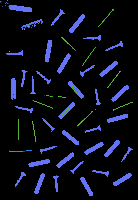

Without contours number:  2228


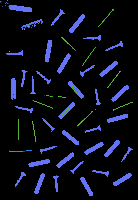

Without contours number:  2229


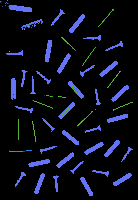

Without contours number:  2230


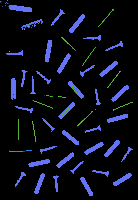

Without contours number:  2231


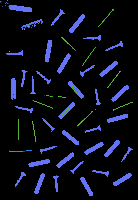

Without contours number:  2232


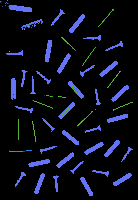

Without contours number:  2233


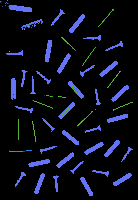

Without contours number:  2234


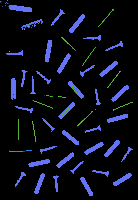

Without contours number:  2235


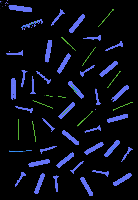

Without contours number:  2236


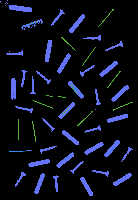

Without contours number:  2237


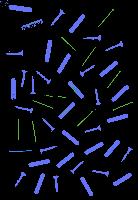

Without contours number:  2238


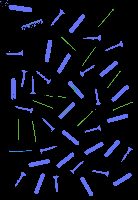

Without contours number:  2239


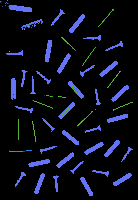

Without contours number:  2240


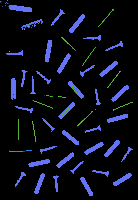

Without contours number:  2241


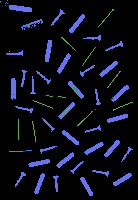

Without contours number:  2242


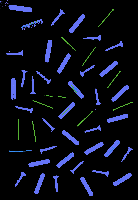

Without contours number:  2243


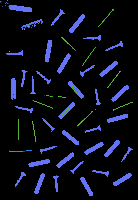

Without contours number:  2244


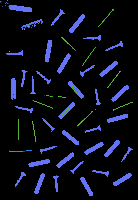

Without contours number:  2245


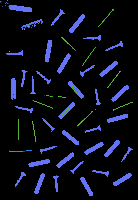

Without contours number:  2246


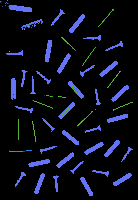

Without contours number:  2247


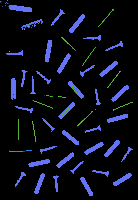

Without contours number:  2248


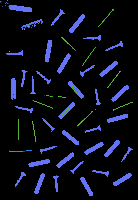

Without contours number:  2249


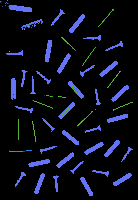

Without contours number:  2250


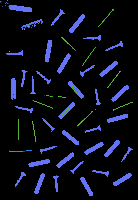

Without contours number:  2251


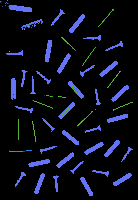

Without contours number:  2252


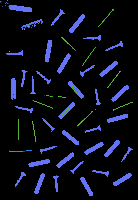

Without contours number:  2253


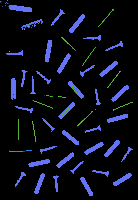

Without contours number:  2254


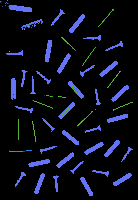

Without contours number:  2255


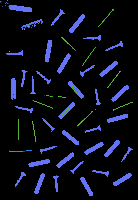

Without contours number:  2256


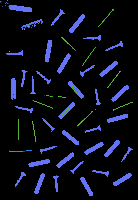

Without contours number:  2257


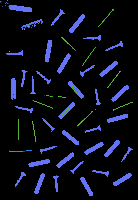

Without contours number:  2258


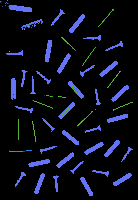

Without contours number:  2259


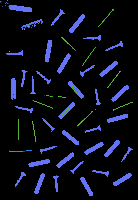

Without contours number:  2260


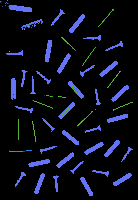

Without contours number:  2261


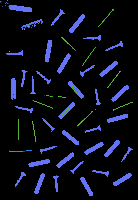

Without contours number:  2262


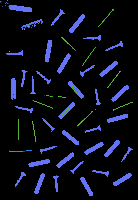

Without contours number:  2263


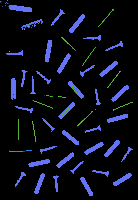

Without contours number:  2264


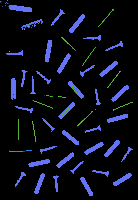

Without contours number:  2265


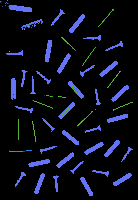

Without contours number:  2266


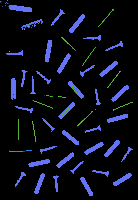

Without contours number:  2267


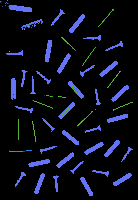

Without contours number:  2268


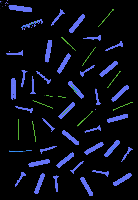

Without contours number:  2269


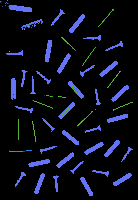

Without contours number:  2270


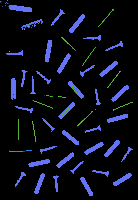

Without contours number:  2271


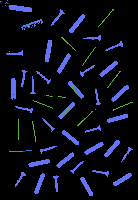

Without contours number:  2272


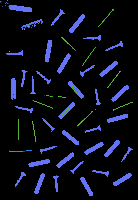

Without contours number:  2273


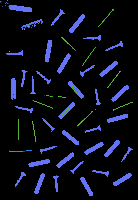

Without contours number:  2274


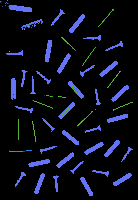

Without contours number:  2275


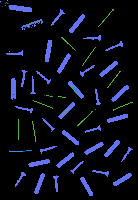

Without contours number:  2276


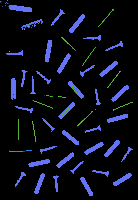

Without contours number:  2277


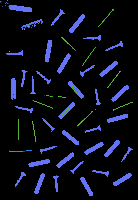

Without contours number:  2278


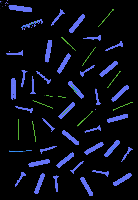

Without contours number:  2279


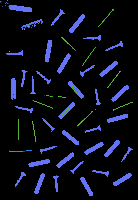

Without contours number:  2280


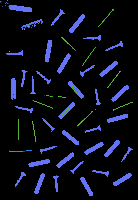

Without contours number:  2281


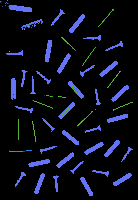

Without contours number:  2282


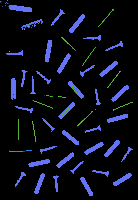

Without contours number:  2283


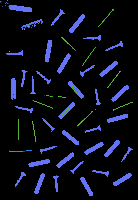

Without contours number:  2284


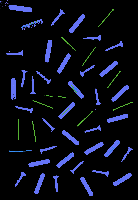

Without contours number:  2285


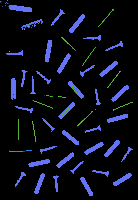

Without contours number:  2286


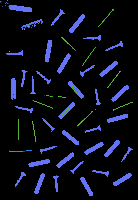

Without contours number:  2287


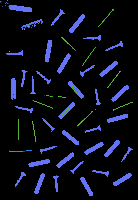

Without contours number:  2288


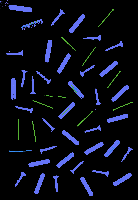

Without contours number:  2289


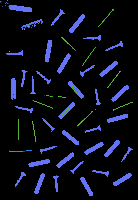

Without contours number:  2290


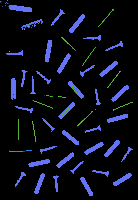

Without contours number:  2291


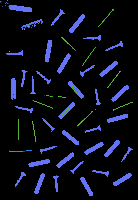

Without contours number:  2292


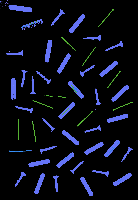

Without contours number:  2293


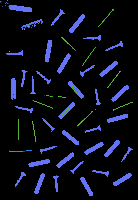

Without contours number:  2294


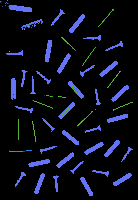

Without contours number:  2295


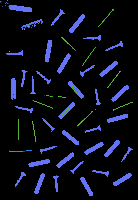

Without contours number:  2296


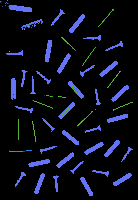

Without contours number:  2297


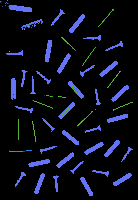

Without contours number:  2298


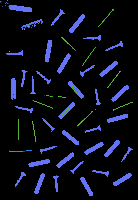

Without contours number:  2299


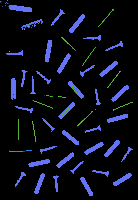

Without contours number:  2300


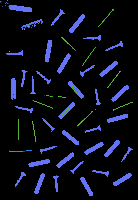

Without contours number:  2301


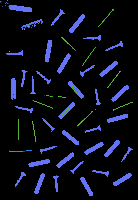

Without contours number:  2302


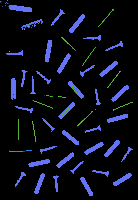

Without contours number:  2303


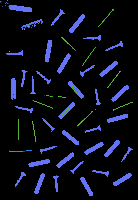

Without contours number:  2304


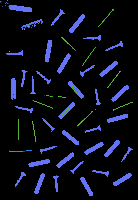

Without contours number:  2305


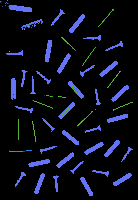

Without contours number:  2306


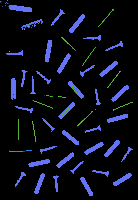

Without contours number:  2307


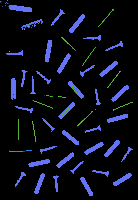

Without contours number:  2308


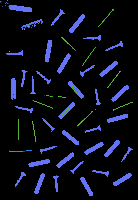

Without contours number:  2309


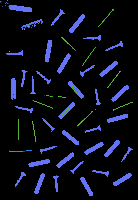

Without contours number:  2310


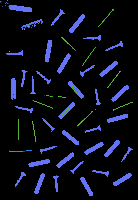

Without contours number:  2311


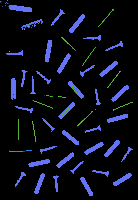

Without contours number:  2312


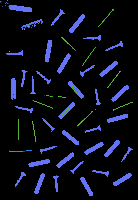

Without contours number:  2313


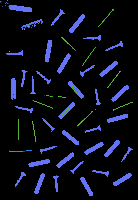

Without contours number:  2314


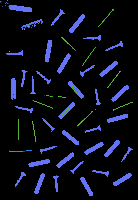

Without contours number:  2315


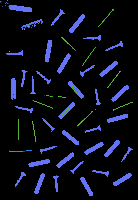

Without contours number:  2316


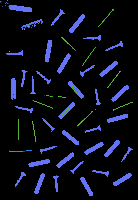

Without contours number:  2317


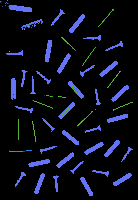

Without contours number:  2318


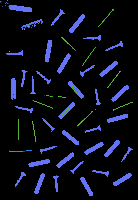

Without contours number:  2319


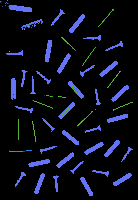

Without contours number:  2320


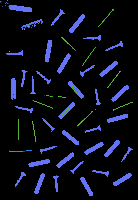

Without contours number:  2321


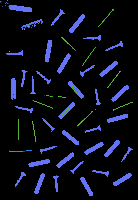

Without contours number:  2322


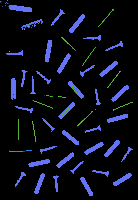

Without contours number:  2323


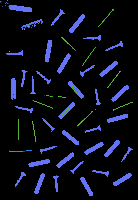

Without contours number:  2324


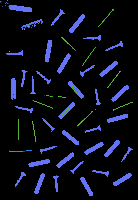

Without contours number:  2325


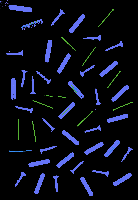

Without contours number:  2326


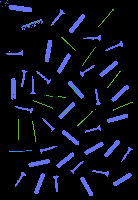

Without contours number:  2327


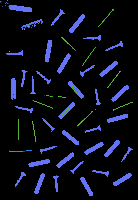

Without contours number:  2328


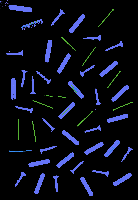

Without contours number:  2329


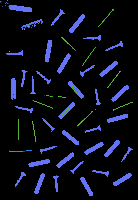

Without contours number:  2330


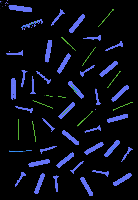

Without contours number:  2331


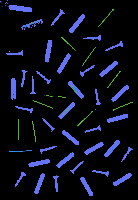

Without contours number:  2332


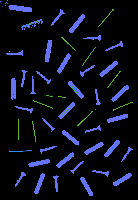

Without contours number:  2333


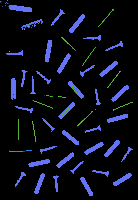

Without contours number:  2334


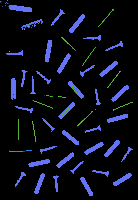

Without contours number:  2336


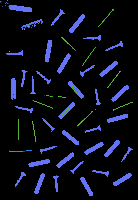

Without contours number:  2337


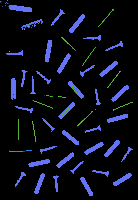

Without contours number:  2338


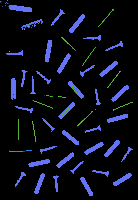

Without contours number:  2339


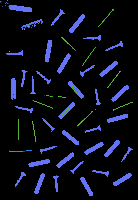

Without contours number:  2340


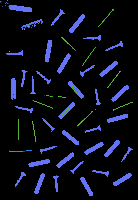

Without contours number:  2341


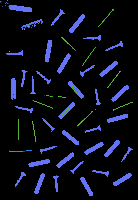

Without contours number:  2342


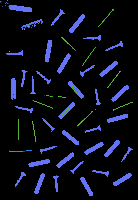

Without contours number:  2343


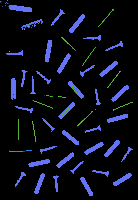

Without contours number:  2344


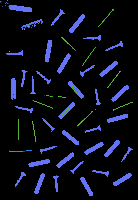

Without contours number:  2345


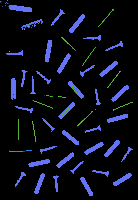

Without contours number:  2346


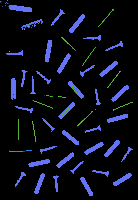

Without contours number:  2347


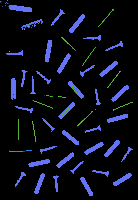

Without contours number:  2348


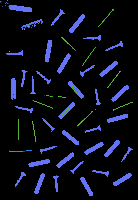

Without contours number:  2349


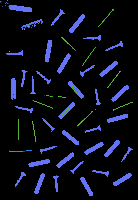

Without contours number:  2350


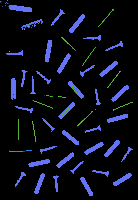

Without contours number:  2351


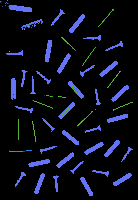

Without contours number:  2352


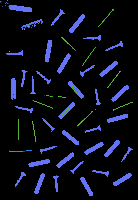

Without contours number:  2353


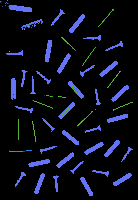

Without contours number:  2354


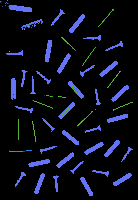

Without contours number:  2355


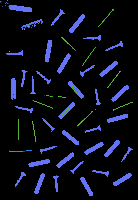

Without contours number:  2356


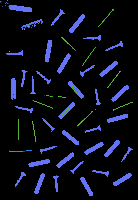

Without contours number:  2357


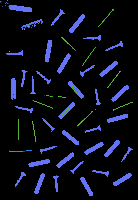

Without contours number:  2358


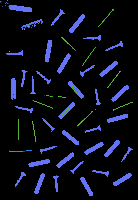

Without contours number:  2359


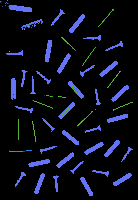

Without contours number:  2360


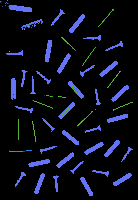

Without contours number:  2361


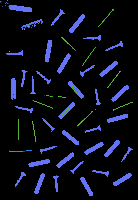

Without contours number:  2362


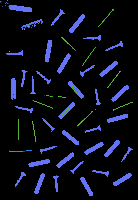

Without contours number:  2363


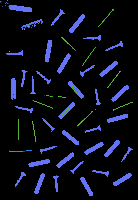

Without contours number:  2364


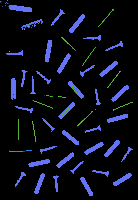

Without contours number:  2365


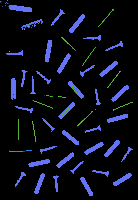

Without contours number:  2366


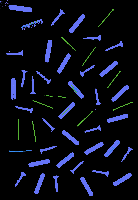

Without contours number:  2367


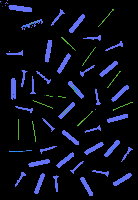

Without contours number:  2368


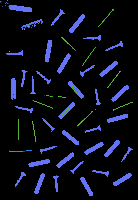

Without contours number:  2369


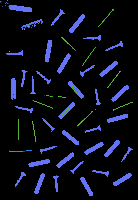

Without contours number:  2370


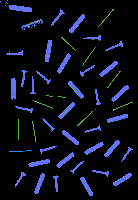

Without contours number:  2371


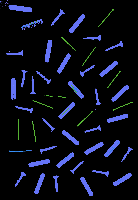

Without contours number:  2372


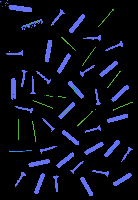

Without contours number:  2373


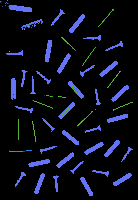

Without contours number:  2374


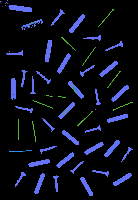

Without contours number:  2375


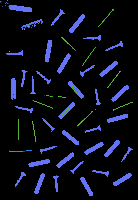

Without contours number:  2376


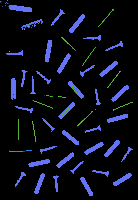

Without contours number:  2377


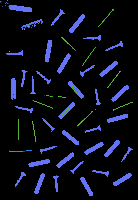

Without contours number:  2378


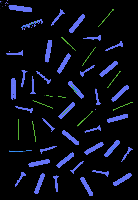

Without contours number:  2379


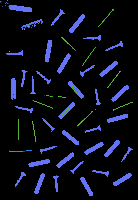

Without contours number:  2380


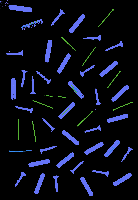

Without contours number:  2381


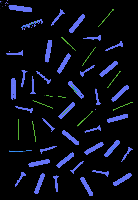

Without contours number:  2382


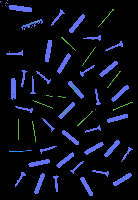

Without contours number:  2383


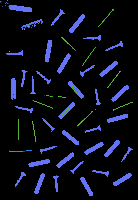

Without contours number:  2384


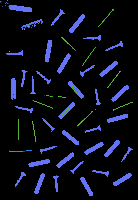

Without contours number:  2385


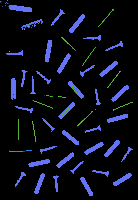

Without contours number:  2386


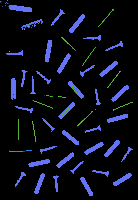

Without contours number:  2387


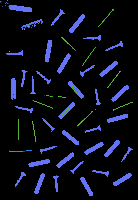

Without contours number:  2389


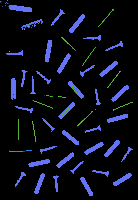

Without contours number:  2390


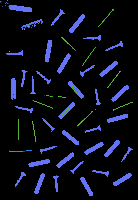

Without contours number:  2391


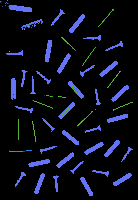

Without contours number:  2392


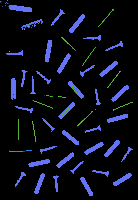

Without contours number:  2393


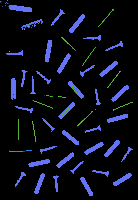

Without contours number:  2394


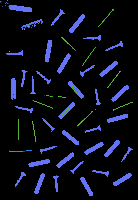

Without contours number:  2395


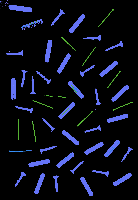

Without contours number:  2396


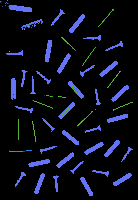

Without contours number:  2397


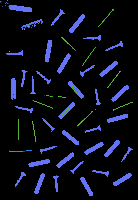

Without contours number:  2398


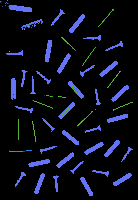

Without contours number:  2399


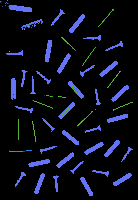

Without contours number:  2400


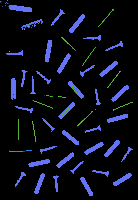

Without contours number:  2402


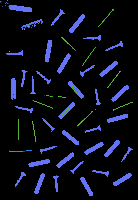

Without contours number:  2403


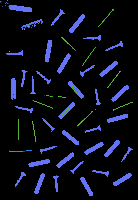

Without contours number:  2404


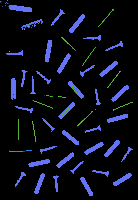

Without contours number:  2405


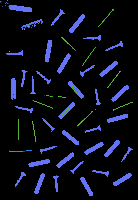

Without contours number:  2406


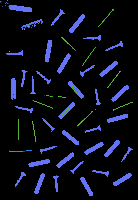

Without contours number:  2407


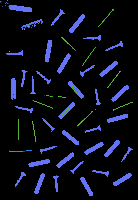

Without contours number:  2408


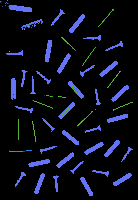

Without contours number:  2409


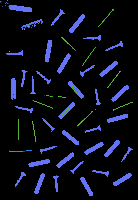

Without contours number:  2410


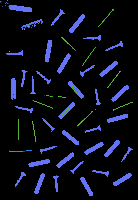

Without contours number:  2411


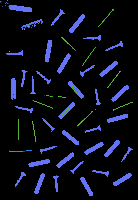

Without contours number:  2413


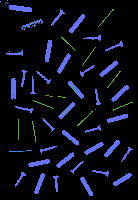

Without contours number:  2414


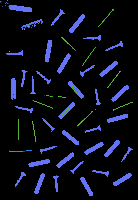

Without contours number:  2415


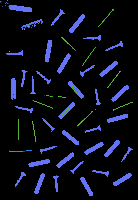

Without contours number:  2416


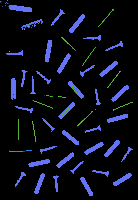

Without contours number:  2417


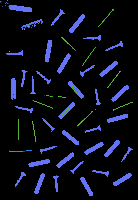

Without contours number:  2418


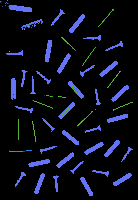

Without contours number:  2419


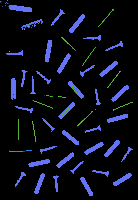

Without contours number:  2420


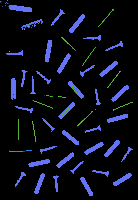

Without contours number:  2421


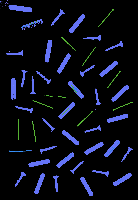

Without contours number:  2422


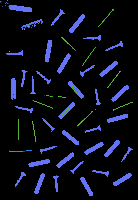

Without contours number:  2423


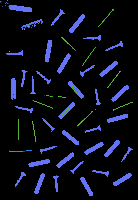

Without contours number:  2424


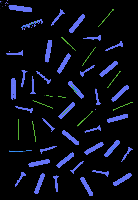

Without contours number:  2425


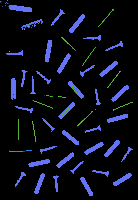

Without contours number:  2426


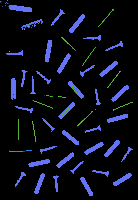

Without contours number:  2427


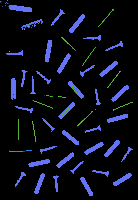

Without contours number:  2428


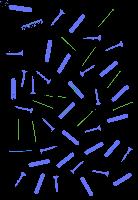

Without contours number:  2429


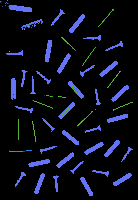

Without contours number:  2430


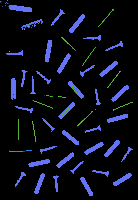

Without contours number:  2431


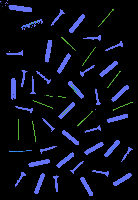

Without contours number:  2432


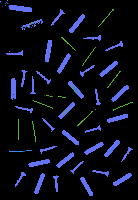

Without contours number:  2433


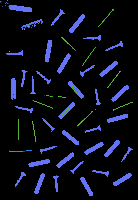

Without contours number:  2434


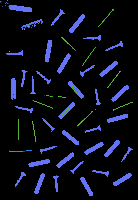

Without contours number:  2435


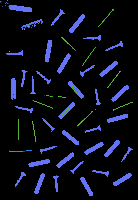

Without contours number:  2436


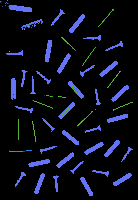

Without contours number:  2437


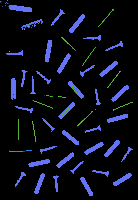

Without contours number:  2438


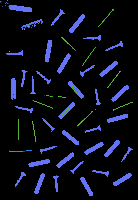

Without contours number:  2439


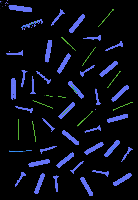

Without contours number:  2440


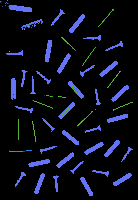

Without contours number:  2441


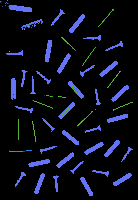

Without contours number:  2442


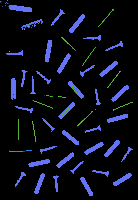

Without contours number:  2443


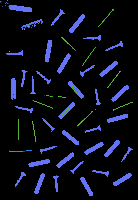

Without contours number:  2444


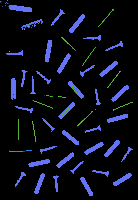

Without contours number:  2445


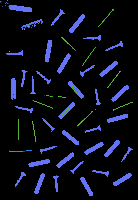

Without contours number:  2446


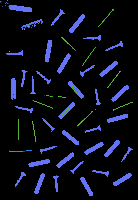

Without contours number:  2447


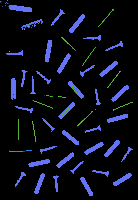

Without contours number:  2448


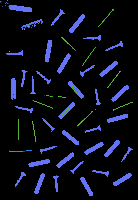

Without contours number:  2449


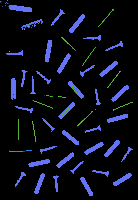

Without contours number:  2450


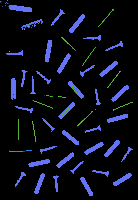

Without contours number:  2451


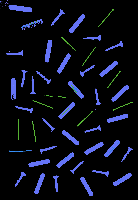

Without contours number:  2452


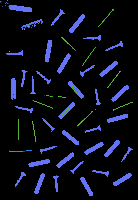

Without contours number:  2453


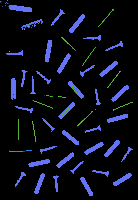

Without contours number:  2454


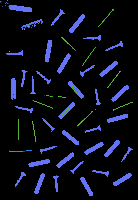

Without contours number:  2455


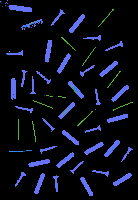

Without contours number:  2456


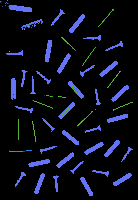

Without contours number:  2457


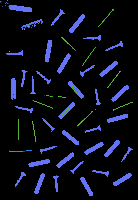

Without contours number:  2458


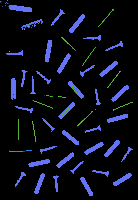

Without contours number:  2459


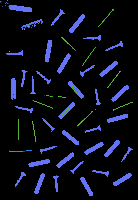

Without contours number:  2460


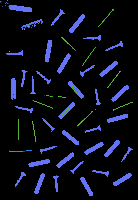

Without contours number:  2461


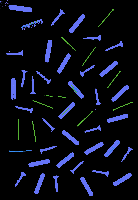

Without contours number:  2462


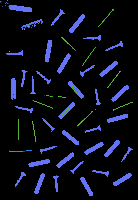

Without contours number:  2463


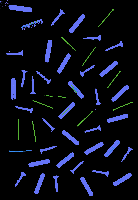

Without contours number:  2464


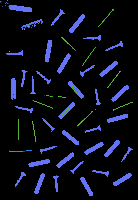

Without contours number:  2465


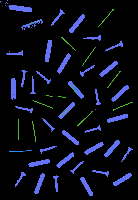

Without contours number:  2466


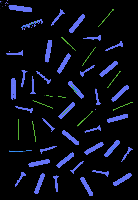

Without contours number:  2467


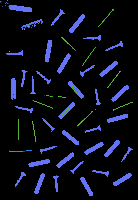

Without contours number:  2468


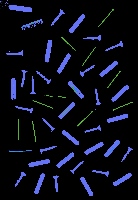

Without contours number:  2469


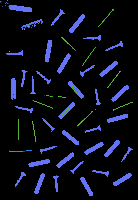

Without contours number:  2470


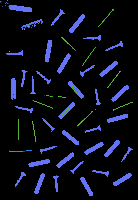

Without contours number:  2471


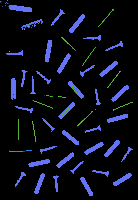

Without contours number:  2472


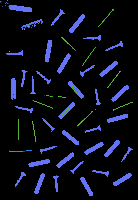

Without contours number:  2473


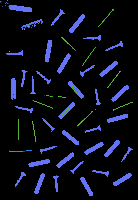

Without contours number:  2474


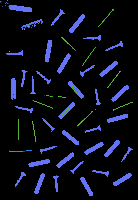

Without contours number:  2476


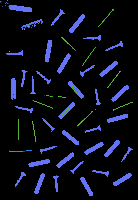

Without contours number:  2477


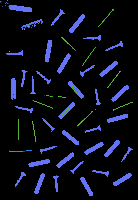

Without contours number:  2478


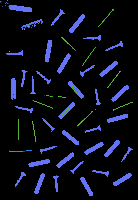

Without contours number:  2479


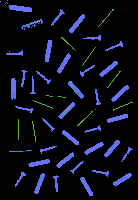

Without contours number:  2480


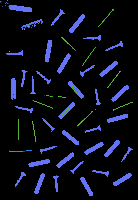

Without contours number:  2481


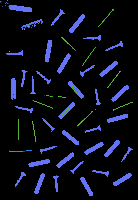

Without contours number:  2482


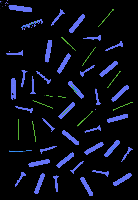

Without contours number:  2483


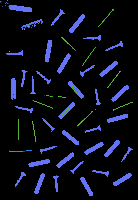

Without contours number:  2484


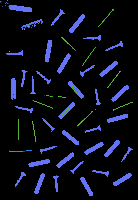

Without contours number:  2485


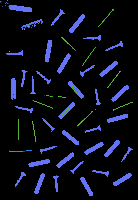

Without contours number:  2486


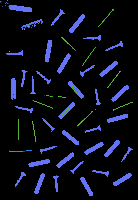

Without contours number:  2487


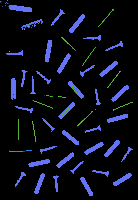

Without contours number:  2488


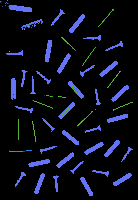

Without contours number:  2489


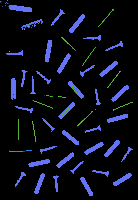

Without contours number:  2490


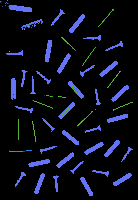

Without contours number:  2491


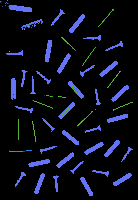

Without contours number:  2492


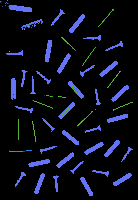

Without contours number:  2493


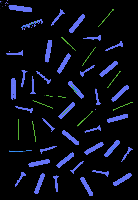

Without contours number:  2494


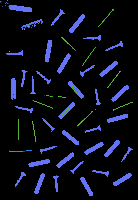

Without contours number:  2495


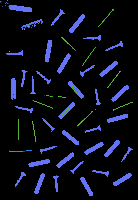

Without contours number:  2496


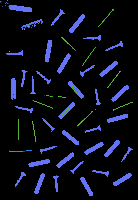

Without contours number:  2497


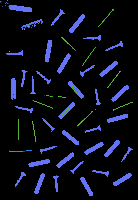

Without contours number:  2498


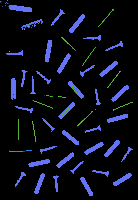

Without contours number:  2499


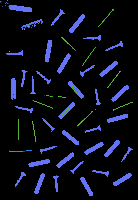

Without contours number:  2500


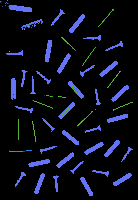

Without contours number:  2501


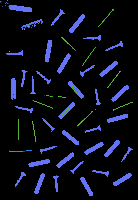

Without contours number:  2502


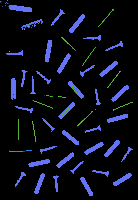

Without contours number:  2503


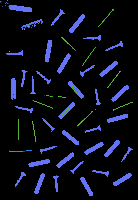

Without contours number:  2504


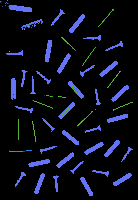

Without contours number:  2505


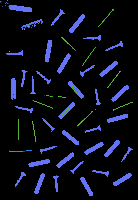

Without contours number:  2506


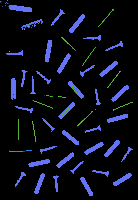

Without contours number:  2507


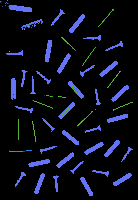

Without contours number:  2508


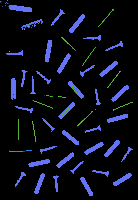

Without contours number:  2509


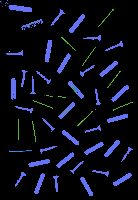

Without contours number:  2510


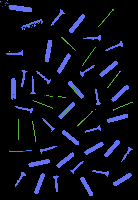

Without contours number:  2511


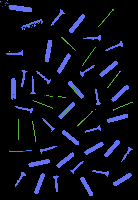

Without contours number:  2512


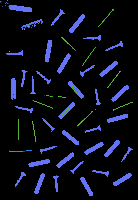

Without contours number:  2513


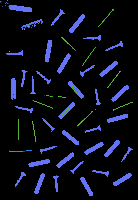

Without contours number:  2514


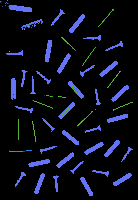

Without contours number:  2515


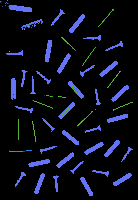

Without contours number:  2516


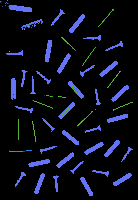

Without contours number:  2517


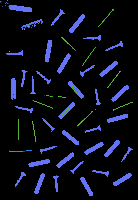

Without contours number:  2518


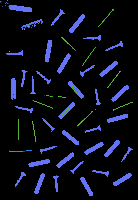

Without contours number:  2519


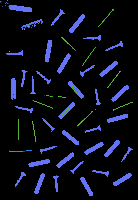

Without contours number:  2520


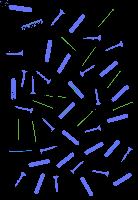

Without contours number:  2521


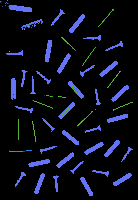

Without contours number:  2522


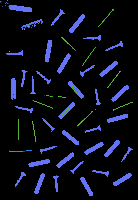

Without contours number:  2523


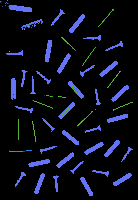

Without contours number:  2524


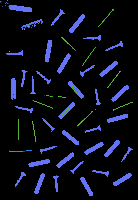

Without contours number:  2525


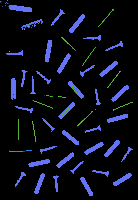

Without contours number:  2526


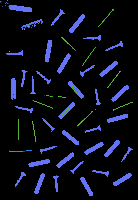

Without contours number:  2527


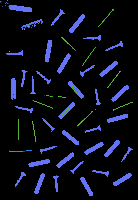

Without contours number:  2528


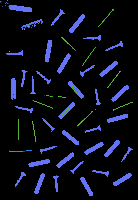

Without contours number:  2529


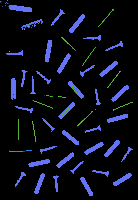

Without contours number:  2530


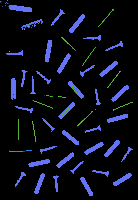

Without contours number:  2531


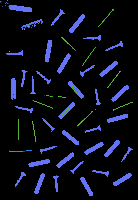

Without contours number:  2532


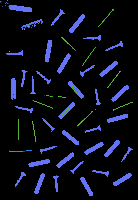

Without contours number:  2533


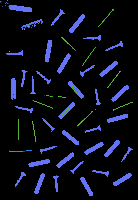

Without contours number:  2534


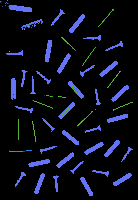

Without contours number:  2535


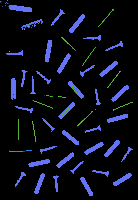

Without contours number:  2536


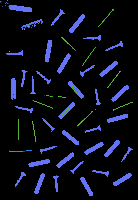

Without contours number:  2537


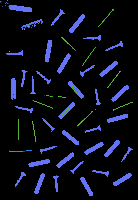

Without contours number:  2538


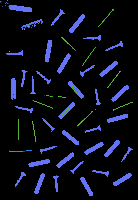

Without contours number:  2539


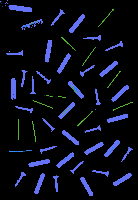

Without contours number:  2540


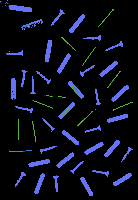

Without contours number:  2541


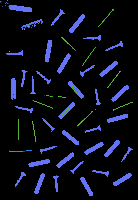

Without contours number:  2543


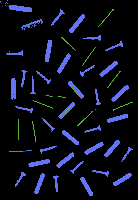

Without contours number:  2544


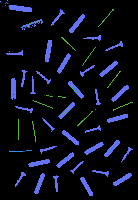

Without contours number:  2545


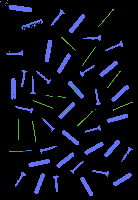

Without contours number:  2546


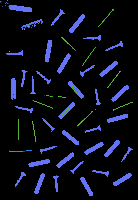

Without contours number:  2547


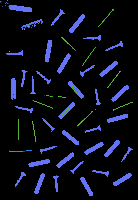

Without contours number:  2548


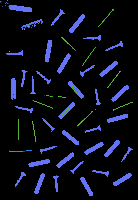

Without contours number:  2549


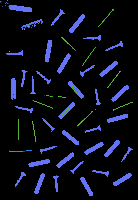

Without contours number:  2551


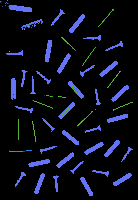

Without contours number:  2552


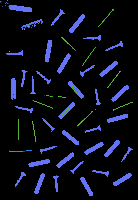

Without contours number:  2553


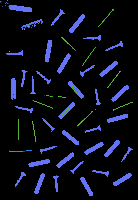

Without contours number:  2554


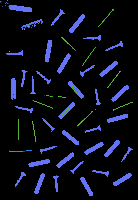

Without contours number:  2555


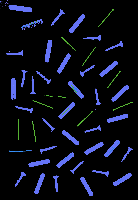

Without contours number:  2556


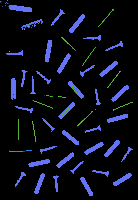

Without contours number:  2557


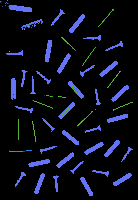

Without contours number:  2558


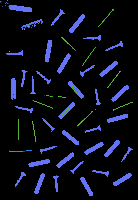

Without contours number:  2559


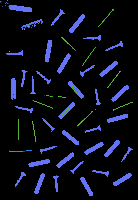

Without contours number:  2560


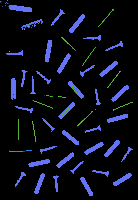

Without contours number:  2561


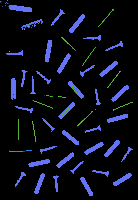

Without contours number:  2562


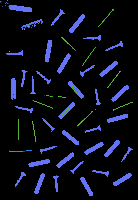

Without contours number:  2563


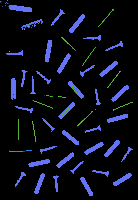

Without contours number:  2564


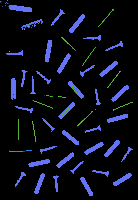

Without contours number:  2565


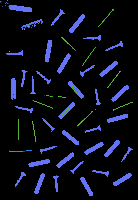

Without contours number:  2566


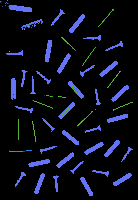

Without contours number:  2567


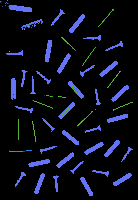

Without contours number:  2568


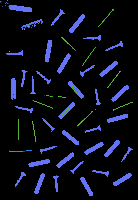

Without contours number:  2569


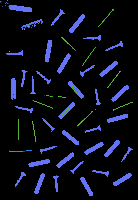

Without contours number:  2571


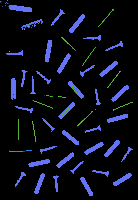

Without contours number:  2572


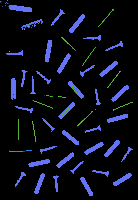

Without contours number:  2574


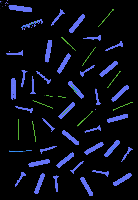

Without contours number:  2575


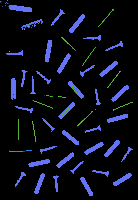

Without contours number:  2576


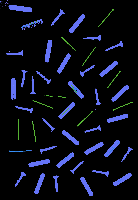

Without contours number:  2577


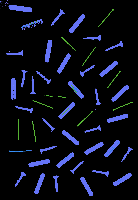

Without contours number:  2578


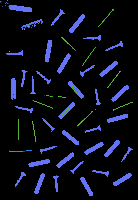

Without contours number:  2579


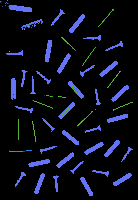

Without contours number:  2580


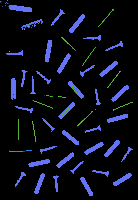

Without contours number:  2581


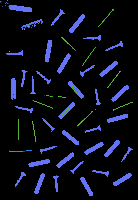

Without contours number:  2582


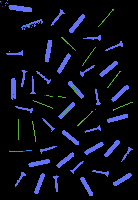

Without contours number:  2583


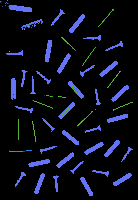

Without contours number:  2584


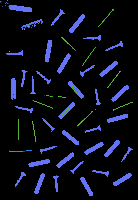

Without contours number:  2585


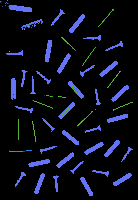

Without contours number:  2586


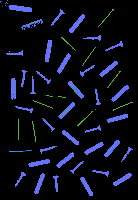

Without contours number:  2587


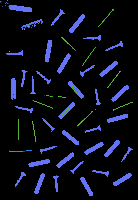

Without contours number:  2588


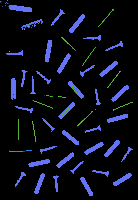

Without contours number:  2589


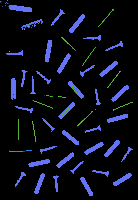

Without contours number:  2590


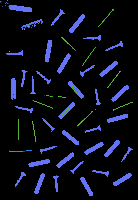

Without contours number:  2591


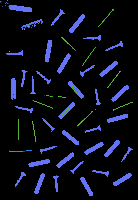

Without contours number:  2592


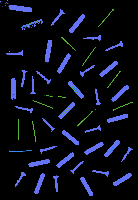

Without contours number:  2593


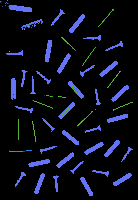

Without contours number:  2594


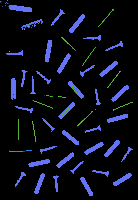

Without contours number:  2595


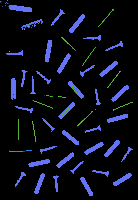

Without contours number:  2596


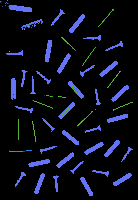

Without contours number:  2597


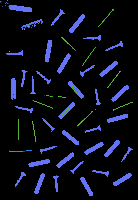

Without contours number:  2598


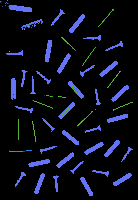

Without contours number:  2599


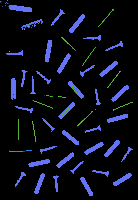

Without contours number:  2600


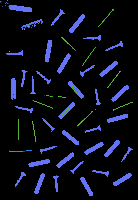

Without contours number:  2601


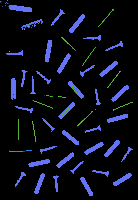

Without contours number:  2602


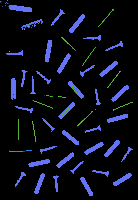

Without contours number:  2604


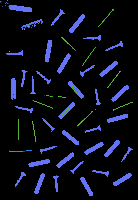

Without contours number:  2605


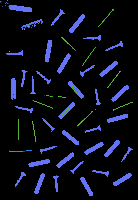

Without contours number:  2606


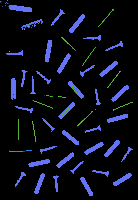

Without contours number:  2607


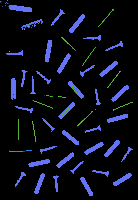

Without contours number:  2608


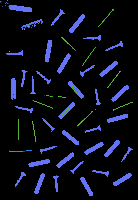

Without contours number:  2609


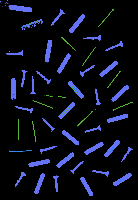

Without contours number:  2610


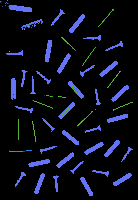

Without contours number:  2611


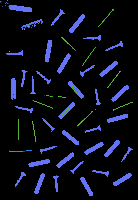

Without contours number:  2612


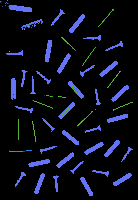

Without contours number:  2613


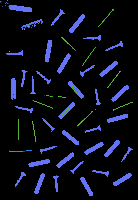

Without contours number:  2614


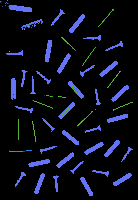

Without contours number:  2615


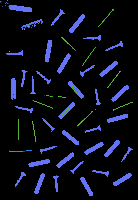

Without contours number:  2617


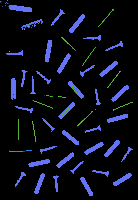

Without contours number:  2618


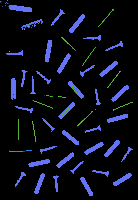

Without contours number:  2619


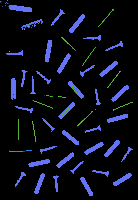

Without contours number:  2620


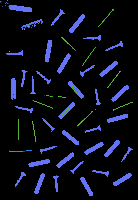

Without contours number:  2621


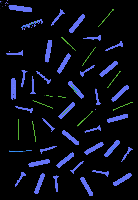

Without contours number:  2622


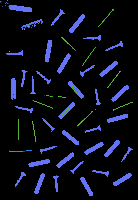

Without contours number:  2623


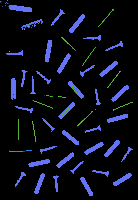

Without contours number:  2624


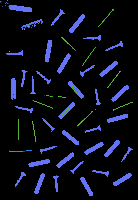

Without contours number:  2625


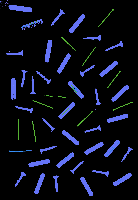

Without contours number:  2626


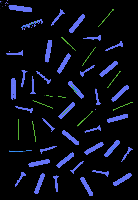

Without contours number:  2627


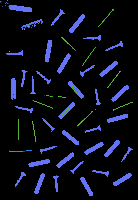

Without contours number:  2628


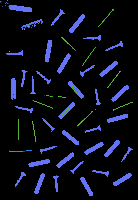

Without contours number:  2629


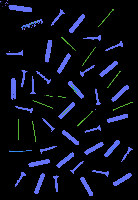

Without contours number:  2630


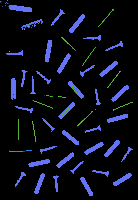

Without contours number:  2631


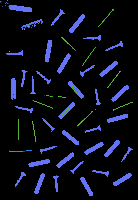

Without contours number:  2632


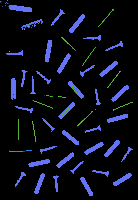

Without contours number:  2633


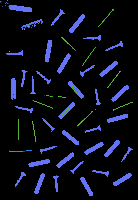

Without contours number:  2634


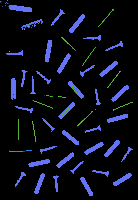

Without contours number:  2636


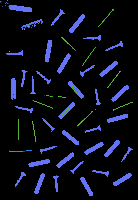

Without contours number:  2637


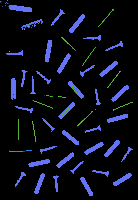

Without contours number:  2638


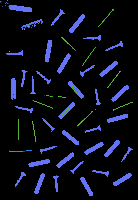

Without contours number:  2639


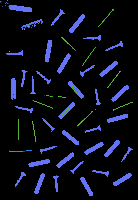

Without contours number:  2640


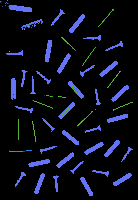

Without contours number:  2641


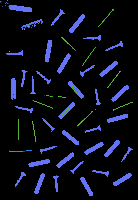

Without contours number:  2642


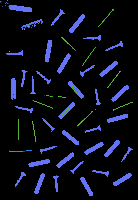

Without contours number:  2643


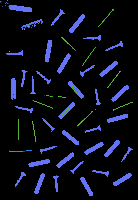

Without contours number:  2644


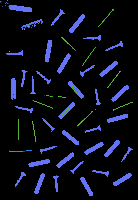

Without contours number:  2645


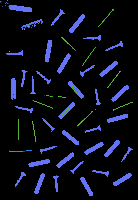

Without contours number:  2646


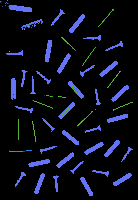

Without contours number:  2647


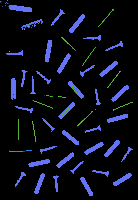

Without contours number:  2648


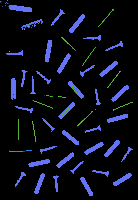

Without contours number:  2649


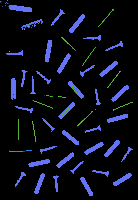

Without contours number:  2650


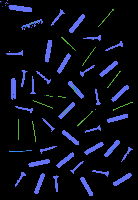

Without contours number:  2652


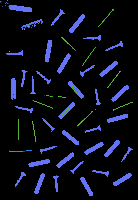

Without contours number:  2653


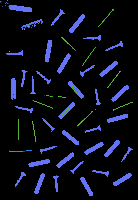

Without contours number:  2655


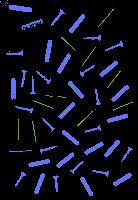

Without contours number:  2656


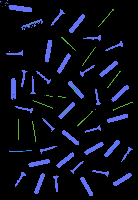

Without contours number:  2657


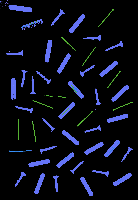

Without contours number:  2658


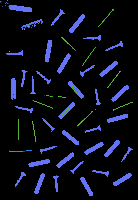

Without contours number:  2659


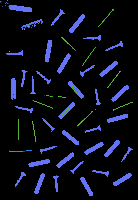

Without contours number:  2660


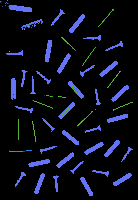

Without contours number:  2661


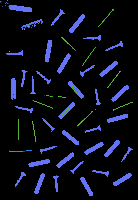

Without contours number:  2662


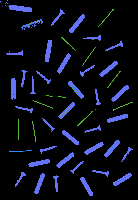

Without contours number:  2663


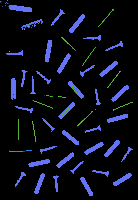

Without contours number:  2664


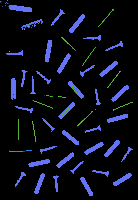

Without contours number:  2665


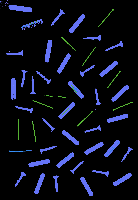

Without contours number:  2666


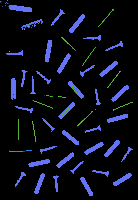

Without contours number:  2667


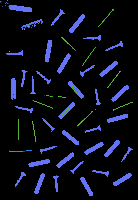

Without contours number:  2668


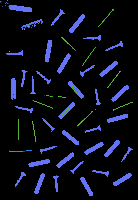

Without contours number:  2669


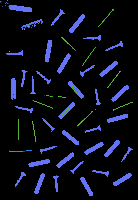

Without contours number:  2670


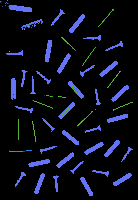

Without contours number:  2671


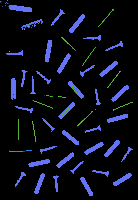

Without contours number:  2672


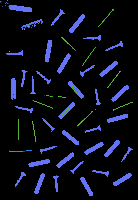

Without contours number:  2673


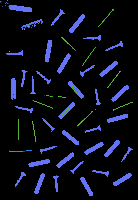

Without contours number:  2674


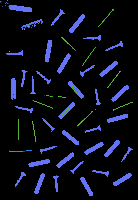

Without contours number:  2675


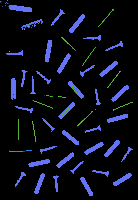

Without contours number:  2678


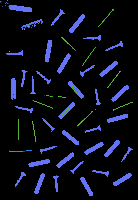

Without contours number:  2679


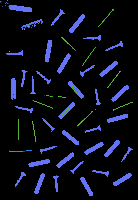

Without contours number:  2680


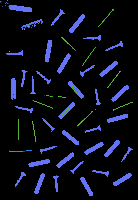

Without contours number:  2681


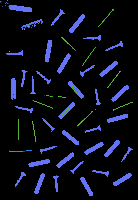

Without contours number:  2682


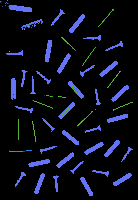

Without contours number:  2683


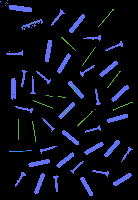

Without contours number:  2684


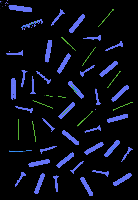

Without contours number:  2685


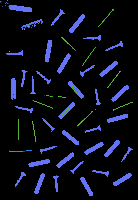

Without contours number:  2686


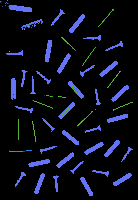

Without contours number:  2688


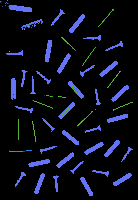

Without contours number:  2689


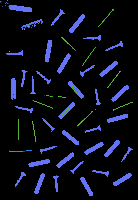

Without contours number:  2691


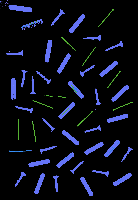

Without contours number:  2692


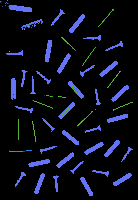

Without contours number:  2693


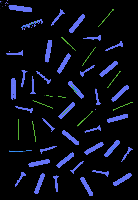

Without contours number:  2694


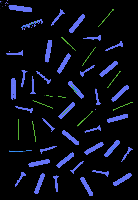

Without contours number:  2695


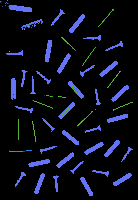

Without contours number:  2696


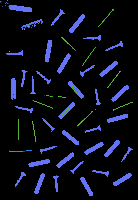

Without contours number:  2697


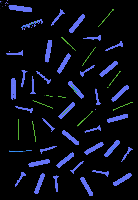

Without contours number:  2698


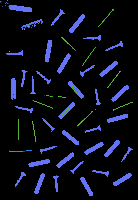

Without contours number:  2699


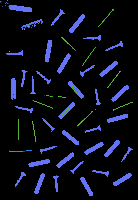

Without contours number:  2700


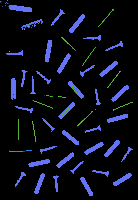

Without contours number:  2701


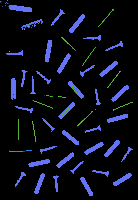

Without contours number:  2702


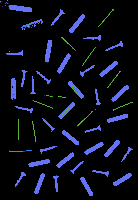

Without contours number:  2703


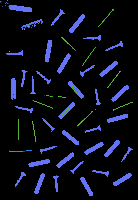

Without contours number:  2704


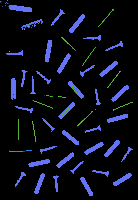

Without contours number:  2705


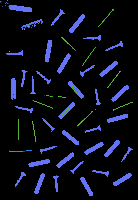

Without contours number:  2706


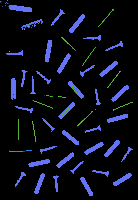

Without contours number:  2707


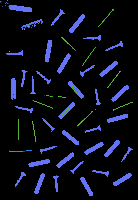

Without contours number:  2708


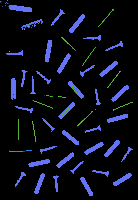

Without contours number:  2709


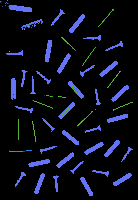

Without contours number:  2711


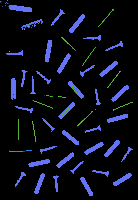

Without contours number:  2712


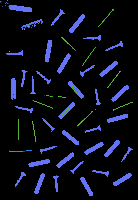

Without contours number:  2713


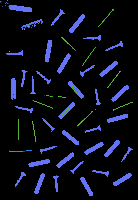

Without contours number:  2714


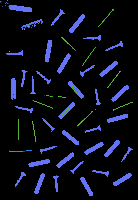

Without contours number:  2715


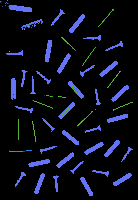

Without contours number:  2716


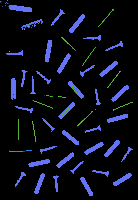

Without contours number:  2717


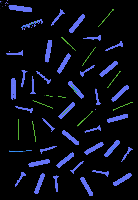

Without contours number:  2718


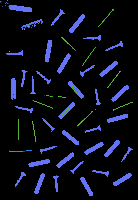

Without contours number:  2719


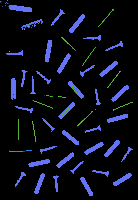

Without contours number:  2720


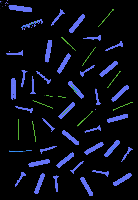

Without contours number:  2721


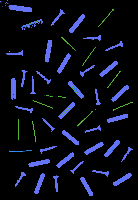

Without contours number:  2722


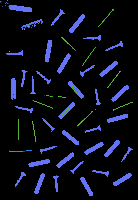

Without contours number:  2723


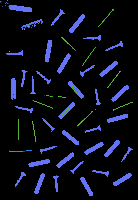

Without contours number:  2724


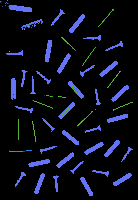

Without contours number:  2725


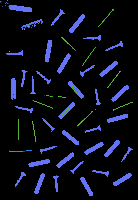

Without contours number:  2726


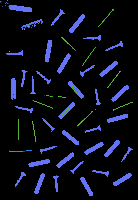

Without contours number:  2727


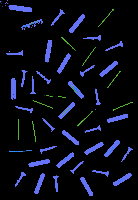

Without contours number:  2728


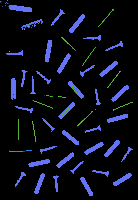

Without contours number:  2729


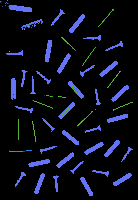

Without contours number:  2730


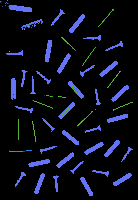

Without contours number:  2731


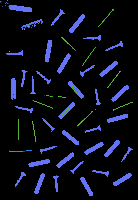

Without contours number:  2732


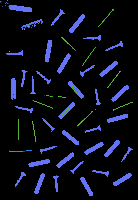

Without contours number:  2733


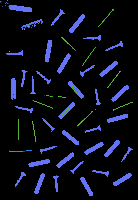

Without contours number:  2734


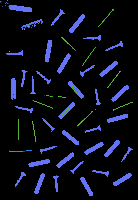

Without contours number:  2735


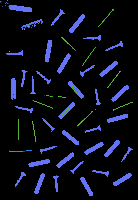

Without contours number:  2736


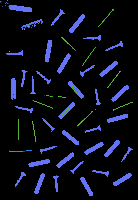

Without contours number:  2737


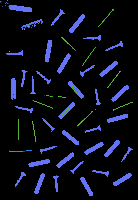

Without contours number:  2738


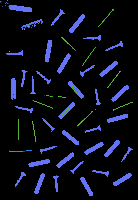

Without contours number:  2739


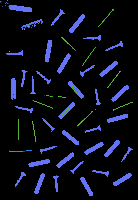

Without contours number:  2740


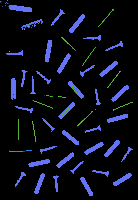

Without contours number:  2741


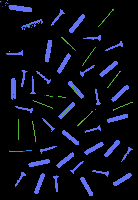

Without contours number:  2742


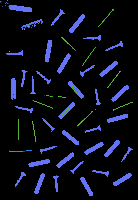

Without contours number:  2744


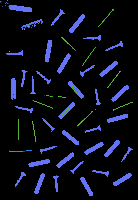

Without contours number:  2745


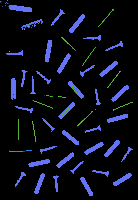

Without contours number:  2746


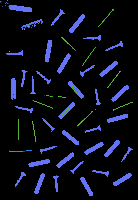

Without contours number:  2747


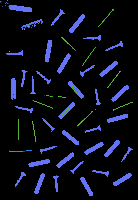

Without contours number:  2748


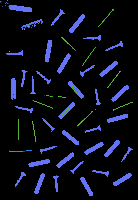

Without contours number:  2749


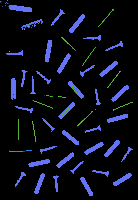

Without contours number:  2750


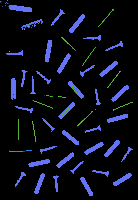

Without contours number:  2751


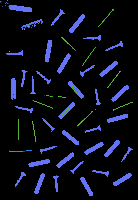

Without contours number:  2752


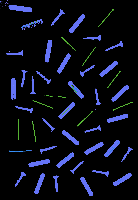

Without contours number:  2753


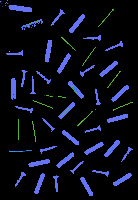

Without contours number:  2754


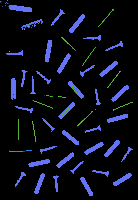

Without contours number:  2755


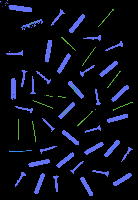

Without contours number:  2756


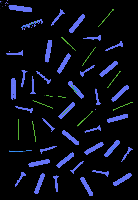

Without contours number:  2757


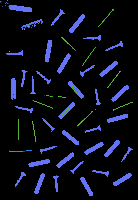

Without contours number:  2758


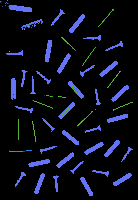

Without contours number:  2759


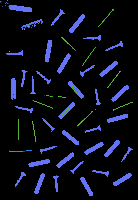

Without contours number:  2760


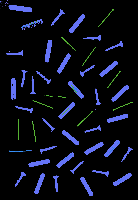

Without contours number:  2761


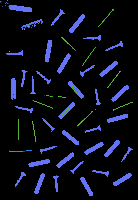

Without contours number:  2762


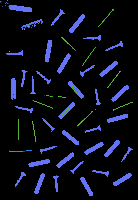

Without contours number:  2763


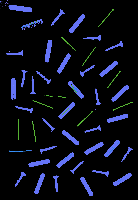

Without contours number:  2764


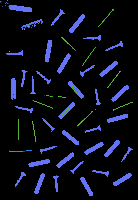

Without contours number:  2765


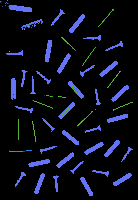

Without contours number:  2766


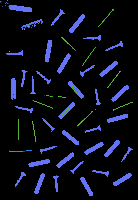

Without contours number:  2767


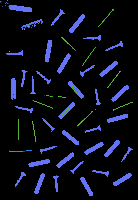

Without contours number:  2768


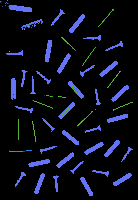

Without contours number:  2769


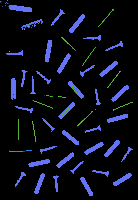

Without contours number:  2770


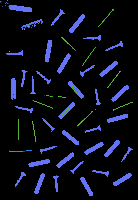

Without contours number:  2771


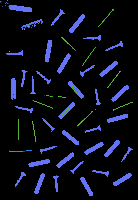

Without contours number:  2772


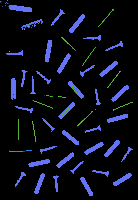

Without contours number:  2773


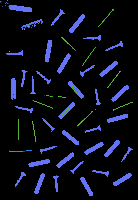

Without contours number:  2774


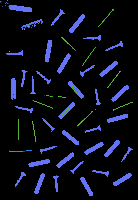

Without contours number:  2775


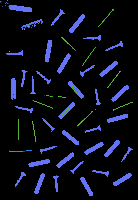

Without contours number:  2776


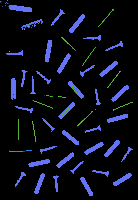

Without contours number:  2777


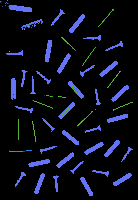

Without contours number:  2778


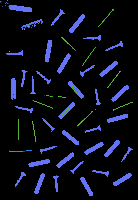

Without contours number:  2779


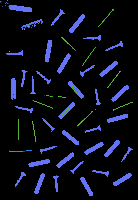

Without contours number:  2780


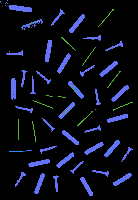

Without contours number:  2781


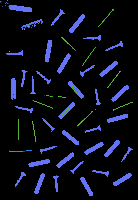

Without contours number:  2782


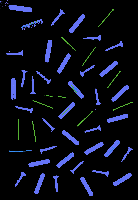

Without contours number:  2783


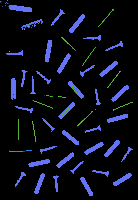

Without contours number:  2784


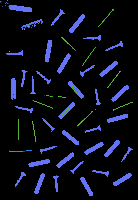

Without contours number:  2785


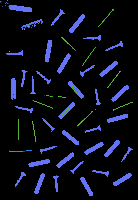

Without contours number:  2786


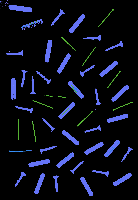

Without contours number:  2787


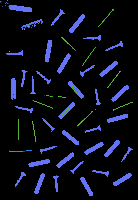

Without contours number:  2788


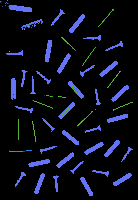

Without contours number:  2789


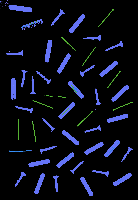

Without contours number:  2790


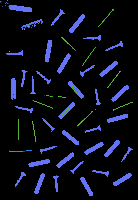

Without contours number:  2791


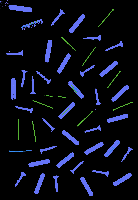

Without contours number:  2792


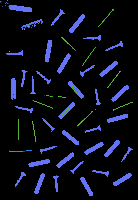

Without contours number:  2793


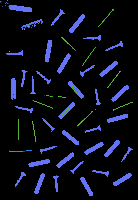

Without contours number:  2794


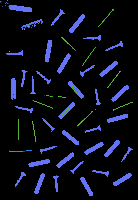

Without contours number:  2795


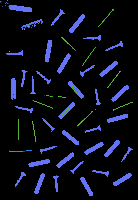

Without contours number:  2796


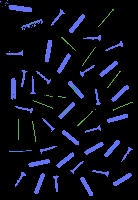

Without contours number:  2797


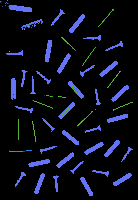

Without contours number:  2798


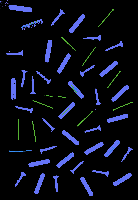

Without contours number:  2799


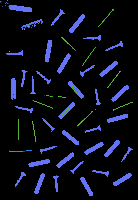

Without contours number:  2800


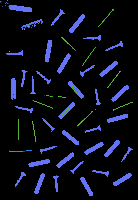

Without contours number:  2801


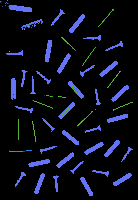

Without contours number:  2802


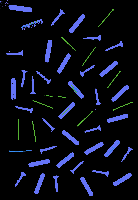

Without contours number:  2803


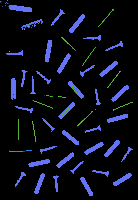

Without contours number:  2804


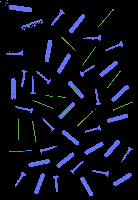

Without contours number:  2805


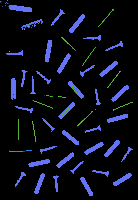

Without contours number:  2806


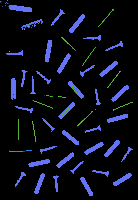

Without contours number:  2807


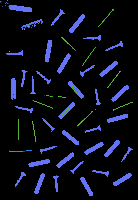

Without contours number:  2808


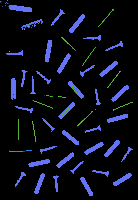

Without contours number:  2809


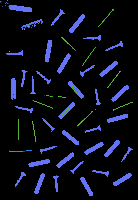

Without contours number:  2810


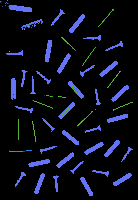

Without contours number:  2811


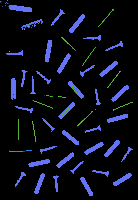

Without contours number:  2812


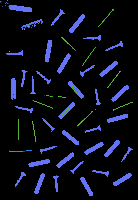

Without contours number:  2813


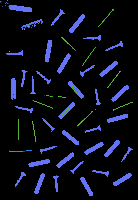

Without contours number:  2814


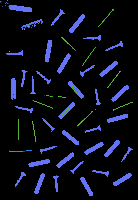

Without contours number:  2815


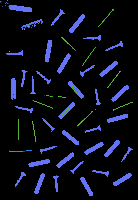

Without contours number:  2816


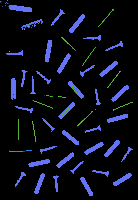

Without contours number:  2817


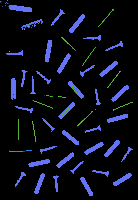

Without contours number:  2818


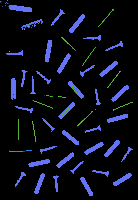

Without contours number:  2819


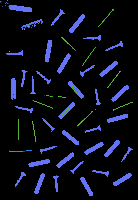

Without contours number:  2820


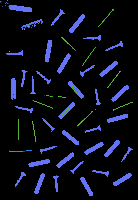

Without contours number:  2821


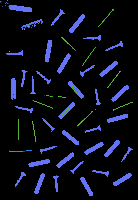

Without contours number:  2822


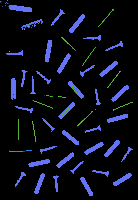

Without contours number:  2824


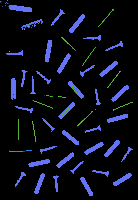

Without contours number:  2825


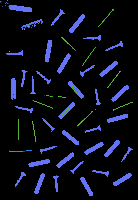

Without contours number:  2826


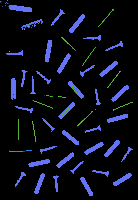

Without contours number:  2827


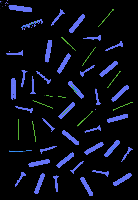

Without contours number:  2828


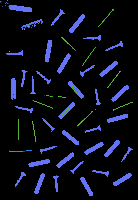

Without contours number:  2829


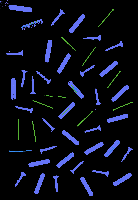

Without contours number:  2830


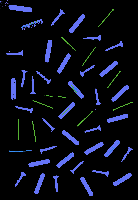

Without contours number:  2831


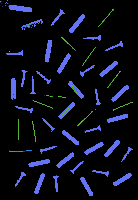

Without contours number:  2832


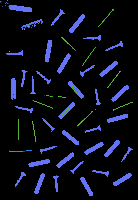

Without contours number:  2833


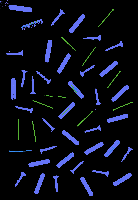

Without contours number:  2834


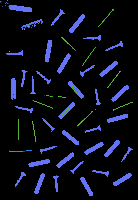

Without contours number:  2835


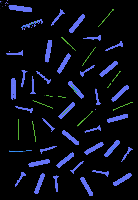

Without contours number:  2836


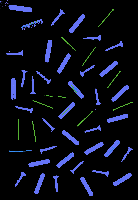

Without contours number:  2837


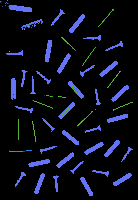

Without contours number:  2838


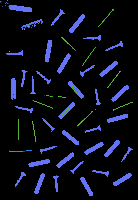

Without contours number:  2839


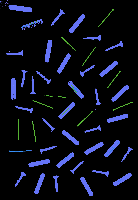

Without contours number:  2841


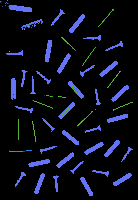

Without contours number:  2842


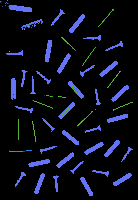

Without contours number:  2843


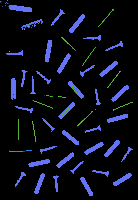

Without contours number:  2844


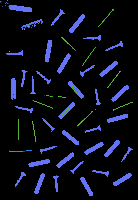

Without contours number:  2845


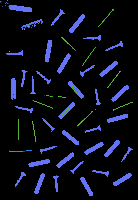

Without contours number:  2846


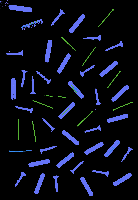

Without contours number:  2847


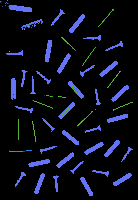

Without contours number:  2848


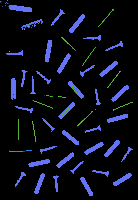

Without contours number:  2849


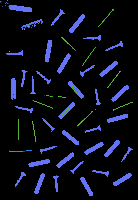

Without contours number:  2850


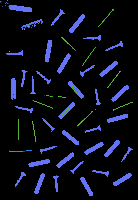

Without contours number:  2851


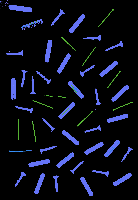

Without contours number:  2852


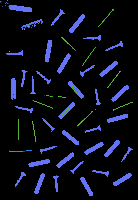

Without contours number:  2853


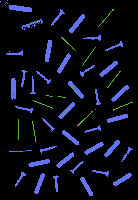

Without contours number:  2854


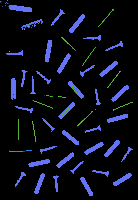

Without contours number:  2855


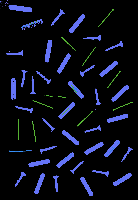

Without contours number:  2856


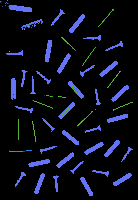

Without contours number:  2857


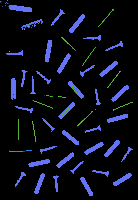

Without contours number:  2858


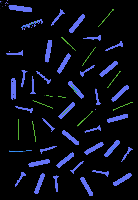

Without contours number:  2859


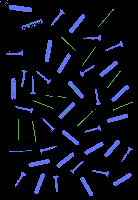

Without contours number:  2860


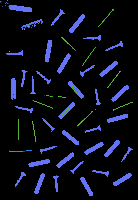

Without contours number:  2861


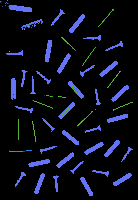

Without contours number:  2862


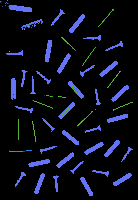

Without contours number:  2864


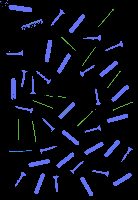

Without contours number:  2865


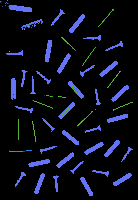

Without contours number:  2866


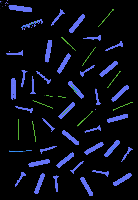

Without contours number:  2867


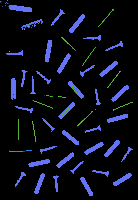

Without contours number:  2868


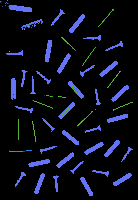

Without contours number:  2869


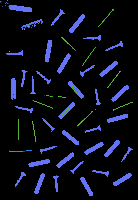

Without contours number:  2870


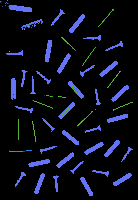

Without contours number:  2871


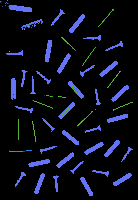

Without contours number:  2872


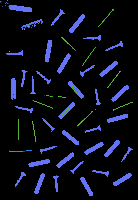

Without contours number:  2873


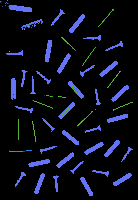

Without contours number:  2874


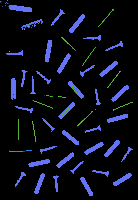

Without contours number:  2875


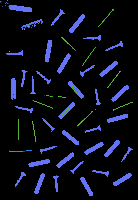

Without contours number:  2876


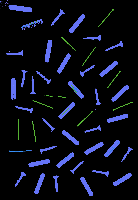

Without contours number:  2877


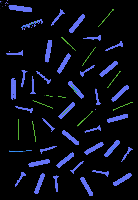

Without contours number:  2878


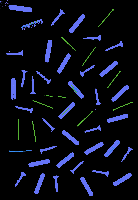

Without contours number:  2879


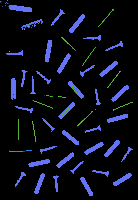

Without contours number:  2880


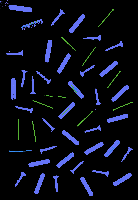

Without contours number:  2881


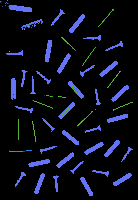

Without contours number:  2882


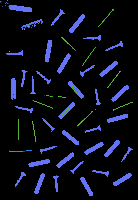

Without contours number:  2883


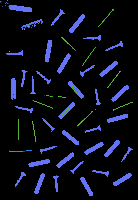

Without contours number:  2884


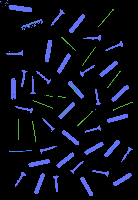

Without contours number:  2885


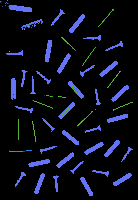

Without contours number:  2886


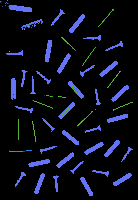

Without contours number:  2887


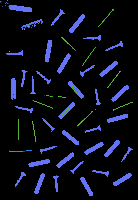

Without contours number:  2888


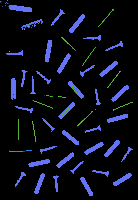

Without contours number:  2889


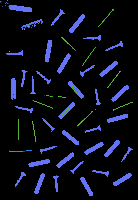

Without contours number:  2890


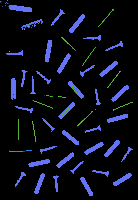

Without contours number:  2891


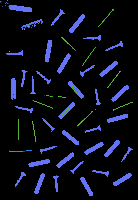

Without contours number:  2892


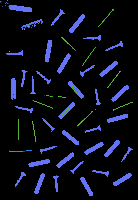

Without contours number:  2893


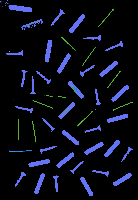

Without contours number:  2894


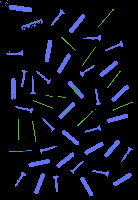

Without contours number:  2895


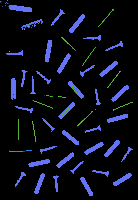

Without contours number:  2897


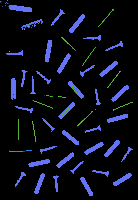

Without contours number:  2898


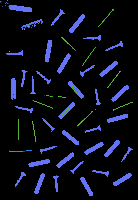

Without contours number:  2899


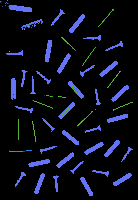

Without contours number:  2900


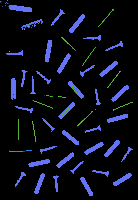

Without contours number:  2901


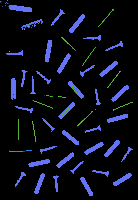

Without contours number:  2902


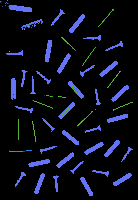

Without contours number:  2903


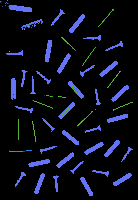

Without contours number:  2904


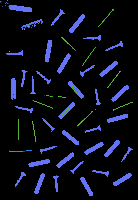

Without contours number:  2905


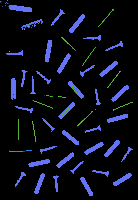

Without contours number:  2906


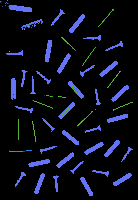

Without contours number:  2907


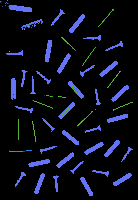

Without contours number:  2908


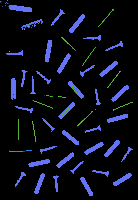

Without contours number:  2909


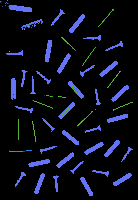

Without contours number:  2910


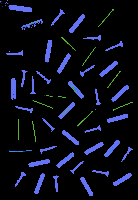

Without contours number:  2911


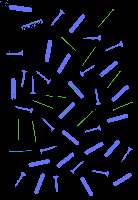

Without contours number:  2912


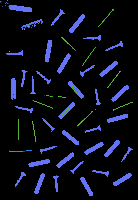

Without contours number:  2913


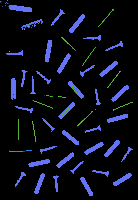

Without contours number:  2914


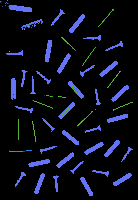

Without contours number:  2915


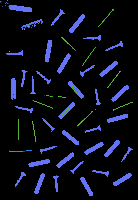

Without contours number:  2916


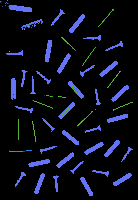

Without contours number:  2917


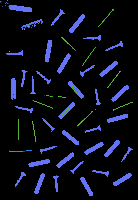

Without contours number:  2918


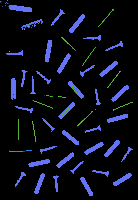

Without contours number:  2919


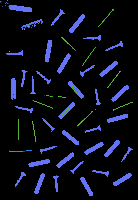

Without contours number:  2920


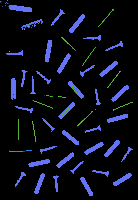

Without contours number:  2921


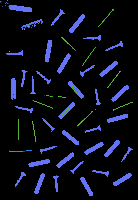

Without contours number:  2922


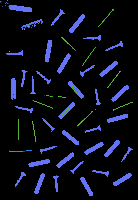

Without contours number:  2923


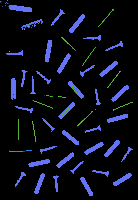

Without contours number:  2924


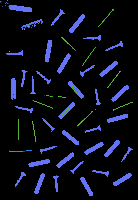

Without contours number:  2925


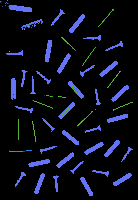

Without contours number:  2926


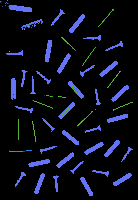

Without contours number:  2927


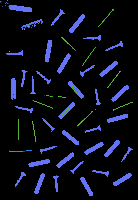

Without contours number:  2928


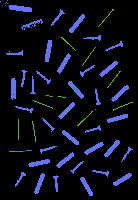

Without contours number:  2929


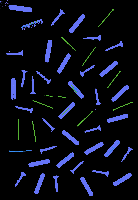

Without contours number:  2930


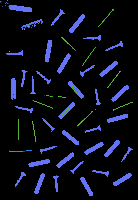

Without contours number:  2931


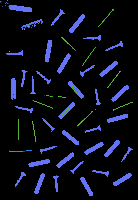

Without contours number:  2932


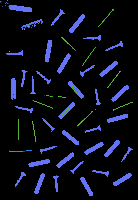

Without contours number:  2933


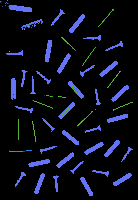

Without contours number:  2934


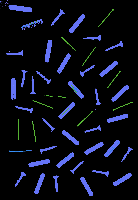

Without contours number:  2935


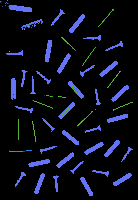

Without contours number:  2936


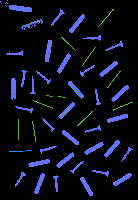

Without contours number:  2937


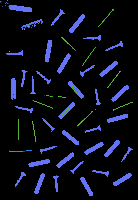

Without contours number:  2938


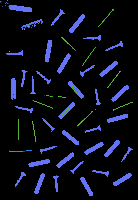

Without contours number:  2939


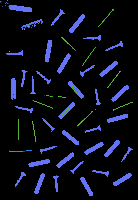

Without contours number:  2940


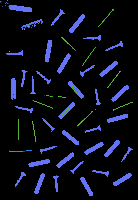

Without contours number:  2941


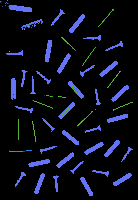

Without contours number:  2942


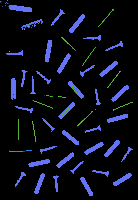

Without contours number:  2943


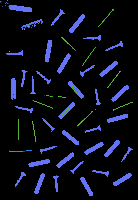

Without contours number:  2946


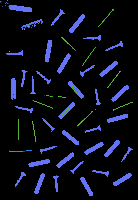

Without contours number:  2948


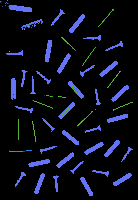

Without contours number:  2949


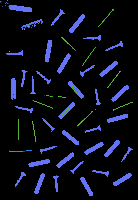

Without contours number:  2950


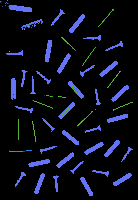

Without contours number:  2951


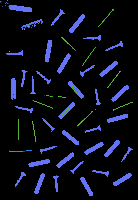

Without contours number:  2952


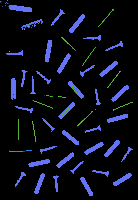

Without contours number:  2953


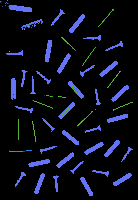

Without contours number:  2954


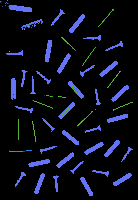

Without contours number:  2955


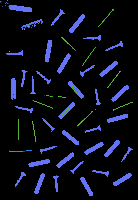

Without contours number:  2956


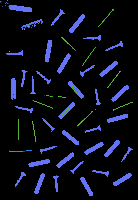

Without contours number:  2957


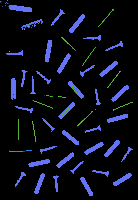

Without contours number:  2958


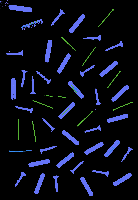

Without contours number:  2959


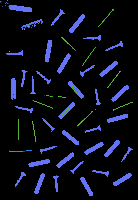

Without contours number:  2960


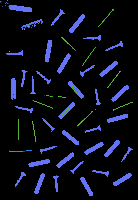

Without contours number:  2961


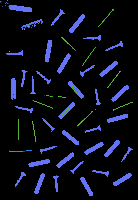

Without contours number:  2962


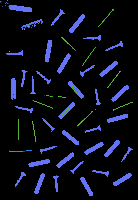

Without contours number:  2963


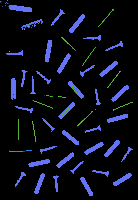

Without contours number:  2964


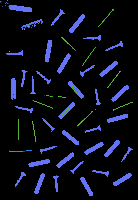

Without contours number:  2965


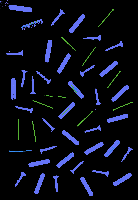

Without contours number:  2966


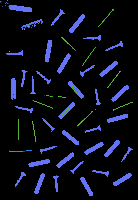

Without contours number:  2967


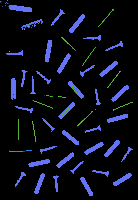

Without contours number:  2968


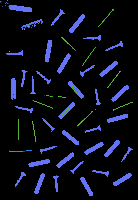

Without contours number:  2969


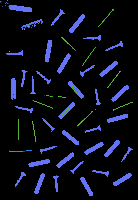

Without contours number:  2970


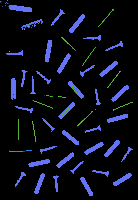

Without contours number:  2971


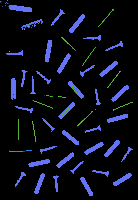

Without contours number:  2972


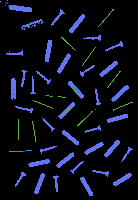

Without contours number:  2973


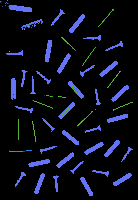

Without contours number:  2974


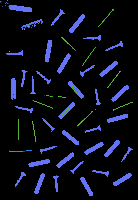

Without contours number:  2975


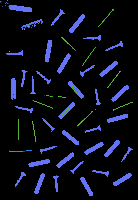

Without contours number:  2976


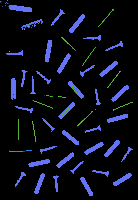

Without contours number:  2977


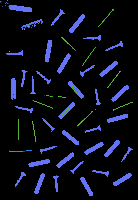

Without contours number:  2978


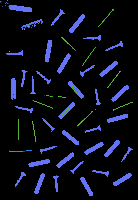

Without contours number:  2979


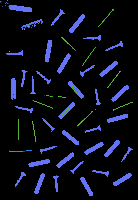

Without contours number:  2980


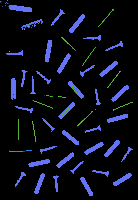

Without contours number:  2981


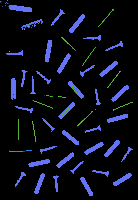

Without contours number:  2982


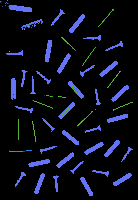

Without contours number:  2983


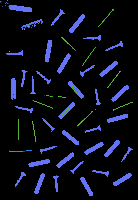

Without contours number:  2984


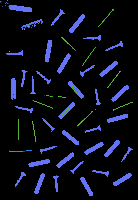

Without contours number:  2985


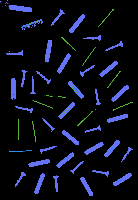

Without contours number:  2986


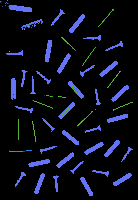

Without contours number:  2987


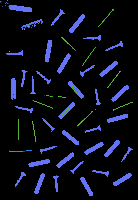

Without contours number:  2988


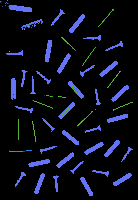

Without contours number:  2989


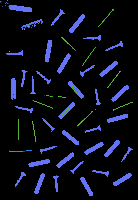

Without contours number:  2990


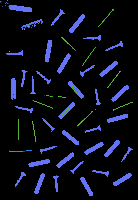

Without contours number:  2991


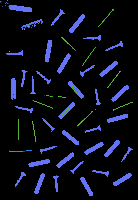

Without contours number:  2992


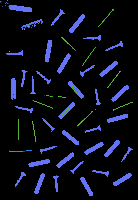

Without contours number:  2993


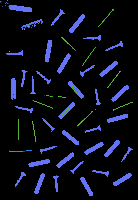

Without contours number:  2994


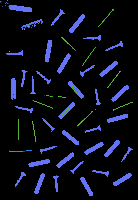

Without contours number:  2995


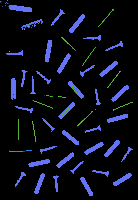

Without contours number:  2996


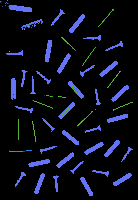

Without contours number:  2997


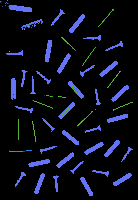

Without contours number:  2998


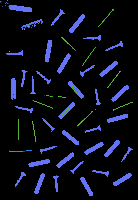

Without contours number:  2999


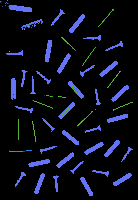

Without contours number:  3000


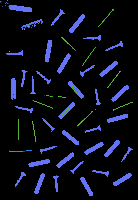

Without contours number:  3001


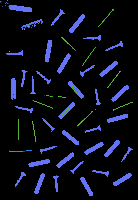

Without contours number:  3002


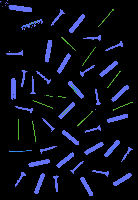

Without contours number:  3003


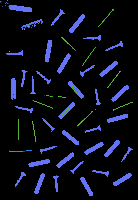

Without contours number:  3004


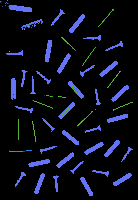

Without contours number:  3005


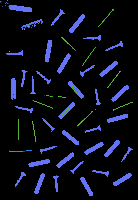

Without contours number:  3006


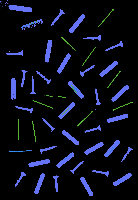

Without contours number:  3007


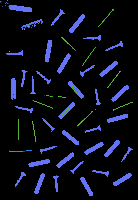

Without contours number:  3008


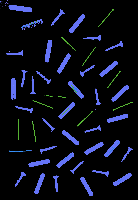

Without contours number:  3009


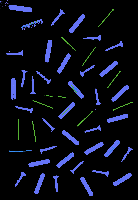

Without contours number:  3010


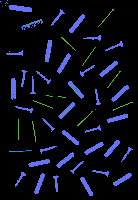

Without contours number:  3011


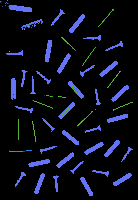

Without contours number:  3012


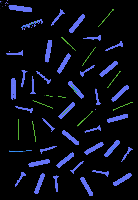

Without contours number:  3013


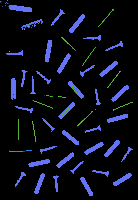

Without contours number:  3014


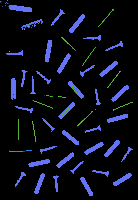

Without contours number:  3015


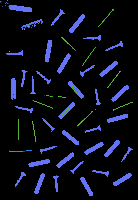

Without contours number:  3016


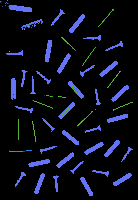

Without contours number:  3017


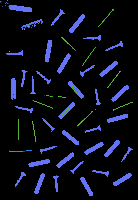

Without contours number:  3018


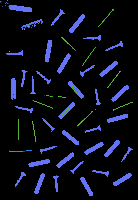

Without contours number:  3019


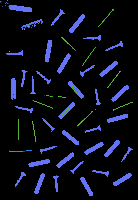

Without contours number:  3020


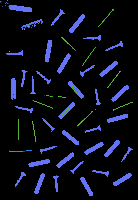

Without contours number:  3021


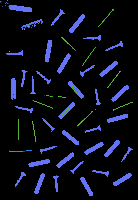

Without contours number:  3022


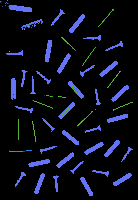

Without contours number:  3023


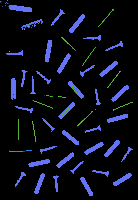

Without contours number:  3024


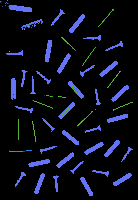

Without contours number:  3025


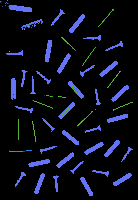

Without contours number:  3026


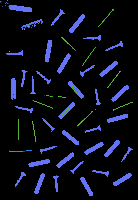

Without contours number:  3027


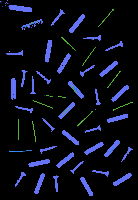

Without contours number:  3028


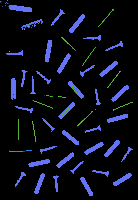

Without contours number:  3029


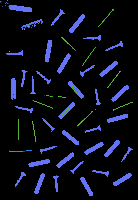

Without contours number:  3030


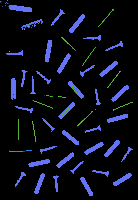

Without contours number:  3031


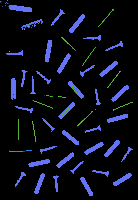

Without contours number:  3032


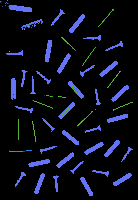

Without contours number:  3033


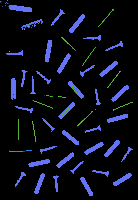

Without contours number:  3034


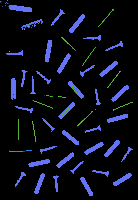

Without contours number:  3036


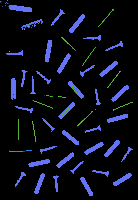

Without contours number:  3037


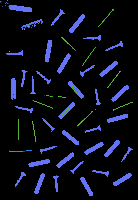

Without contours number:  3038


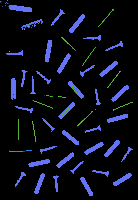

Without contours number:  3039


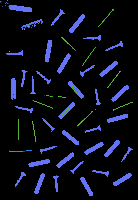

Without contours number:  3040


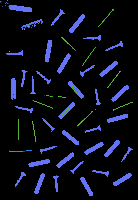

Without contours number:  3041


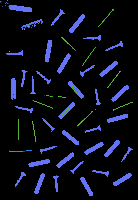

Without contours number:  3042


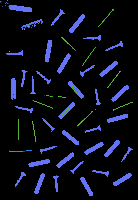

Without contours number:  3043


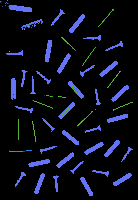

Without contours number:  3044


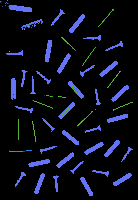

Without contours number:  3045


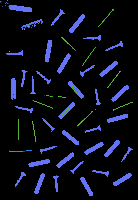

Without contours number:  3046


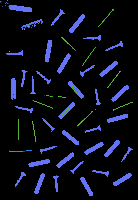

Without contours number:  3047


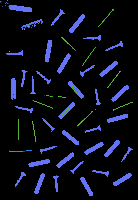

Without contours number:  3048


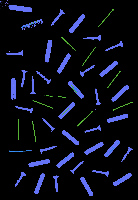

Without contours number:  3049


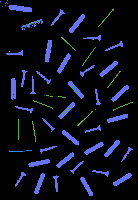

Without contours number:  3050


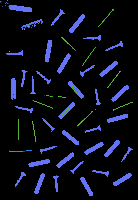

Without contours number:  3051


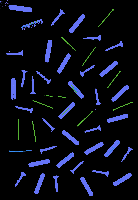

Without contours number:  3052


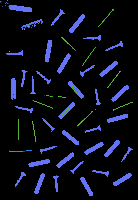

Without contours number:  3053


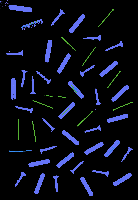

Without contours number:  3054


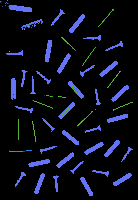

Without contours number:  3055


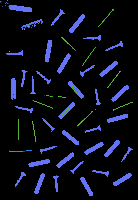

Without contours number:  3056


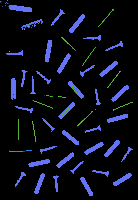

Without contours number:  3057


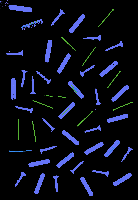

Without contours number:  3058


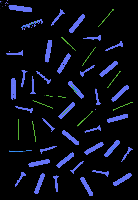

Without contours number:  3059


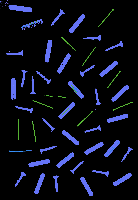

Without contours number:  3060


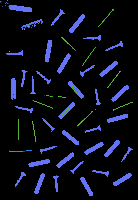

Without contours number:  3061


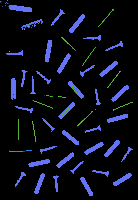

Without contours number:  3062


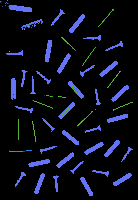

Without contours number:  3063


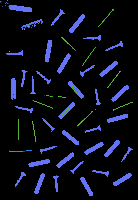

Without contours number:  3064


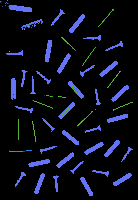

Without contours number:  3065


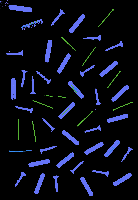

Without contours number:  3066


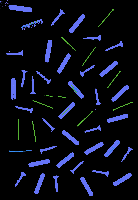

Without contours number:  3067


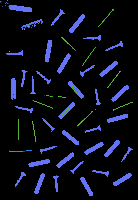

Without contours number:  3068


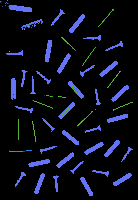

Without contours number:  3069


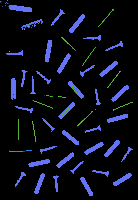

Without contours number:  3070


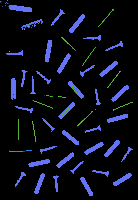

Without contours number:  3071


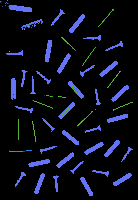

Without contours number:  3072


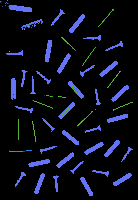

Without contours number:  3073


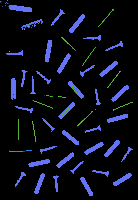

Without contours number:  3074


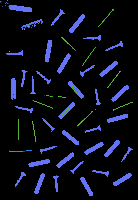

Without contours number:  3075


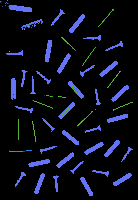

Without contours number:  3076


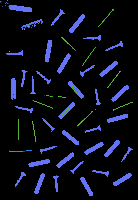

Without contours number:  3077


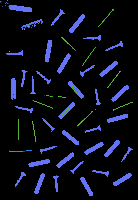

Without contours number:  3078


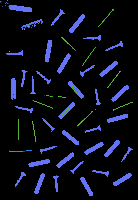

Without contours number:  3079


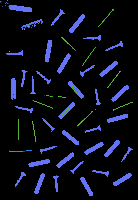

Without contours number:  3080


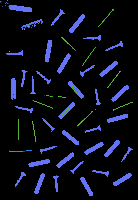

Without contours number:  3081


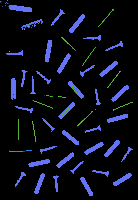

Without contours number:  3082


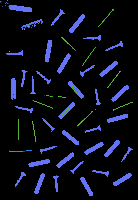

Without contours number:  3083


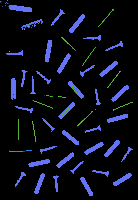

Without contours number:  3084


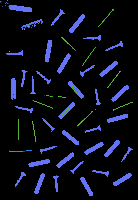

Without contours number:  3085


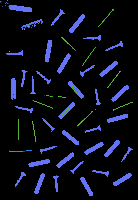

Without contours number:  3086


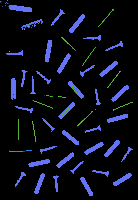

Without contours number:  3087


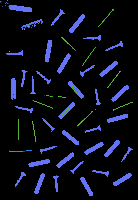

Without contours number:  3088


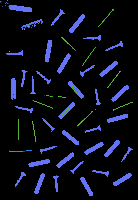

Without contours number:  3089


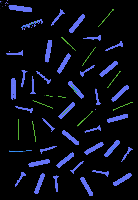

Without contours number:  3090


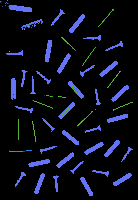

Without contours number:  3091


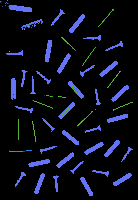

Without contours number:  3092


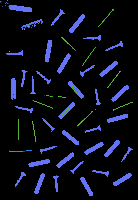

Without contours number:  3093


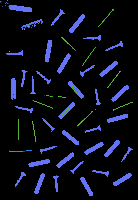

Without contours number:  3094


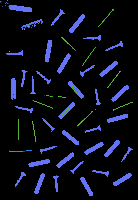

Without contours number:  3095


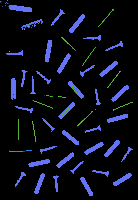

Without contours number:  3096


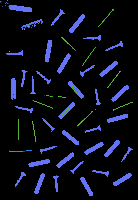

Without contours number:  3097


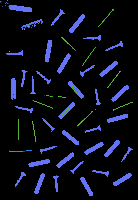

Without contours number:  3098


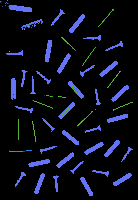

Without contours number:  3099


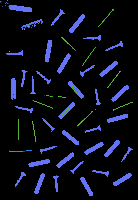

Without contours number:  3100


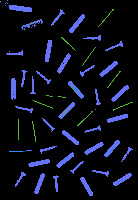

Without contours number:  3101


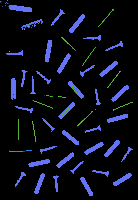

Without contours number:  3102


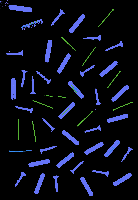

Without contours number:  3103


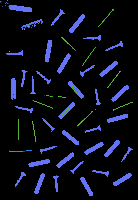

Without contours number:  3104


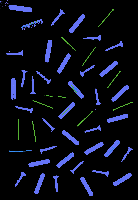

Without contours number:  3105


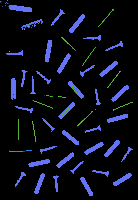

Without contours number:  3106


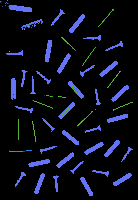

Without contours number:  3107


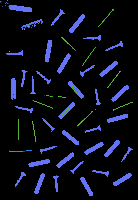

Without contours number:  3108


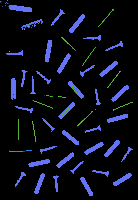

Without contours number:  3109


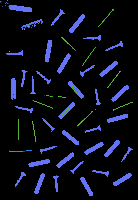

Without contours number:  3110


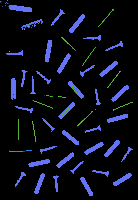

Without contours number:  3111


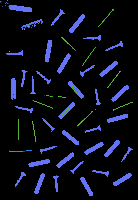

Without contours number:  3112


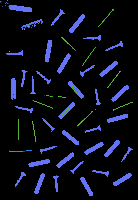

Without contours number:  3113


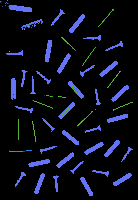

Without contours number:  3114


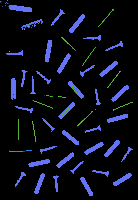

Without contours number:  3115


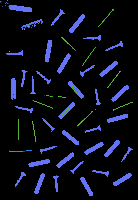

Without contours number:  3116


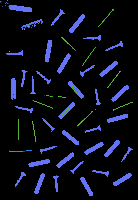

Without contours number:  3117


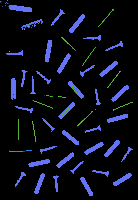

Without contours number:  3118


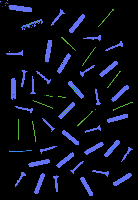

Without contours number:  3119


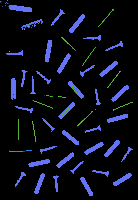

Without contours number:  3120


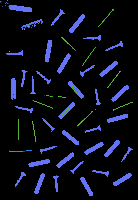

Without contours number:  3121


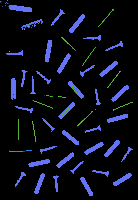

Without contours number:  3122


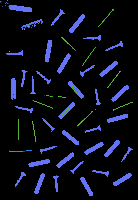

Without contours number:  3123


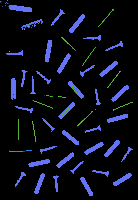

Without contours number:  3124


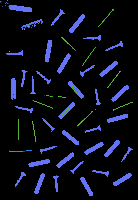

Without contours number:  3125


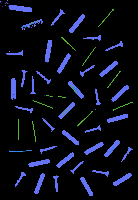

Without contours number:  3126


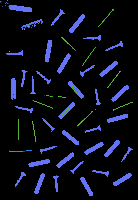

Without contours number:  3127


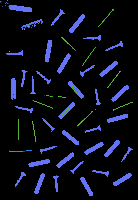

Without contours number:  3128


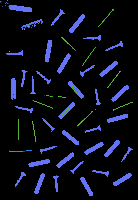

Without contours number:  3129


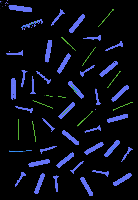

Without contours number:  3130


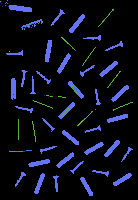

Without contours number:  3131


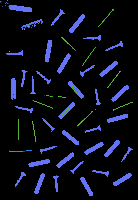

Without contours number:  3132


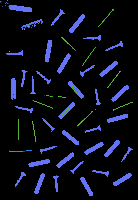

Without contours number:  3133


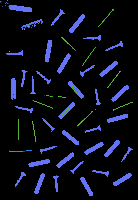

Without contours number:  3134


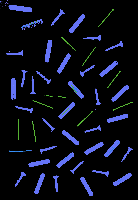

Without contours number:  3135


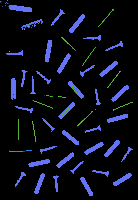

Without contours number:  3136


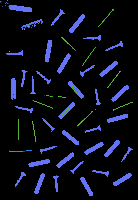

Without contours number:  3137


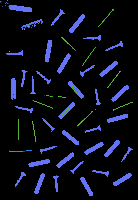

Without contours number:  3138


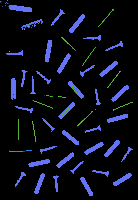

Without contours number:  3139


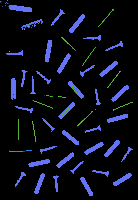

Without contours number:  3140


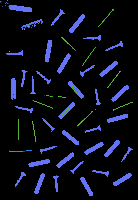

Without contours number:  3141


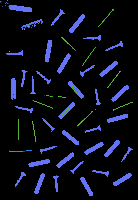

Without contours number:  3142


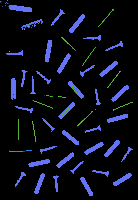

Without contours number:  3143


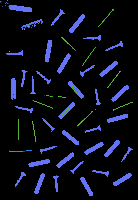

Without contours number:  3144


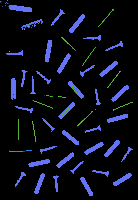

Without contours number:  3145


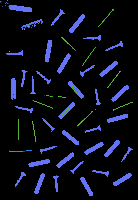

Without contours number:  3146


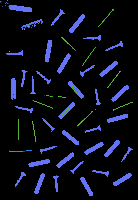

Without contours number:  3147


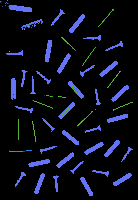

Without contours number:  3148


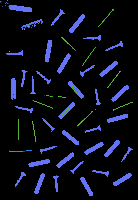

Without contours number:  3149


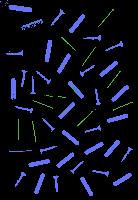

Without contours number:  3150


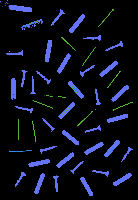

Without contours number:  3151


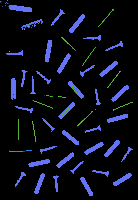

Without contours number:  3152


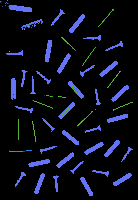

Without contours number:  3153


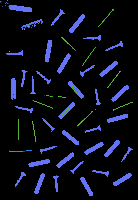

Without contours number:  3154


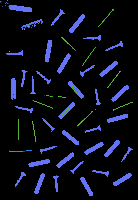

Without contours number:  3155


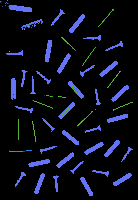

Without contours number:  3156


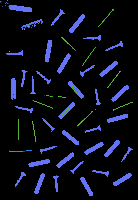

Without contours number:  3157


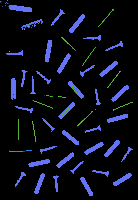

Without contours number:  3158


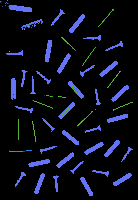

Without contours number:  3159


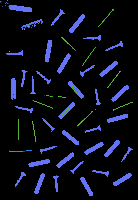

Without contours number:  3160


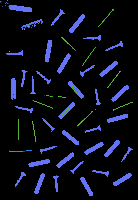

Without contours number:  3161


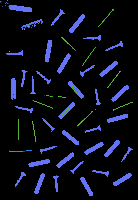

Without contours number:  3162


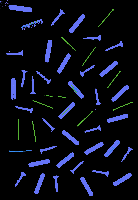

Without contours number:  3163


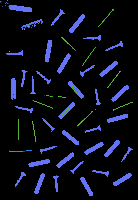

Without contours number:  3164


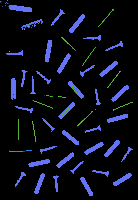

Without contours number:  3165


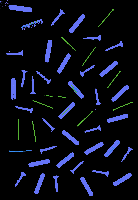

Without contours number:  3166


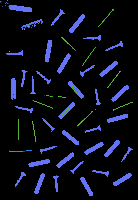

Without contours number:  3167


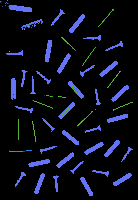

Without contours number:  3168


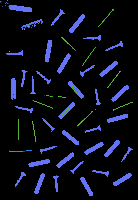

Without contours number:  3169


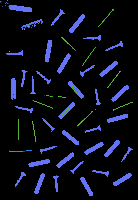

Without contours number:  3170


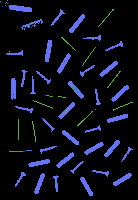

Without contours number:  3171


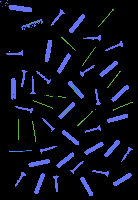

Without contours number:  3172


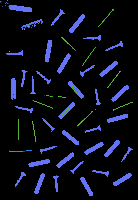

Without contours number:  3173


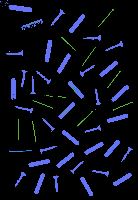

Without contours number:  3174


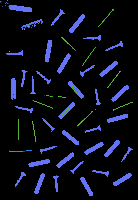

Without contours number:  3175


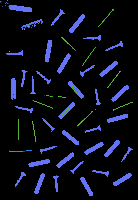

Without contours number:  3176


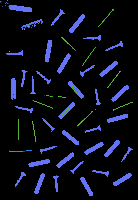

Without contours number:  3177


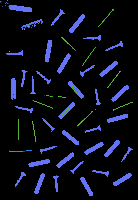

Without contours number:  3178


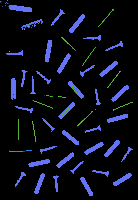

Without contours number:  3179


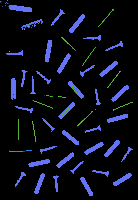

Without contours number:  3180


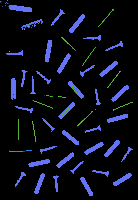

Without contours number:  3181


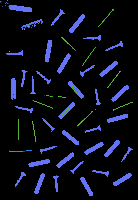

Without contours number:  3182


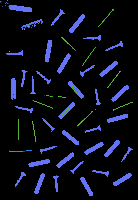

Without contours number:  3183


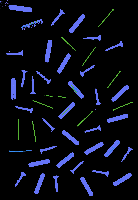

Without contours number:  3184


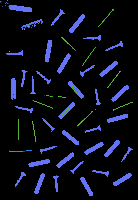

Without contours number:  3185


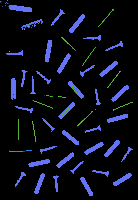

Without contours number:  3186


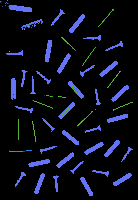

Without contours number:  3187


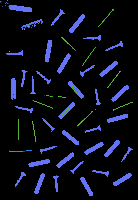

Without contours number:  3188


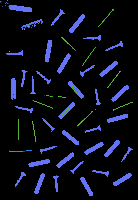

Without contours number:  3189


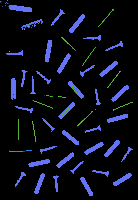

Without contours number:  3190


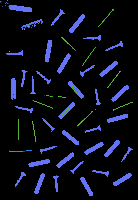

Without contours number:  3191


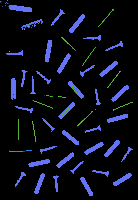

Without contours number:  3192


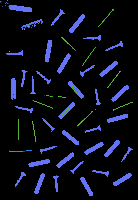

Without contours number:  3193


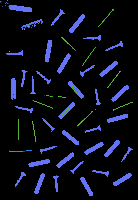

Without contours number:  3194


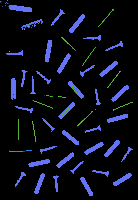

Without contours number:  3195


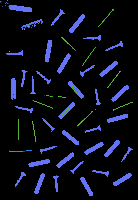

Without contours number:  3196


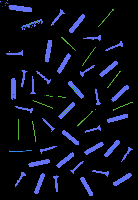

Without contours number:  3197


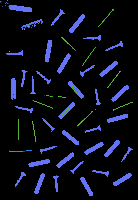

Without contours number:  3198


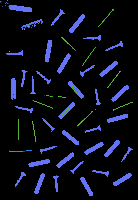

Without contours number:  3199


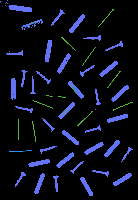

Without contours number:  3200


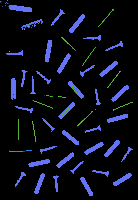

Without contours number:  3201


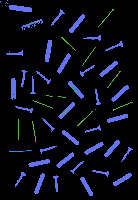

Without contours number:  3202


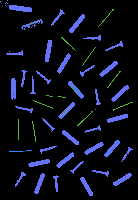

Without contours number:  3203


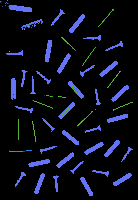

Without contours number:  3204


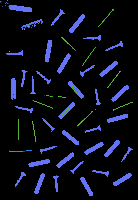

Without contours number:  3205


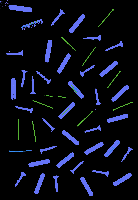

Without contours number:  3206


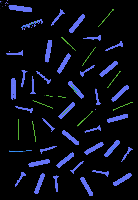

Without contours number:  3207


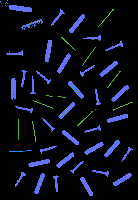

Without contours number:  3208


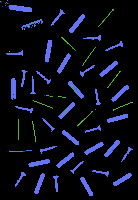

Without contours number:  3209


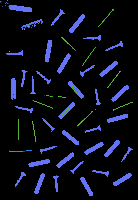

Without contours number:  3210


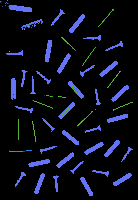

Without contours number:  3211


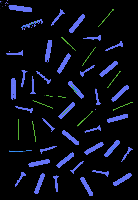

Without contours number:  3212


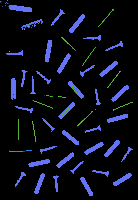

Without contours number:  3213


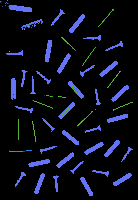

Without contours number:  3214


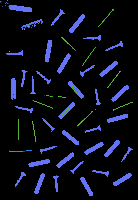

Without contours number:  3215


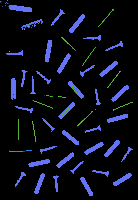

Without contours number:  3216


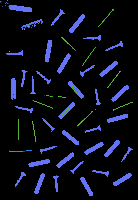

Without contours number:  3217


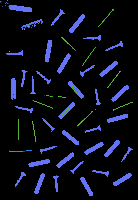

Without contours number:  3218


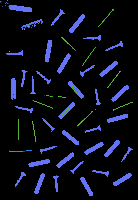

Without contours number:  3219


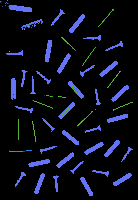

Without contours number:  3220


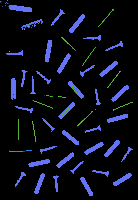

Without contours number:  3221


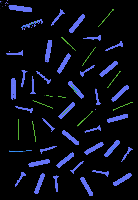

Without contours number:  3222


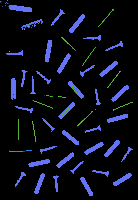

Without contours number:  3223


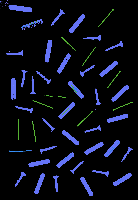

Without contours number:  3224


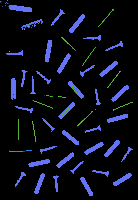

Without contours number:  3225


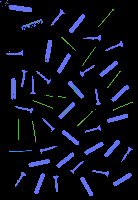

Without contours number:  3226


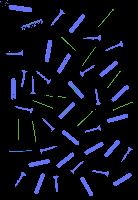

Without contours number:  3227


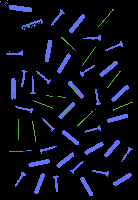

Without contours number:  3228


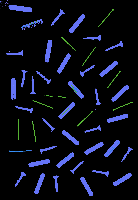

Without contours number:  3230


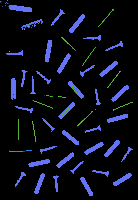

Without contours number:  3231


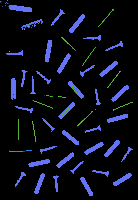

Without contours number:  3232


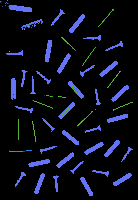

Without contours number:  3233


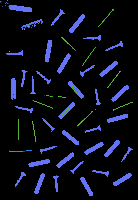

Without contours number:  3234


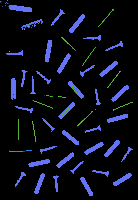

Without contours number:  3235


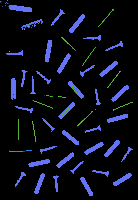

Without contours number:  3236


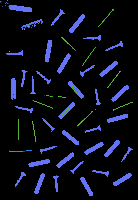

Without contours number:  3237


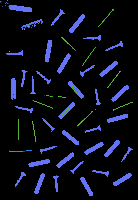

Without contours number:  3238


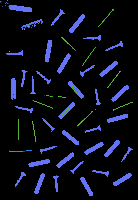

Without contours number:  3239


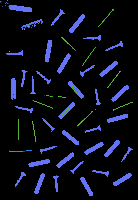

Without contours number:  3240


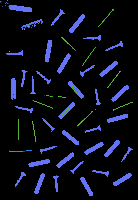

Without contours number:  3241


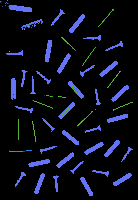

Without contours number:  3242


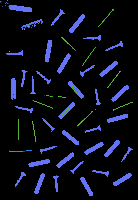

Without contours number:  3243


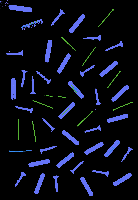

Without contours number:  3244


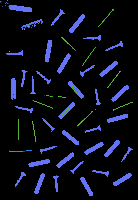

Without contours number:  3245


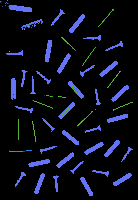

Without contours number:  3246


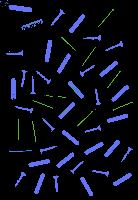

Without contours number:  3247


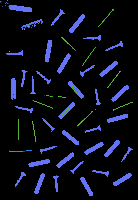

Without contours number:  3248


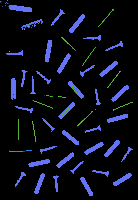

Without contours number:  3249


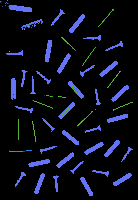

Without contours number:  3250


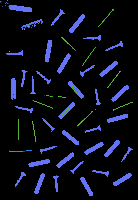

Without contours number:  3251


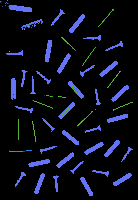

Without contours number:  3252


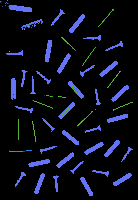

Without contours number:  3253


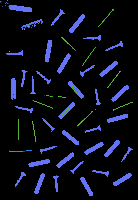

Without contours number:  3254


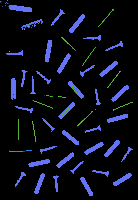

Without contours number:  3255


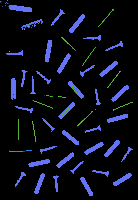

Without contours number:  3256


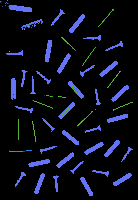

Without contours number:  3257


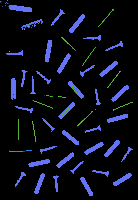

Without contours number:  3258


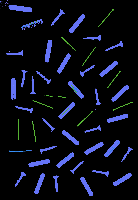

Without contours number:  3259


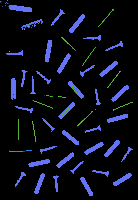

Without contours number:  3260


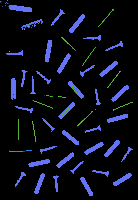

Without contours number:  3261


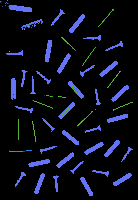

Without contours number:  3262


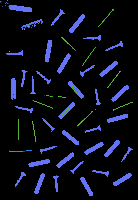

Without contours number:  3263


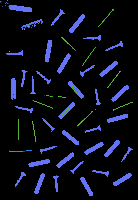

Without contours number:  3264


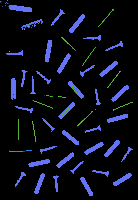

Without contours number:  3265


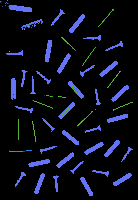

Without contours number:  3266


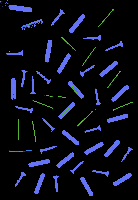

Without contours number:  3267


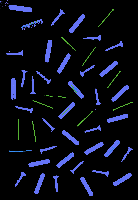

Without contours number:  3268


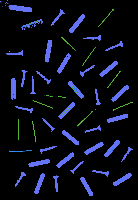

Without contours number:  3269


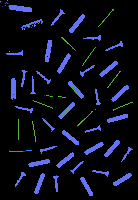

Without contours number:  3270


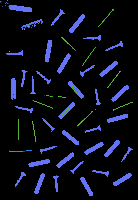

Without contours number:  3271


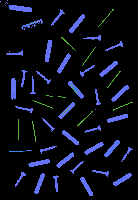

Without contours number:  3272


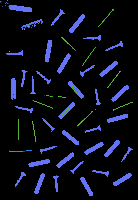

Without contours number:  3273


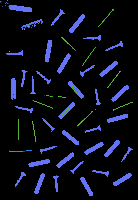

Without contours number:  3274


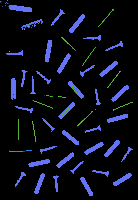

Without contours number:  3275


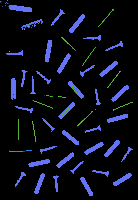

Without contours number:  3276


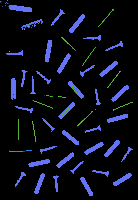

Without contours number:  3277


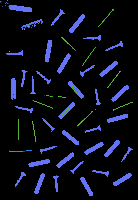

Without contours number:  3278


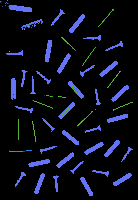

Without contours number:  3279


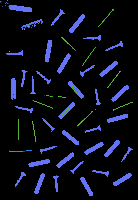

Without contours number:  3280


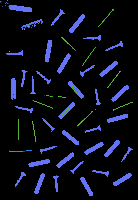

Without contours number:  3281


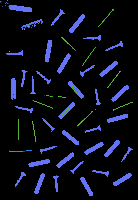

Without contours number:  3282


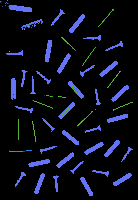

Without contours number:  3283


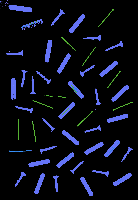

Without contours number:  3284


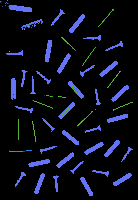

Without contours number:  3285


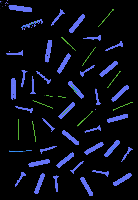

Without contours number:  3286


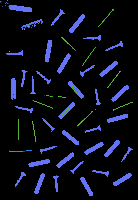

Without contours number:  3287


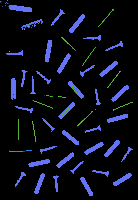

Without contours number:  3288


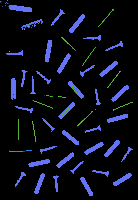

Without contours number:  3289


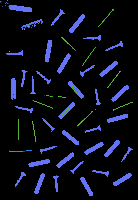

Without contours number:  3290


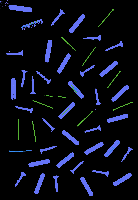

Without contours number:  3291


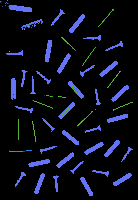

Without contours number:  3292


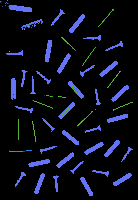

Without contours number:  3293


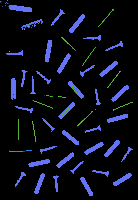

Without contours number:  3294


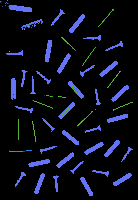

Without contours number:  3295


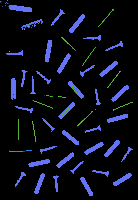

Without contours number:  3296


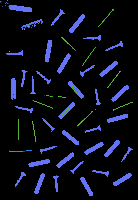

Without contours number:  3297


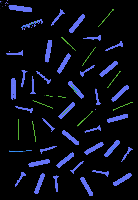

Without contours number:  3298


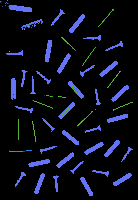

Without contours number:  3299


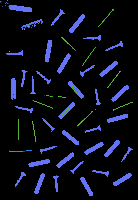

Without contours number:  3300


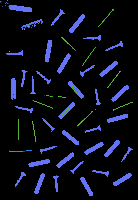

Without contours number:  3301


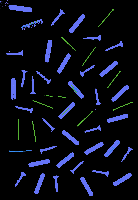

Without contours number:  3302


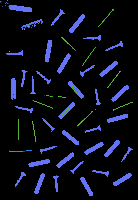

Without contours number:  3303


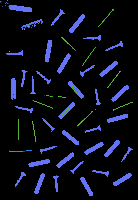

Without contours number:  3304


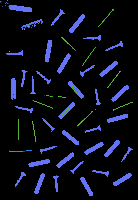

Without contours number:  3305


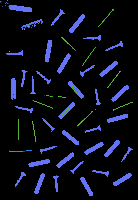

Without contours number:  3306


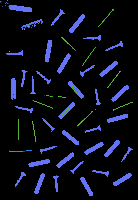

Without contours number:  3307


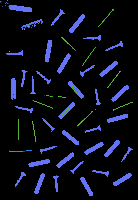

Without contours number:  3308


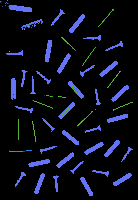

Without contours number:  3309


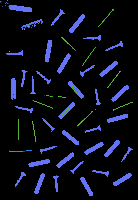

Without contours number:  3310


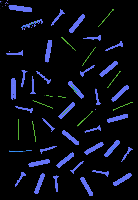

Without contours number:  3311


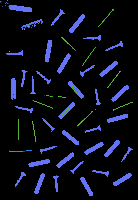

Without contours number:  3312


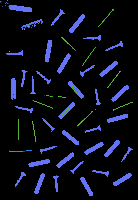

Without contours number:  3313


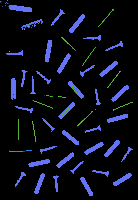

Without contours number:  3314


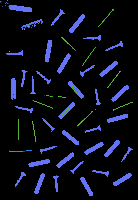

Without contours number:  3315


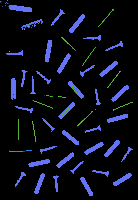

Without contours number:  3316


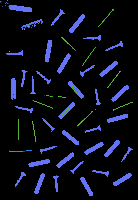

Without contours number:  3317


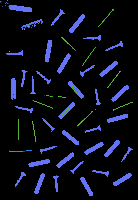

Without contours number:  3318


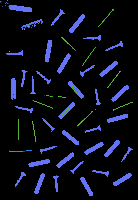

Without contours number:  3319


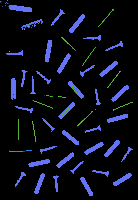

Without contours number:  3320


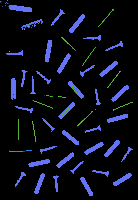

Without contours number:  3321


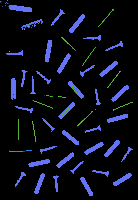

Without contours number:  3322


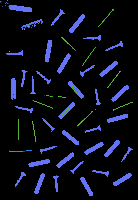

Without contours number:  3323


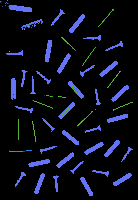

Without contours number:  3324


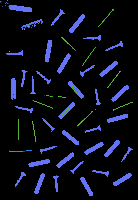

Without contours number:  3325


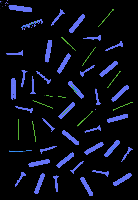

Without contours number:  3326


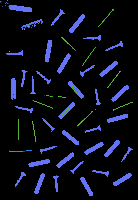

Without contours number:  3327


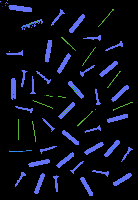

Without contours number:  3328


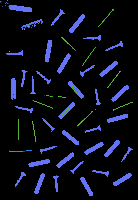

Without contours number:  3329


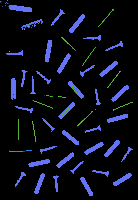

Without contours number:  3330


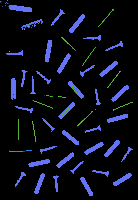

Without contours number:  3331


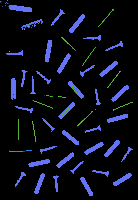

Without contours number:  3332


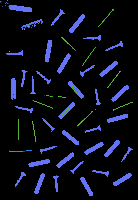

Without contours number:  3333


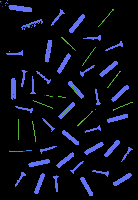

Without contours number:  3334


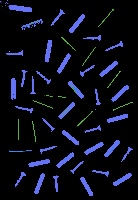

Without contours number:  3335


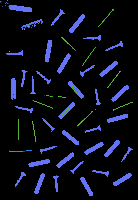

Without contours number:  3336


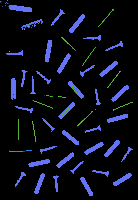

Without contours number:  3337


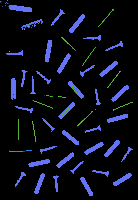

Without contours number:  3339


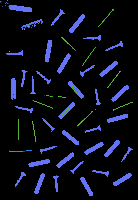

Without contours number:  3340


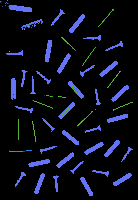

Without contours number:  3341


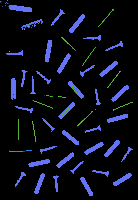

Without contours number:  3342


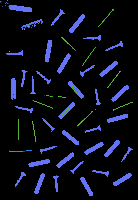

Without contours number:  3343


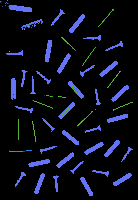

Without contours number:  3344


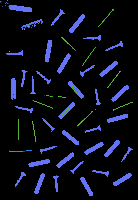

Without contours number:  3345


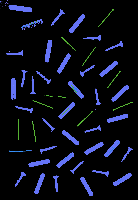

Without contours number:  3346


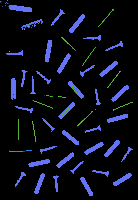

Without contours number:  3347


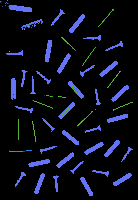

Without contours number:  3348


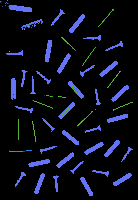

Without contours number:  3349


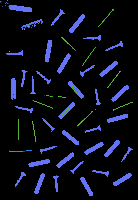

Without contours number:  3350


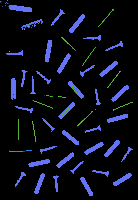

Without contours number:  3351


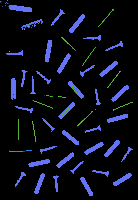

Without contours number:  3352


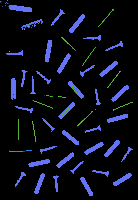

Without contours number:  3353


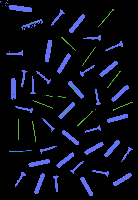

Without contours number:  3354


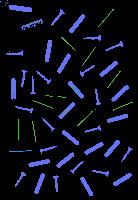

Without contours number:  3355


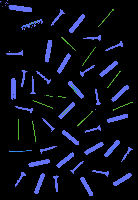

Without contours number:  3356


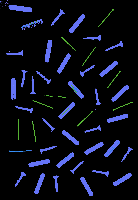

Without contours number:  3357


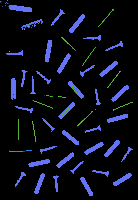

Without contours number:  3358


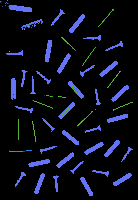

Without contours number:  3359


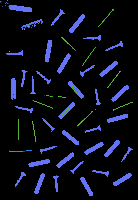

Without contours number:  3360


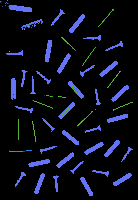

Without contours number:  3361


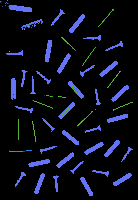

Without contours number:  3362


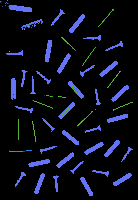

Without contours number:  3363


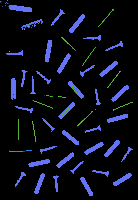

Without contours number:  3364


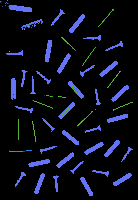

Without contours number:  3365


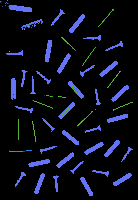

Without contours number:  3366


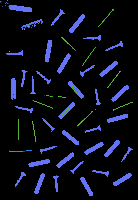

Without contours number:  3367


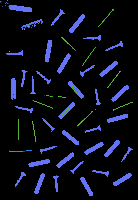

Without contours number:  3368


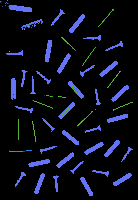

Without contours number:  3369


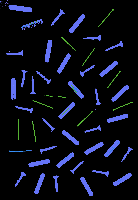

Without contours number:  3370


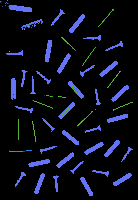

Without contours number:  3371


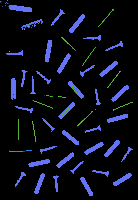

Without contours number:  3373


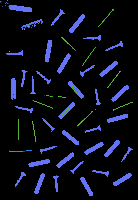

Without contours number:  3374


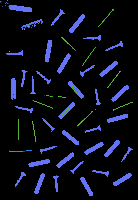

Without contours number:  3375


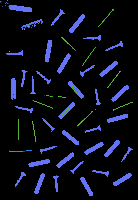

Without contours number:  3376


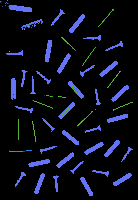

Without contours number:  3378


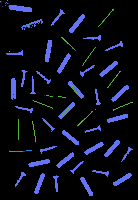

Without contours number:  3379


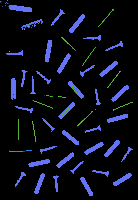

Without contours number:  3380


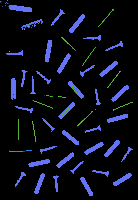

Without contours number:  3381


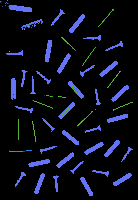

Without contours number:  3382


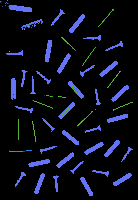

Without contours number:  3383


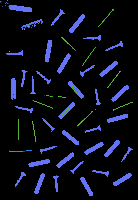

Without contours number:  3384


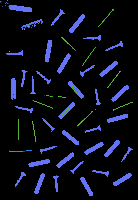

Without contours number:  3385


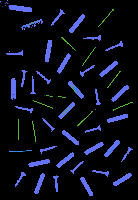

Without contours number:  3386


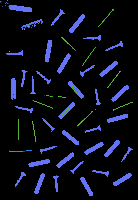

Without contours number:  3387


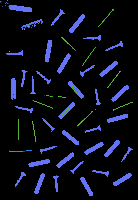

Without contours number:  3388


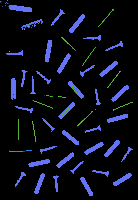

Without contours number:  3389


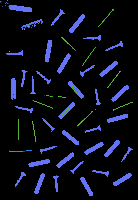

Without contours number:  3390


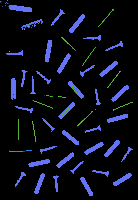

Without contours number:  3391


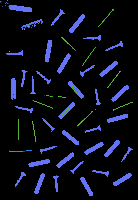

Without contours number:  3392


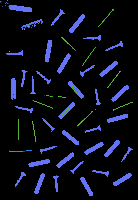

Without contours number:  3393


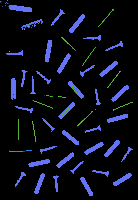

Without contours number:  3395


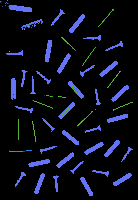

Without contours number:  3396


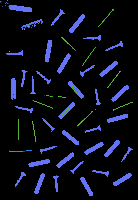

Without contours number:  3397


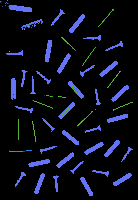

Without contours number:  3398


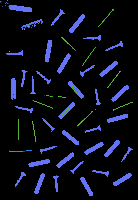

Without contours number:  3399


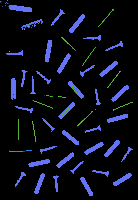

Without contours number:  3400


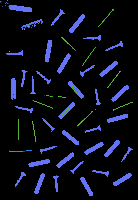

Without contours number:  3401


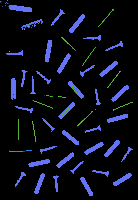

Without contours number:  3402


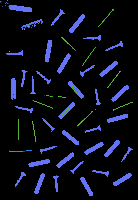

Without contours number:  3403


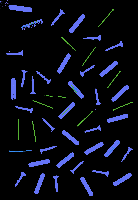

Without contours number:  3405


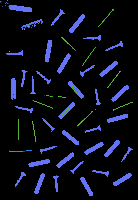

Without contours number:  3406


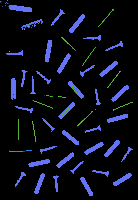

Without contours number:  3407


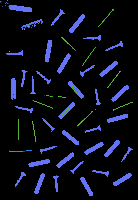

Without contours number:  3408


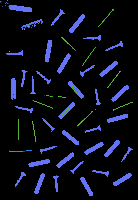

Without contours number:  3409


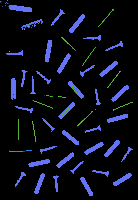

Without contours number:  3410


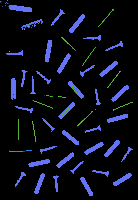

Without contours number:  3411


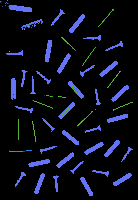

Without contours number:  3412


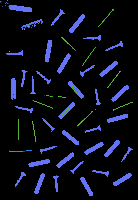

Without contours number:  3413


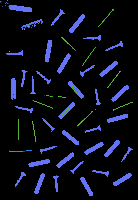

Without contours number:  3414


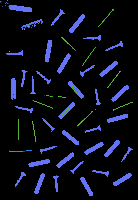

Without contours number:  3415


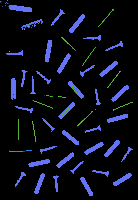

Without contours number:  3416


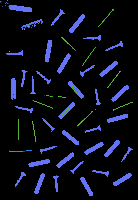

Without contours number:  3417


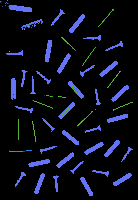

Without contours number:  3419


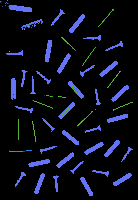

Without contours number:  3420


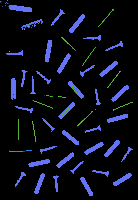

Without contours number:  3422


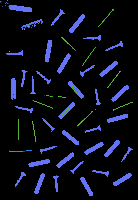

Without contours number:  3423


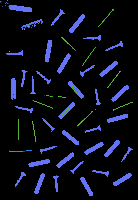

Without contours number:  3424


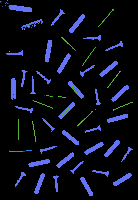

Without contours number:  3425


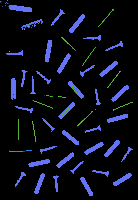

Without contours number:  3426


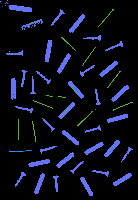

Without contours number:  3427


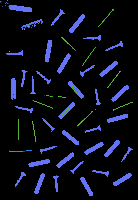

Without contours number:  3428


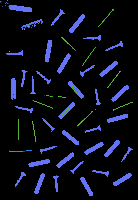

Without contours number:  3429


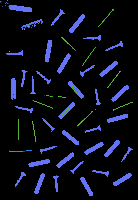

Without contours number:  3430


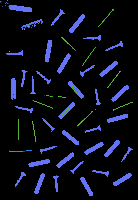

Without contours number:  3431


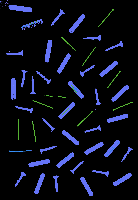

Without contours number:  3432


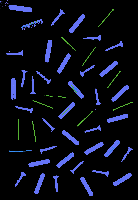

Without contours number:  3433


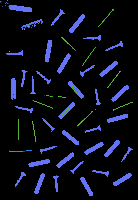

Without contours number:  3434


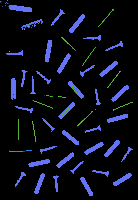

Without contours number:  3435


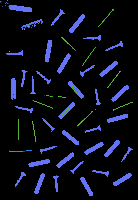

Without contours number:  3436


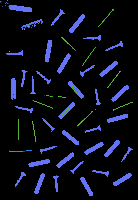

Without contours number:  3437


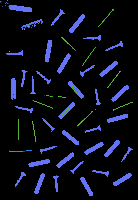

Without contours number:  3438


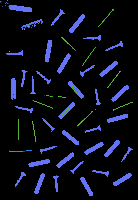

Without contours number:  3439


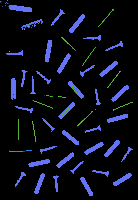

Without contours number:  3440


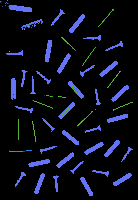

Without contours number:  3442


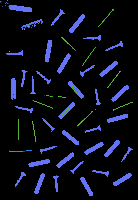

Without contours number:  3443


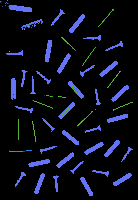

Without contours number:  3444


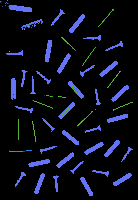

Without contours number:  3445


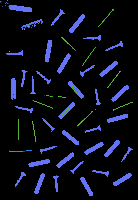

Without contours number:  3446


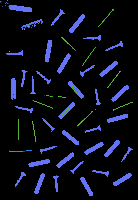

Without contours number:  3447


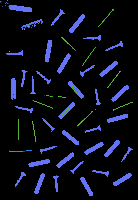

Without contours number:  3448


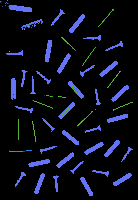

Without contours number:  3449


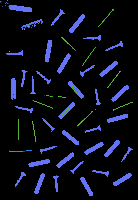

Without contours number:  3450


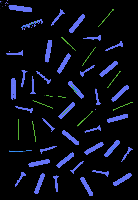

Without contours number:  3451


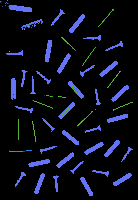

Without contours number:  3452


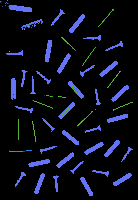

Without contours number:  3453


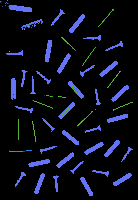

Without contours number:  3454


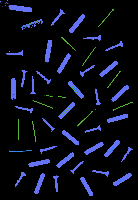

Without contours number:  3455


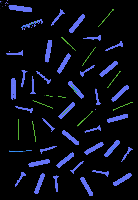

Without contours number:  3456


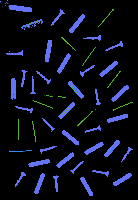

Without contours number:  3457


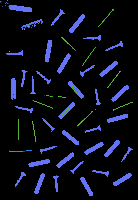

Without contours number:  3458


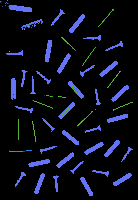

Without contours number:  3459


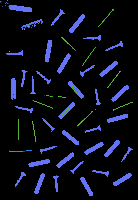

Without contours number:  3460


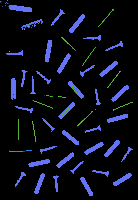

Without contours number:  3461


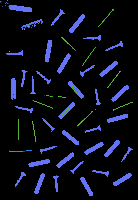

Without contours number:  3462


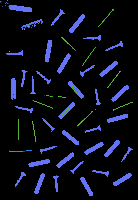

Without contours number:  3463


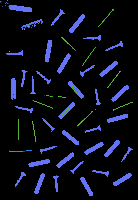

Without contours number:  3464


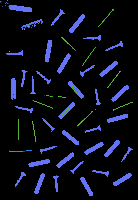

Without contours number:  3465


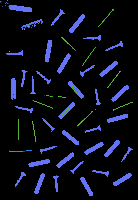

Without contours number:  3466


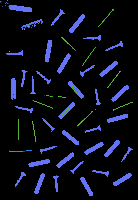

Without contours number:  3467


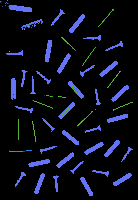

Without contours number:  3468


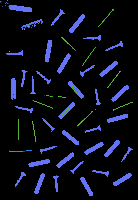

Without contours number:  3469


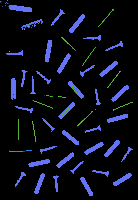

Without contours number:  3470


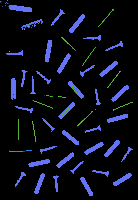

Without contours number:  3471


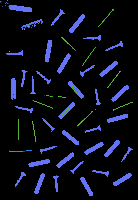

Without contours number:  3472


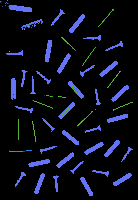

Without contours number:  3473


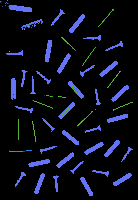

Without contours number:  3474


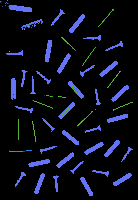

Without contours number:  3475


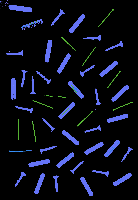

Without contours number:  3476


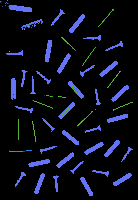

Without contours number:  3477


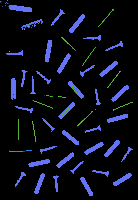

Without contours number:  3478


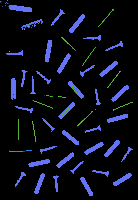

Without contours number:  3479


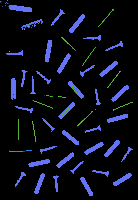

Without contours number:  3480


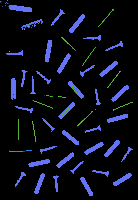

Without contours number:  3481


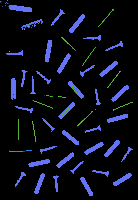

Without contours number:  3482


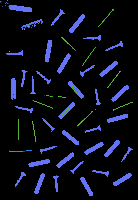

Without contours number:  3483


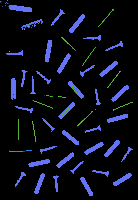

Without contours number:  3484


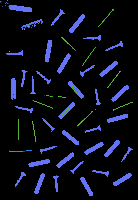

Without contours number:  3485


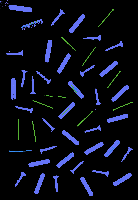

Without contours number:  3486


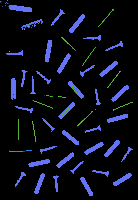

Without contours number:  3487


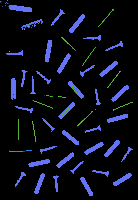

Without contours number:  3488


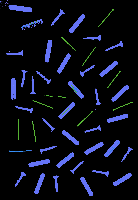

Without contours number:  3489


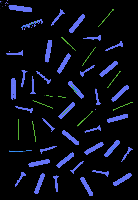

Without contours number:  3490


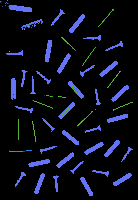

Without contours number:  3491


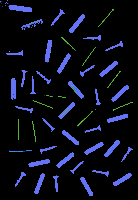

Without contours number:  3492


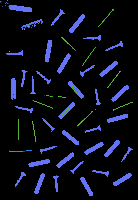

Without contours number:  3493


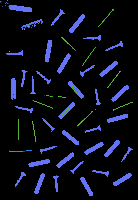

Without contours number:  3494


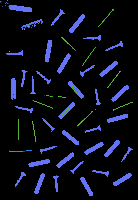

Without contours number:  3495


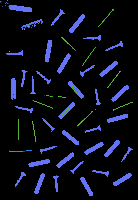

Without contours number:  3496


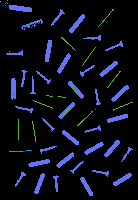

Without contours number:  3497


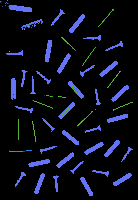

Without contours number:  3498


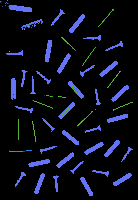

Without contours number:  3499


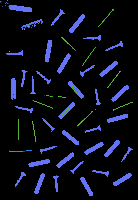

Without contours number:  3500


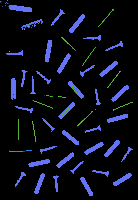

Without contours number:  3501


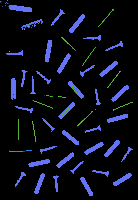

Without contours number:  3502


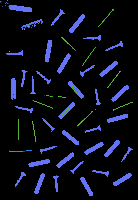

Without contours number:  3503


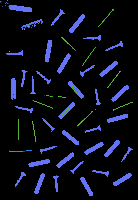

Without contours number:  3504


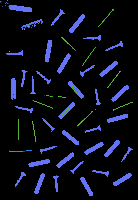

Without contours number:  3505


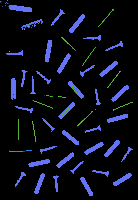

Without contours number:  3506


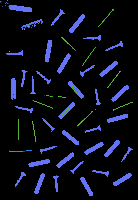

Without contours number:  3507


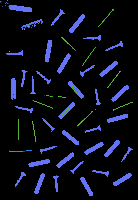

Without contours number:  3508


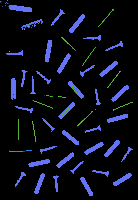

Without contours number:  3509


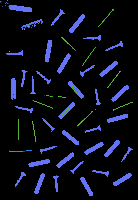

Without contours number:  3510


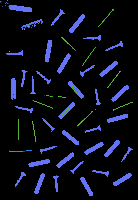

Without contours number:  3511


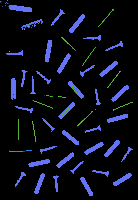

Without contours number:  3512


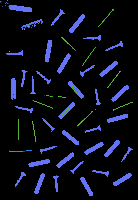

Without contours number:  3514


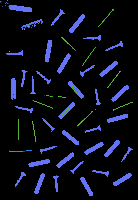

Without contours number:  3515


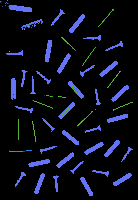

Without contours number:  3516


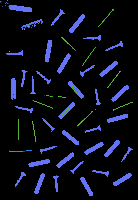

Without contours number:  3517


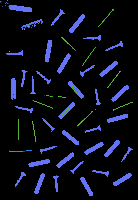

Without contours number:  3518


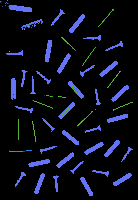

Without contours number:  3519


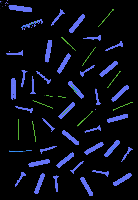

Without contours number:  3520


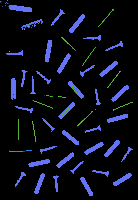

Without contours number:  3521


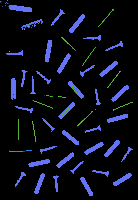

Without contours number:  3522


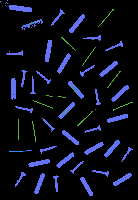

Without contours number:  3523


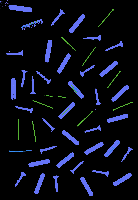

Without contours number:  3524


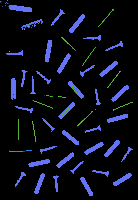

Without contours number:  3525


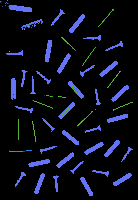

Without contours number:  3527


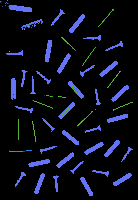

Without contours number:  3528


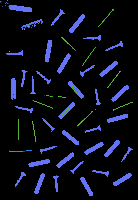

Without contours number:  3530


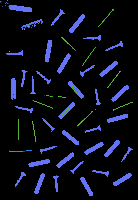

Without contours number:  3531


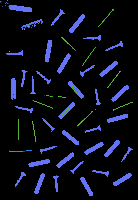

Without contours number:  3532


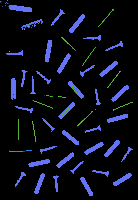

Without contours number:  3533


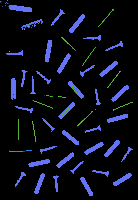

Without contours number:  3534


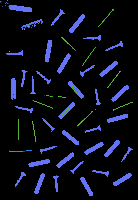

Without contours number:  3535


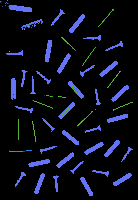

Without contours number:  3536


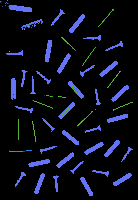

Without contours number:  3537


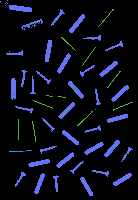

Without contours number:  3538


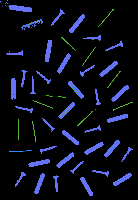

Without contours number:  3539


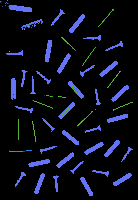

Without contours number:  3540


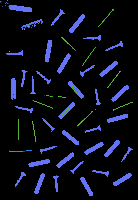

Without contours number:  3541


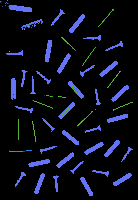

Without contours number:  3542


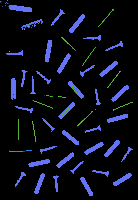

Without contours number:  3543


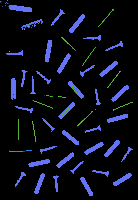

Without contours number:  3544


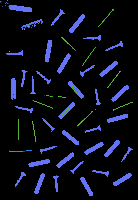

Without contours number:  3545


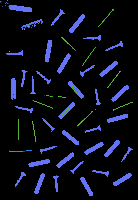

Without contours number:  3546


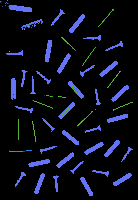

Without contours number:  3547


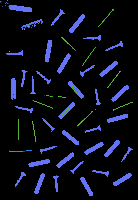

Without contours number:  3548


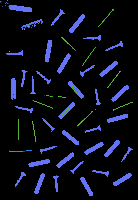

Without contours number:  3549


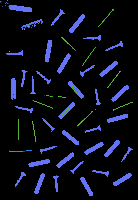

Without contours number:  3550


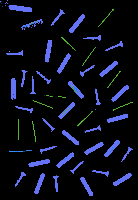

Without contours number:  3551


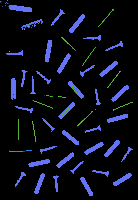

Without contours number:  3552


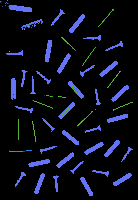

Without contours number:  3553


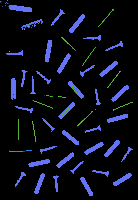

Without contours number:  3554


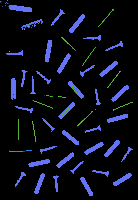

Without contours number:  3555


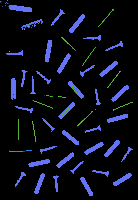

Without contours number:  3556


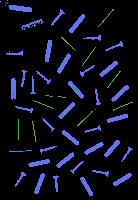

Without contours number:  3557


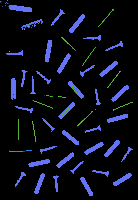

Without contours number:  3558


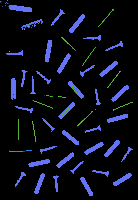

Without contours number:  3559


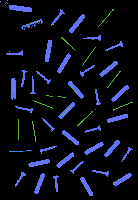

Without contours number:  3560


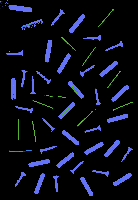

Without contours number:  3561


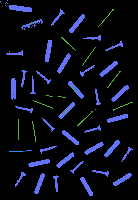

Without contours number:  3562


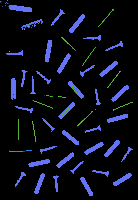

Without contours number:  3563


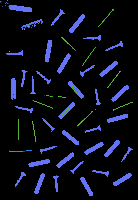

Without contours number:  3564


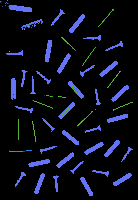

Without contours number:  3565


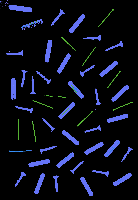

Without contours number:  3566


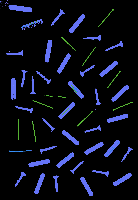

Without contours number:  3567


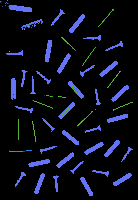

Without contours number:  3568


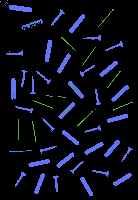

Without contours number:  3569


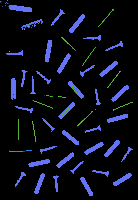

Without contours number:  3570


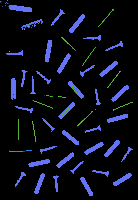

Without contours number:  3571


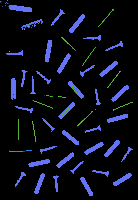

Without contours number:  3572


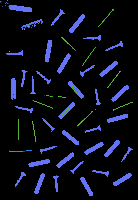

Without contours number:  3573


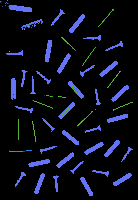

Without contours number:  3574


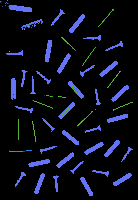

Without contours number:  3575


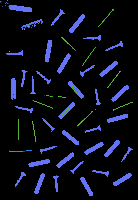

Without contours number:  3576


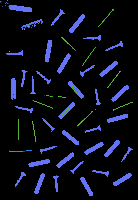

Without contours number:  3577


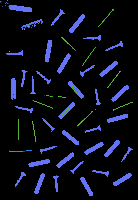

Without contours number:  3578


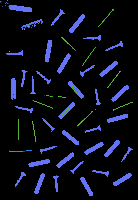

Without contours number:  3579


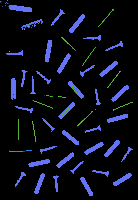

Without contours number:  3580


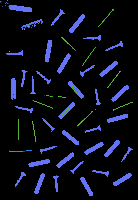

Without contours number:  3581


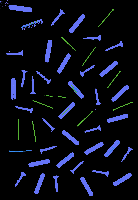

Without contours number:  3582


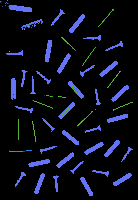

Without contours number:  3583


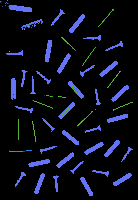

Without contours number:  3584


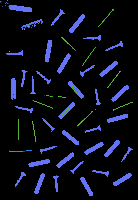

Without contours number:  3585


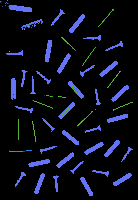

Without contours number:  3586


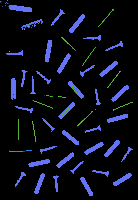

Without contours number:  3587


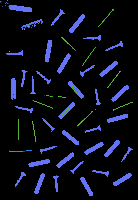

Without contours number:  3588


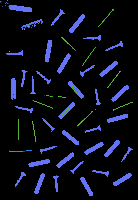

Without contours number:  3589


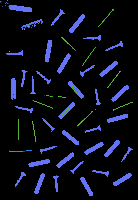

Without contours number:  3590


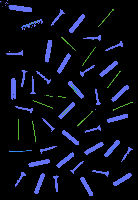

Without contours number:  3591


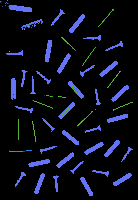

Without contours number:  3592


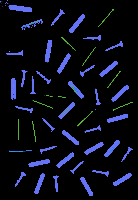

Without contours number:  3593


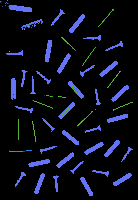

Without contours number:  3594


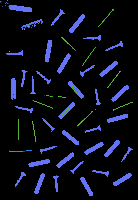

Without contours number:  3595


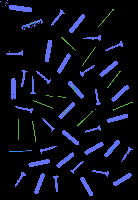

Without contours number:  3597


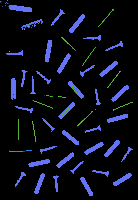

Without contours number:  3598


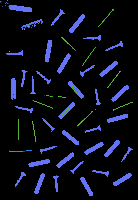

Without contours number:  3599


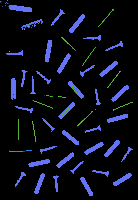

Without contours number:  3600


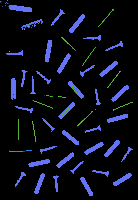

Without contours number:  3603


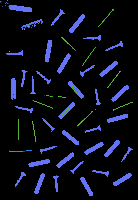

Without contours number:  3604


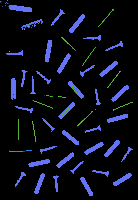

Without contours number:  3605


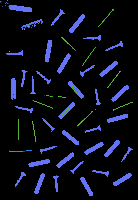

Without contours number:  3606


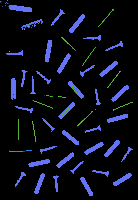

Without contours number:  3607


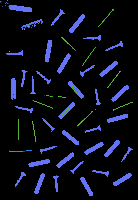

Without contours number:  3608


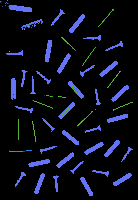

Without contours number:  3609


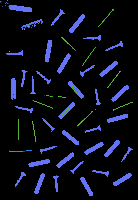

Without contours number:  3610


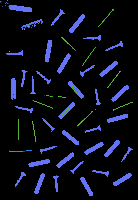

Without contours number:  3611


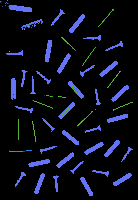

Without contours number:  3612


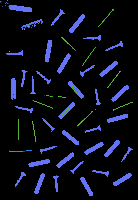

Without contours number:  3613


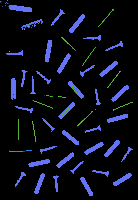

Without contours number:  3614


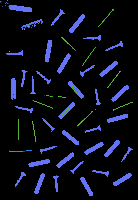

Without contours number:  3615


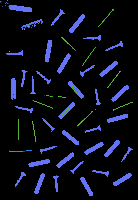

Without contours number:  3616


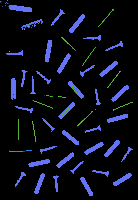

Without contours number:  3617


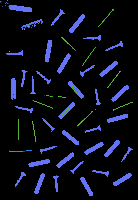

Without contours number:  3619


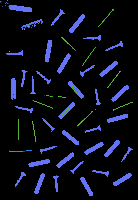

Without contours number:  3620


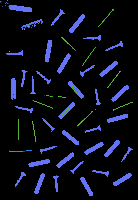

Without contours number:  3621


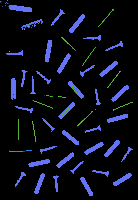

Without contours number:  3622


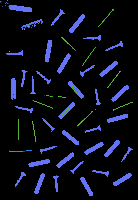

Without contours number:  3623


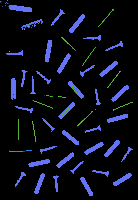

Without contours number:  3624


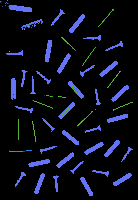

Without contours number:  3625


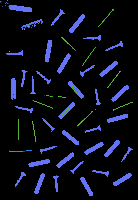

Without contours number:  3626


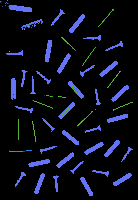

Without contours number:  3627


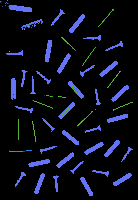

Without contours number:  3628


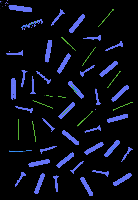

Without contours number:  3629


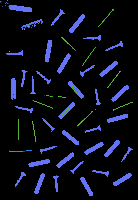

Without contours number:  3630


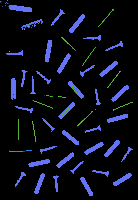

Without contours number:  3631


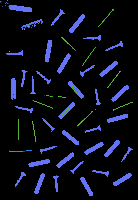

Without contours number:  3632


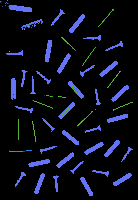

Without contours number:  3633


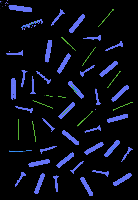

Without contours number:  3634


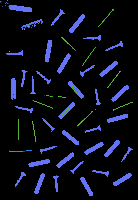

Without contours number:  3635


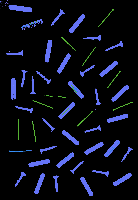

Without contours number:  3636


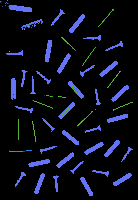

Without contours number:  3637


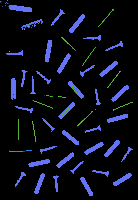

Without contours number:  3638


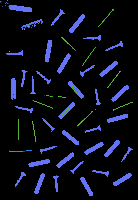

Without contours number:  3639


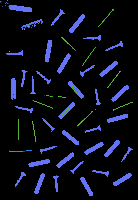

Without contours number:  3640


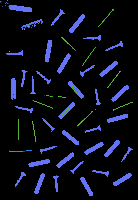

Without contours number:  3641


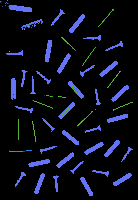

Without contours number:  3642


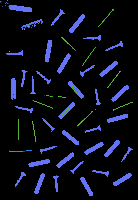

Without contours number:  3643


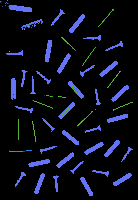

Without contours number:  3644


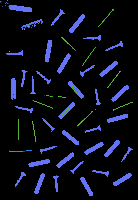

Without contours number:  3645


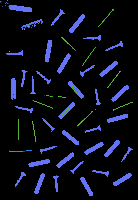

Without contours number:  3646


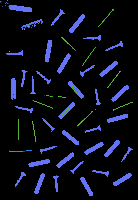

Without contours number:  3648


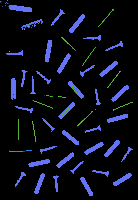

Without contours number:  3650


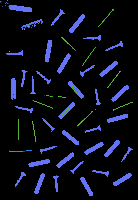

Without contours number:  3652


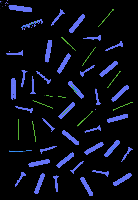

Without contours number:  3653


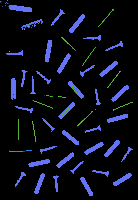

Without contours number:  3654


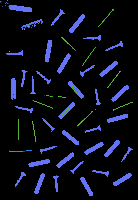

Without contours number:  3655


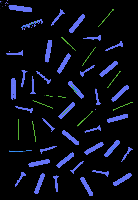

Without contours number:  3656


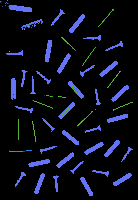

Without contours number:  3657


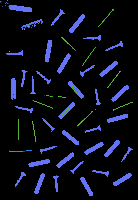

Without contours number:  3659


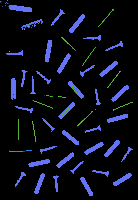

Without contours number:  3660


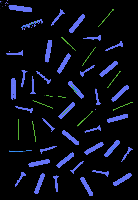

Without contours number:  3661


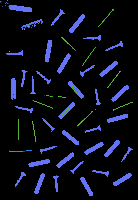

Without contours number:  3662


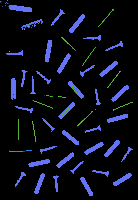

Without contours number:  3663


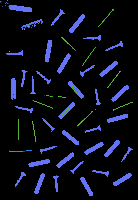

Without contours number:  3664


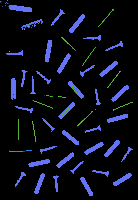

Without contours number:  3665


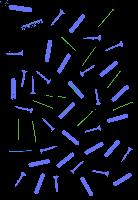

Without contours number:  3666


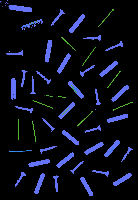

Without contours number:  3667


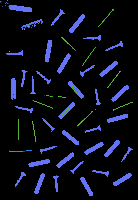

Without contours number:  3668


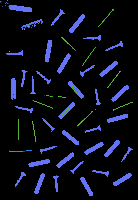

Without contours number:  3669


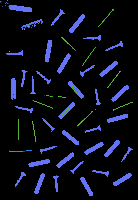

Without contours number:  3670


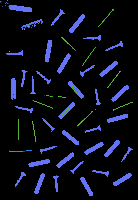

Without contours number:  3671


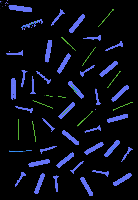

Without contours number:  3672


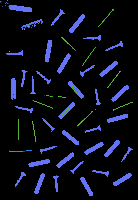

Without contours number:  3673


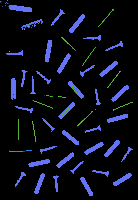

Without contours number:  3674


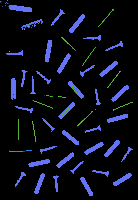

Without contours number:  3675


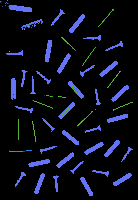

Without contours number:  3676


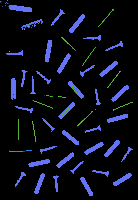

Without contours number:  3677


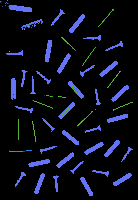

Without contours number:  3678


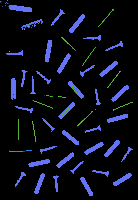

Without contours number:  3679


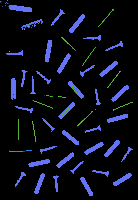

Without contours number:  3680


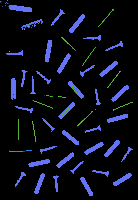

Without contours number:  3681


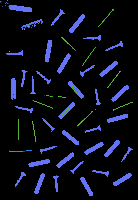

Without contours number:  3682


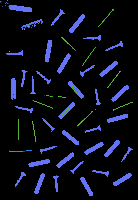

Without contours number:  3683


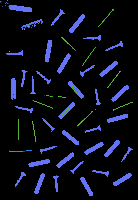

Without contours number:  3684


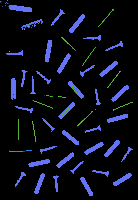

Without contours number:  3685


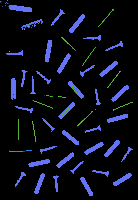

Without contours number:  3686


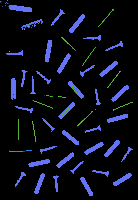

Without contours number:  3687


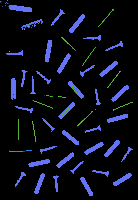

Without contours number:  3688


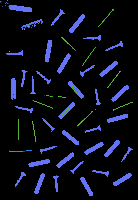

Without contours number:  3689


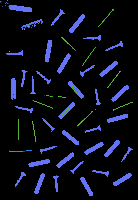

Without contours number:  3690


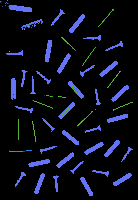

Without contours number:  3691


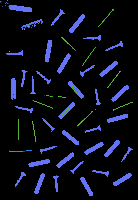

Without contours number:  3692


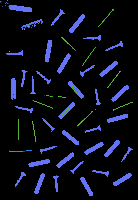

Without contours number:  3693


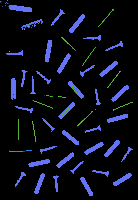

Without contours number:  3694


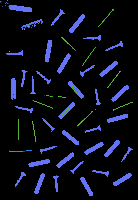

Without contours number:  3695


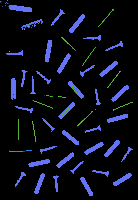

Without contours number:  3696


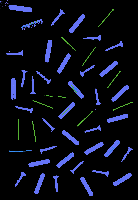

Without contours number:  3697


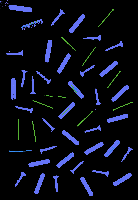

Without contours number:  3698


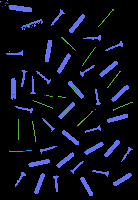

Without contours number:  3699


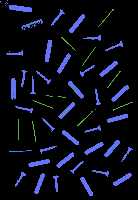

Without contours number:  3700


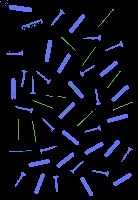

Without contours number:  3701


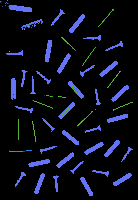

Without contours number:  3702


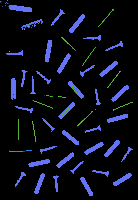

Without contours number:  3703


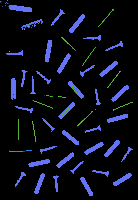

Without contours number:  3704


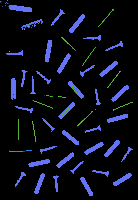

Without contours number:  3705


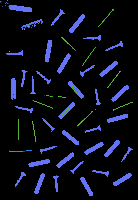

Without contours number:  3706


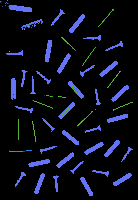

Without contours number:  3707


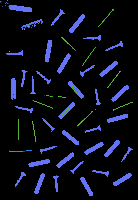

Without contours number:  3708


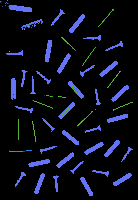

Without contours number:  3709


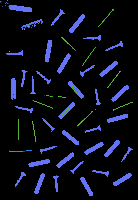

Without contours number:  3710


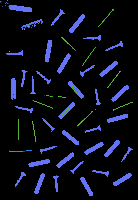

Without contours number:  3711


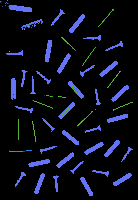

Without contours number:  3712


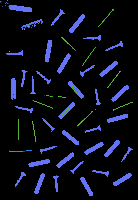

Without contours number:  3713


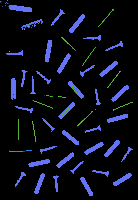

Without contours number:  3714


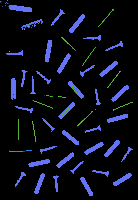

Without contours number:  3715


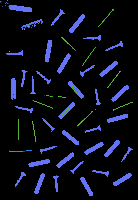

Without contours number:  3716


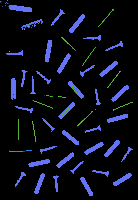

Without contours number:  3717


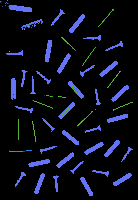

Without contours number:  3718


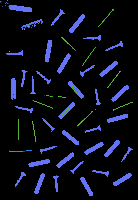

Without contours number:  3719


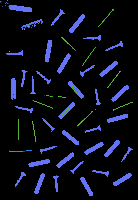

Without contours number:  3720


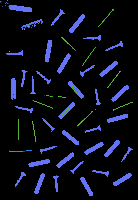

Without contours number:  3721


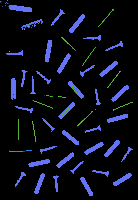

Without contours number:  3722


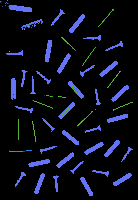

Without contours number:  3723


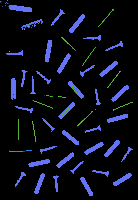

Without contours number:  3724


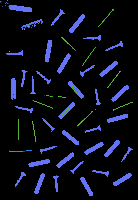

Without contours number:  3725


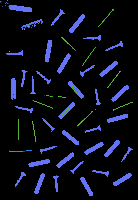

Without contours number:  3726


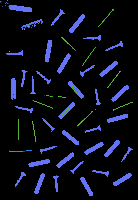

Without contours number:  3727


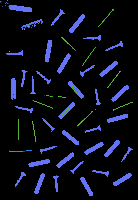

Without contours number:  3728


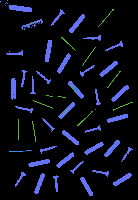

Without contours number:  3729


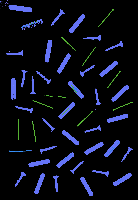

Without contours number:  3730


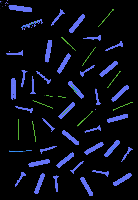

Without contours number:  3731


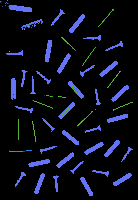

Without contours number:  3732


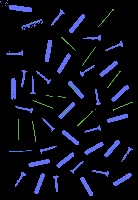

Without contours number:  3733


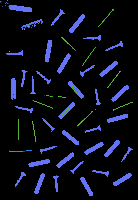

Without contours number:  3735


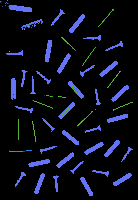

Without contours number:  3736


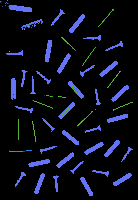

Without contours number:  3737


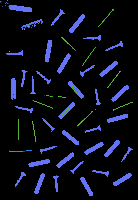

Without contours number:  3738


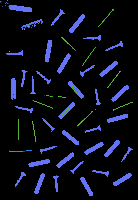

Without contours number:  3739


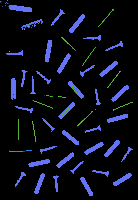

Without contours number:  3740


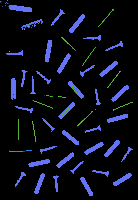

Without contours number:  3741


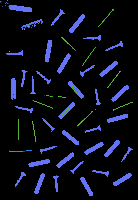

Without contours number:  3742


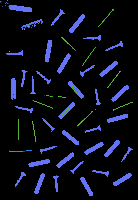

Without contours number:  3743


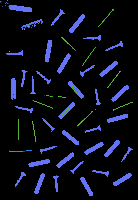

Without contours number:  3744


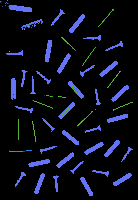

Without contours number:  3745


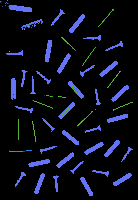

Without contours number:  3746


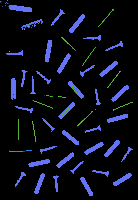

Without contours number:  3748


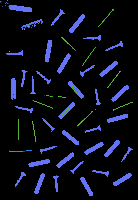

Without contours number:  3749


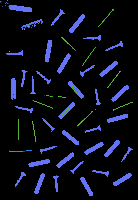

Without contours number:  3750


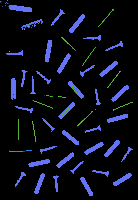

Without contours number:  3751


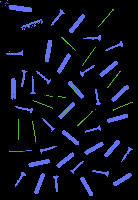

Without contours number:  3752


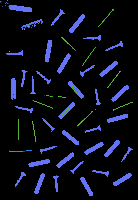

Without contours number:  3753


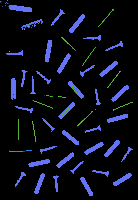

Without contours number:  3754


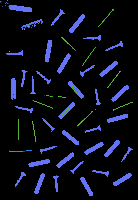

Without contours number:  3755


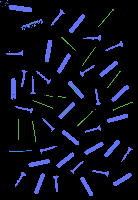

Without contours number:  3756


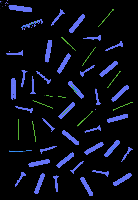

Without contours number:  3757


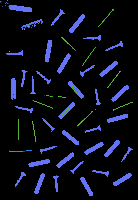

Without contours number:  3758


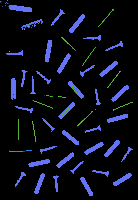

Without contours number:  3759


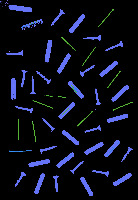

Without contours number:  3760


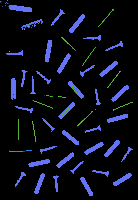

Without contours number:  3761


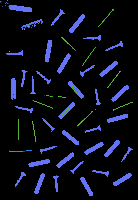

Without contours number:  3762


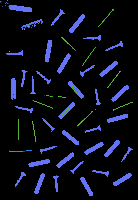

Without contours number:  3764


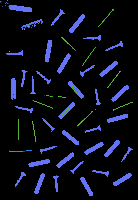

Without contours number:  3765


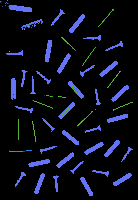

Without contours number:  3766


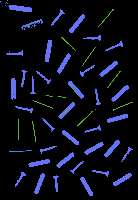

Without contours number:  3767


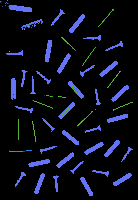

Without contours number:  3768


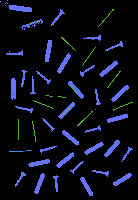

Without contours number:  3769


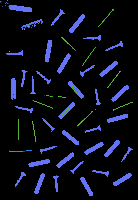

Without contours number:  3770


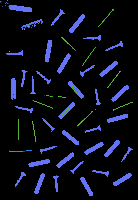

Without contours number:  3771


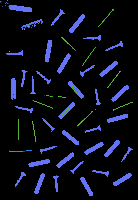

Without contours number:  3772


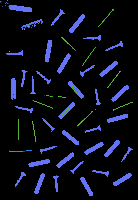

Without contours number:  3773


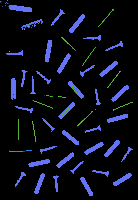

Without contours number:  3774


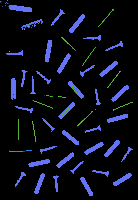

Without contours number:  3775


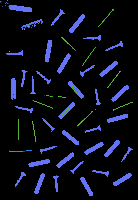

Without contours number:  3776


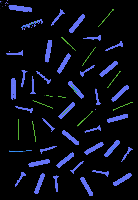

Without contours number:  3777


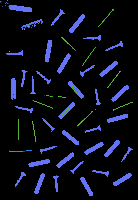

Without contours number:  3778


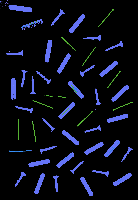

Without contours number:  3779


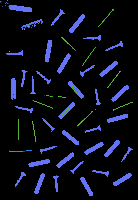

Without contours number:  3780


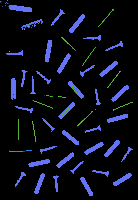

Without contours number:  3781


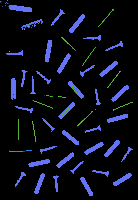

Without contours number:  3782


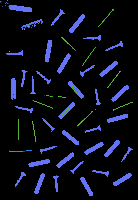

Without contours number:  3783


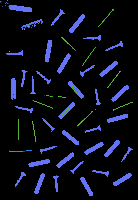

Without contours number:  3784


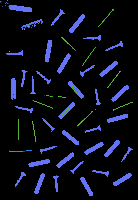

Without contours number:  3785


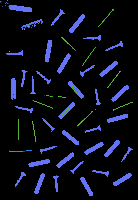

Without contours number:  3786


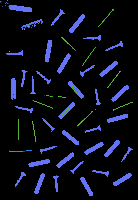

Without contours number:  3787


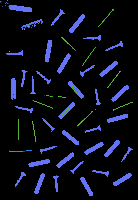

Without contours number:  3788


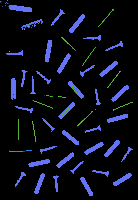

Without contours number:  3789


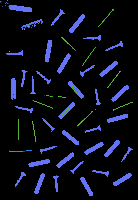

Without contours number:  3790


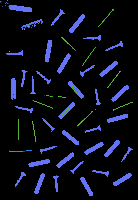

Without contours number:  3791


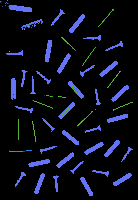

Without contours number:  3792


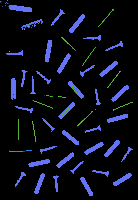

Without contours number:  3793


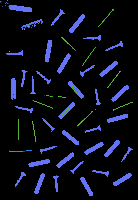

Without contours number:  3794


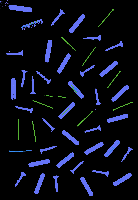

Without contours number:  3795


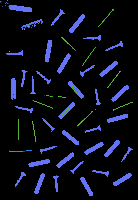

Without contours number:  3796


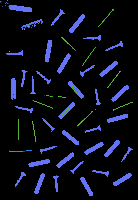

Without contours number:  3797


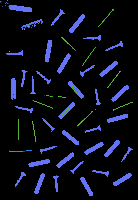

Without contours number:  3798


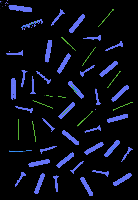

Without contours number:  3799


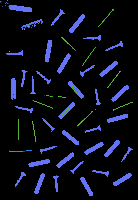

Without contours number:  3800


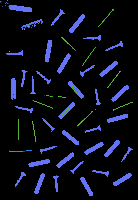

Without contours number:  3801


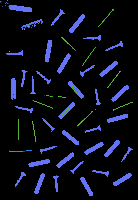

Without contours number:  3802


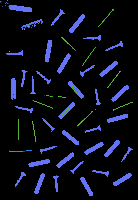

Without contours number:  3803


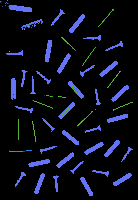

Without contours number:  3804


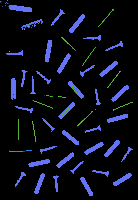

Without contours number:  3805


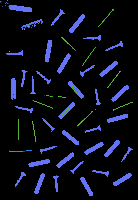

Without contours number:  3806


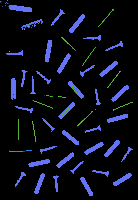

Without contours number:  3807


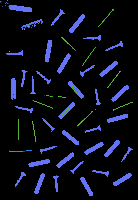

Without contours number:  3808


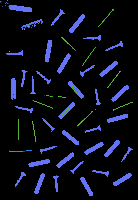

Without contours number:  3809


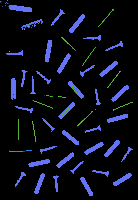

Without contours number:  3810


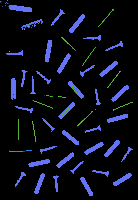

Without contours number:  3811


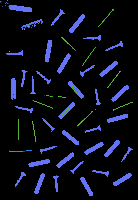

Without contours number:  3812


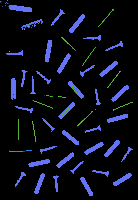

Without contours number:  3813


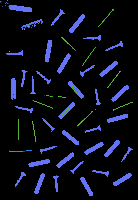

Without contours number:  3814


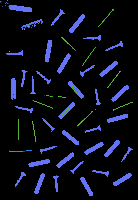

Without contours number:  3815


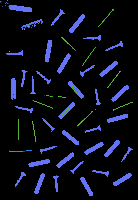

Without contours number:  3816


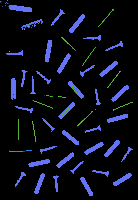

Without contours number:  3817


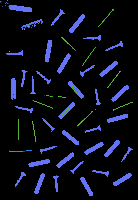

Without contours number:  3818


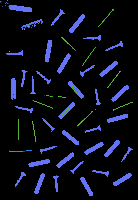

Without contours number:  3819


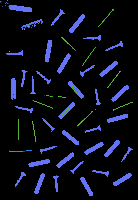

Without contours number:  3820


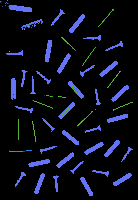

Without contours number:  3821


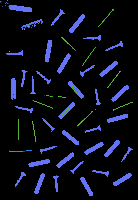

Without contours number:  3822


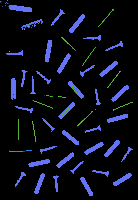

Without contours number:  3823


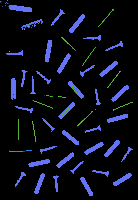

Without contours number:  3824


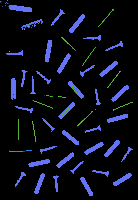

Without contours number:  3825


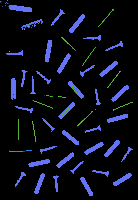

Without contours number:  3826


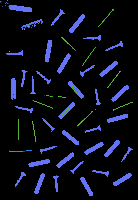

Without contours number:  3827


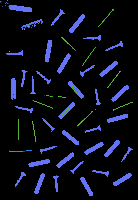

Without contours number:  3828


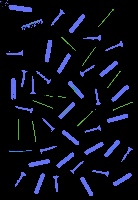

Without contours number:  3829


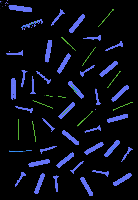

Without contours number:  3830


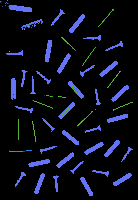

Without contours number:  3831


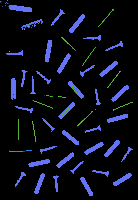

Without contours number:  3832


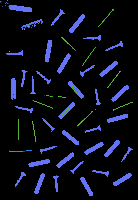

Without contours number:  3833


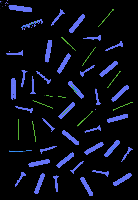

Without contours number:  3834


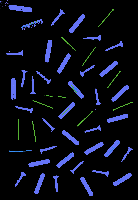

Without contours number:  3836


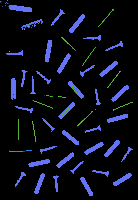

Without contours number:  3837


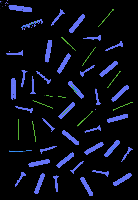

Without contours number:  3838


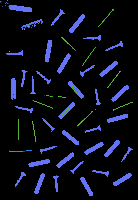

Without contours number:  3839


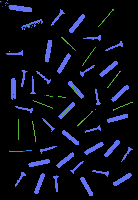

Without contours number:  3840


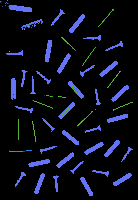

Without contours number:  3841


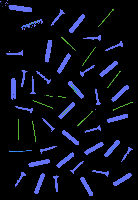

Without contours number:  3842


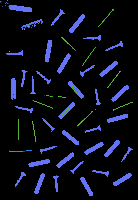

Without contours number:  3843


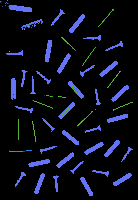

Without contours number:  3844


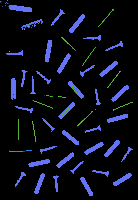

Without contours number:  3845


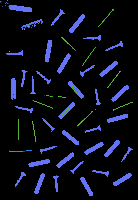

Without contours number:  3846


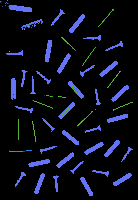

Without contours number:  3847


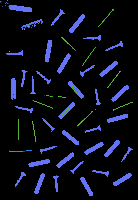

Without contours number:  3848


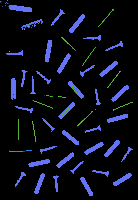

Without contours number:  3849


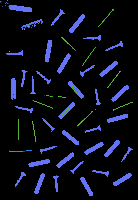

Without contours number:  3850


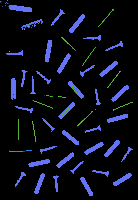

Without contours number:  3851


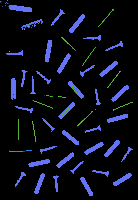

Without contours number:  3852


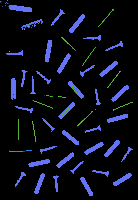

Without contours number:  3853


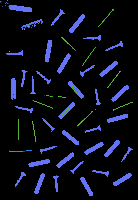

Without contours number:  3854


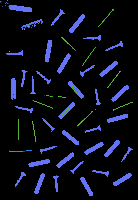

Without contours number:  3855


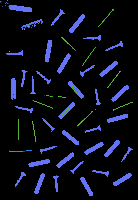

Without contours number:  3856


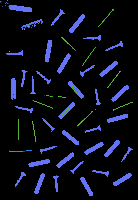

Without contours number:  3857


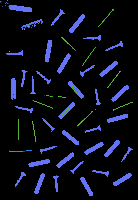

Without contours number:  3858


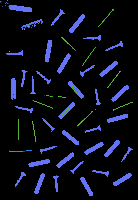

Without contours number:  3860


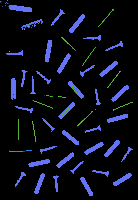

Without contours number:  3861


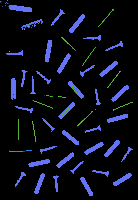

Without contours number:  3862


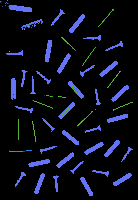

Without contours number:  3863


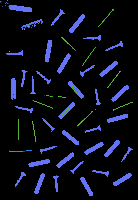

Without contours number:  3864


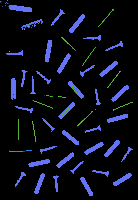

Without contours number:  3865


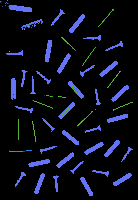

Without contours number:  3866


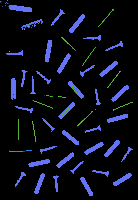

Without contours number:  3867


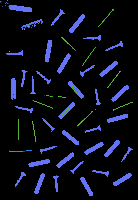

Without contours number:  3868


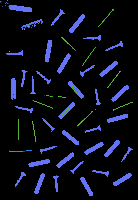

Without contours number:  3869


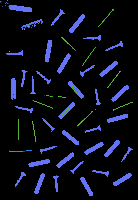

Without contours number:  3870


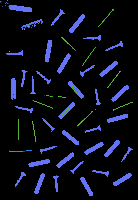

Without contours number:  3871


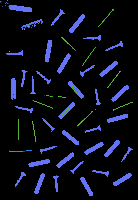

Without contours number:  3872


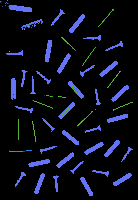

Without contours number:  3873


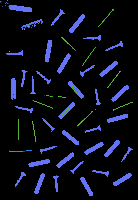

Without contours number:  3874


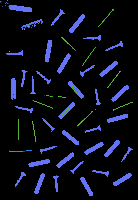

Without contours number:  3875


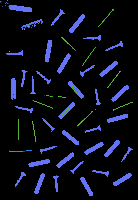

Without contours number:  3876


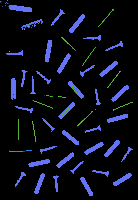

Without contours number:  3877


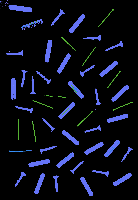

Without contours number:  3878


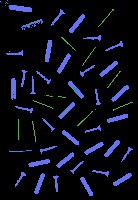

Without contours number:  3879


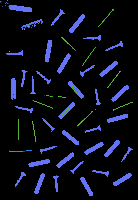

Without contours number:  3880


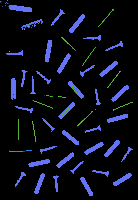

Without contours number:  3881


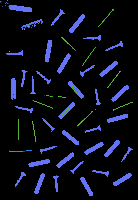

Without contours number:  3882


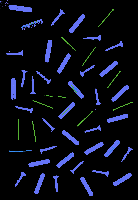

Without contours number:  3883


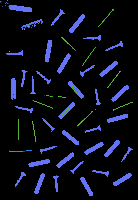

Without contours number:  3884


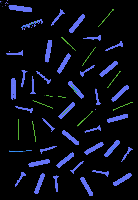

Without contours number:  3885


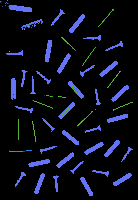

Without contours number:  3886


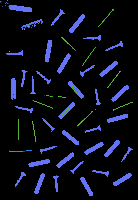

Without contours number:  3887


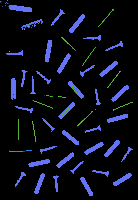

Without contours number:  3888


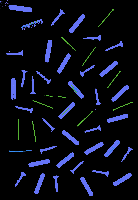

Without contours number:  3889


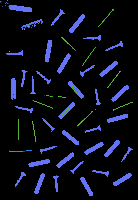

Without contours number:  3890


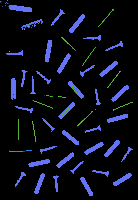

Without contours number:  3891


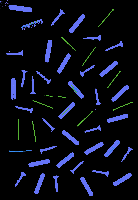

Without contours number:  3892


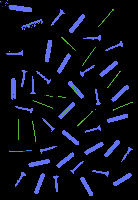

Without contours number:  3893


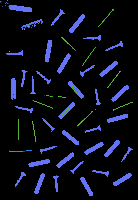

Without contours number:  3894


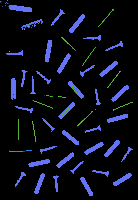

Without contours number:  3895


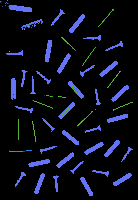

Without contours number:  3896


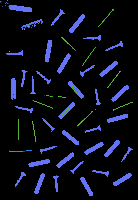

Without contours number:  3897


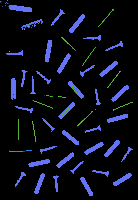

Without contours number:  3898


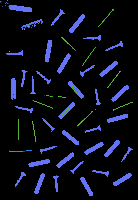

Without contours number:  3899


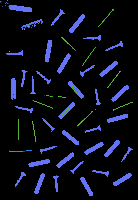

Without contours number:  3900


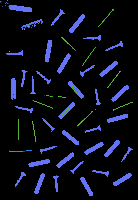

Without contours number:  3901


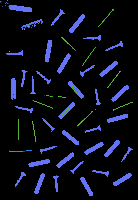

Without contours number:  3902


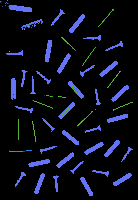

Without contours number:  3903


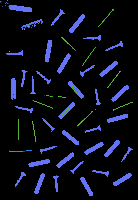

Without contours number:  3904


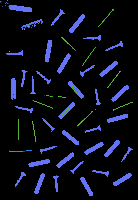

Without contours number:  3905


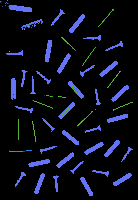

Without contours number:  3906


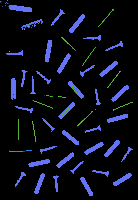

Without contours number:  3907


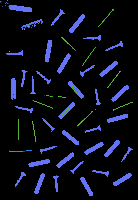

Without contours number:  3908


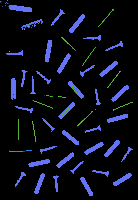

Without contours number:  3909


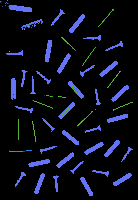

Without contours number:  3910


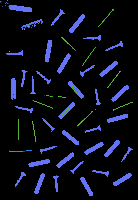

Without contours number:  3911


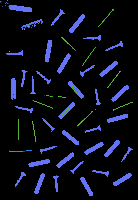

Without contours number:  3912


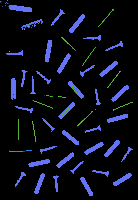

Without contours number:  3913


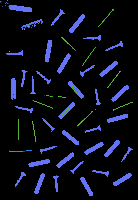

Without contours number:  3914


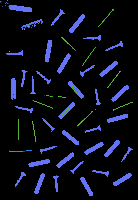

Without contours number:  3915


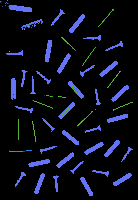

Without contours number:  3916


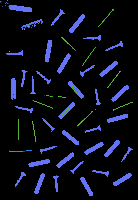

Without contours number:  3917


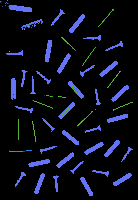

Without contours number:  3918


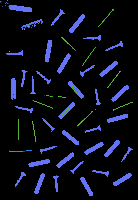

Without contours number:  3919


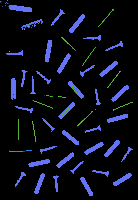

Without contours number:  3920


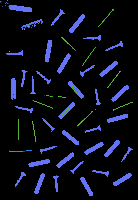

Without contours number:  3921


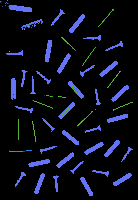

Without contours number:  3922


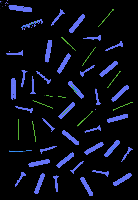

Without contours number:  3923


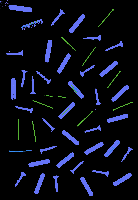

Without contours number:  3924


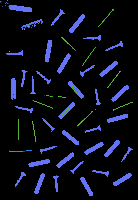

Without contours number:  3925


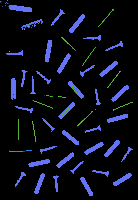

Without contours number:  3926


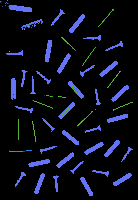

Without contours number:  3927


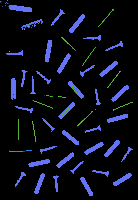

Without contours number:  3928


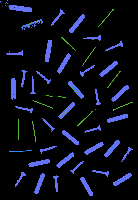

Without contours number:  3929


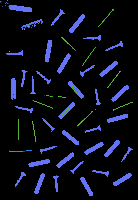

Without contours number:  3930


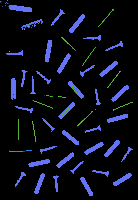

Without contours number:  3931


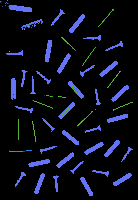

Without contours number:  3932


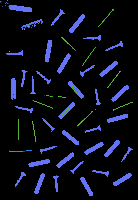

Without contours number:  3933


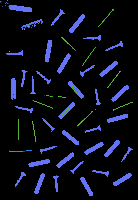

Without contours number:  3934


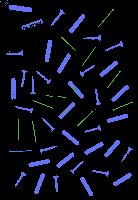

Without contours number:  3935


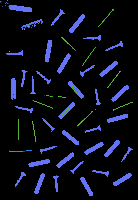

Without contours number:  3936


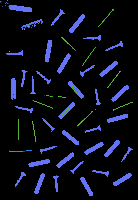

Without contours number:  3937


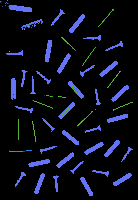

Without contours number:  3938


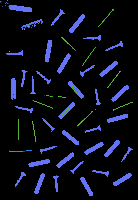

Without contours number:  3939


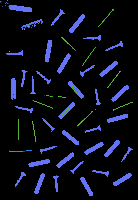

Without contours number:  3940


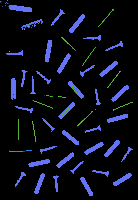

Without contours number:  3941


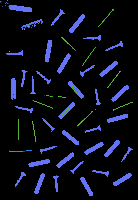

Without contours number:  3942


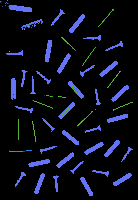

Without contours number:  3943


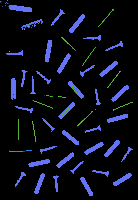

Without contours number:  3944


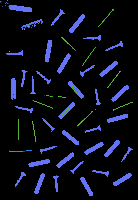

Without contours number:  3945


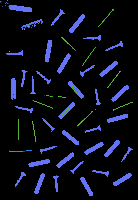

Without contours number:  3946


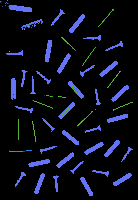

Without contours number:  3947


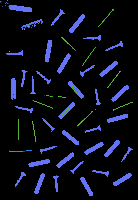

Without contours number:  3948


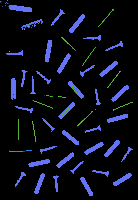

Without contours number:  3949


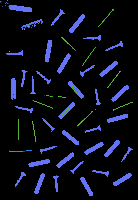

Without contours number:  3950


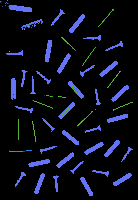

Without contours number:  3951


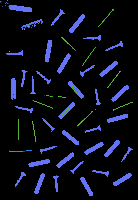

Without contours number:  3952


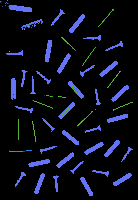

Without contours number:  3953


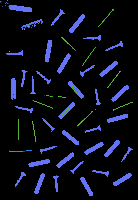

Without contours number:  3954


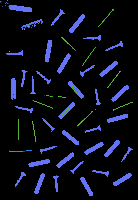

Without contours number:  3955


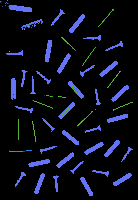

Without contours number:  3956


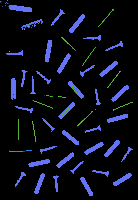

Without contours number:  3957


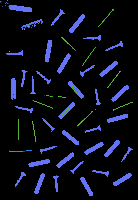

Without contours number:  3958


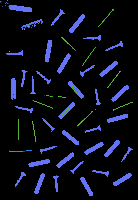

Without contours number:  3959


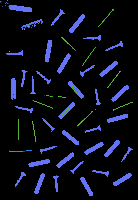

Without contours number:  3960


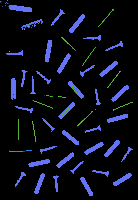

Without contours number:  3961


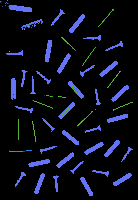

Without contours number:  3962


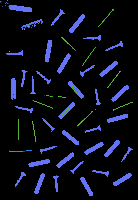

Without contours number:  3963


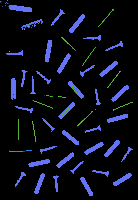

Without contours number:  3964


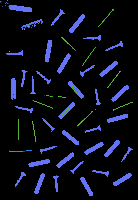

Without contours number:  3965


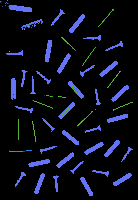

Without contours number:  3966


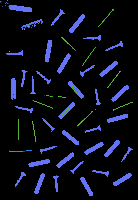

Without contours number:  3967


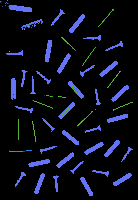

Without contours number:  3968


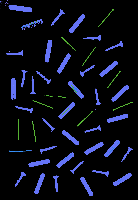

Without contours number:  3969


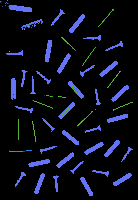

Without contours number:  3970


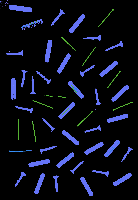

Without contours number:  3971


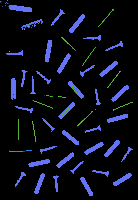

Without contours number:  3972


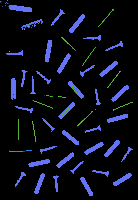

Without contours number:  3973


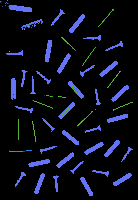

Without contours number:  3974


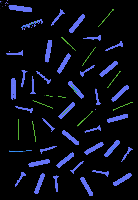

Without contours number:  3975


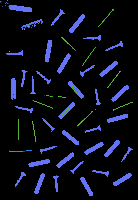

Without contours number:  3976


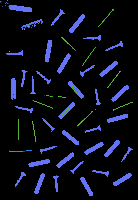

Without contours number:  3977


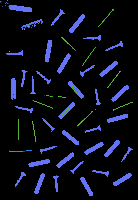

Without contours number:  3978


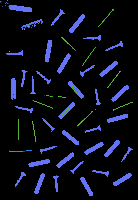

Without contours number:  3979


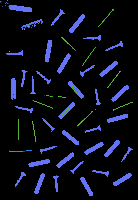

Without contours number:  3980


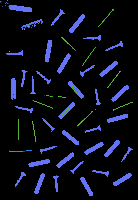

Without contours number:  3981


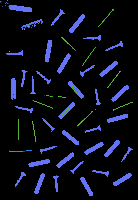

Without contours number:  3982


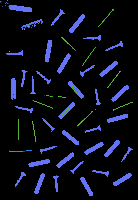

Without contours number:  3983


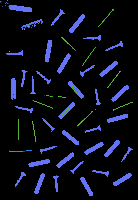

Without contours number:  3984


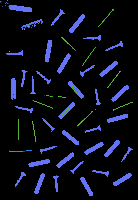

Without contours number:  3985


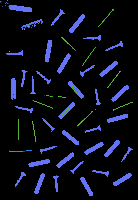

Without contours number:  3986


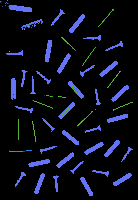

Without contours number:  3987


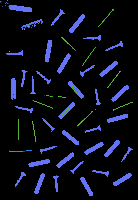

Without contours number:  3988


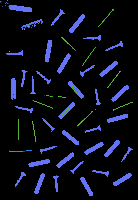

Without contours number:  3989


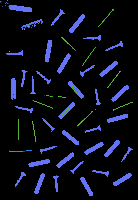

Without contours number:  3990


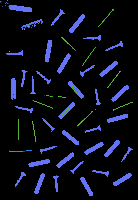

Without contours number:  3991


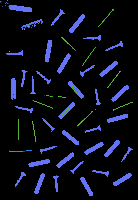

Without contours number:  3992


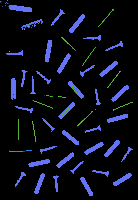

Without contours number:  3993


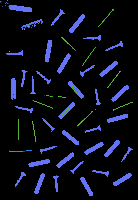

Without contours number:  3994


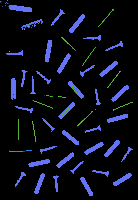

Without contours number:  3995


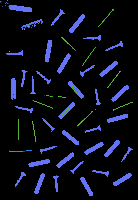

Without contours number:  3996


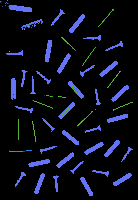

Without contours number:  3997


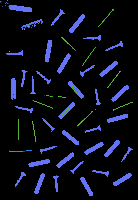

Without contours number:  3998


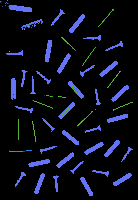

Without contours number:  3999


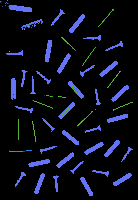

Without contours number:  4000


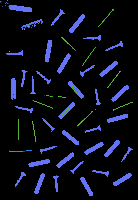

Without contours number:  4001


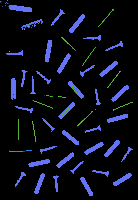

Without contours number:  4002


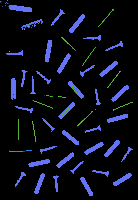

Without contours number:  4003


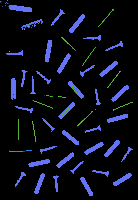

Without contours number:  4004


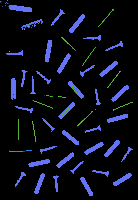

Without contours number:  4005


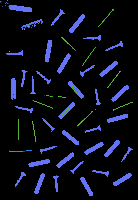

Without contours number:  4006


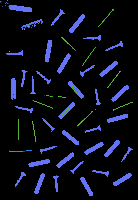

Without contours number:  4007


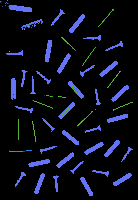

Without contours number:  4008


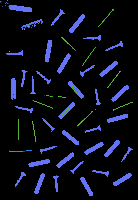

Without contours number:  4009


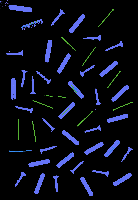

Without contours number:  4010


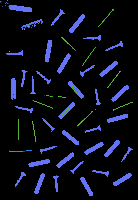

Without contours number:  4011


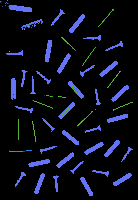

Without contours number:  4012


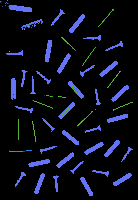

Without contours number:  4013


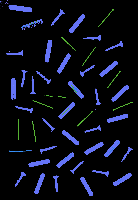

Without contours number:  4014


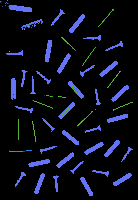

Without contours number:  4015


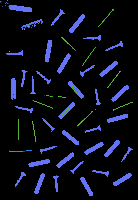

Without contours number:  4016


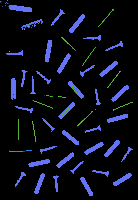

Without contours number:  4017


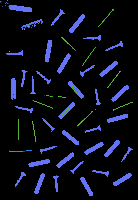

Without contours number:  4018


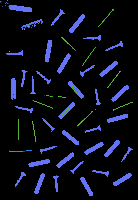

Without contours number:  4019


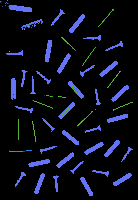

Without contours number:  4020


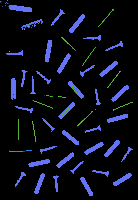

Without contours number:  4021


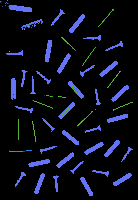

Without contours number:  4022


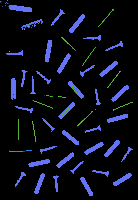

Without contours number:  4023


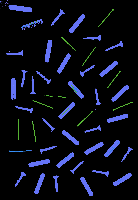

Without contours number:  4024


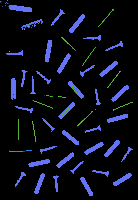

Without contours number:  4025


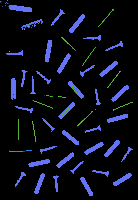

Without contours number:  4026


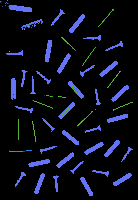

Without contours number:  4027


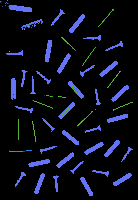

Without contours number:  4028


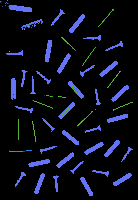

Without contours number:  4029


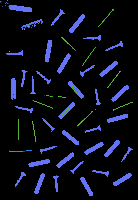

Without contours number:  4030


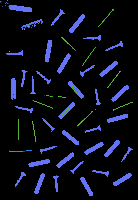

Without contours number:  4031


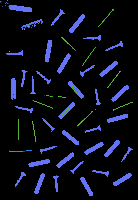

Without contours number:  4032


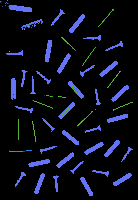

Without contours number:  4033


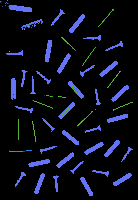

Without contours number:  4034


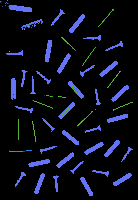

Without contours number:  4035


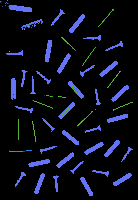

Without contours number:  4036


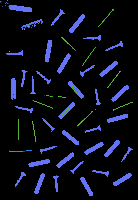

Without contours number:  4037


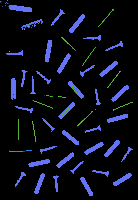

Without contours number:  4038


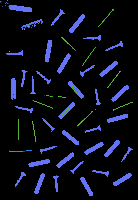

Without contours number:  4039


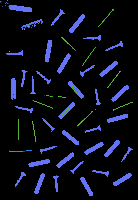

Without contours number:  4040


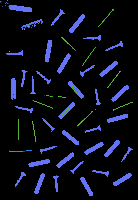

Without contours number:  4041


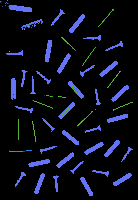

Without contours number:  4042


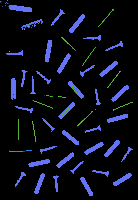

Without contours number:  4043


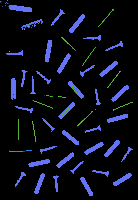

Without contours number:  4044


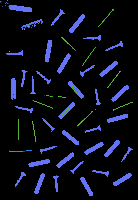

Without contours number:  4045


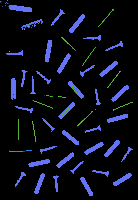

Without contours number:  4046


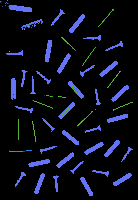

Without contours number:  4047


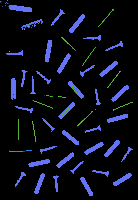

Without contours number:  4048


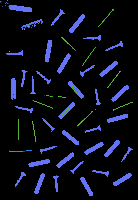

Without contours number:  4049


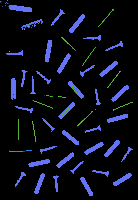

Without contours number:  4050


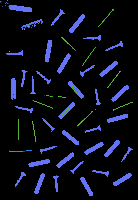

Without contours number:  4051


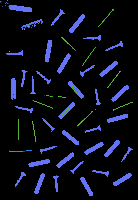

Without contours number:  4052


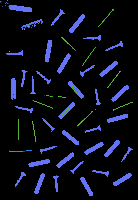

Without contours number:  4053


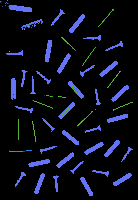

Without contours number:  4054


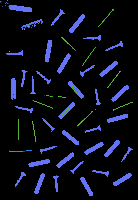

Without contours number:  4055


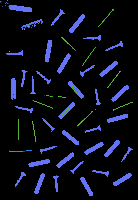

Without contours number:  4056


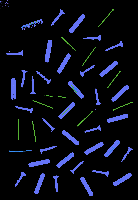

Without contours number:  4057


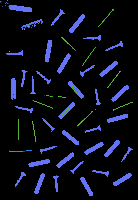

Without contours number:  4058


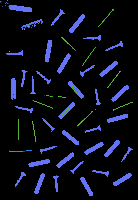

Without contours number:  4059


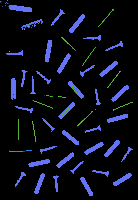

Without contours number:  4060


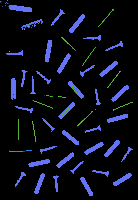

Without contours number:  4061


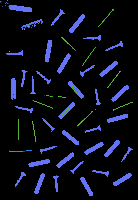

Without contours number:  4062


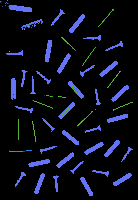

Without contours number:  4063


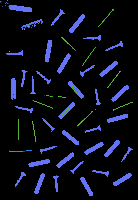

Without contours number:  4064


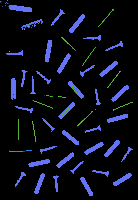

Without contours number:  4065


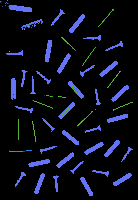

Without contours number:  4066


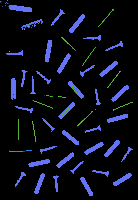

Without contours number:  4067


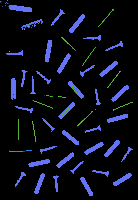

Without contours number:  4068


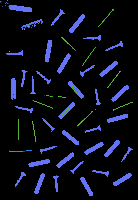

Without contours number:  4069


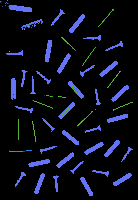

Without contours number:  4070


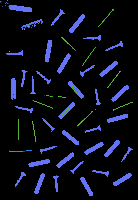

Without contours number:  4071


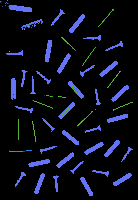

Without contours number:  4072


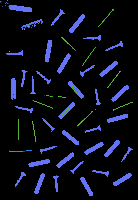

Without contours number:  4073


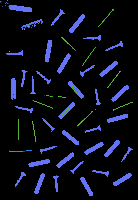

Without contours number:  4074


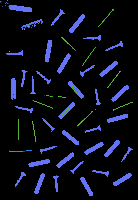

Without contours number:  4075


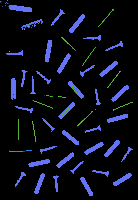

Without contours number:  4076


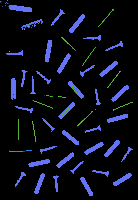

Without contours number:  4077


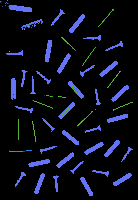

Without contours number:  4078


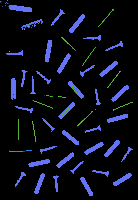

Without contours number:  4079


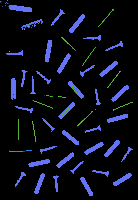

Without contours number:  4080


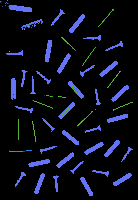

Without contours number:  4081


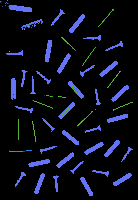

Without contours number:  4082


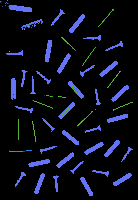

Without contours number:  4083


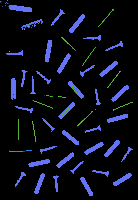

Without contours number:  4084


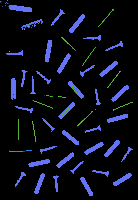

Without contours number:  4085


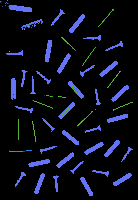

Without contours number:  4086


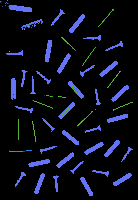

Without contours number:  4087


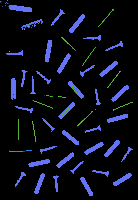

Without contours number:  4088


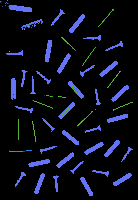

Without contours number:  4089


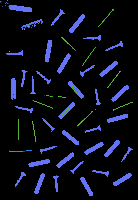

Without contours number:  4090


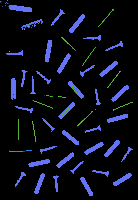

Without contours number:  4091


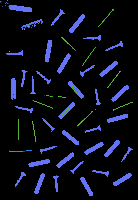

Without contours number:  4092


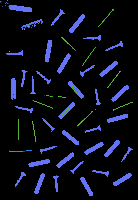

Without contours number:  4093


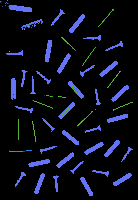

Without contours number:  4094


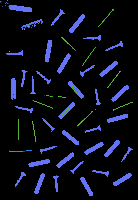

Without contours number:  4095


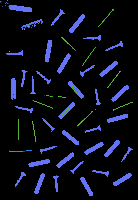

Without contours number:  4096


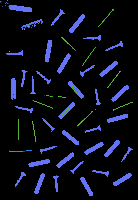

Without contours number:  4097


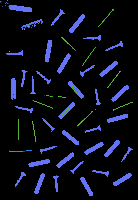

Without contours number:  4098


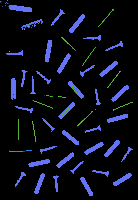

Without contours number:  4099


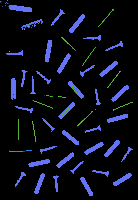

Without contours number:  4100


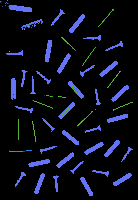

Without contours number:  4101


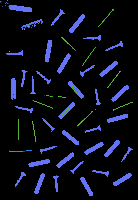

Without contours number:  4102


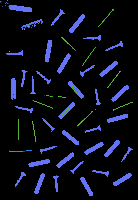

Without contours number:  4103


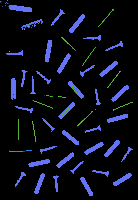

Without contours number:  4104


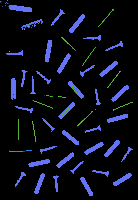

Without contours number:  4105


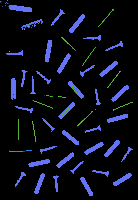

Without contours number:  4106


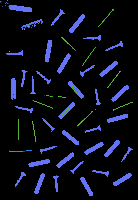

Without contours number:  4107


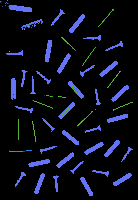

Without contours number:  4108


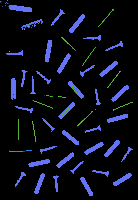

Without contours number:  4109


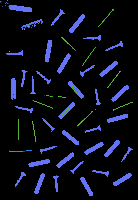

Without contours number:  4110


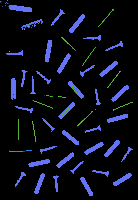

Without contours number:  4111


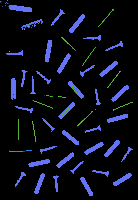

Without contours number:  4112


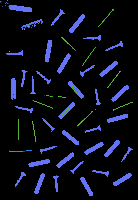

Without contours number:  4113


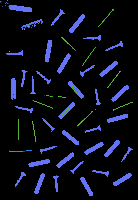

Without contours number:  4114


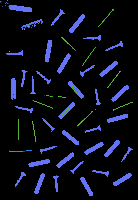

Without contours number:  4115


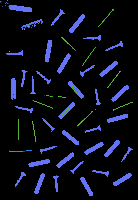

Without contours number:  4116


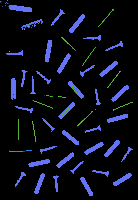

Without contours number:  4117


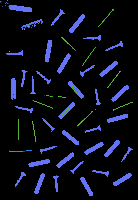

Without contours number:  4118


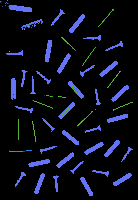

Without contours number:  4119


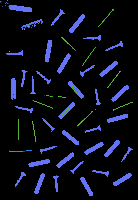

Without contours number:  4120


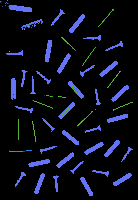

Without contours number:  4121


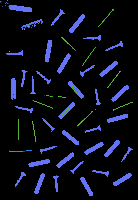

Without contours number:  4122


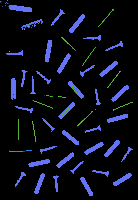

Without contours number:  4123


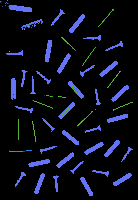

Without contours number:  4124


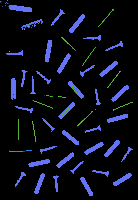

Without contours number:  4125


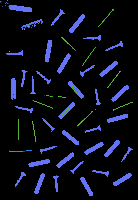

Without contours number:  4126


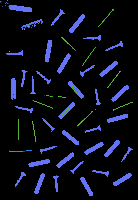

Without contours number:  4127


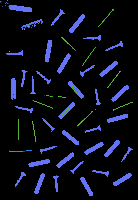

Without contours number:  4128


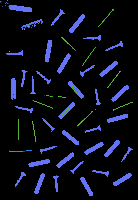

Without contours number:  4129


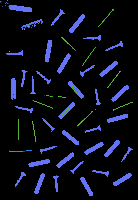

Without contours number:  4130


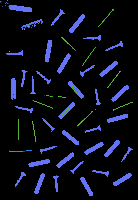

Without contours number:  4131


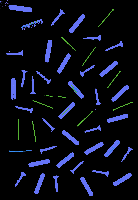

Without contours number:  4132


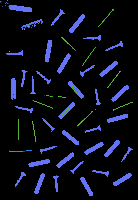

Without contours number:  4133


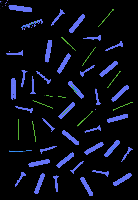

Without contours number:  4134


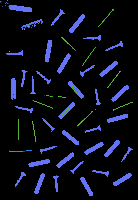

Without contours number:  4135


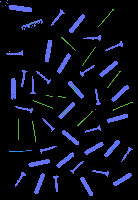

Without contours number:  4136


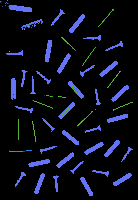

Without contours number:  4137


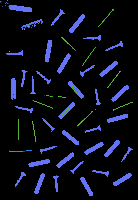

Without contours number:  4138


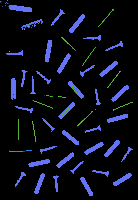

Without contours number:  4139


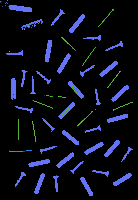

Without contours number:  4140


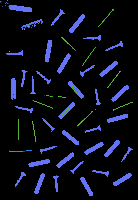

Without contours number:  4141


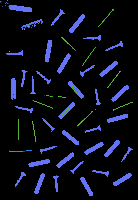

Without contours number:  4142


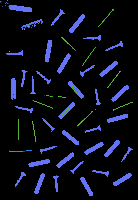

Without contours number:  4143


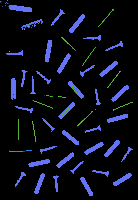

Without contours number:  4144


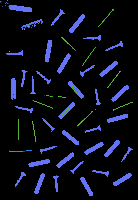

Without contours number:  4145


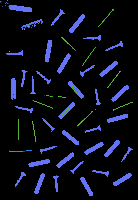

Without contours number:  4146


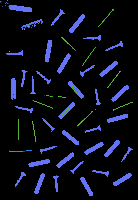

Without contours number:  4147


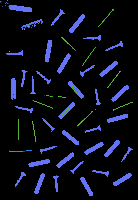

Without contours number:  4148


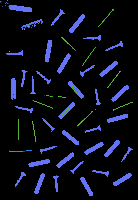

Without contours number:  4149


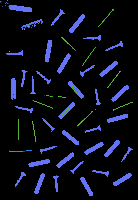

Without contours number:  4150


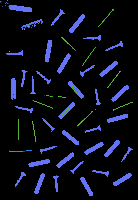

Without contours number:  4151


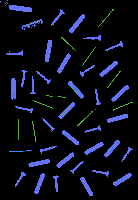

Without contours number:  4152


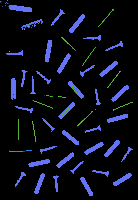

Without contours number:  4153


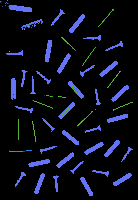

Without contours number:  4154


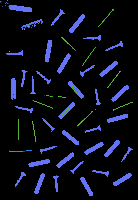

Without contours number:  4155


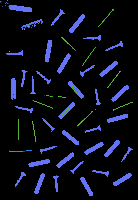

Without contours number:  4156


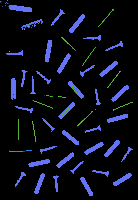

Without contours number:  4157


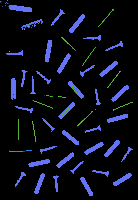

Without contours number:  4158


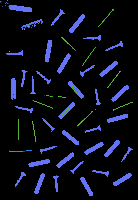

Without contours number:  4159


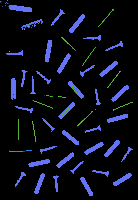

Without contours number:  4160


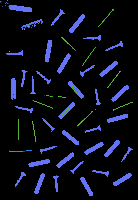

Without contours number:  4161


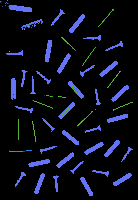

Without contours number:  4162


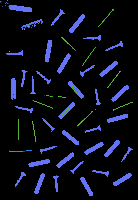

Without contours number:  4163


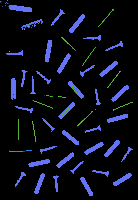

Without contours number:  4164


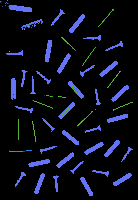

Without contours number:  4165


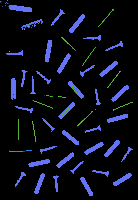

Without contours number:  4166


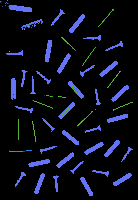

Without contours number:  4167


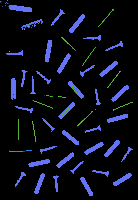

Without contours number:  4168


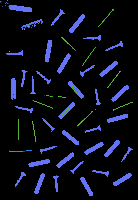

Without contours number:  4169


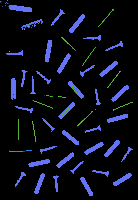

Without contours number:  4170


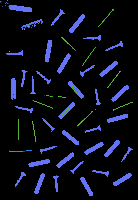

Without contours number:  4171


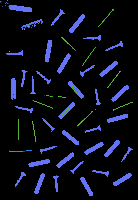

Without contours number:  4172


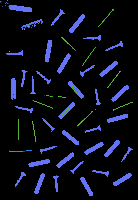

Without contours number:  4173


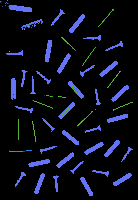

Without contours number:  4174


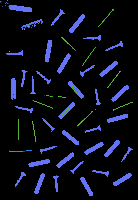

Without contours number:  4175


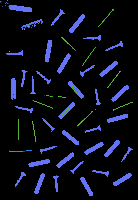

Without contours number:  4176


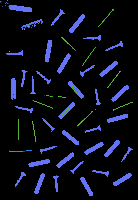

Without contours number:  4177


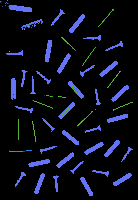

Without contours number:  4178


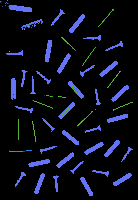

Without contours number:  4179


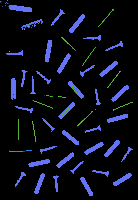

Without contours number:  4180


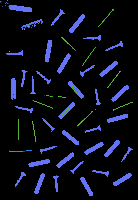

Without contours number:  4181


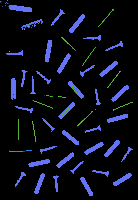

Without contours number:  4182


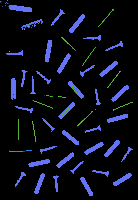

Without contours number:  4183


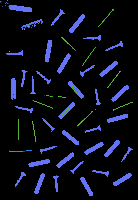

Without contours number:  4184


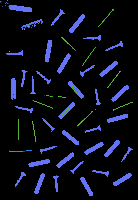

Without contours number:  4185


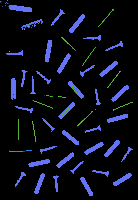

Without contours number:  4186


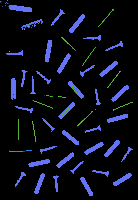

Without contours number:  4187


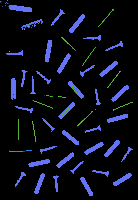

Without contours number:  4188


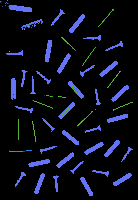

Without contours number:  4189


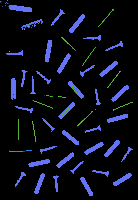

Without contours number:  4190


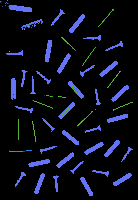

Without contours number:  4191


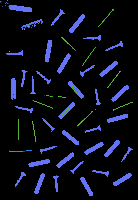

Without contours number:  4192


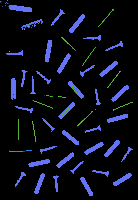

Without contours number:  4193


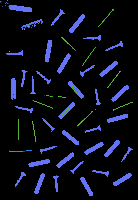

Without contours number:  4194


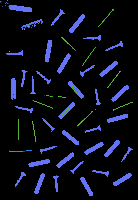

Without contours number:  4195


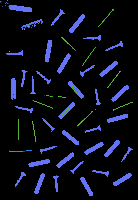

Without contours number:  4196


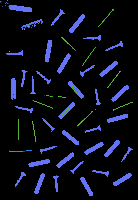

Without contours number:  4197


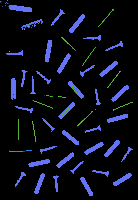

Without contours number:  4198


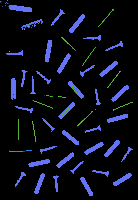

Without contours number:  4199


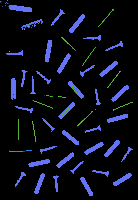

Without contours number:  4200


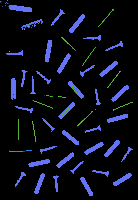

Without contours number:  4201


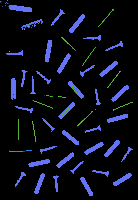

Without contours number:  4202


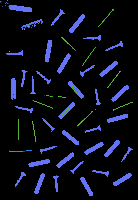

Without contours number:  4203


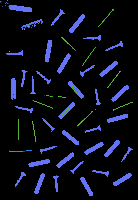

Without contours number:  4204


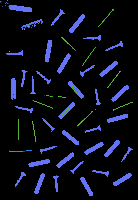

Without contours number:  4205


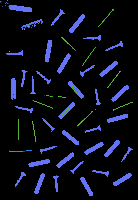

Without contours number:  4206


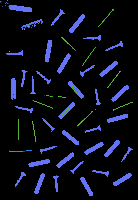

Without contours number:  4207


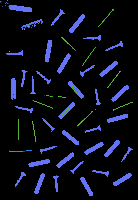

Without contours number:  4208


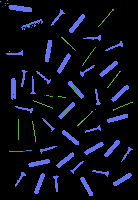

Without contours number:  4209


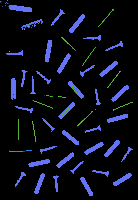

Without contours number:  4210


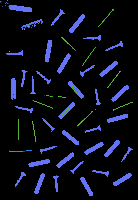

Without contours number:  4211


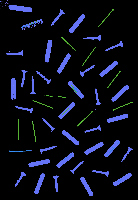

Without contours number:  4212


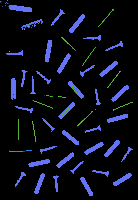

Without contours number:  4213


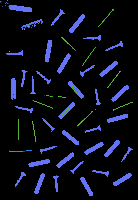

Without contours number:  4214


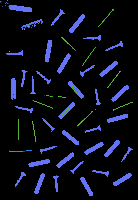

Without contours number:  4215


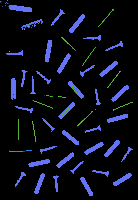

Without contours number:  4216


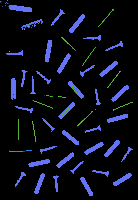

Without contours number:  4217


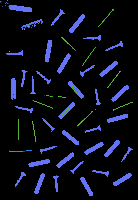

Without contours number:  4218


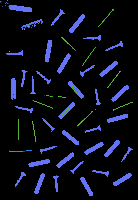

Without contours number:  4219


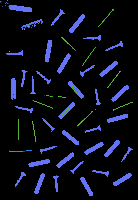

Without contours number:  4220


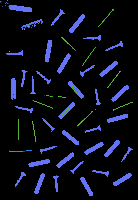

Without contours number:  4221


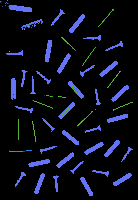

Without contours number:  4222


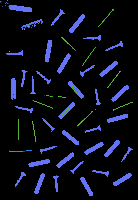

Without contours number:  4223


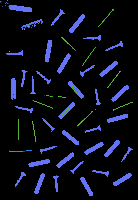

Without contours number:  4224


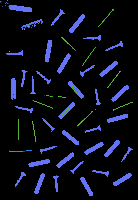

Without contours number:  4225


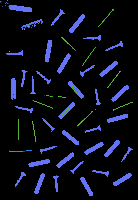

Without contours number:  4226


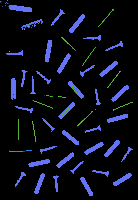

Without contours number:  4227


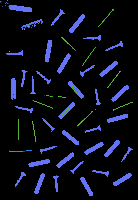

Without contours number:  4228


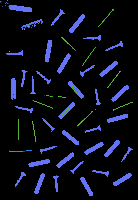

Without contours number:  4229


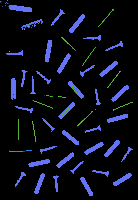

Without contours number:  4230


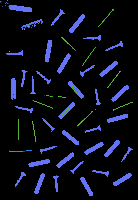

Without contours number:  4231


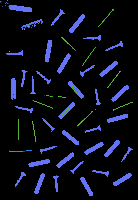

Without contours number:  4232


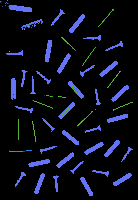

Without contours number:  4233


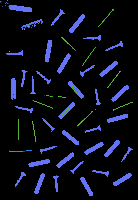

Without contours number:  4234


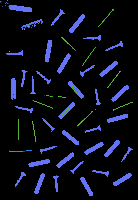

Without contours number:  4235


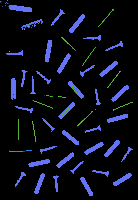

Without contours number:  4236


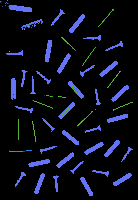

Without contours number:  4237


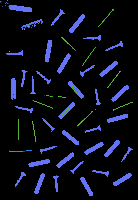

Without contours number:  4238


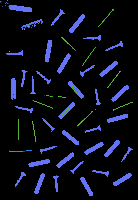

Without contours number:  4239


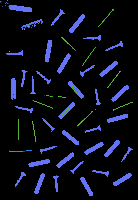

Without contours number:  4240


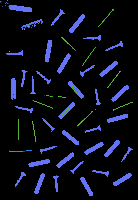

Without contours number:  4241


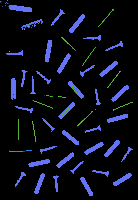

Without contours number:  4242


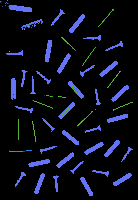

Without contours number:  4243


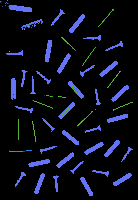

Without contours number:  4244


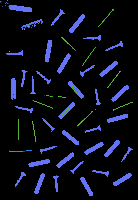

Without contours number:  4245


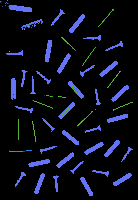

Without contours number:  4246


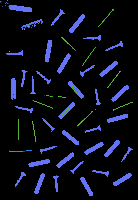

Without contours number:  4247


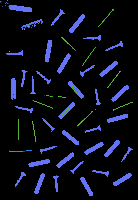

Without contours number:  4248


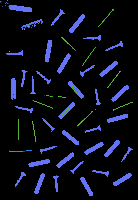

Without contours number:  4249


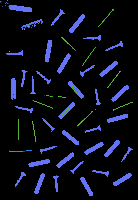

Without contours number:  4250


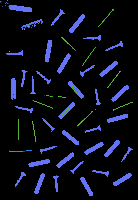

Without contours number:  4251


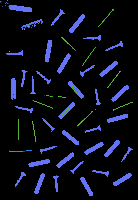

Without contours number:  4252


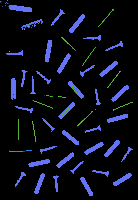

Without contours number:  4253


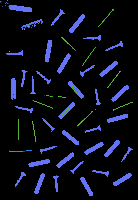

Without contours number:  4254


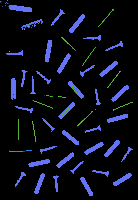

Without contours number:  4255


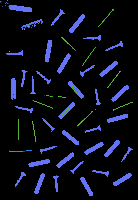

Without contours number:  4256


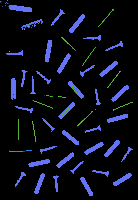

Without contours number:  4257


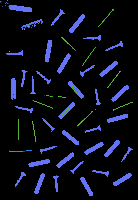

Without contours number:  4258


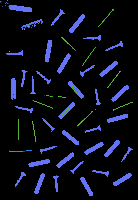

Without contours number:  4259


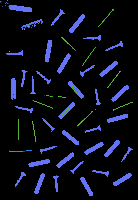

Without contours number:  4260


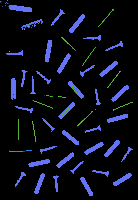

Without contours number:  4261


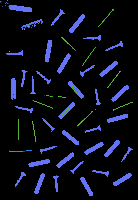

Without contours number:  4262


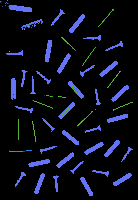

Without contours number:  4263


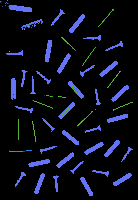

Without contours number:  4264


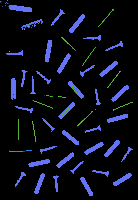

Without contours number:  4265


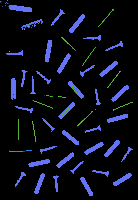

Without contours number:  4266


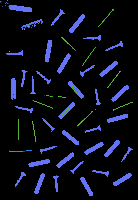

Without contours number:  4267


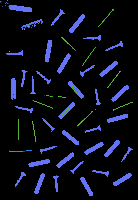

Without contours number:  4268


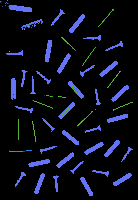

Without contours number:  4269


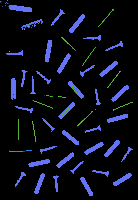

Without contours number:  4270


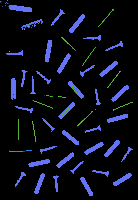

Without contours number:  4271


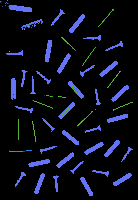

Without contours number:  4272


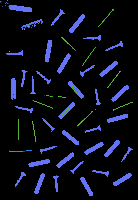

Without contours number:  4273


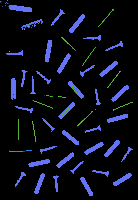

Without contours number:  4274


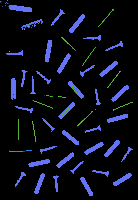

Without contours number:  4275


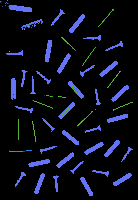

Without contours number:  4276


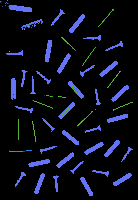

Without contours number:  4277


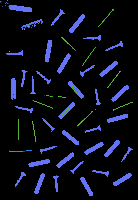

Without contours number:  4278


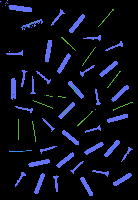

Without contours number:  4279


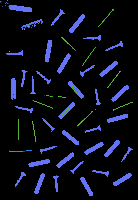

Without contours number:  4280


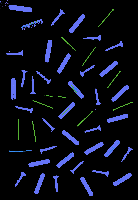

Without contours number:  4281


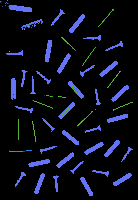

Without contours number:  4282


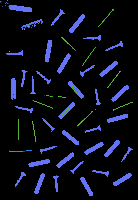

Without contours number:  4283


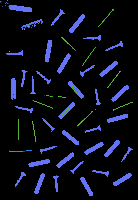

Without contours number:  4284


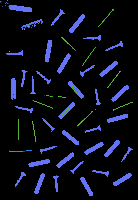

Without contours number:  4285


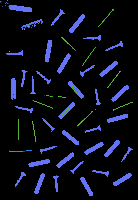

Without contours number:  4286


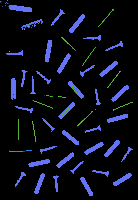

Without contours number:  4287


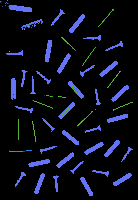

Without contours number:  4288


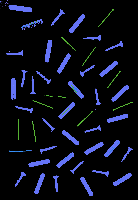

Without contours number:  4289


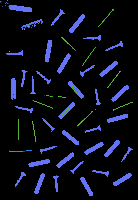

Without contours number:  4290


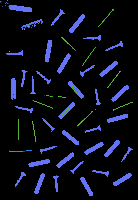

Without contours number:  4291


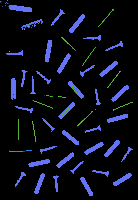

Without contours number:  4292


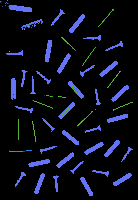

Without contours number:  4293


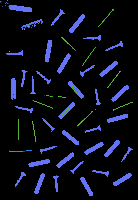

Without contours number:  4294


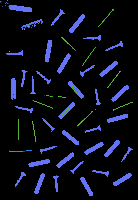

Without contours number:  4295


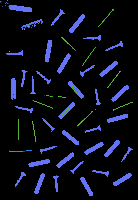

Without contours number:  4296


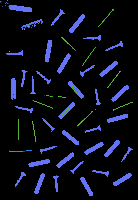

Without contours number:  4297


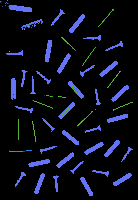

Without contours number:  4298


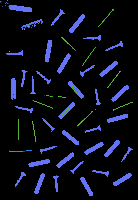

Without contours number:  4299


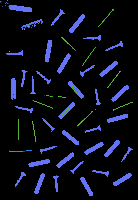

Without contours number:  4300


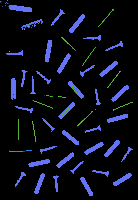

Without contours number:  4301


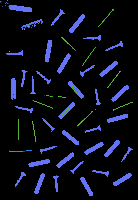

Without contours number:  4302


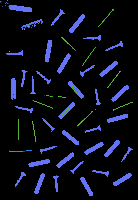

Without contours number:  4303


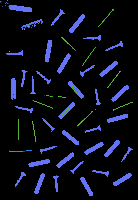

Without contours number:  4304


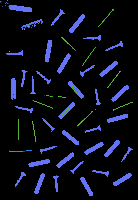

Without contours number:  4305


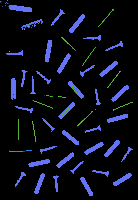

Without contours number:  4306


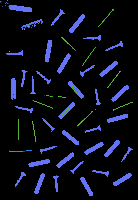

Without contours number:  4307


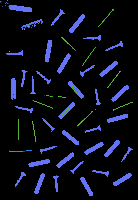

Without contours number:  4308


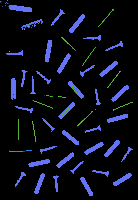

Without contours number:  4309


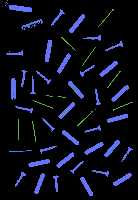

Without contours number:  4310


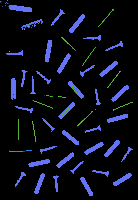

Without contours number:  4311


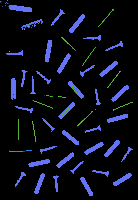

Without contours number:  4312


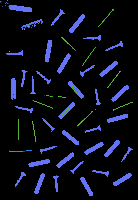

Without contours number:  4313


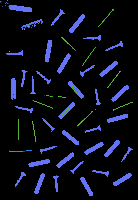

Without contours number:  4314


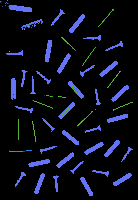

Without contours number:  4315


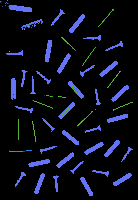

Without contours number:  4316


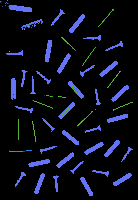

Without contours number:  4317


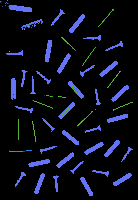

Without contours number:  4318


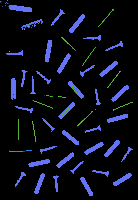

Without contours number:  4319


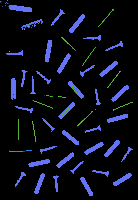

Without contours number:  4320


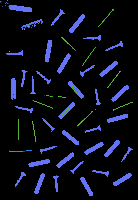

Without contours number:  4321


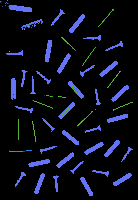

Without contours number:  4322


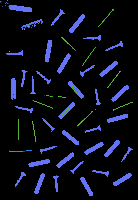

Without contours number:  4323


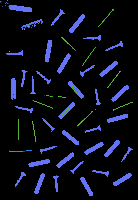

Without contours number:  4324


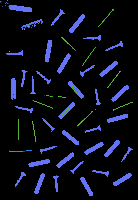

Without contours number:  4325


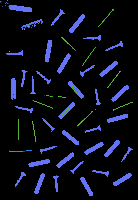

Without contours number:  4326


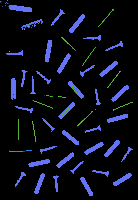

Without contours number:  4327


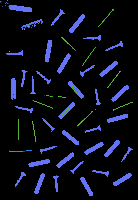

Without contours number:  4328


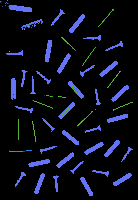

Without contours number:  4329


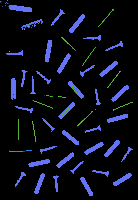

Without contours number:  4330


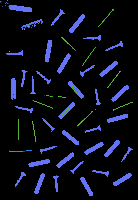

Without contours number:  4331


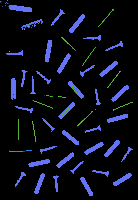

Without contours number:  4332


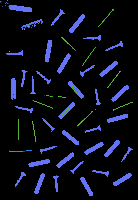

Without contours number:  4333


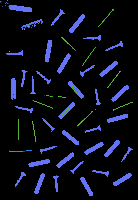

Without contours number:  4334


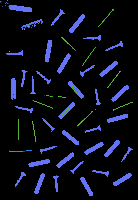

Without contours number:  4335


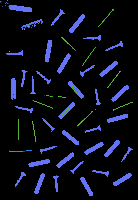

Without contours number:  4336


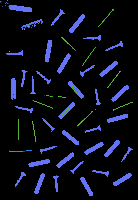

Without contours number:  4337


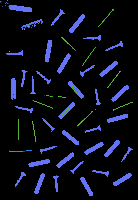

Without contours number:  4338


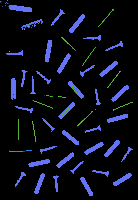

Without contours number:  4339


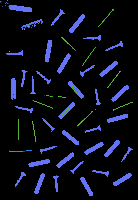

Without contours number:  4340


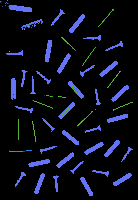

Without contours number:  4341


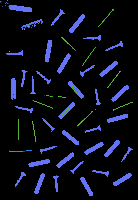

Without contours number:  4342


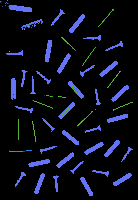

Without contours number:  4343


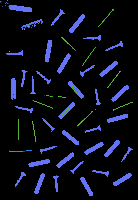

Without contours number:  4344


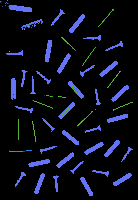

Without contours number:  4345


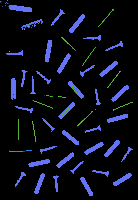

Without contours number:  4346


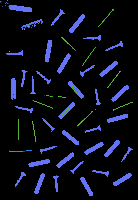

Without contours number:  4347


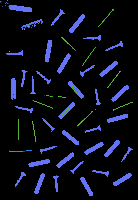

Without contours number:  4348


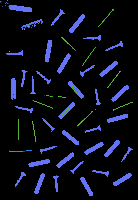

Without contours number:  4349


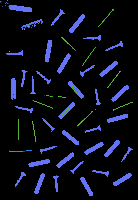

Without contours number:  4350


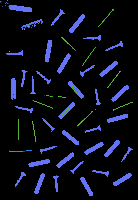

Without contours number:  4351


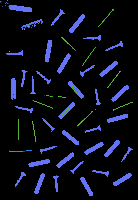

Without contours number:  4352


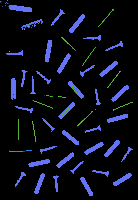

Without contours number:  4353


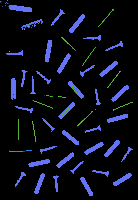

Without contours number:  4354


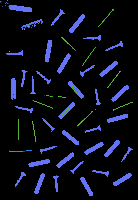

Without contours number:  4355


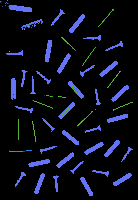

Without contours number:  4356


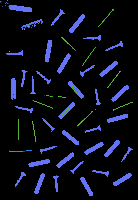

Without contours number:  4357


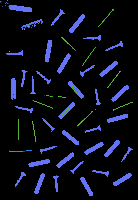

Without contours number:  4358


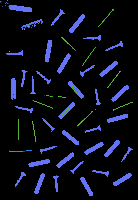

Without contours number:  4359


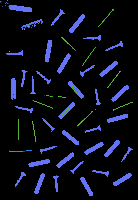

Without contours number:  4360


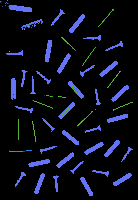

Without contours number:  4361


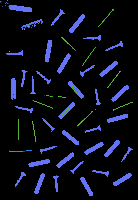

Without contours number:  4362


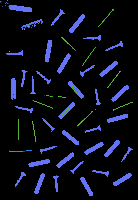

Without contours number:  4363


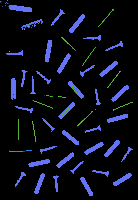

Without contours number:  4364


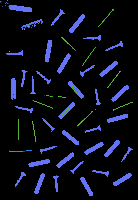

Without contours number:  4365


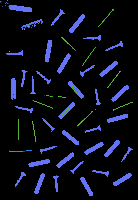

Without contours number:  4366


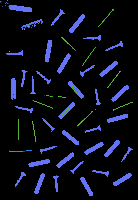

Without contours number:  4367


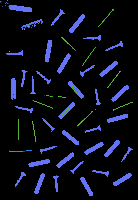

Without contours number:  4368


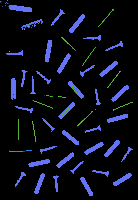

Without contours number:  4369


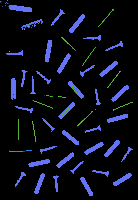

Without contours number:  4370


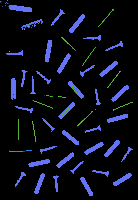

Without contours number:  4371


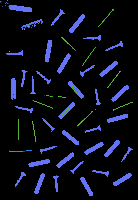

Without contours number:  4372


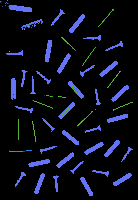

Without contours number:  4373


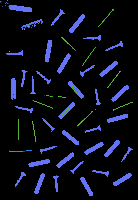

Without contours number:  4374


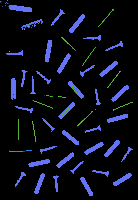

Without contours number:  4375


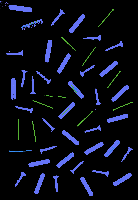

Without contours number:  4376


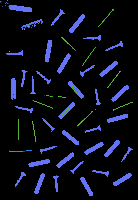

Without contours number:  4377


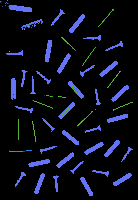

Without contours number:  4378


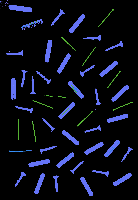

Without contours number:  4379


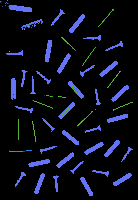

Without contours number:  4380


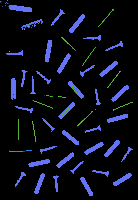

Without contours number:  4381


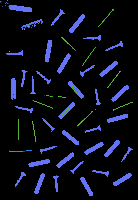

Without contours number:  4382


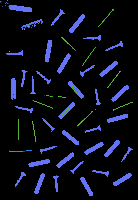

Without contours number:  4383


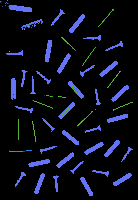

Without contours number:  4384


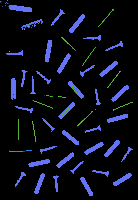

Without contours number:  4385


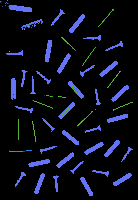

Without contours number:  4386


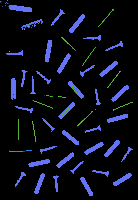

Without contours number:  4387


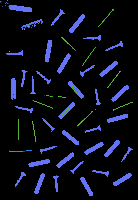

Without contours number:  4388


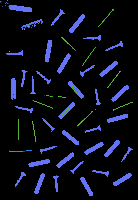

Without contours number:  4389


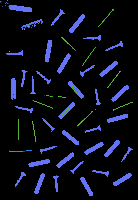

Without contours number:  4390


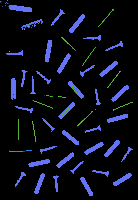

Without contours number:  4391


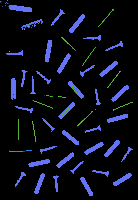

Without contours number:  4392


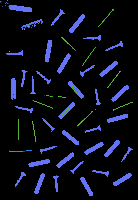

Without contours number:  4393


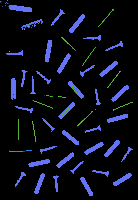

Without contours number:  4394


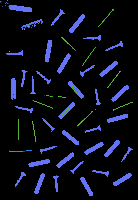

Without contours number:  4395


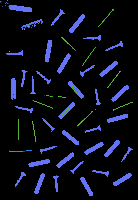

Without contours number:  4396


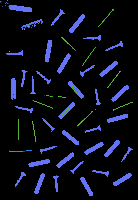

Without contours number:  4397


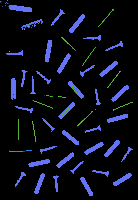

Without contours number:  4398


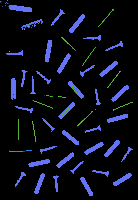

Without contours number:  4399


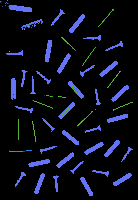

Without contours number:  4400


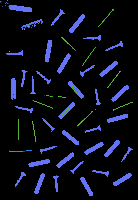

Without contours number:  4401


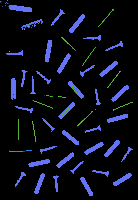

Without contours number:  4402


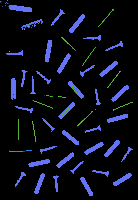

Without contours number:  4403


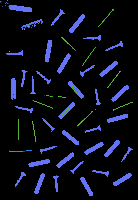

Without contours number:  4404


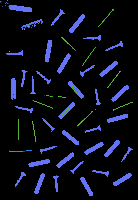

Without contours number:  4405


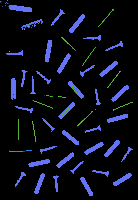

Without contours number:  4406


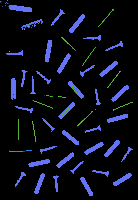

Without contours number:  4407


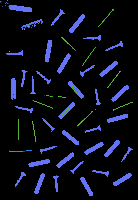

Without contours number:  4408


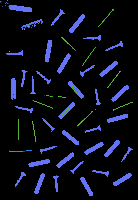

Without contours number:  4409


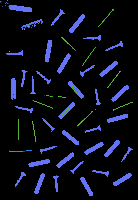

Without contours number:  4410


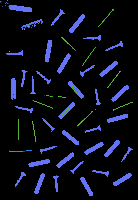

Without contours number:  4411


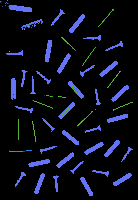

Without contours number:  4412


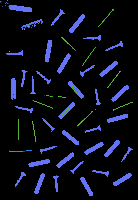

Without contours number:  4413


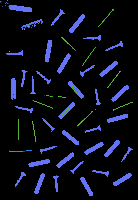

Without contours number:  4414


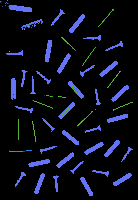

Without contours number:  4415


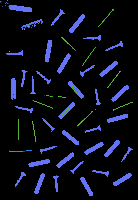

Without contours number:  4416


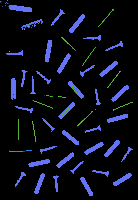

Without contours number:  4417


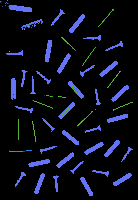

Without contours number:  4418


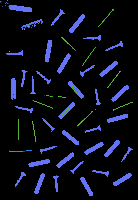

Without contours number:  4419


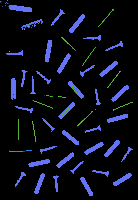

Without contours number:  4420


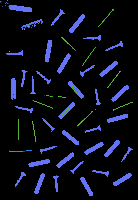

Without contours number:  4421


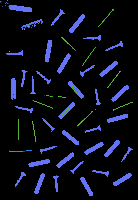

Without contours number:  4422


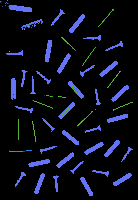

Without contours number:  4423


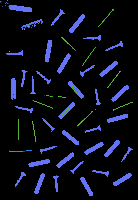

Without contours number:  4424


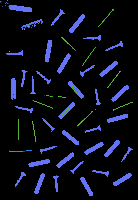

Without contours number:  4425


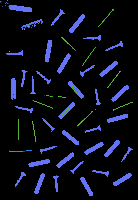

Without contours number:  4426


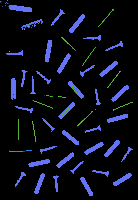

Without contours number:  4427


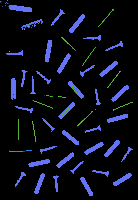

Without contours number:  4428


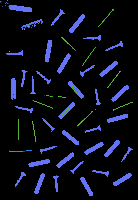

Without contours number:  4429


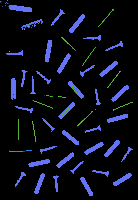

Without contours number:  159


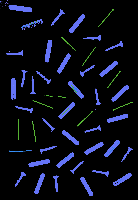

Without contours number:  182


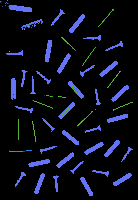

Without contours number:  191


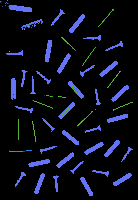

Without contours number:  196


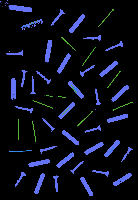

Without contours number:  200


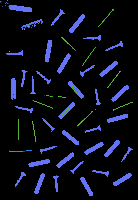

Without contours number:  235


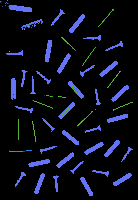

Without contours number:  258


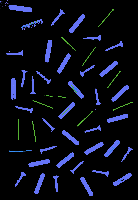

Without contours number:  291


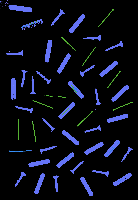

Without contours number:  299


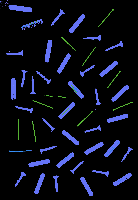

Without contours number:  305


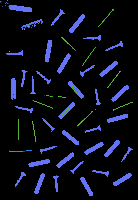

Without contours number:  312


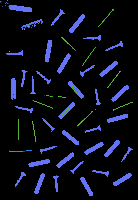

Without contours number:  318


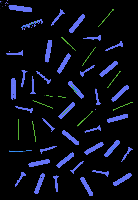

Without contours number:  325


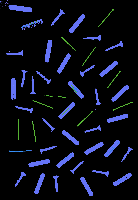

Without contours number:  335


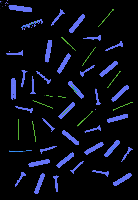

Without contours number:  343


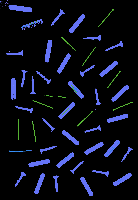

Without contours number:  347


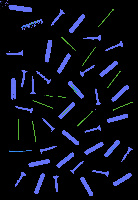

Without contours number:  349


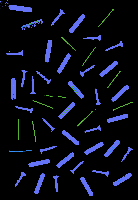

Without contours number:  360


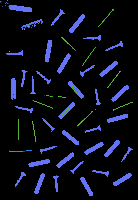

Without contours number:  366


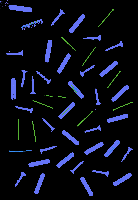

Without contours number:  367


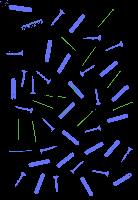

Without contours number:  379


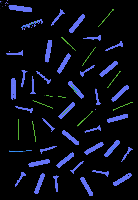

Without contours number:  387


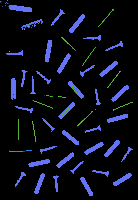

Without contours number:  391


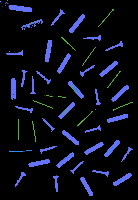

Without contours number:  392


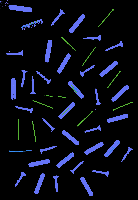

Without contours number:  394


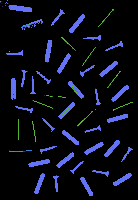

Without contours number:  398


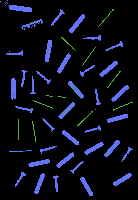

Without contours number:  433


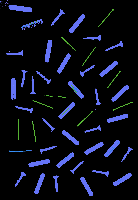

Without contours number:  442


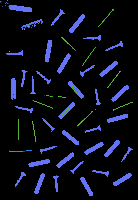

Without contours number:  451


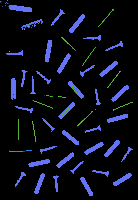

Without contours number:  491


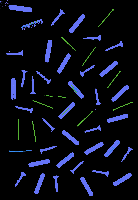

Without contours number:  512


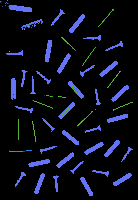

Without contours number:  553


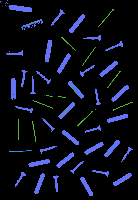

Without contours number:  564


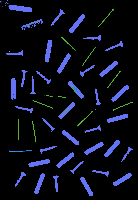

Without contours number:  575


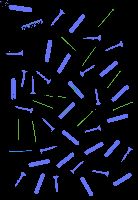

Without contours number:  586


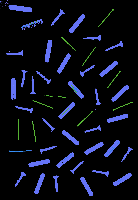

Without contours number:  620


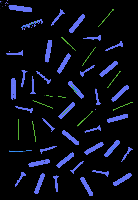

Without contours number:  626


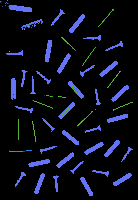

Without contours number:  631


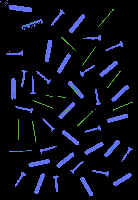

Without contours number:  633


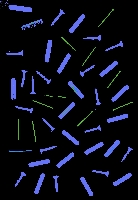

Without contours number:  639


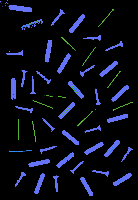

Without contours number:  645


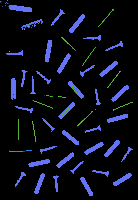

Without contours number:  646


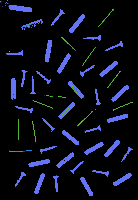

Without contours number:  655


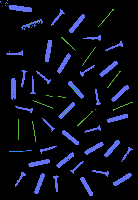

Without contours number:  665


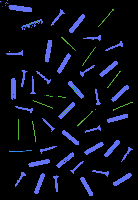

Without contours number:  673


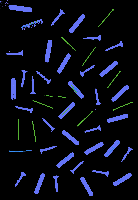

Without contours number:  674


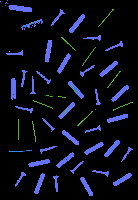

Without contours number:  680


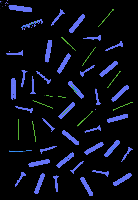

Without contours number:  690


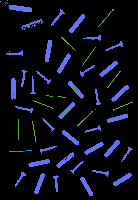

Without contours number:  728


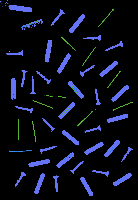

Without contours number:  729


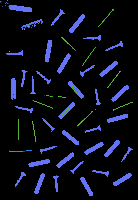

Without contours number:  736


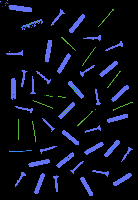

Without contours number:  746


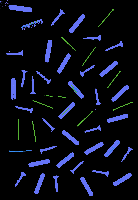

Without contours number:  763


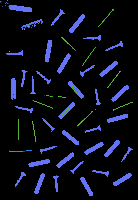

Without contours number:  772


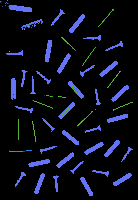

Without contours number:  778


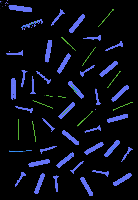

Without contours number:  781


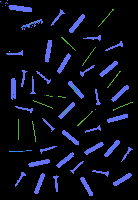

Without contours number:  793


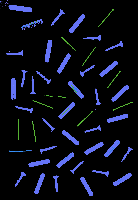

Without contours number:  795


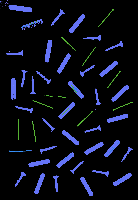

Without contours number:  796


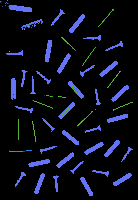

Without contours number:  804


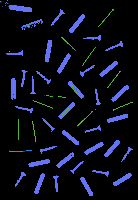

Without contours number:  848


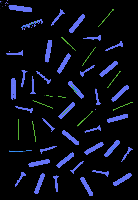

Without contours number:  855


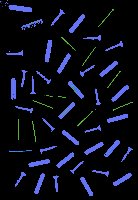

Without contours number:  877


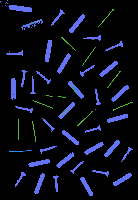

Without contours number:  882


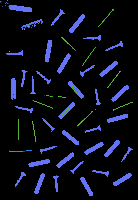

Without contours number:  893


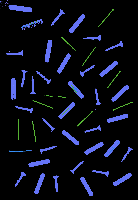

Without contours number:  894


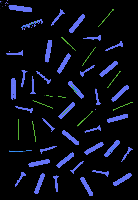

Without contours number:  897


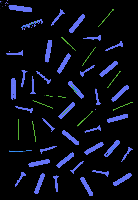

Without contours number:  914


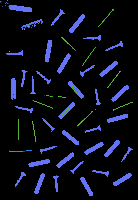

Without contours number:  930


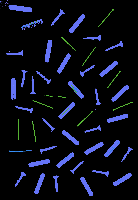

Without contours number:  941


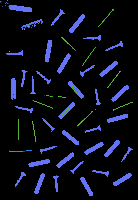

Without contours number:  945


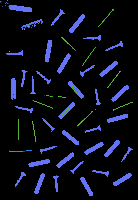

Without contours number:  948


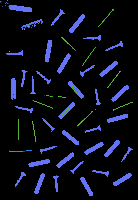

Without contours number:  965


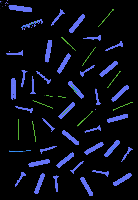

Without contours number:  1003


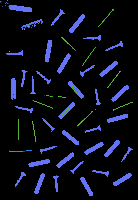

Without contours number:  1024


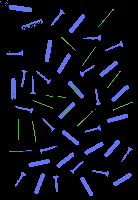

Without contours number:  1033


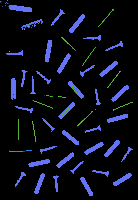

Without contours number:  1035


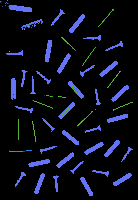

Without contours number:  1036


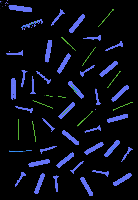

Without contours number:  1045


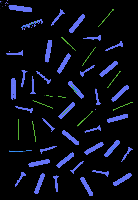

Without contours number:  1079


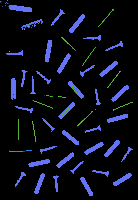

Without contours number:  1107


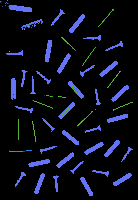

Without contours number:  1114


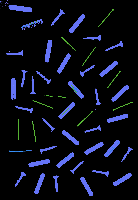

Without contours number:  1115


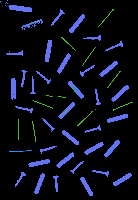

Without contours number:  1119


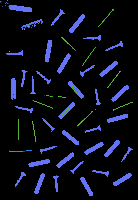

Without contours number:  1154


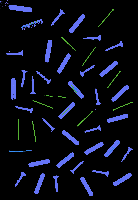

Without contours number:  1160


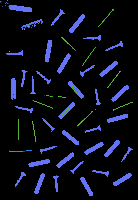

Without contours number:  1196


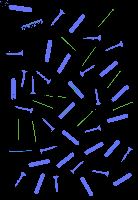

Without contours number:  1201


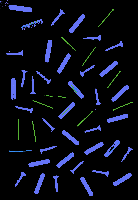

Without contours number:  1218


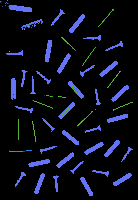

Without contours number:  1278


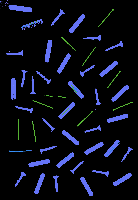

Without contours number:  1287


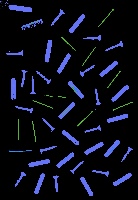

Without contours number:  1293


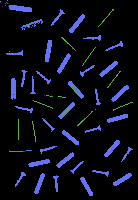

Without contours number:  1297


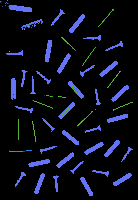

Without contours number:  1303


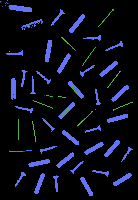

Without contours number:  1306


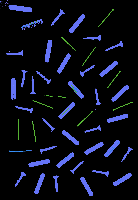

Without contours number:  1312


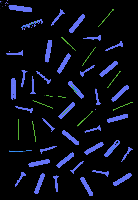

Without contours number:  1346


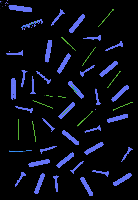

Without contours number:  1349


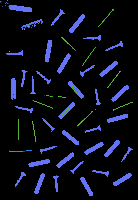

Without contours number:  1365


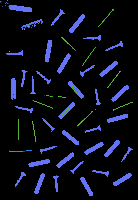

Without contours number:  1376


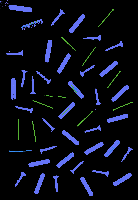

Without contours number:  1395


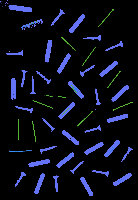

Without contours number:  1425


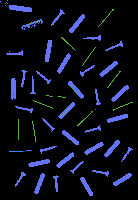

Without contours number:  1465


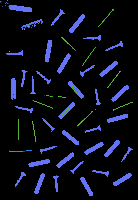

Without contours number:  1474


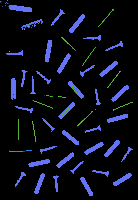

Without contours number:  1489


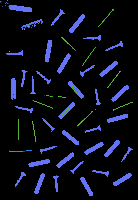

Without contours number:  1530


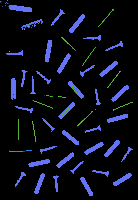

Without contours number:  1554


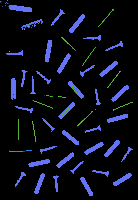

Without contours number:  1563


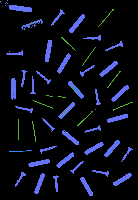

Without contours number:  1573


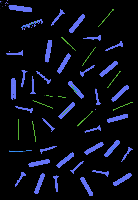

Without contours number:  1578


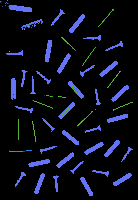

Without contours number:  1585


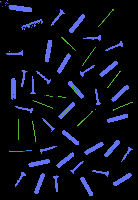

Without contours number:  1611


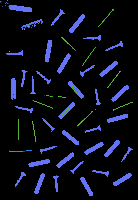

Without contours number:  1640


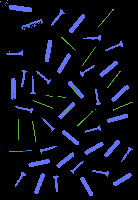

Without contours number:  1661


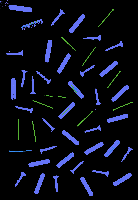

Without contours number:  1664


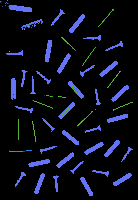

Without contours number:  1667


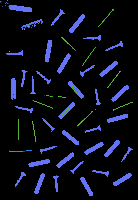

Without contours number:  1673


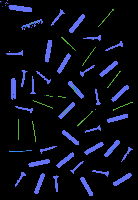

Without contours number:  1692


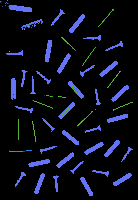

Without contours number:  1711


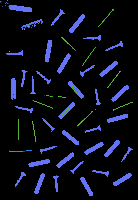

Without contours number:  1714


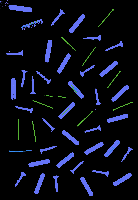

Without contours number:  1718


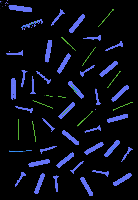

Without contours number:  1720


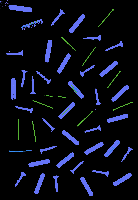

Without contours number:  1724


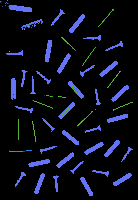

Without contours number:  1730


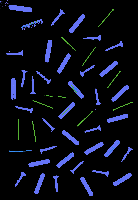

Without contours number:  1740


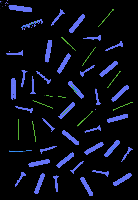

Without contours number:  1741


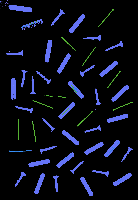

Without contours number:  1744


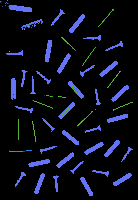

Without contours number:  1750


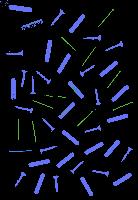

Without contours number:  1752


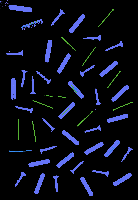

Without contours number:  1753


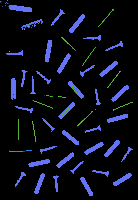

Without contours number:  1754


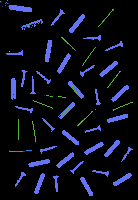

Without contours number:  1761


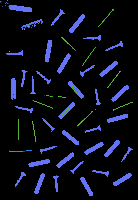

Without contours number:  1765


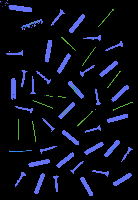

Without contours number:  1768


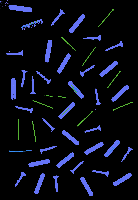

Without contours number:  1793


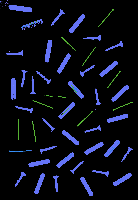

Without contours number:  1800


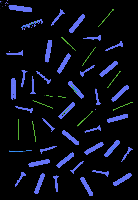

Without contours number:  1802


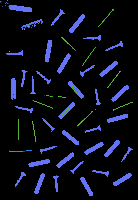

Without contours number:  1823


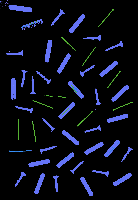

Without contours number:  1841


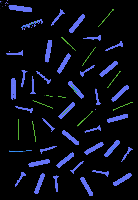

Without contours number:  1843


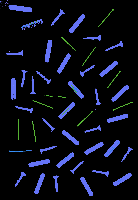

Without contours number:  1846


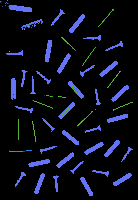

Without contours number:  1847


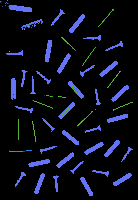

Without contours number:  1867


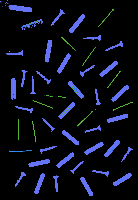

Without contours number:  1870


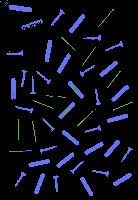

Without contours number:  1872


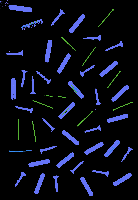

Without contours number:  1880


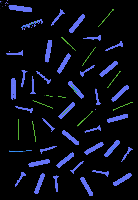

Without contours number:  1886


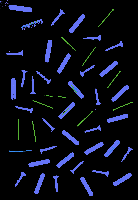

Without contours number:  1903


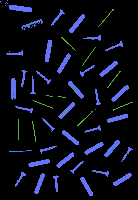

Without contours number:  1906


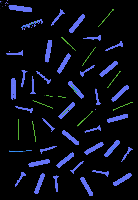

Without contours number:  1909


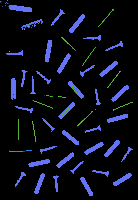

Without contours number:  1915


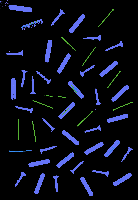

Without contours number:  1926


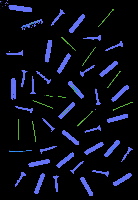

Without contours number:  1931


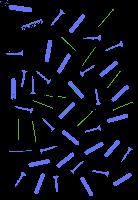

Without contours number:  1958


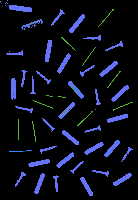

Without contours number:  1961


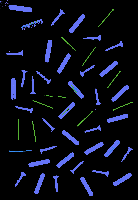

Without contours number:  1998


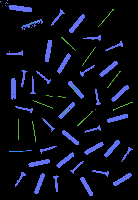

Without contours number:  2003


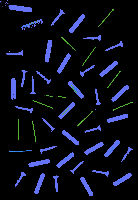

Without contours number:  2011


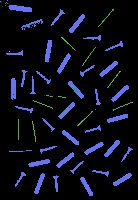

Without contours number:  2014


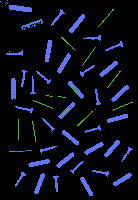

Without contours number:  2016


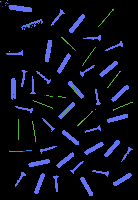

Without contours number:  2022


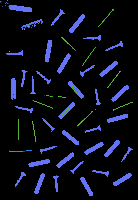

Without contours number:  2028


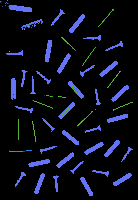

Without contours number:  2064


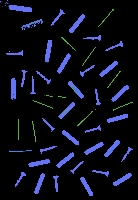

Without contours number:  2074


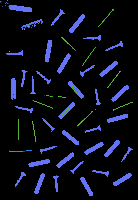

Without contours number:  2174


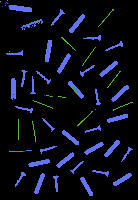

Without contours number:  2203


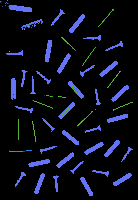

Without contours number:  2241


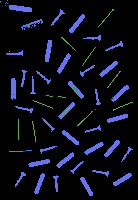

Without contours number:  2253


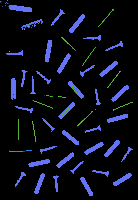

Without contours number:  2284


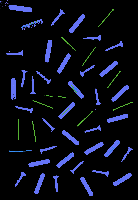

Without contours number:  2303


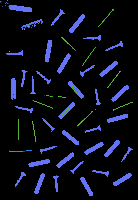

Without contours number:  2328


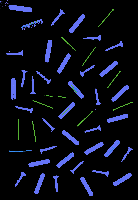

Without contours number:  2331


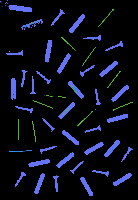

Without contours number:  2335


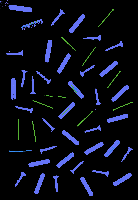

Without contours number:  2343


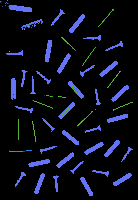

Without contours number:  2352


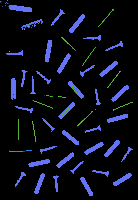

Without contours number:  2367


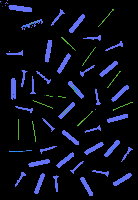

Without contours number:  2375


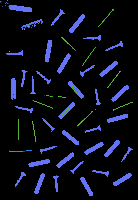

Without contours number:  2380


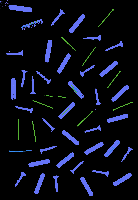

Without contours number:  2382


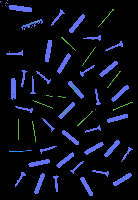

Without contours number:  2395


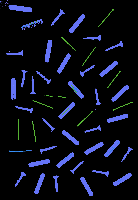

Without contours number:  2401


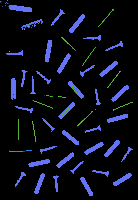

Without contours number:  2412


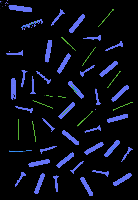

Without contours number:  2413


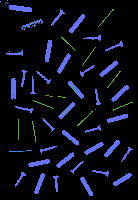

Without contours number:  2418


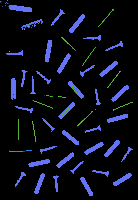

Without contours number:  2429


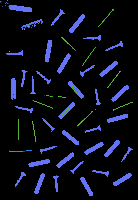

Without contours number:  2433


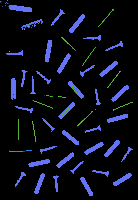

Without contours number:  2439


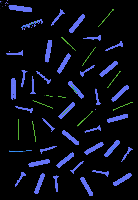

Without contours number:  2440


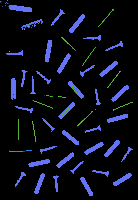

Without contours number:  2444


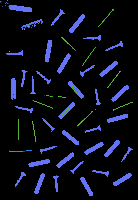

Without contours number:  2451


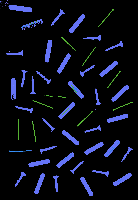

Without contours number:  2459


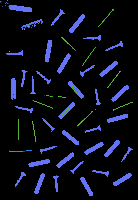

Without contours number:  2475


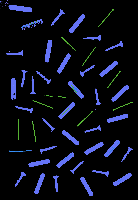

Without contours number:  2479


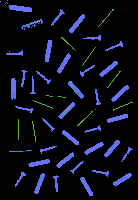

Without contours number:  2482


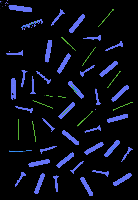

Without contours number:  2485


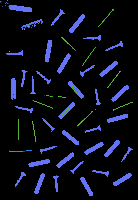

Without contours number:  2493


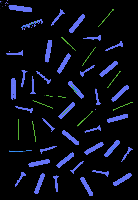

Without contours number:  2506


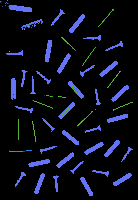

Without contours number:  2508


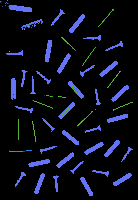

Without contours number:  2531


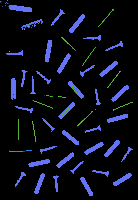

Without contours number:  2542


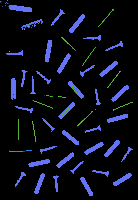

Without contours number:  2552


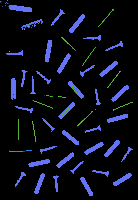

Without contours number:  2570


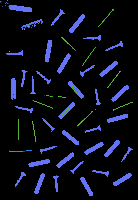

Without contours number:  2573


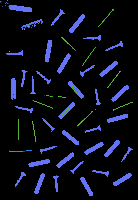

Without contours number:  2586


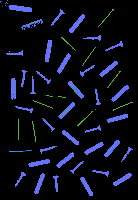

Without contours number:  2592


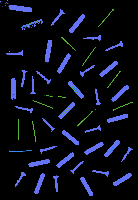

Without contours number:  2602


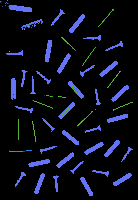

Without contours number:  2603


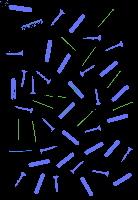

Without contours number:  2604


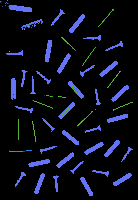

Without contours number:  2608


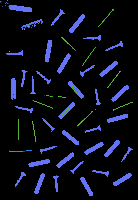

Without contours number:  2609


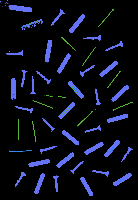

Without contours number:  2611


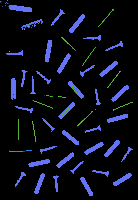

Without contours number:  2616


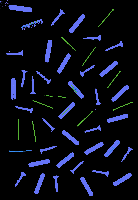

Without contours number:  2629


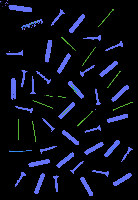

Without contours number:  2651


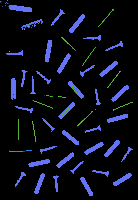

Without contours number:  2654


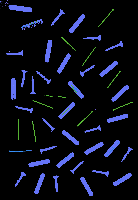

Without contours number:  2655


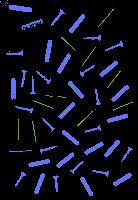

Without contours number:  2657


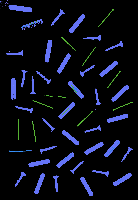

Without contours number:  2660


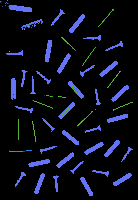

Without contours number:  2666


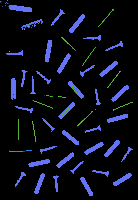

Without contours number:  2677


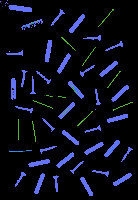

Without contours number:  2690


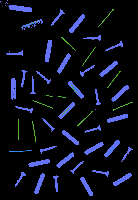

Without contours number:  2702


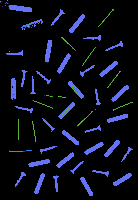

Without contours number:  2707


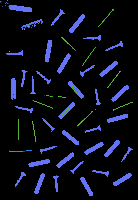

Without contours number:  2717


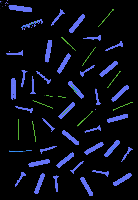

Without contours number:  2727


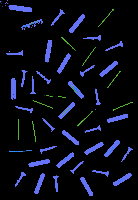

Without contours number:  2729


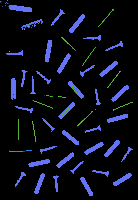

Without contours number:  2736


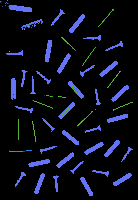

Without contours number:  2741


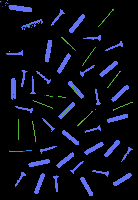

Without contours number:  2743


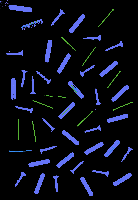

Without contours number:  2752


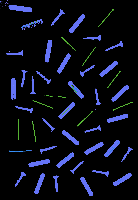

Without contours number:  2759


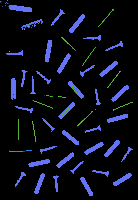

Without contours number:  2760


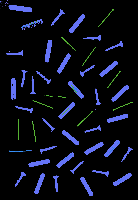

Without contours number:  2777


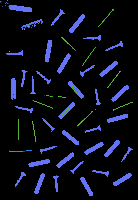

Without contours number:  2780


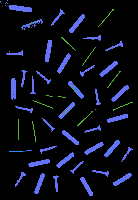

Without contours number:  2799


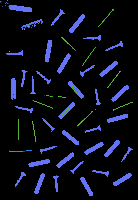

Without contours number:  2802


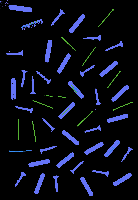

Without contours number:  2804


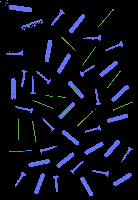

Without contours number:  2840


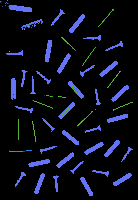

Without contours number:  2846


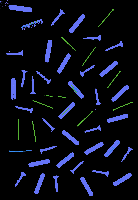

Without contours number:  2849


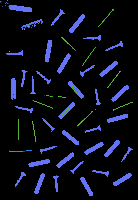

Without contours number:  2852


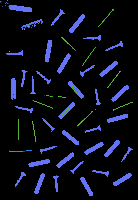

Without contours number:  2856


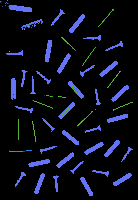

Without contours number:  2858


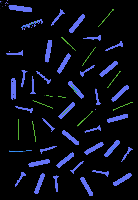

Without contours number:  2864


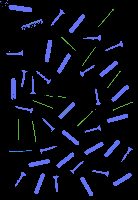

Without contours number:  2893


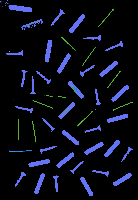

Without contours number:  2896


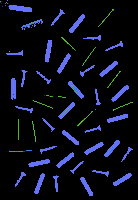

Without contours number:  2945


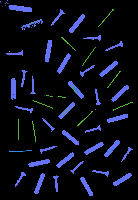

Without contours number:  2947


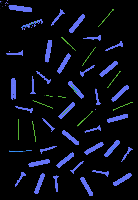

Without contours number:  2982


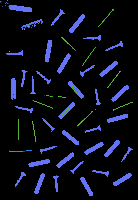

Without contours number:  2984


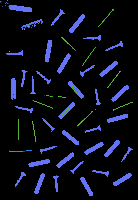

Without contours number:  2985


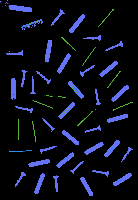

Without contours number:  3027


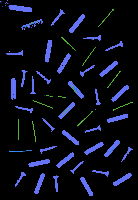

Without contours number:  3035


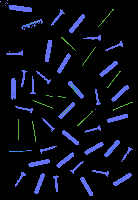

Without contours number:  3068


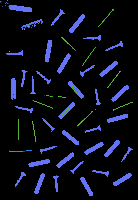

Without contours number:  3118


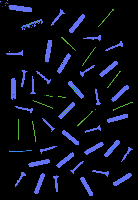

Without contours number:  3149


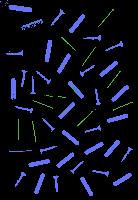

Without contours number:  3152


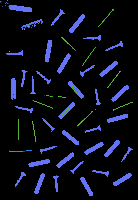

Without contours number:  3171


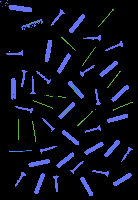

Without contours number:  3183


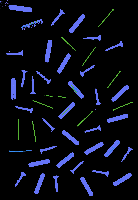

Without contours number:  3207


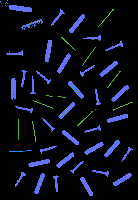

Without contours number:  3223


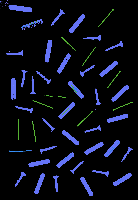

Without contours number:  3232


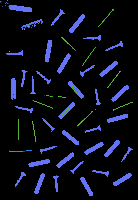

Without contours number:  3246


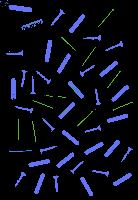

Without contours number:  3271


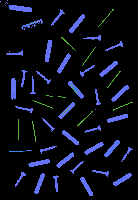

Without contours number:  3310


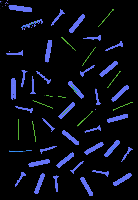

Without contours number:  3322


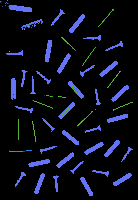

Without contours number:  3327


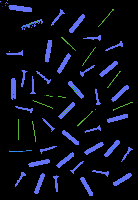

Without contours number:  3330


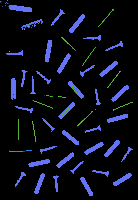

Without contours number:  3338


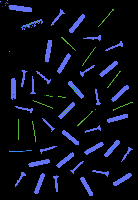

Without contours number:  3377


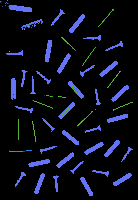

Without contours number:  3388


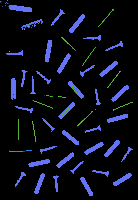

Without contours number:  3394


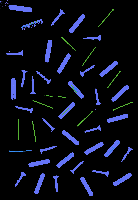

Without contours number:  3403


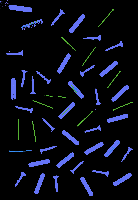

Without contours number:  3405


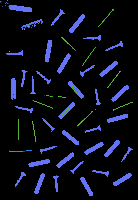

Without contours number:  3421


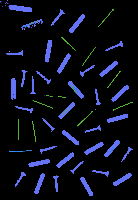

Without contours number:  3441


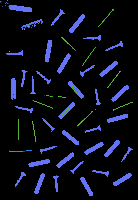

Without contours number:  3447


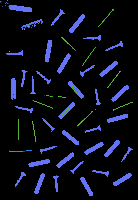

Without contours number:  3464


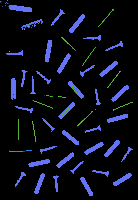

Without contours number:  3468


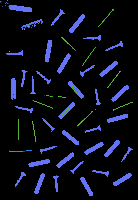

Without contours number:  3474


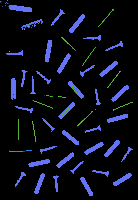

Without contours number:  3476


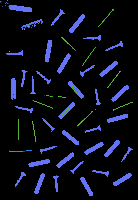

Without contours number:  3479


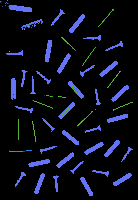

Without contours number:  3481


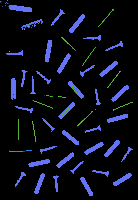

Without contours number:  3483


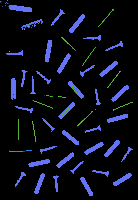

Without contours number:  3489


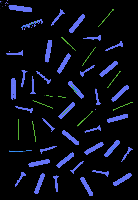

Without contours number:  3493


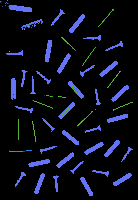

Without contours number:  3494


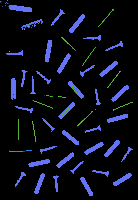

Without contours number:  3495


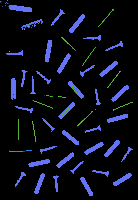

Without contours number:  3498


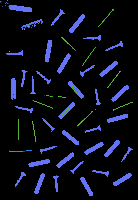

Without contours number:  3506


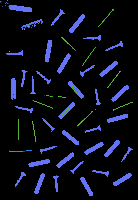

Without contours number:  3508


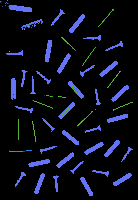

Without contours number:  3509


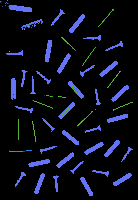

Without contours number:  3510


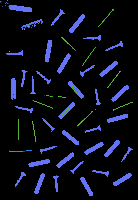

Without contours number:  3513


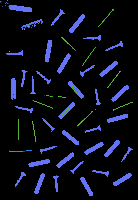

Without contours number:  3514


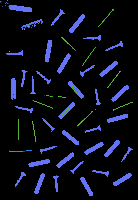

Without contours number:  3517


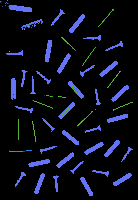

Without contours number:  3523


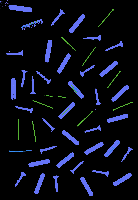

Without contours number:  3526


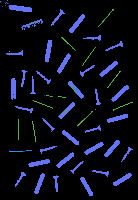

Without contours number:  3529


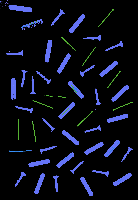

Without contours number:  3537


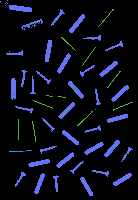

Without contours number:  3538


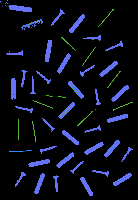

Without contours number:  3545


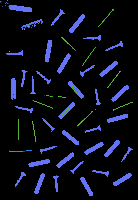

Without contours number:  3549


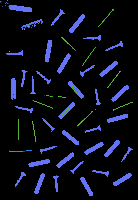

Without contours number:  3550


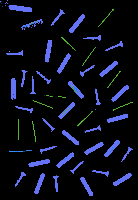

Without contours number:  3560


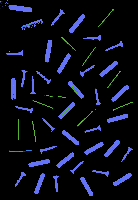

Without contours number:  3562


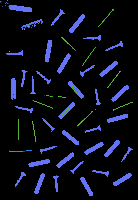

Without contours number:  3565


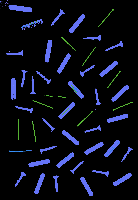

Without contours number:  3566


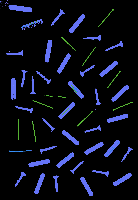

Without contours number:  3568


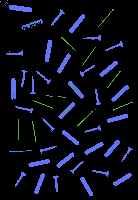

Without contours number:  3576


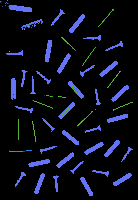

Without contours number:  3581


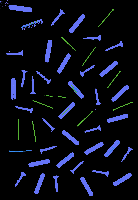

Without contours number:  3583


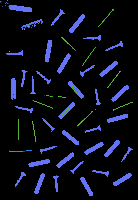

Without contours number:  3585


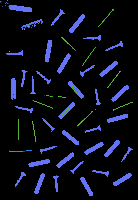

Without contours number:  3591


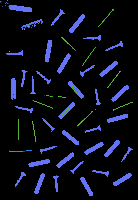

Without contours number:  3592


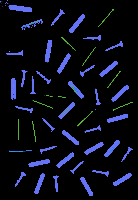

Without contours number:  3595


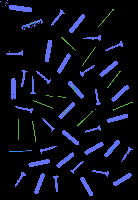

Without contours number:  3596


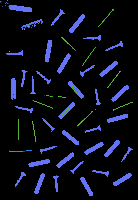

Without contours number:  3601


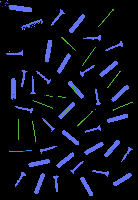

Without contours number:  3602


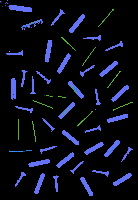

Without contours number:  3604


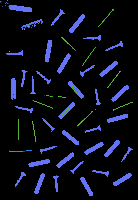

Without contours number:  3613


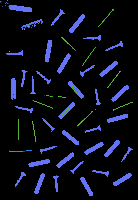

Without contours number:  3616


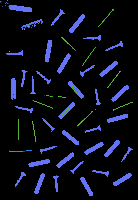

Without contours number:  3620


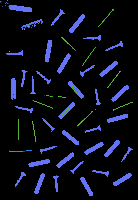

Without contours number:  3624


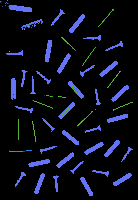

Without contours number:  3625


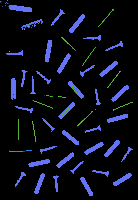

Without contours number:  3630


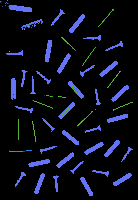

Without contours number:  3633


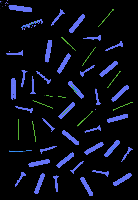

Without contours number:  3635


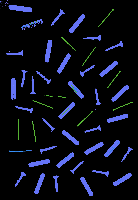

Without contours number:  3636


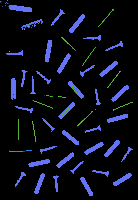

Without contours number:  3647


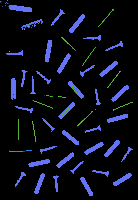

Without contours number:  3649


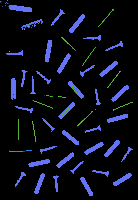

Without contours number:  3651


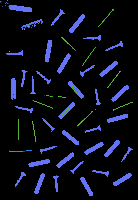

Without contours number:  3658


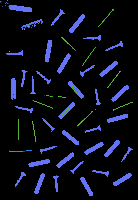

Without contours number:  3685


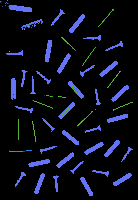

Without contours number:  3690


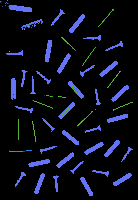

Without contours number:  3700


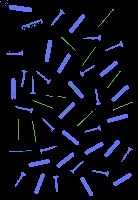

Without contours number:  3741


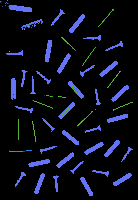

Without contours number:  3755


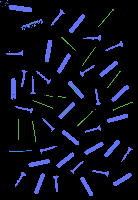

Without contours number:  3759


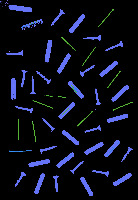

Without contours number:  3763


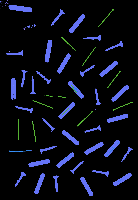

Without contours number:  3767


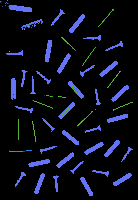

Without contours number:  3768


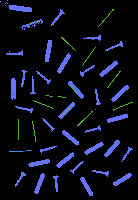

Without contours number:  3808


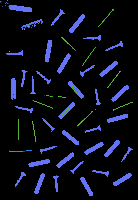

Without contours number:  3835


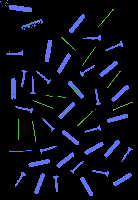

Without contours number:  3857


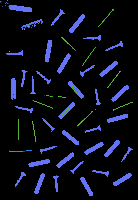

Without contours number:  3970


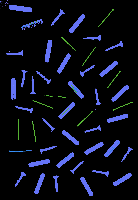

Without contours number:  3986


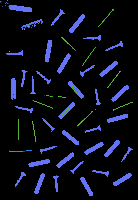

Without contours number:  4023


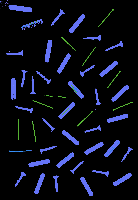

Without contours number:  4037


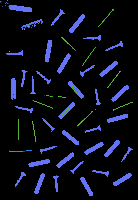

Without contours number:  4039


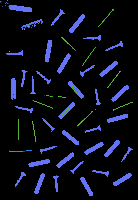

Without contours number:  4042


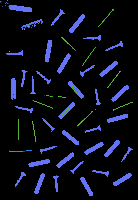

Without contours number:  4046


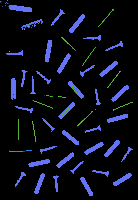

Without contours number:  4053


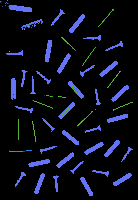

Without contours number:  4055


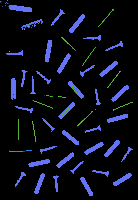

Without contours number:  4056


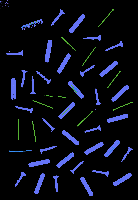

Without contours number:  4060


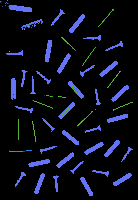

Without contours number:  4062


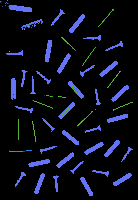

Without contours number:  4081


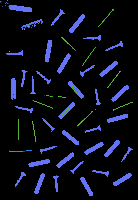

Without contours number:  4089


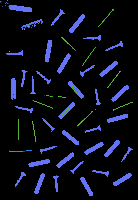

Without contours number:  4093


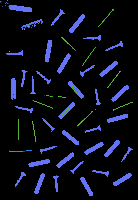

Without contours number:  4110


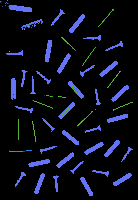

Without contours number:  4128


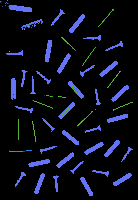

Without contours number:  4146


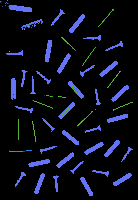

Without contours number:  4151


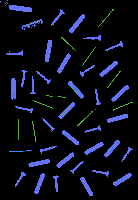

Without contours number:  4164


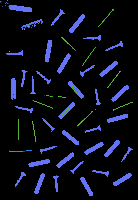

Without contours number:  4176


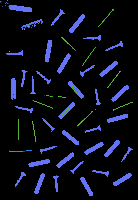

Without contours number:  4190


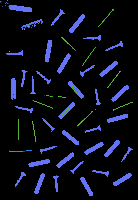

Without contours number:  4192


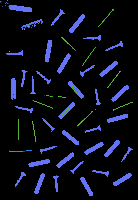

Without contours number:  4208


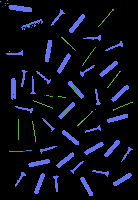

Without contours number:  4211


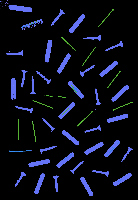

Without contours number:  4236


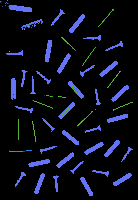

Without contours number:  4237


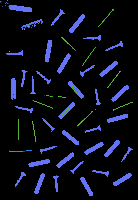

Without contours number:  4238


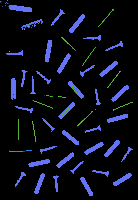

Without contours number:  4240


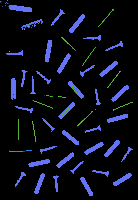

Without contours number:  4241


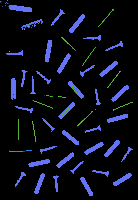

Without contours number:  4252


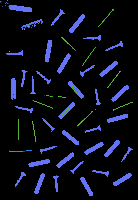

Without contours number:  4272


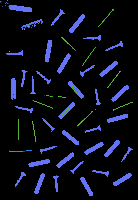

Without contours number:  4309


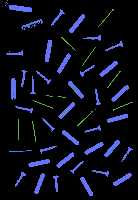

Without contours number:  4313


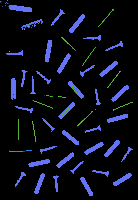

Without contours number:  4314


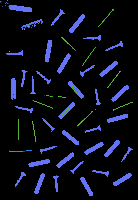

Without contours number:  4316


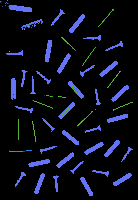

Without contours number:  4327


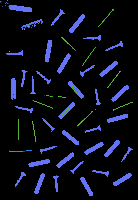

Without contours number:  4380


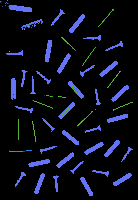

Without contours number:  4384


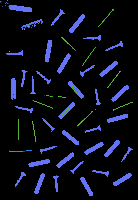

Without contours number:  4416


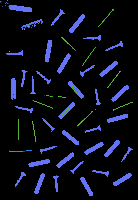

Without contours number:  4421


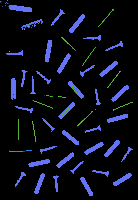

Without contours number:  295


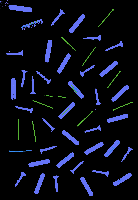

Without contours number:  302


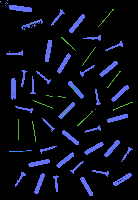

Without contours number:  708


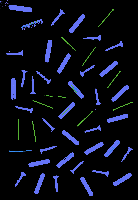

Without contours number:  815


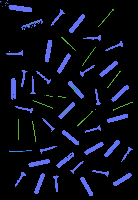

Without contours number:  1136


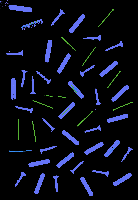

Without contours number:  1970


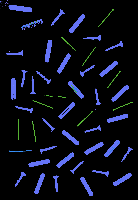

Without contours number:  2550


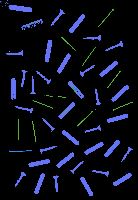

Without contours number:  2635


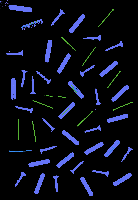

Without contours number:  2687


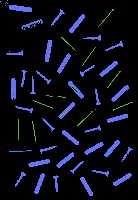

Without contours number:  2710


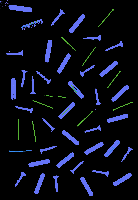

Without contours number:  2863


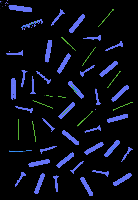

Without contours number:  3229


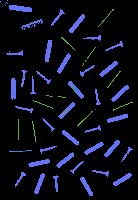

Without contours number:  3618


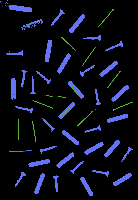

Without contours number:  383


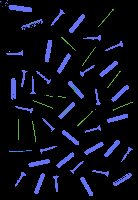

Without contours number:  969


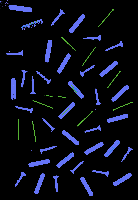

Without contours number:  1296


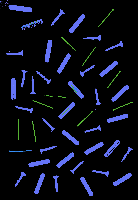

Without contours number:  3747


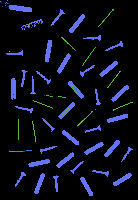

Without contours number:  1202


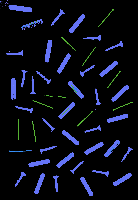

Without contours number:  1658


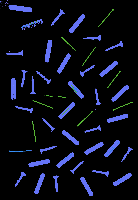

Without contours number:  1877


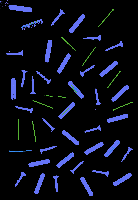

Without contours number:  2178


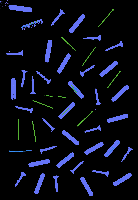

Without contours number:  2197


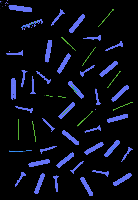

Without contours number:  2676


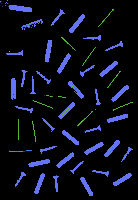

Without contours number:  3372


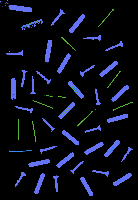

Without contours number:  3418


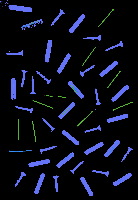

Without contours number:  3734


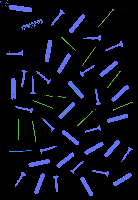

Without contours number:  3859


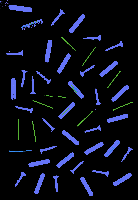

Without contours number:  1590


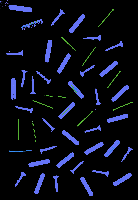

Without contours number:  1644


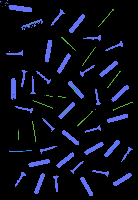

Without contours number:  1839


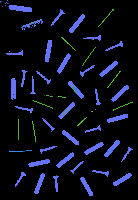

Without contours number:  2388


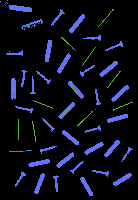

Without contours number:  1603


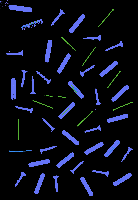

Without contours number:  1658


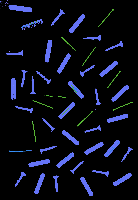

Without contours number:  1877


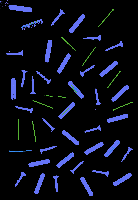

Without contours number:  1970


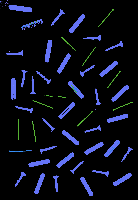

Without contours number:  2178


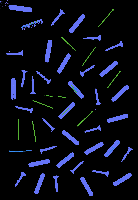

Without contours number:  2197


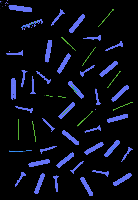

Without contours number:  2676


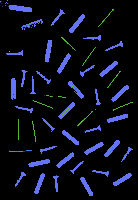

Without contours number:  2823


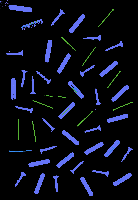

Without contours number:  2944


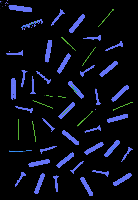

Without contours number:  3372


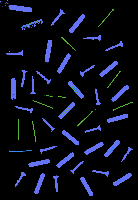

Without contours number:  3404


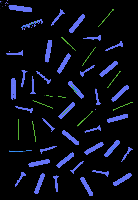

Without contours number:  3418


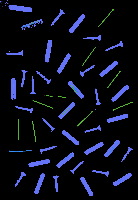

Without contours number:  3734


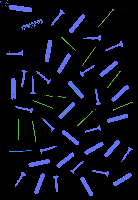

Without contours number:  3859


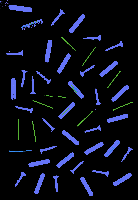

Coloring similar letters:


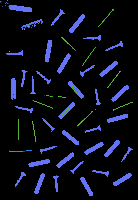

In [89]:



show_classes_needles(img_, contours, (dm_hm<0.0015))


# YOUR CODE
# ---------------------------